# Deep Learning - Deep Q-Networks - Rubik Cube

- Juan Sebastián Vargas Torres



## Imports

In [ ]:
!git clone https://github.com/andresmore/gym-Rubiks-Cube

fatal: destination path 'gym-Rubiks-Cube' already exists and is not an empty directory.


In [ ]:
!python -m pip install -e gym-Rubiks-Cube/

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Obtaining file:///content/gym-Rubiks-Cube
  Preparing metadata (setup.py) ... done
  Attempting uninstall: gym-Rubiks-Cube
    Found existing installation: gym-Rubiks-Cube 0.0.1
    Uninstalling gym-Rubiks-Cube-0.0.1:
      Successfully uninstalled gym-Rubiks-Cube-0.0.1
  Running setup.py develop for gym-Rubiks-Cube


In [ ]:
!sudo apt-get update
!sudo apt-get install -y xvfb ffmpeg
!pip install pyvirtualdisplay
!pip install tf-agents
!pip install tf-agents[reverb]

Hit:1 https://cloud.r-project.org/bin/linux/ubuntu focal-cran40/ InRelease
Hit:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  InRelease
Get:3 http://security.ubuntu.com/ubuntu focal-security InRelease [114 kB]
Get:4 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu focal InRelease [18.1 kB]
Hit:5 http://archive.ubuntu.com/ubuntu focal InRelease
Get:6 http://archive.ubuntu.com/ubuntu focal-updates InRelease [114 kB]
Hit:7 http://ppa.launchpad.net/cran/libgit2/ubuntu focal InRelease
Hit:8 http://ppa.launchpad.net/deadsnakes/ppa/ubuntu focal InRelease
Get:9 http://archive.ubuntu.com/ubuntu focal-backports InRelease [108 kB]
Hit:10 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu focal InRelease
Hit:11 http://ppa.launchpad.net/ubuntugis/ppa/ubuntu focal InRelease
Get:12 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu focal/main Sources [2,581 kB]
Get:13 http://security.ubuntu.com/ubuntu focal-security/universe amd64 Packages [1,051 kB]
Get:14 http

In [ ]:
import site
site.main()
import gym_Rubiks_Cube

In [ ]:
from __future__ import absolute_import, division, print_function

import base64
import imageio
import IPython
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import PIL.Image
import pyvirtualdisplay
import tensorflow as tf
from tf_agents.drivers import py_driver
from tf_agents.agents.dqn import dqn_agent
from tf_agents.drivers import dynamic_step_driver
from tf_agents.environments import suite_gym
from tf_agents.environments import tf_py_environment
from tf_agents.eval import metric_utils
from tf_agents.metrics import tf_metrics
from tf_agents.networks import sequential
from tf_agents.policies import random_tf_policy
from tf_agents.replay_buffers import tf_uniform_replay_buffer
from tf_agents.trajectories import trajectory
from tf_agents.specs import tensor_spec
from tf_agents.utils import common
import gym
from gym_Rubiks_Cube.envs.rubiks_cube_env import RubiksCubeEnv
from gym.envs.registration import register
from tf_agents.policies import py_tf_eager_policy
import reverb
from tf_agents.replay_buffers import reverb_replay_buffer
from tf_agents.replay_buffers import reverb_utils

In [ ]:
# Set up a virtual display for rendering OpenAI gym environments.
display = pyvirtualdisplay.Display(visible=0, size=(1400, 900)).start()

## Setup

Hyperparameters

In [ ]:
num_iterations = 52000 # @param {type:"integer"}

initial_collect_steps = 100  # @param {type:"integer"}
collect_steps_per_iteration =   1# @param {type:"integer"}
replay_buffer_max_length = 100000  # @param {type:"integer"}

batch_size = 256  # @param {type:"integer"}
learning_rate = 1e-4  # @param {type:"number"}
log_interval = 200  # @param {type:"integer"}

num_eval_episodes = 30  # @param {type:"integer"}
eval_interval = 100  # @param {type:"integer"}

seq_size=30 # @param {type:"integer"}

gamma= 0.82 # @param {type:"number"}

fc_layer_params = (80,64)

table_name="uniform_table_1"

Se parte de la clase creada por el profesor para que dado el ambiente se puedan tener ***rewards*** intermedios debido a la complejidad de resolver un cubo de rubik. En caso tal no se hiciese esto, solo se obtendría un ***reward*** cuando el cubo estuviese armado.

In [ ]:
class NaiveRubiksCubeV1(RubiksCubeEnv):
  solved = np.array([5, 5, 5, 5, 5, 5, 5, 5, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 4, 4, 4, 4, 4, 4, 4, 4, 4], dtype=np.uint8)
  def __init__(self, orderNum=3):
        super().__init__(orderNum)

  def calculateReward(self):
    obs= self._getObs()
    vec_same = obs == self.solved
    if vec_same.all():
      return 250,True

    reward=sum(vec_same)
    comparison=vec_same*1

    cube = {
    "white": comparison[0:9],
    "yellow": comparison[9:18],
    "orange": comparison[18:27],
    "red": comparison[27:36],
    "green": comparison[36:45],
    "blue": comparison[45:]
    }

    for i in range(0,54,9):
      face=comparison[i:i+9]
      reward+=self.getCenterReward(face)
      reward+=self.getFaceHorizontalLinesReward(face)
      reward+=self.getFaceVerticalLinesReward(face)
      reward+=self.getFullFaceReward(face)


    reward+=self.getCornersReward(cube)

    reward+=self.getTotalCrossReward(cube)


    return reward, False


  def getCenterReward(self,face):
    if(face[4]==1):
      return 1
    return 0

  def getFaceHorizontalLinesReward(self,face):
    horizontal_line_reward=0
    for j in range(0,9,3):
      hor_line=face[j:j+3]
      count = np.count_nonzero(hor_line == 1)
      if(count==3):
        horizontal_line_reward+=3

    return horizontal_line_reward


  def getFaceVerticalLinesReward(self,face):
    vertical_line_reward=0
    for j in range(3):
      vert_line= face[j::3]
      count = np.count_nonzero(vert_line == 1)
      if(count==3):
        vertical_line_reward+=3

    return vertical_line_reward


  def getFullFaceReward(self,face):
    count = np.count_nonzero(face == 1)
    if(count==9):
      return 9
    return 0


  def getTotalCrossReward(self,cube):
    totalCrossReward=0
    for color in cube:
        if color == "white" or color == "yellow" or color == "orange" or color == "red":
          topFace=cube["green"]
          bottomFace=cube["blue"]

        if color == "white" or color == "green" or color == "blue":
          leftFace=cube["red"]
          rightFace=cube["orange"]

        if color == "yellow":
          leftFace=cube["orange"]
          rightFace=cube["red"]

        if color == "orange":
          leftFace=cube["white"]
          rightFace=cube["yellow"]

        if color == "red":
          leftFace=cube["yellow"]
          rightFace=cube["white"]

        if color == "green":
          topFace=cube["yellow"]
          bottomFace=cube["white"]

        if color == "blue":
          topFace=cube["white"]
          bottomFace=cube["yellow"]

        reward=self._getFaceCrossReward(centerFaceName=color,centerFace=cube[color],leftFace=leftFace,rightFace=rightFace,topFace=topFace,bottomFace=bottomFace)
        totalCrossReward+=reward

    return totalCrossReward


  def _getFaceCrossReward(self, centerFaceName,centerFace,leftFace,rightFace,topFace,bottomFace):
    totalReward=0
    indices = [1, 3, 4, 5, 7]
    cross = centerFace[indices]
    count = np.count_nonzero(cross == 1)

    if(count==5):
      totalReward+=5

    if centerFaceName == "white":

        left_face_count= 2 if np.count_nonzero(leftFace[[4, 5]] == 1) == 2 else 0
        right_face_count= 2 if np.count_nonzero(rightFace[[3, 4]] == 1) == 2 else 0

        top_face_count= 2 if np.count_nonzero(topFace[[4, 7]] == 1) == 2 else 0
        bottom_face_count= 2 if np.count_nonzero(bottomFace[[1, 4]] == 1) == 2 else 0

    if centerFaceName == "yellow":
        left_face_count= 2 if np.count_nonzero(leftFace[[4, 5]] == 1) == 2 else 0
        right_face_count= 2 if np.count_nonzero(rightFace[[3, 4]] == 1) == 2 else 0

        top_face_count= 2 if np.count_nonzero(topFace[[4, 1]] == 1) == 2 else 0
        bottom_face_count= 2 if np.count_nonzero(bottomFace[[7, 4]] == 1) == 2 else 0

    if centerFaceName == "orange":
        left_face_count= 2 if np.count_nonzero(leftFace[[4, 5]] == 1) == 2 else 0
        right_face_count= 2 if np.count_nonzero(rightFace[[3, 4]] == 1) == 2 else 0

        top_face_count= 2 if np.count_nonzero(topFace[[4, 5]] == 1) == 2 else 0
        bottom_face_count= 2 if np.count_nonzero(bottomFace[[5, 4]] == 1) == 2 else 0

    if centerFaceName == "red":
        left_face_count= 2 if np.count_nonzero(leftFace[[4, 5]] == 1) == 2 else 0
        right_face_count= 2 if np.count_nonzero(rightFace[[3, 4]] == 1) == 2 else 0

        top_face_count= 2 if np.count_nonzero(topFace[[4, 3]] == 1) == 2 else 0
        bottom_face_count= 2 if np.count_nonzero(bottomFace[[3, 4]] == 1) == 2 else 0

    if centerFaceName == "green":

        left_face_count= 2 if np.count_nonzero(leftFace[[1, 4]] == 1) == 2 else 0
        right_face_count= 2 if np.count_nonzero(rightFace[[1, 4]] == 1) == 2 else 0

        top_face_count= 2 if np.count_nonzero(topFace[[1,4]] == 1) == 2 else 0
        bottom_face_count= 2 if np.count_nonzero(bottomFace[[1, 4]] == 1) == 2 else 0

    if centerFaceName == "blue":

        left_face_count= 2 if np.count_nonzero(leftFace[[7, 4]] == 1) == 2 else 0
        right_face_count= 2 if np.count_nonzero(rightFace[[7, 4]] == 1) == 2 else 0

        top_face_count= 2 if np.count_nonzero(topFace[[7,4]] == 1) == 2 else 0
        bottom_face_count= 2 if np.count_nonzero(bottomFace[[7, 4]] == 1) == 2 else 0


    return totalReward+left_face_count+right_face_count+top_face_count+bottom_face_count


  def getCornersReward(self,cube):
    totalCornerReward = 0
    if cube["white"][0] == 1 and cube["red"][2] == 1 and cube["green"][6] == 1:
        totalCornerReward += 1
    if cube["white"][6] == 1 and cube["red"][8] == 1 and cube["blue"][0] == 1:
        totalCornerReward += 1
    if cube["white"][2] == 1 and cube["green"][8] == 1 and cube["orange"][0] == 1:
        totalCornerReward += 1
    if cube["white"][8] == 1 and cube["blue"][2] == 1 and cube["orange"][6] == 1:
        totalCornerReward += 1
    if cube["yellow"][2] == 1 and cube["red"][0] == 1 and cube["green"][0] == 1:
        totalCornerReward += 1
    if cube["yellow"][8] == 1 and cube["red"][6] == 1 and cube["blue"][6] == 1:
        totalCornerReward += 1
    if cube["yellow"][0] == 1 and cube["green"][2] == 1 and cube["orange"][2] == 1:
        totalCornerReward += 1
    if cube["yellow"][6] == 1 and cube["blue"][8] == 1 and cube["orange"][8] == 1:
        totalCornerReward += 1
    return totalCornerReward


register(
    id='naive-rubiks-cube-v1',
    entry_point='__main__:NaiveRubiksCubeV1',
    max_episode_steps=250)

### Init environments
Se crean dos ambientes:
- Train
- Test

In [ ]:
env = suite_gym.load('naive-rubiks-cube-v1')
naive_rubik_cube_train_env_py = suite_gym.load('naive-rubiks-cube-v1')
naive_rubik_cube_test_env_py = suite_gym.load('naive-rubiks-cube-v1')

In [ ]:
env.reset()
naive_rubik_cube_train_env_py.reset()
naive_rubik_cube_test_env_py.reset()

TimeStep(
{'discount': array(1., dtype=float32),
 'observation': array([0, 0, 0, 5, 5, 5, 1, 1, 1, 1, 1, 1, 2, 2, 2, 0, 0, 0, 5, 5, 5, 1,
       1, 1, 2, 2, 2, 2, 2, 2, 0, 0, 0, 5, 5, 5, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 4, 4, 4, 4, 4, 4, 4, 4, 4], dtype=uint8),
 'reward': array(0., dtype=float32),
 'step_type': array(0, dtype=int32)})

In [ ]:
tf_naive_rubik_cube_train_env = tf_py_environment.TFPyEnvironment(naive_rubik_cube_train_env_py)
tf_naive_rubik_cube_test_env = tf_py_environment.TFPyEnvironment(naive_rubik_cube_test_env_py)

In [ ]:
tf_naive_rubik_cube_train_env.reset()
tf_naive_rubik_cube_test_env.reset()

TimeStep(
{'discount': <tf.Tensor: shape=(1,), dtype=float32, numpy=array([1.], dtype=float32)>,
 'observation': <tf.Tensor: shape=(1, 54), dtype=uint8, numpy=
array([[0, 0, 0, 5, 5, 5, 5, 5, 5, 1, 1, 1, 2, 2, 2, 2, 2, 2, 5, 5, 5, 1,
        1, 1, 1, 1, 1, 2, 2, 2, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3,
        3, 4, 4, 4, 4, 4, 4, 4, 4, 4]], dtype=uint8)>,
 'reward': <tf.Tensor: shape=(1,), dtype=float32, numpy=array([0.], dtype=float32)>,
 'step_type': <tf.Tensor: shape=(1,), dtype=int32, numpy=array([0], dtype=int32)>})

In [ ]:
naive_rubik_cube_train_env_py.action_spec()

BoundedArraySpec(shape=(), dtype=dtype('int64'), name='action', minimum=0, maximum=11)

In [ ]:
tf_naive_rubik_cube_train_env.action_spec()

BoundedTensorSpec(shape=(), dtype=tf.int64, name='action', minimum=array(0), maximum=array(11))

### Creating Agent
Se define una función auxiliar para crear capas densas configuradas con su activación e inicializador del kernel.

La QNet consta de una secuencia de capas densas seguidas de una capa densa con unidades `num_actions` para generar un q_value por acción disponible como su salida.

In [ ]:
def dense_layer(num_units):
  return tf.keras.layers.Dense(
      num_units,
      activation=tf.keras.activations.relu,
      kernel_initializer=tf.keras.initializers.VarianceScaling(
          scale=2.0, mode='fan_in', distribution='truncated_normal'))

In [ ]:
def compute_avg_return(environment, policy, num_episodes=10):

  total_return = 0.0
  for i in range(num_episodes):

    time_step = environment.reset()
    episode_return = 0.0

    steps_made=0

    # print(f"New Episode: {i}")
    while not time_step.is_last():
      action_step = policy.action(time_step)
      time_step = environment.step(action_step.action)
      episode_return += time_step.reward
      steps_made+=1
    total_return += episode_return
    #print(f"---------TOTAL STEPS MADE: {steps_made} TOTAL EPISODE REWARD: {episode_return} CURRENT TOTAL REWARD: {total_return}")
  avg_return = total_return / num_episodes
  return avg_return.numpy()[0]

In [ ]:
action_tensor_spec = tensor_spec.from_spec(tf_naive_rubik_cube_train_env.action_spec())
num_actions = action_tensor_spec.maximum - action_tensor_spec.minimum + 1

In [ ]:
dense_layers = [dense_layer(num_units) for num_units in fc_layer_params]
q_values_layer = tf.keras.layers.Dense(
    num_actions,
    activation=None,
    kernel_initializer=tf.keras.initializers.RandomUniform(
        minval=-0.03, maxval=0.03),
    bias_initializer=tf.keras.initializers.Constant(-0.2))

q_net = sequential.Sequential(dense_layers + [q_values_layer])

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)

train_step_counter = tf.Variable(0)

agent = dqn_agent.DqnAgent(
    tf_naive_rubik_cube_train_env.time_step_spec(),
    tf_naive_rubik_cube_train_env.action_spec(),
    q_network=q_net,
    optimizer=optimizer,
    td_errors_loss_fn=common.element_wise_squared_loss,
    gamma=gamma,
    train_step_counter=train_step_counter)

agent.initialize()

In [ ]:
eval_policy = agent.policy
collect_policy = agent.collect_policy

In [ ]:
random_policy = random_tf_policy.RandomTFPolicy(tf_naive_rubik_cube_train_env.time_step_spec(),
                                                tf_naive_rubik_cube_train_env.action_spec())

In [ ]:
compute_avg_return(tf_naive_rubik_cube_train_env, eval_policy, num_eval_episodes)

2275.7

In [ ]:
compute_avg_return(tf_naive_rubik_cube_train_env, random_policy, num_eval_episodes)

1373.6666

### Buffer

In [ ]:
table_name = table_name
replay_buffer_signature = tensor_spec.from_spec(
      agent.collect_data_spec)
replay_buffer_signature = tensor_spec.add_outer_dim(
    replay_buffer_signature)

In [ ]:
table = reverb.Table(
    table_name,
    max_size=replay_buffer_max_length,
    sampler=reverb.selectors.Uniform(),
    remover=reverb.selectors.Fifo(),
    rate_limiter=reverb.rate_limiters.MinSize(1),
    signature=replay_buffer_signature)

reverb_server = reverb.Server([table])

In [ ]:
replay_buffer = reverb_replay_buffer.ReverbReplayBuffer(
    agent.collect_data_spec,
    table_name=table_name,
    sequence_length=seq_size,
    local_server=reverb_server)

In [ ]:
rb_observer = reverb_utils.ReverbAddTrajectoryObserver(
  replay_buffer.py_client,
  table_name,
  sequence_length=seq_size)

In [ ]:
agent.collect_data_spec

Trajectory(
{'action': BoundedTensorSpec(shape=(), dtype=tf.int64, name='action', minimum=array(0), maximum=array(11)),
 'discount': BoundedTensorSpec(shape=(), dtype=tf.float32, name='discount', minimum=array(0., dtype=float32), maximum=array(1., dtype=float32)),
 'next_step_type': TensorSpec(shape=(), dtype=tf.int32, name='step_type'),
 'observation': BoundedTensorSpec(shape=(54,), dtype=tf.uint8, name='observation', minimum=array(0, dtype=uint8), maximum=array(5, dtype=uint8)),
 'policy_info': (),
 'reward': TensorSpec(shape=(), dtype=tf.float32, name='reward'),
 'step_type': TensorSpec(shape=(), dtype=tf.int32, name='step_type')})

In [ ]:
agent.collect_data_spec._fields

('step_type',
 'observation',
 'action',
 'policy_info',
 'next_step_type',
 'reward',
 'discount')

### Data Collection

In [ ]:
py_driver.PyDriver(
    env,
    py_tf_eager_policy.PyTFEagerPolicy(
      random_policy, use_tf_function=True),
    [rb_observer],
    max_steps=initial_collect_steps).run(naive_rubik_cube_train_env_py.reset())

(TimeStep(
 {'discount': array(1., dtype=float32),
  'observation': array([3, 5, 0, 1, 5, 2, 3, 2, 2, 0, 5, 3, 0, 2, 2, 4, 1, 2, 4, 3, 3, 4,
        1, 3, 4, 5, 1, 2, 2, 1, 0, 0, 4, 0, 0, 1, 0, 3, 5, 3, 3, 1, 5, 4,
        5, 2, 1, 1, 4, 4, 0, 4, 5, 5], dtype=uint8),
  'reward': array(38., dtype=float32),
  'step_type': array(1, dtype=int32)}),
 ())

In [ ]:
dataset = replay_buffer.as_dataset(
    num_parallel_calls=3,
    sample_batch_size=batch_size,
    num_steps=2).prefetch(3)
dataset

<_PrefetchDataset element_spec=(Trajectory(
{'action': TensorSpec(shape=(256, 2), dtype=tf.int64, name=None),
 'discount': TensorSpec(shape=(256, 2), dtype=tf.float32, name=None),
 'next_step_type': TensorSpec(shape=(256, 2), dtype=tf.int32, name=None),
 'observation': TensorSpec(shape=(256, 2, 54), dtype=tf.uint8, name=None),
 'policy_info': (),
 'reward': TensorSpec(shape=(256, 2), dtype=tf.float32, name=None),
 'step_type': TensorSpec(shape=(256, 2), dtype=tf.int32, name=None)}), SampleInfo(key=TensorSpec(shape=(256, 2), dtype=tf.uint64, name=None), probability=TensorSpec(shape=(256, 2), dtype=tf.float64, name=None), table_size=TensorSpec(shape=(256, 2), dtype=tf.int64, name=None), priority=TensorSpec(shape=(256, 2), dtype=tf.float64, name=None), times_sampled=TensorSpec(shape=(256, 2), dtype=tf.int32, name=None)))>

In [ ]:
iterator = iter(dataset)
print(iterator)

## Training

In [ ]:
try:
  %%time
except:
  pass

# (Optional) Optimize by wrapping some of the code in a graph using TF function.
agent.train = common.function(agent.train)

# Reset the train step.
agent.train_step_counter.assign(0)

# Evaluate the agent's policy once before training.
avg_return = compute_avg_return(tf_naive_rubik_cube_test_env, agent.policy, num_eval_episodes)
returns = [avg_return]

# Reset the environment.
time_step = naive_rubik_cube_train_env_py.reset()

# Create a driver to collect experience.
collect_driver = py_driver.PyDriver(
    env,
    py_tf_eager_policy.PyTFEagerPolicy(
      agent.collect_policy, use_tf_function=True),
    [rb_observer],
    max_steps=collect_steps_per_iteration)

In [ ]:
tr_loss=[]

********************ITERATION NUMBER #0


Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.foldr(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.foldr(fn, elems))


********************ITERATION NUMBER #1
********************ITERATION NUMBER #2
********************ITERATION NUMBER #3
********************ITERATION NUMBER #4
********************ITERATION NUMBER #5
********************ITERATION NUMBER #6
********************ITERATION NUMBER #7
********************ITERATION NUMBER #8
********************ITERATION NUMBER #9
********************ITERATION NUMBER #10
********************ITERATION NUMBER #11
********************ITERATION NUMBER #12
********************ITERATION NUMBER #13
********************ITERATION NUMBER #14
********************ITERATION NUMBER #15
********************ITERATION NUMBER #16
********************ITERATION NUMBER #17
********************ITERATION NUMBER #18
********************ITERATION NUMBER #19
********************ITERATION NUMBER #20
********************ITERATION NUMBER #21
********************ITERATION NUMBER #22
********************ITERATION NUMBER #23
********************ITERATION NUMBER #24
********************ITERA

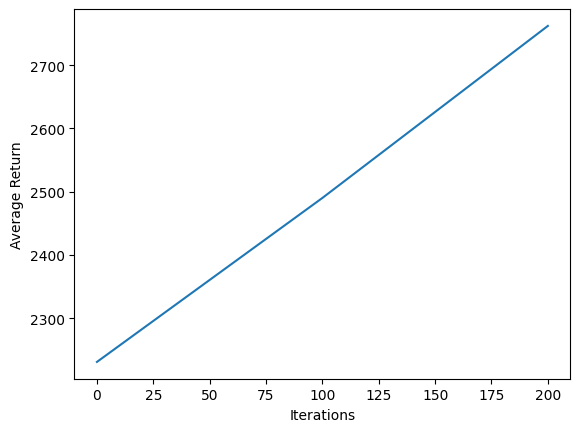

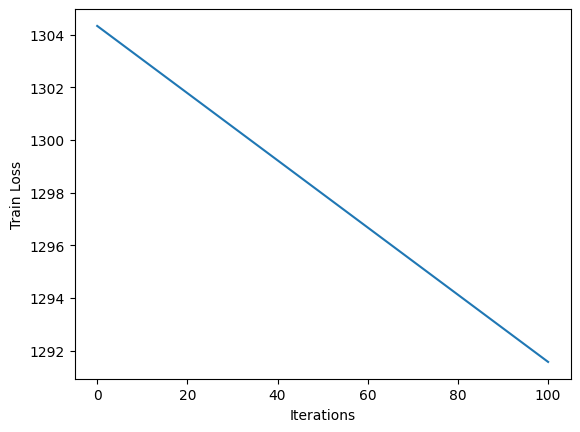

********************ITERATION NUMBER #200
********************ITERATION NUMBER #201
********************ITERATION NUMBER #202
********************ITERATION NUMBER #203
********************ITERATION NUMBER #204
********************ITERATION NUMBER #205
********************ITERATION NUMBER #206
********************ITERATION NUMBER #207
********************ITERATION NUMBER #208
********************ITERATION NUMBER #209
********************ITERATION NUMBER #210
********************ITERATION NUMBER #211
********************ITERATION NUMBER #212
********************ITERATION NUMBER #213
********************ITERATION NUMBER #214
********************ITERATION NUMBER #215
********************ITERATION NUMBER #216
********************ITERATION NUMBER #217
********************ITERATION NUMBER #218
********************ITERATION NUMBER #219
********************ITERATION NUMBER #220
********************ITERATION NUMBER #221
********************ITERATION NUMBER #222
********************ITERATION NUMB

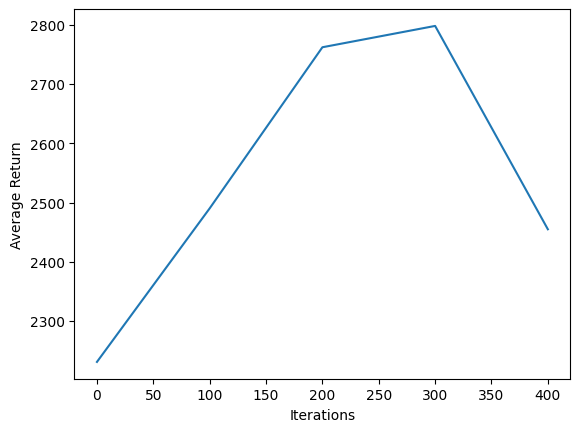

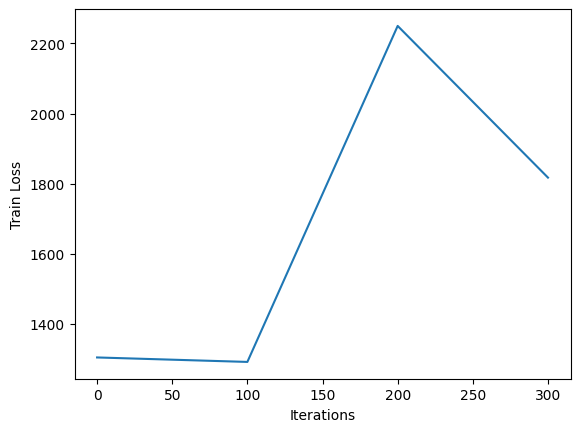

********************ITERATION NUMBER #400
********************ITERATION NUMBER #401
********************ITERATION NUMBER #402
********************ITERATION NUMBER #403
********************ITERATION NUMBER #404
********************ITERATION NUMBER #405
********************ITERATION NUMBER #406
********************ITERATION NUMBER #407
********************ITERATION NUMBER #408
********************ITERATION NUMBER #409
********************ITERATION NUMBER #410
********************ITERATION NUMBER #411
********************ITERATION NUMBER #412
********************ITERATION NUMBER #413
********************ITERATION NUMBER #414
********************ITERATION NUMBER #415
********************ITERATION NUMBER #416
********************ITERATION NUMBER #417
********************ITERATION NUMBER #418
********************ITERATION NUMBER #419
********************ITERATION NUMBER #420
********************ITERATION NUMBER #421
********************ITERATION NUMBER #422
********************ITERATION NUMB

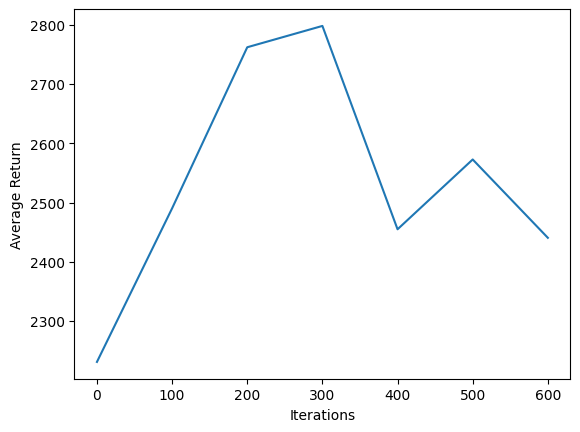

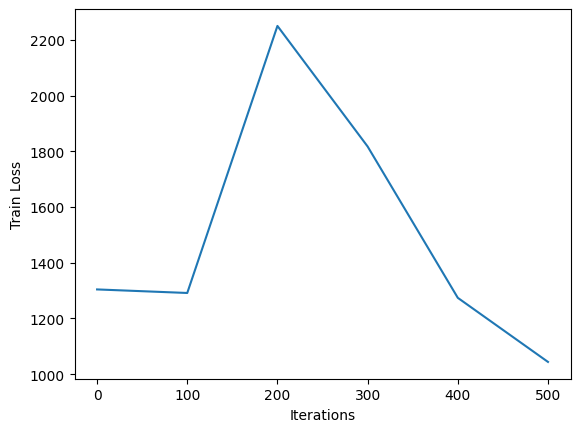

********************ITERATION NUMBER #600
********************ITERATION NUMBER #601
********************ITERATION NUMBER #602
********************ITERATION NUMBER #603
********************ITERATION NUMBER #604
********************ITERATION NUMBER #605
********************ITERATION NUMBER #606
********************ITERATION NUMBER #607
********************ITERATION NUMBER #608
********************ITERATION NUMBER #609
********************ITERATION NUMBER #610
********************ITERATION NUMBER #611
********************ITERATION NUMBER #612
********************ITERATION NUMBER #613
********************ITERATION NUMBER #614
********************ITERATION NUMBER #615
********************ITERATION NUMBER #616
********************ITERATION NUMBER #617
********************ITERATION NUMBER #618
********************ITERATION NUMBER #619
********************ITERATION NUMBER #620
********************ITERATION NUMBER #621
********************ITERATION NUMBER #622
********************ITERATION NUMB

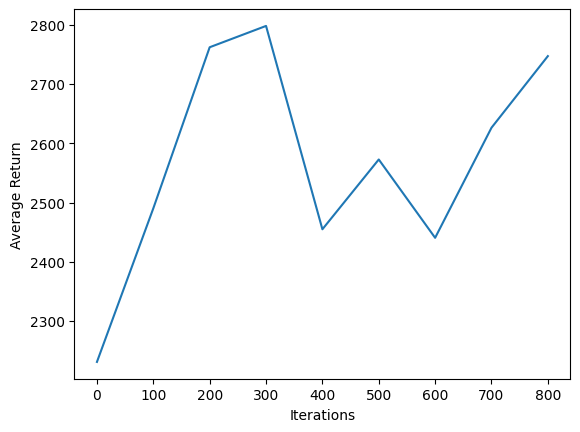

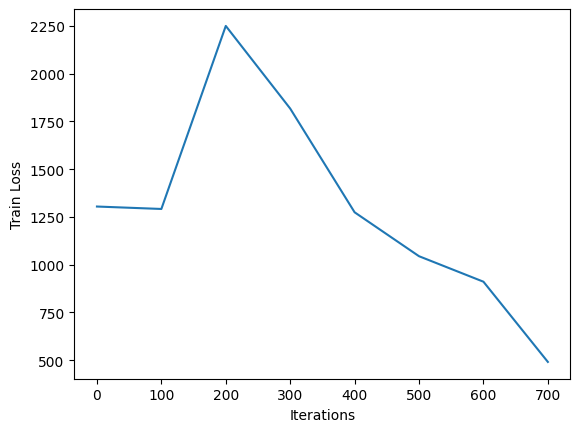

********************ITERATION NUMBER #800
********************ITERATION NUMBER #801
********************ITERATION NUMBER #802
********************ITERATION NUMBER #803
********************ITERATION NUMBER #804
********************ITERATION NUMBER #805
********************ITERATION NUMBER #806
********************ITERATION NUMBER #807
********************ITERATION NUMBER #808
********************ITERATION NUMBER #809
********************ITERATION NUMBER #810
********************ITERATION NUMBER #811
********************ITERATION NUMBER #812
********************ITERATION NUMBER #813
********************ITERATION NUMBER #814
********************ITERATION NUMBER #815
********************ITERATION NUMBER #816
********************ITERATION NUMBER #817
********************ITERATION NUMBER #818
********************ITERATION NUMBER #819
********************ITERATION NUMBER #820
********************ITERATION NUMBER #821
********************ITERATION NUMBER #822
********************ITERATION NUMB

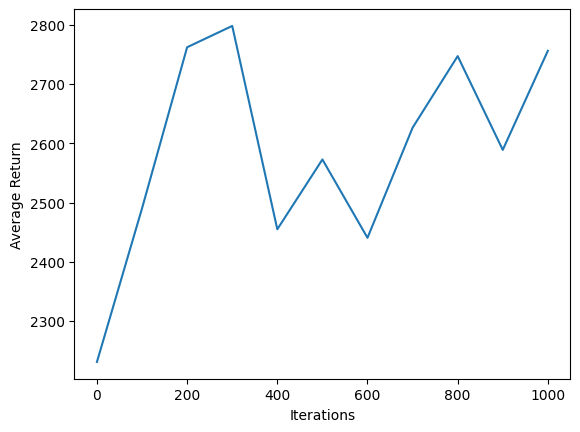

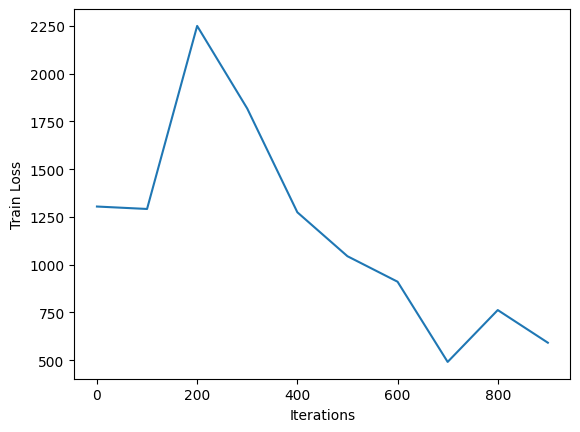

********************ITERATION NUMBER #1000
********************ITERATION NUMBER #1001
********************ITERATION NUMBER #1002
********************ITERATION NUMBER #1003
********************ITERATION NUMBER #1004
********************ITERATION NUMBER #1005
********************ITERATION NUMBER #1006
********************ITERATION NUMBER #1007
********************ITERATION NUMBER #1008
********************ITERATION NUMBER #1009
********************ITERATION NUMBER #1010
********************ITERATION NUMBER #1011
********************ITERATION NUMBER #1012
********************ITERATION NUMBER #1013
********************ITERATION NUMBER #1014
********************ITERATION NUMBER #1015
********************ITERATION NUMBER #1016
********************ITERATION NUMBER #1017
********************ITERATION NUMBER #1018
********************ITERATION NUMBER #1019
********************ITERATION NUMBER #1020
********************ITERATION NUMBER #1021
********************ITERATION NUMBER #1022
***********

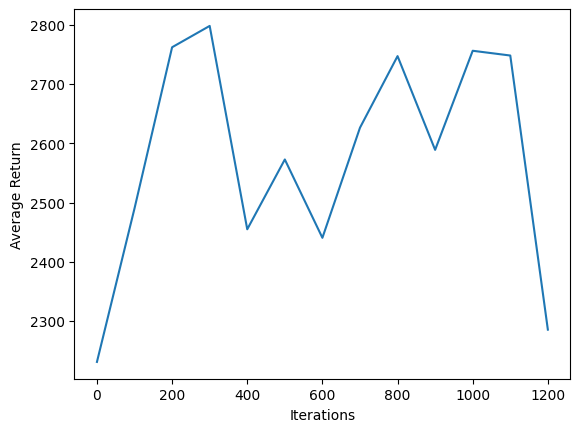

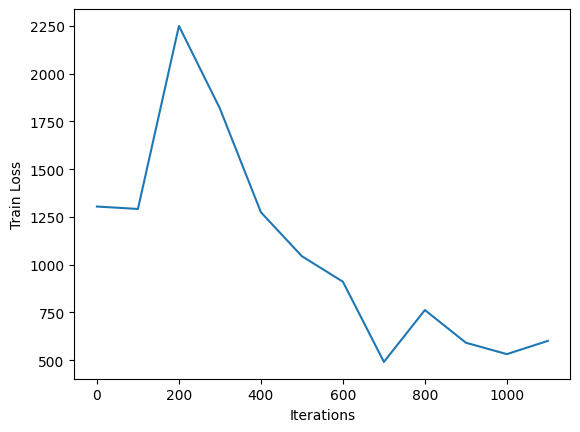

********************ITERATION NUMBER #1200
********************ITERATION NUMBER #1201
********************ITERATION NUMBER #1202
********************ITERATION NUMBER #1203
********************ITERATION NUMBER #1204
********************ITERATION NUMBER #1205
********************ITERATION NUMBER #1206
********************ITERATION NUMBER #1207
********************ITERATION NUMBER #1208
********************ITERATION NUMBER #1209
********************ITERATION NUMBER #1210
********************ITERATION NUMBER #1211
********************ITERATION NUMBER #1212
********************ITERATION NUMBER #1213
********************ITERATION NUMBER #1214
********************ITERATION NUMBER #1215
********************ITERATION NUMBER #1216
********************ITERATION NUMBER #1217
********************ITERATION NUMBER #1218
********************ITERATION NUMBER #1219
********************ITERATION NUMBER #1220
********************ITERATION NUMBER #1221
********************ITERATION NUMBER #1222
***********

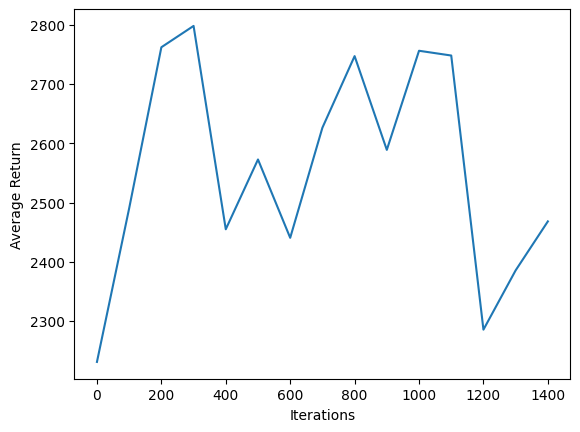

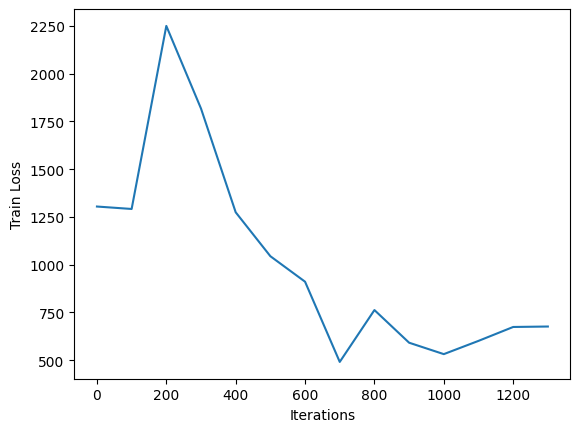

********************ITERATION NUMBER #1400
********************ITERATION NUMBER #1401
********************ITERATION NUMBER #1402
********************ITERATION NUMBER #1403
********************ITERATION NUMBER #1404
********************ITERATION NUMBER #1405
********************ITERATION NUMBER #1406
********************ITERATION NUMBER #1407
********************ITERATION NUMBER #1408
********************ITERATION NUMBER #1409
********************ITERATION NUMBER #1410
********************ITERATION NUMBER #1411
********************ITERATION NUMBER #1412
********************ITERATION NUMBER #1413
********************ITERATION NUMBER #1414
********************ITERATION NUMBER #1415
********************ITERATION NUMBER #1416
********************ITERATION NUMBER #1417
********************ITERATION NUMBER #1418
********************ITERATION NUMBER #1419
********************ITERATION NUMBER #1420
********************ITERATION NUMBER #1421
********************ITERATION NUMBER #1422
***********

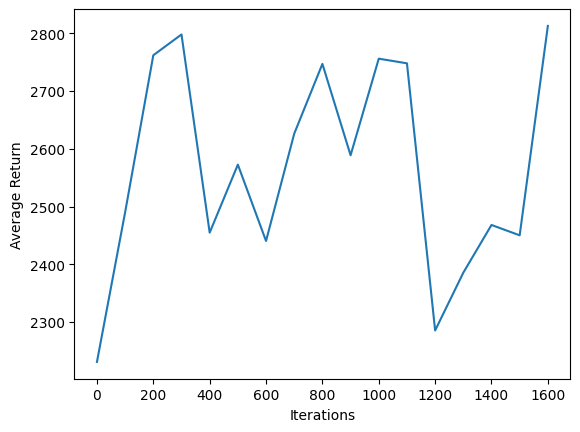

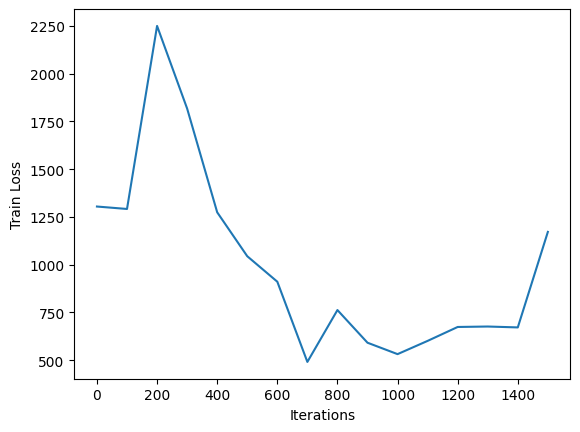

********************ITERATION NUMBER #1600
********************ITERATION NUMBER #1601
********************ITERATION NUMBER #1602
********************ITERATION NUMBER #1603
********************ITERATION NUMBER #1604
********************ITERATION NUMBER #1605
********************ITERATION NUMBER #1606
********************ITERATION NUMBER #1607
********************ITERATION NUMBER #1608
********************ITERATION NUMBER #1609
********************ITERATION NUMBER #1610
********************ITERATION NUMBER #1611
********************ITERATION NUMBER #1612
********************ITERATION NUMBER #1613
********************ITERATION NUMBER #1614
********************ITERATION NUMBER #1615
********************ITERATION NUMBER #1616
********************ITERATION NUMBER #1617
********************ITERATION NUMBER #1618
********************ITERATION NUMBER #1619
********************ITERATION NUMBER #1620
********************ITERATION NUMBER #1621
********************ITERATION NUMBER #1622
***********

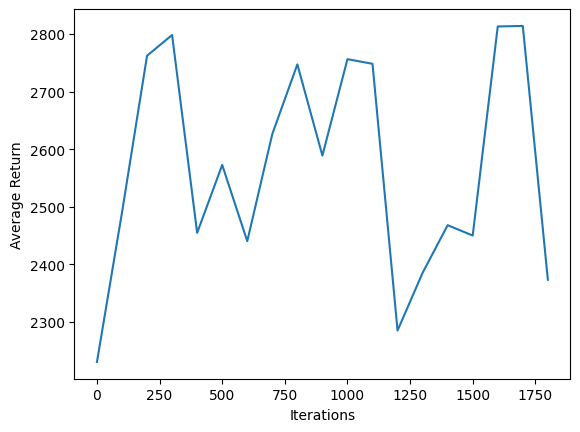

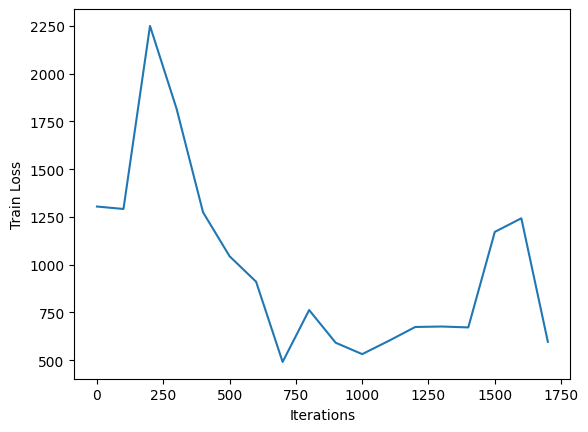

********************ITERATION NUMBER #1800
********************ITERATION NUMBER #1801
********************ITERATION NUMBER #1802
********************ITERATION NUMBER #1803
********************ITERATION NUMBER #1804
********************ITERATION NUMBER #1805
********************ITERATION NUMBER #1806
********************ITERATION NUMBER #1807
********************ITERATION NUMBER #1808
********************ITERATION NUMBER #1809
********************ITERATION NUMBER #1810
********************ITERATION NUMBER #1811
********************ITERATION NUMBER #1812
********************ITERATION NUMBER #1813
********************ITERATION NUMBER #1814
********************ITERATION NUMBER #1815
********************ITERATION NUMBER #1816
********************ITERATION NUMBER #1817
********************ITERATION NUMBER #1818
********************ITERATION NUMBER #1819
********************ITERATION NUMBER #1820
********************ITERATION NUMBER #1821
********************ITERATION NUMBER #1822
***********

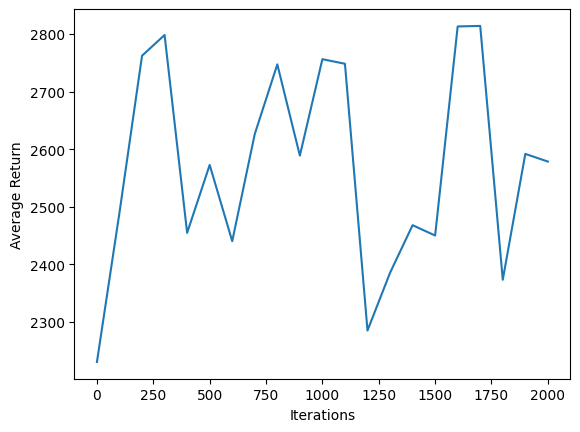

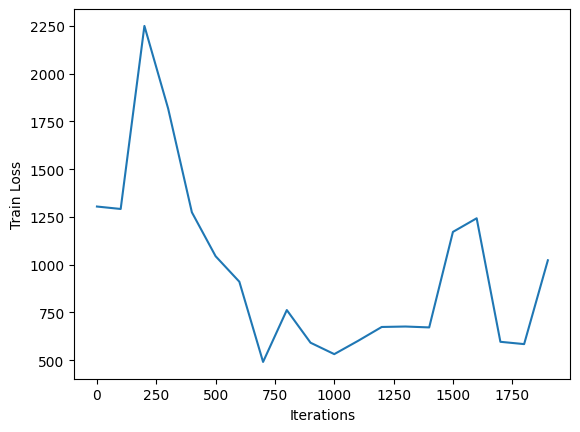

********************ITERATION NUMBER #2000
********************ITERATION NUMBER #2001
********************ITERATION NUMBER #2002
********************ITERATION NUMBER #2003
********************ITERATION NUMBER #2004
********************ITERATION NUMBER #2005
********************ITERATION NUMBER #2006
********************ITERATION NUMBER #2007
********************ITERATION NUMBER #2008
********************ITERATION NUMBER #2009
********************ITERATION NUMBER #2010
********************ITERATION NUMBER #2011
********************ITERATION NUMBER #2012
********************ITERATION NUMBER #2013
********************ITERATION NUMBER #2014
********************ITERATION NUMBER #2015
********************ITERATION NUMBER #2016
********************ITERATION NUMBER #2017
********************ITERATION NUMBER #2018
********************ITERATION NUMBER #2019
********************ITERATION NUMBER #2020
********************ITERATION NUMBER #2021
********************ITERATION NUMBER #2022
***********

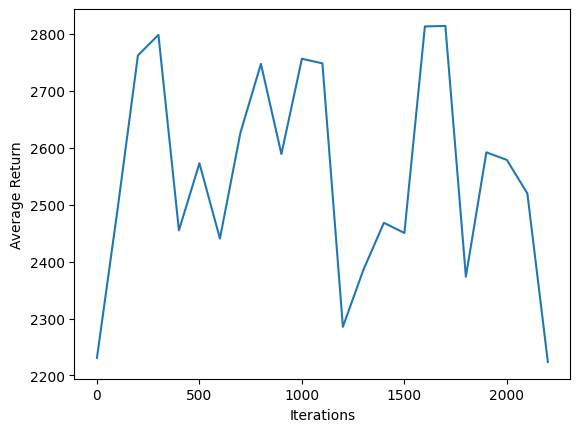

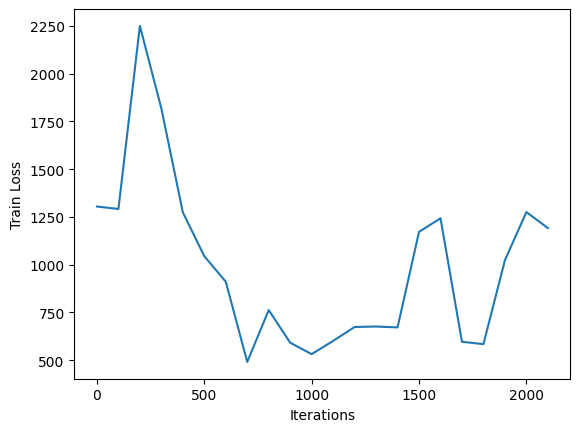

********************ITERATION NUMBER #2200
********************ITERATION NUMBER #2201
********************ITERATION NUMBER #2202
********************ITERATION NUMBER #2203
********************ITERATION NUMBER #2204
********************ITERATION NUMBER #2205
********************ITERATION NUMBER #2206
********************ITERATION NUMBER #2207
********************ITERATION NUMBER #2208
********************ITERATION NUMBER #2209
********************ITERATION NUMBER #2210
********************ITERATION NUMBER #2211
********************ITERATION NUMBER #2212
********************ITERATION NUMBER #2213
********************ITERATION NUMBER #2214
********************ITERATION NUMBER #2215
********************ITERATION NUMBER #2216
********************ITERATION NUMBER #2217
********************ITERATION NUMBER #2218
********************ITERATION NUMBER #2219
********************ITERATION NUMBER #2220
********************ITERATION NUMBER #2221
********************ITERATION NUMBER #2222
***********

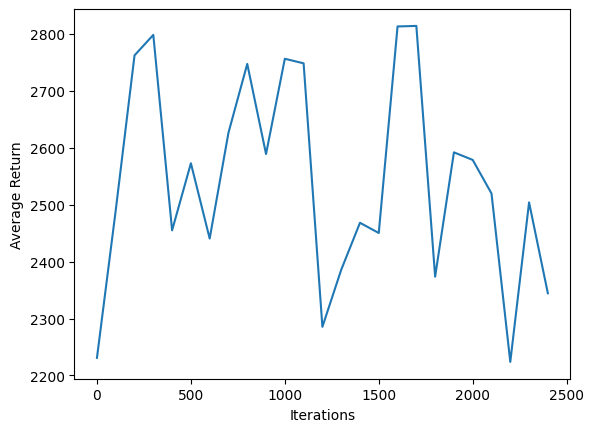

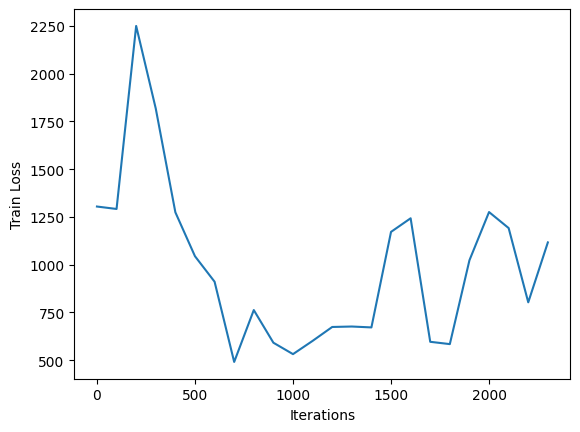

********************ITERATION NUMBER #2400
********************ITERATION NUMBER #2401
********************ITERATION NUMBER #2402
********************ITERATION NUMBER #2403
********************ITERATION NUMBER #2404
********************ITERATION NUMBER #2405
********************ITERATION NUMBER #2406
********************ITERATION NUMBER #2407
********************ITERATION NUMBER #2408
********************ITERATION NUMBER #2409
********************ITERATION NUMBER #2410
********************ITERATION NUMBER #2411
********************ITERATION NUMBER #2412
********************ITERATION NUMBER #2413
********************ITERATION NUMBER #2414
********************ITERATION NUMBER #2415
********************ITERATION NUMBER #2416
********************ITERATION NUMBER #2417
********************ITERATION NUMBER #2418
********************ITERATION NUMBER #2419
********************ITERATION NUMBER #2420
********************ITERATION NUMBER #2421
********************ITERATION NUMBER #2422
***********

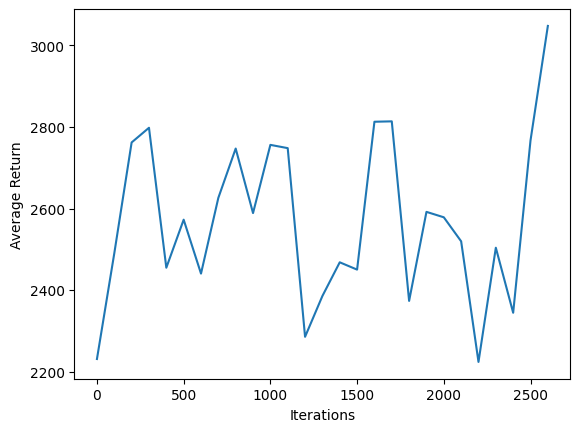

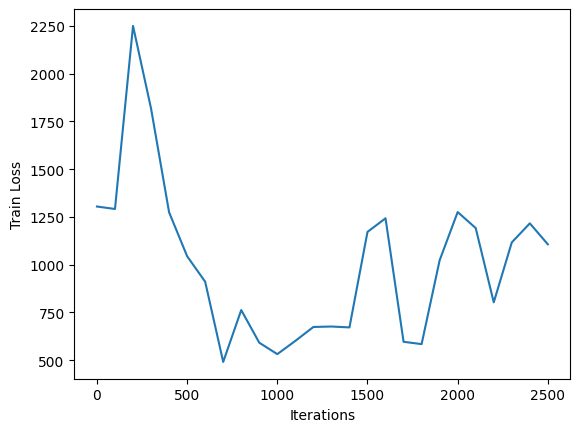

********************ITERATION NUMBER #2600
********************ITERATION NUMBER #2601
********************ITERATION NUMBER #2602
********************ITERATION NUMBER #2603
********************ITERATION NUMBER #2604
********************ITERATION NUMBER #2605
********************ITERATION NUMBER #2606
********************ITERATION NUMBER #2607
********************ITERATION NUMBER #2608
********************ITERATION NUMBER #2609
********************ITERATION NUMBER #2610
********************ITERATION NUMBER #2611
********************ITERATION NUMBER #2612
********************ITERATION NUMBER #2613
********************ITERATION NUMBER #2614
********************ITERATION NUMBER #2615
********************ITERATION NUMBER #2616
********************ITERATION NUMBER #2617
********************ITERATION NUMBER #2618
********************ITERATION NUMBER #2619
********************ITERATION NUMBER #2620
********************ITERATION NUMBER #2621
********************ITERATION NUMBER #2622
***********

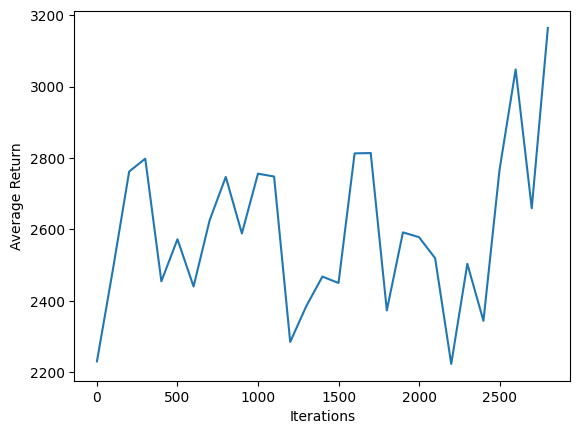

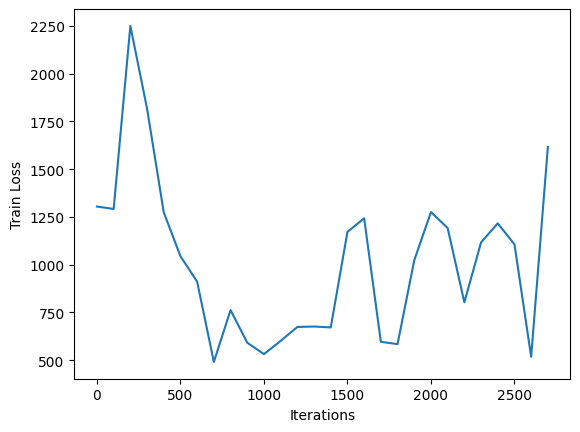

********************ITERATION NUMBER #2800
********************ITERATION NUMBER #2801
********************ITERATION NUMBER #2802
********************ITERATION NUMBER #2803
********************ITERATION NUMBER #2804
********************ITERATION NUMBER #2805
********************ITERATION NUMBER #2806
********************ITERATION NUMBER #2807
********************ITERATION NUMBER #2808
********************ITERATION NUMBER #2809
********************ITERATION NUMBER #2810
********************ITERATION NUMBER #2811
********************ITERATION NUMBER #2812
********************ITERATION NUMBER #2813
********************ITERATION NUMBER #2814
********************ITERATION NUMBER #2815
********************ITERATION NUMBER #2816
********************ITERATION NUMBER #2817
********************ITERATION NUMBER #2818
********************ITERATION NUMBER #2819
********************ITERATION NUMBER #2820
********************ITERATION NUMBER #2821
********************ITERATION NUMBER #2822
***********

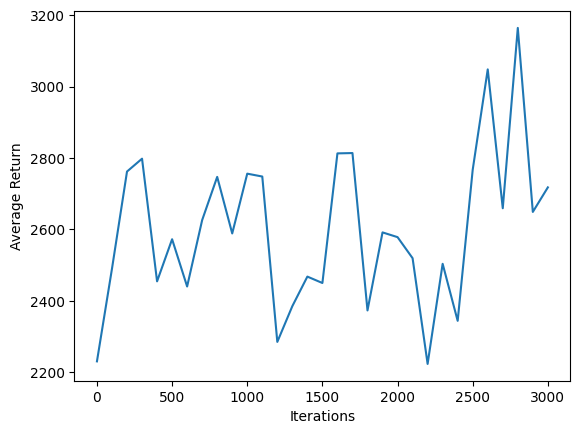

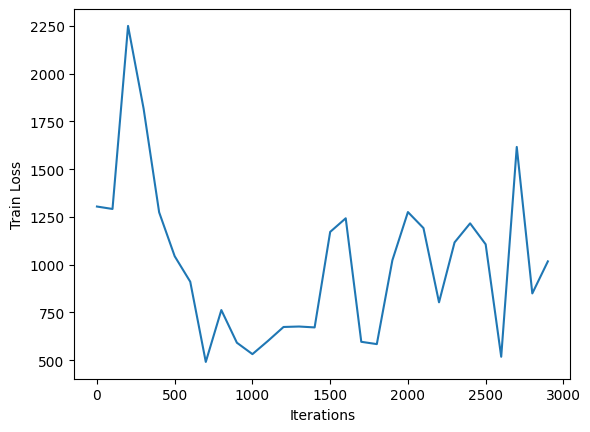

********************ITERATION NUMBER #3000
********************ITERATION NUMBER #3001
********************ITERATION NUMBER #3002
********************ITERATION NUMBER #3003
********************ITERATION NUMBER #3004
********************ITERATION NUMBER #3005
********************ITERATION NUMBER #3006
********************ITERATION NUMBER #3007
********************ITERATION NUMBER #3008
********************ITERATION NUMBER #3009
********************ITERATION NUMBER #3010
********************ITERATION NUMBER #3011
********************ITERATION NUMBER #3012
********************ITERATION NUMBER #3013
********************ITERATION NUMBER #3014
********************ITERATION NUMBER #3015
********************ITERATION NUMBER #3016
********************ITERATION NUMBER #3017
********************ITERATION NUMBER #3018
********************ITERATION NUMBER #3019
********************ITERATION NUMBER #3020
********************ITERATION NUMBER #3021
********************ITERATION NUMBER #3022
***********

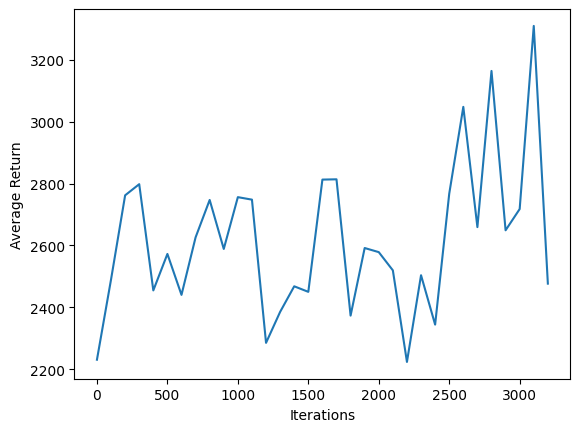

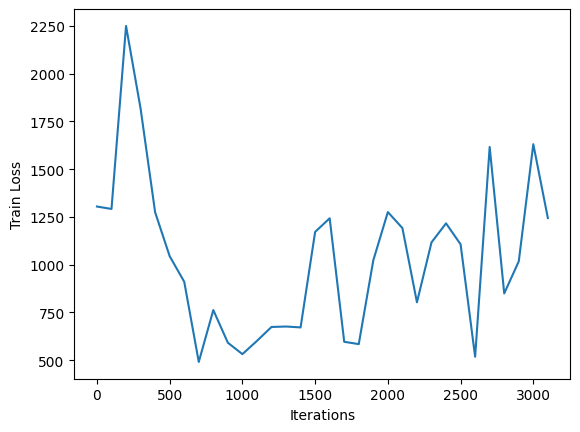

********************ITERATION NUMBER #3200
********************ITERATION NUMBER #3201
********************ITERATION NUMBER #3202
********************ITERATION NUMBER #3203
********************ITERATION NUMBER #3204
********************ITERATION NUMBER #3205
********************ITERATION NUMBER #3206
********************ITERATION NUMBER #3207
********************ITERATION NUMBER #3208
********************ITERATION NUMBER #3209
********************ITERATION NUMBER #3210
********************ITERATION NUMBER #3211
********************ITERATION NUMBER #3212
********************ITERATION NUMBER #3213
********************ITERATION NUMBER #3214
********************ITERATION NUMBER #3215
********************ITERATION NUMBER #3216
********************ITERATION NUMBER #3217
********************ITERATION NUMBER #3218
********************ITERATION NUMBER #3219
********************ITERATION NUMBER #3220
********************ITERATION NUMBER #3221
********************ITERATION NUMBER #3222
***********

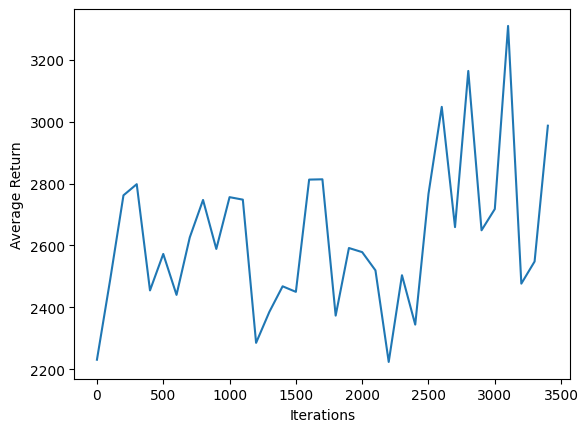

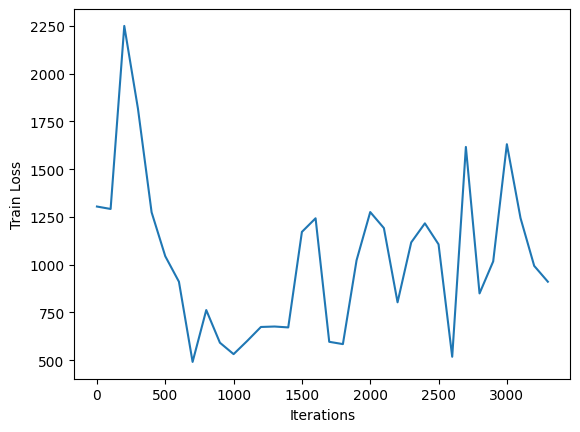

********************ITERATION NUMBER #3400
********************ITERATION NUMBER #3401
********************ITERATION NUMBER #3402
********************ITERATION NUMBER #3403
********************ITERATION NUMBER #3404
********************ITERATION NUMBER #3405
********************ITERATION NUMBER #3406
********************ITERATION NUMBER #3407
********************ITERATION NUMBER #3408
********************ITERATION NUMBER #3409
********************ITERATION NUMBER #3410
********************ITERATION NUMBER #3411
********************ITERATION NUMBER #3412
********************ITERATION NUMBER #3413
********************ITERATION NUMBER #3414
********************ITERATION NUMBER #3415
********************ITERATION NUMBER #3416
********************ITERATION NUMBER #3417
********************ITERATION NUMBER #3418
********************ITERATION NUMBER #3419
********************ITERATION NUMBER #3420
********************ITERATION NUMBER #3421
********************ITERATION NUMBER #3422
***********

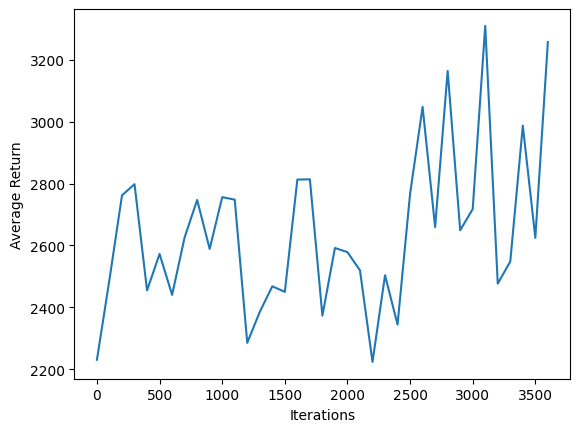

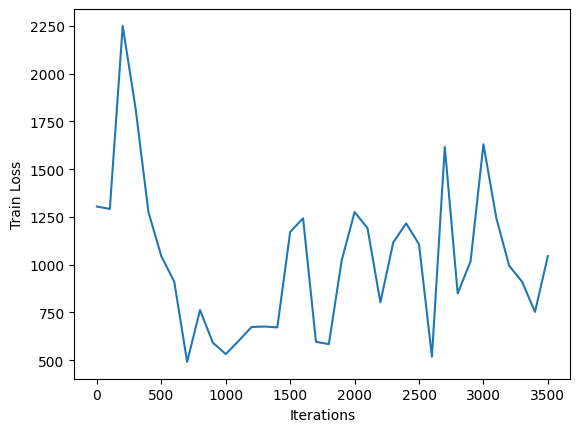

********************ITERATION NUMBER #3600
********************ITERATION NUMBER #3601
********************ITERATION NUMBER #3602
********************ITERATION NUMBER #3603
********************ITERATION NUMBER #3604
********************ITERATION NUMBER #3605
********************ITERATION NUMBER #3606
********************ITERATION NUMBER #3607
********************ITERATION NUMBER #3608
********************ITERATION NUMBER #3609
********************ITERATION NUMBER #3610
********************ITERATION NUMBER #3611
********************ITERATION NUMBER #3612
********************ITERATION NUMBER #3613
********************ITERATION NUMBER #3614
********************ITERATION NUMBER #3615
********************ITERATION NUMBER #3616
********************ITERATION NUMBER #3617
********************ITERATION NUMBER #3618
********************ITERATION NUMBER #3619
********************ITERATION NUMBER #3620
********************ITERATION NUMBER #3621
********************ITERATION NUMBER #3622
***********

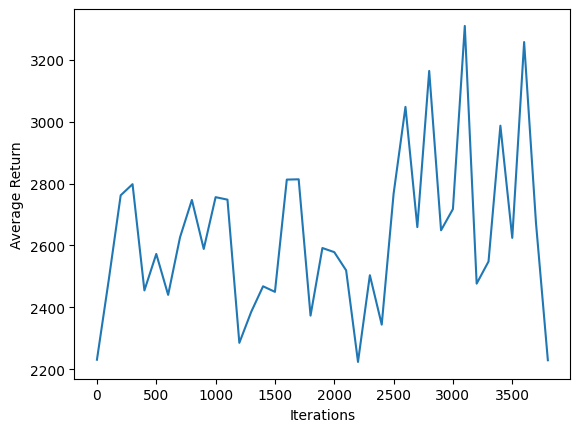

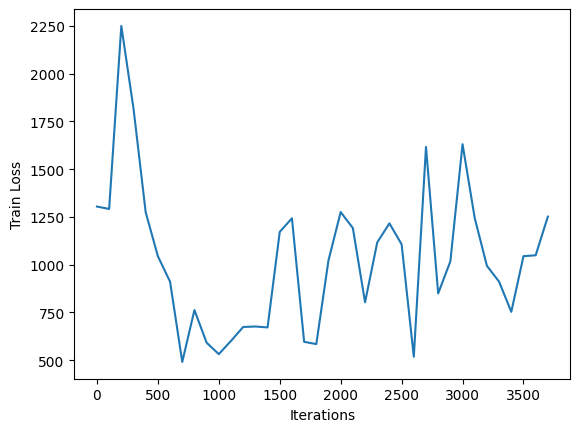

********************ITERATION NUMBER #3800
********************ITERATION NUMBER #3801
********************ITERATION NUMBER #3802
********************ITERATION NUMBER #3803
********************ITERATION NUMBER #3804
********************ITERATION NUMBER #3805
********************ITERATION NUMBER #3806
********************ITERATION NUMBER #3807
********************ITERATION NUMBER #3808
********************ITERATION NUMBER #3809
********************ITERATION NUMBER #3810
********************ITERATION NUMBER #3811
********************ITERATION NUMBER #3812
********************ITERATION NUMBER #3813
********************ITERATION NUMBER #3814
********************ITERATION NUMBER #3815
********************ITERATION NUMBER #3816
********************ITERATION NUMBER #3817
********************ITERATION NUMBER #3818
********************ITERATION NUMBER #3819
********************ITERATION NUMBER #3820
********************ITERATION NUMBER #3821
********************ITERATION NUMBER #3822
***********

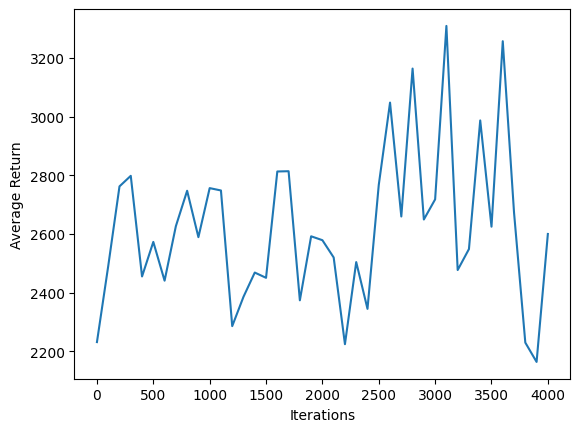

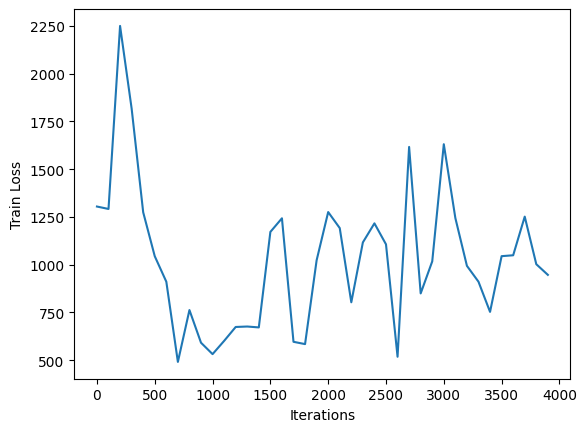

********************ITERATION NUMBER #4000
********************ITERATION NUMBER #4001
********************ITERATION NUMBER #4002
********************ITERATION NUMBER #4003
********************ITERATION NUMBER #4004
********************ITERATION NUMBER #4005
********************ITERATION NUMBER #4006
********************ITERATION NUMBER #4007
********************ITERATION NUMBER #4008
********************ITERATION NUMBER #4009
********************ITERATION NUMBER #4010
********************ITERATION NUMBER #4011
********************ITERATION NUMBER #4012
********************ITERATION NUMBER #4013
********************ITERATION NUMBER #4014
********************ITERATION NUMBER #4015
********************ITERATION NUMBER #4016
********************ITERATION NUMBER #4017
********************ITERATION NUMBER #4018
********************ITERATION NUMBER #4019
********************ITERATION NUMBER #4020
********************ITERATION NUMBER #4021
********************ITERATION NUMBER #4022
***********

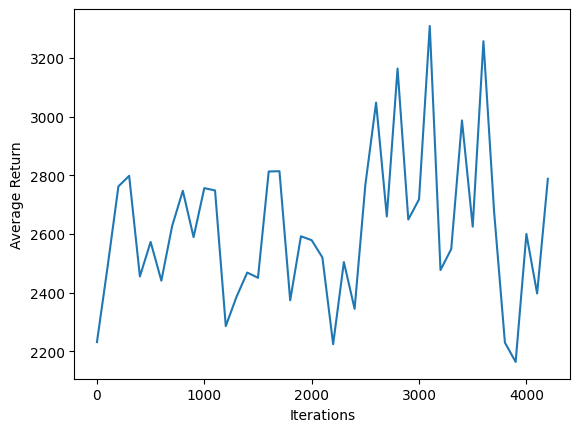

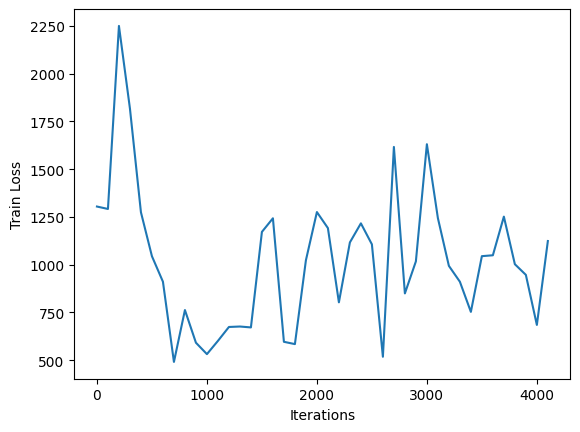

********************ITERATION NUMBER #4200
********************ITERATION NUMBER #4201
********************ITERATION NUMBER #4202
********************ITERATION NUMBER #4203
********************ITERATION NUMBER #4204
********************ITERATION NUMBER #4205
********************ITERATION NUMBER #4206
********************ITERATION NUMBER #4207
********************ITERATION NUMBER #4208
********************ITERATION NUMBER #4209
********************ITERATION NUMBER #4210
********************ITERATION NUMBER #4211
********************ITERATION NUMBER #4212
********************ITERATION NUMBER #4213
********************ITERATION NUMBER #4214
********************ITERATION NUMBER #4215
********************ITERATION NUMBER #4216
********************ITERATION NUMBER #4217
********************ITERATION NUMBER #4218
********************ITERATION NUMBER #4219
********************ITERATION NUMBER #4220
********************ITERATION NUMBER #4221
********************ITERATION NUMBER #4222
***********

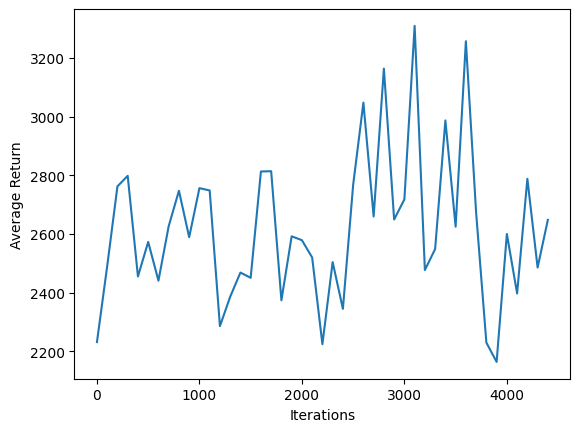

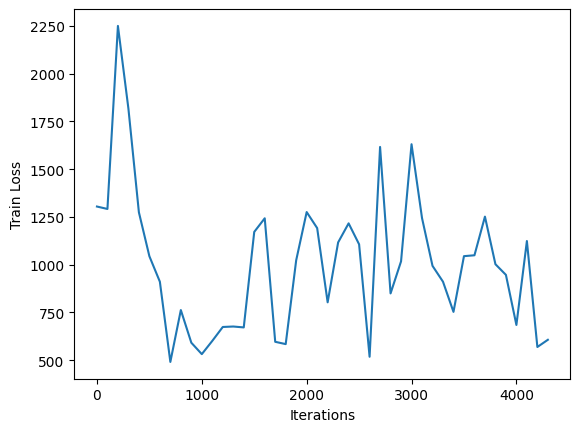

********************ITERATION NUMBER #4400
********************ITERATION NUMBER #4401
********************ITERATION NUMBER #4402
********************ITERATION NUMBER #4403
********************ITERATION NUMBER #4404
********************ITERATION NUMBER #4405
********************ITERATION NUMBER #4406
********************ITERATION NUMBER #4407
********************ITERATION NUMBER #4408
********************ITERATION NUMBER #4409
********************ITERATION NUMBER #4410
********************ITERATION NUMBER #4411
********************ITERATION NUMBER #4412
********************ITERATION NUMBER #4413
********************ITERATION NUMBER #4414
********************ITERATION NUMBER #4415
********************ITERATION NUMBER #4416
********************ITERATION NUMBER #4417
********************ITERATION NUMBER #4418
********************ITERATION NUMBER #4419
********************ITERATION NUMBER #4420
********************ITERATION NUMBER #4421
********************ITERATION NUMBER #4422
***********

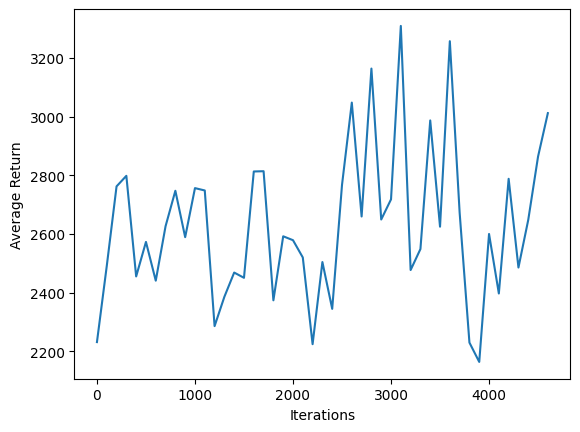

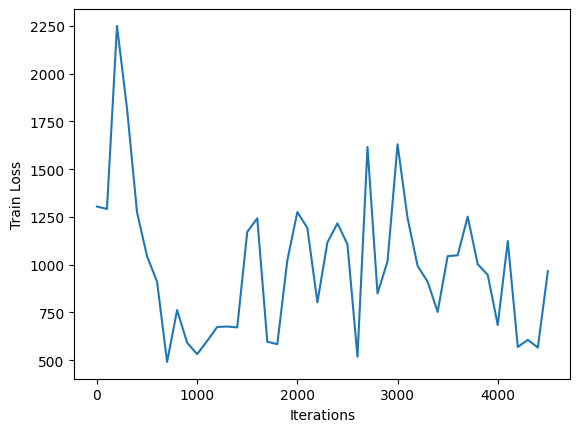

********************ITERATION NUMBER #4600
********************ITERATION NUMBER #4601
********************ITERATION NUMBER #4602
********************ITERATION NUMBER #4603
********************ITERATION NUMBER #4604
********************ITERATION NUMBER #4605
********************ITERATION NUMBER #4606
********************ITERATION NUMBER #4607
********************ITERATION NUMBER #4608
********************ITERATION NUMBER #4609
********************ITERATION NUMBER #4610
********************ITERATION NUMBER #4611
********************ITERATION NUMBER #4612
********************ITERATION NUMBER #4613
********************ITERATION NUMBER #4614
********************ITERATION NUMBER #4615
********************ITERATION NUMBER #4616
********************ITERATION NUMBER #4617
********************ITERATION NUMBER #4618
********************ITERATION NUMBER #4619
********************ITERATION NUMBER #4620
********************ITERATION NUMBER #4621
********************ITERATION NUMBER #4622
***********

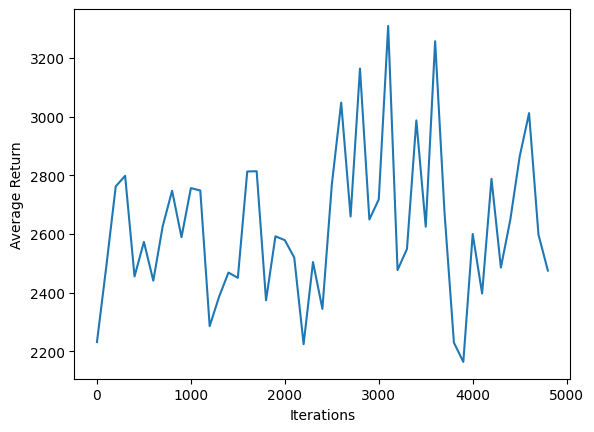

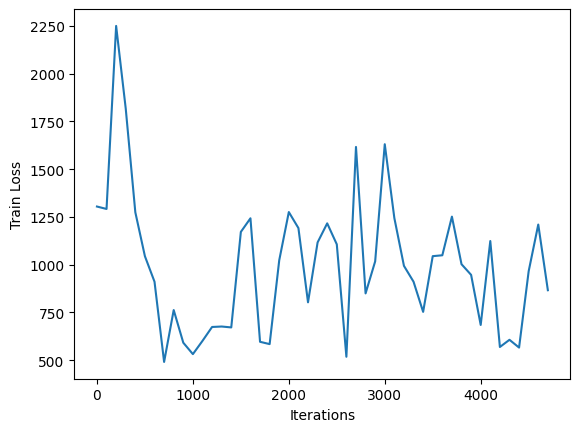

********************ITERATION NUMBER #4800
********************ITERATION NUMBER #4801
********************ITERATION NUMBER #4802
********************ITERATION NUMBER #4803
********************ITERATION NUMBER #4804
********************ITERATION NUMBER #4805
********************ITERATION NUMBER #4806
********************ITERATION NUMBER #4807
********************ITERATION NUMBER #4808
********************ITERATION NUMBER #4809
********************ITERATION NUMBER #4810
********************ITERATION NUMBER #4811
********************ITERATION NUMBER #4812
********************ITERATION NUMBER #4813
********************ITERATION NUMBER #4814
********************ITERATION NUMBER #4815
********************ITERATION NUMBER #4816
********************ITERATION NUMBER #4817
********************ITERATION NUMBER #4818
********************ITERATION NUMBER #4819
********************ITERATION NUMBER #4820
********************ITERATION NUMBER #4821
********************ITERATION NUMBER #4822
***********

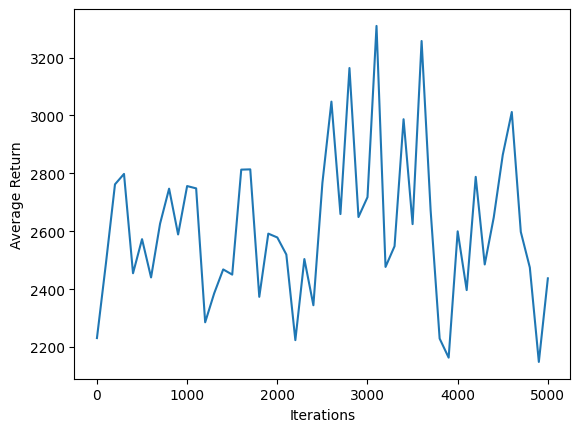

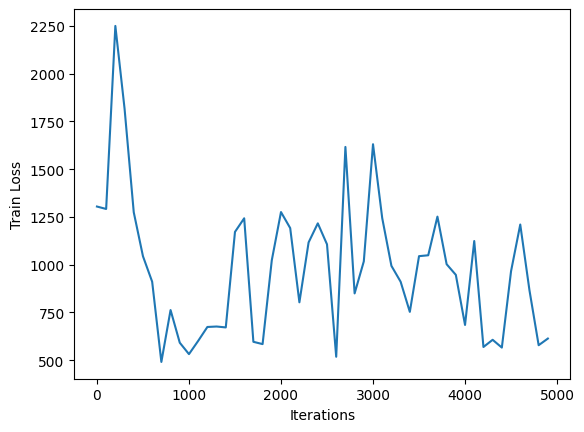

********************ITERATION NUMBER #5000
********************ITERATION NUMBER #5001
********************ITERATION NUMBER #5002
********************ITERATION NUMBER #5003
********************ITERATION NUMBER #5004
********************ITERATION NUMBER #5005
********************ITERATION NUMBER #5006
********************ITERATION NUMBER #5007
********************ITERATION NUMBER #5008
********************ITERATION NUMBER #5009
********************ITERATION NUMBER #5010
********************ITERATION NUMBER #5011
********************ITERATION NUMBER #5012
********************ITERATION NUMBER #5013
********************ITERATION NUMBER #5014
********************ITERATION NUMBER #5015
********************ITERATION NUMBER #5016
********************ITERATION NUMBER #5017
********************ITERATION NUMBER #5018
********************ITERATION NUMBER #5019
********************ITERATION NUMBER #5020
********************ITERATION NUMBER #5021
********************ITERATION NUMBER #5022
***********

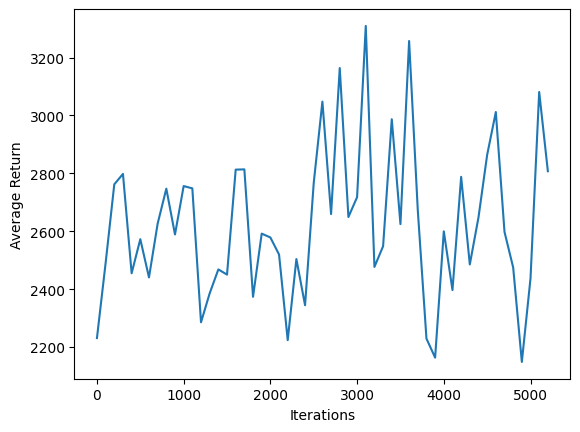

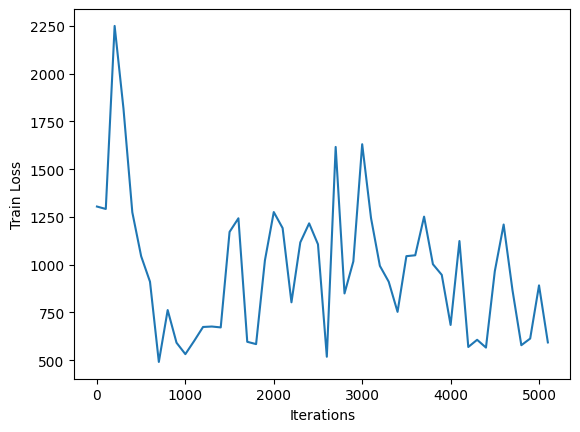

********************ITERATION NUMBER #5200
********************ITERATION NUMBER #5201
********************ITERATION NUMBER #5202
********************ITERATION NUMBER #5203
********************ITERATION NUMBER #5204
********************ITERATION NUMBER #5205
********************ITERATION NUMBER #5206
********************ITERATION NUMBER #5207
********************ITERATION NUMBER #5208
********************ITERATION NUMBER #5209
********************ITERATION NUMBER #5210
********************ITERATION NUMBER #5211
********************ITERATION NUMBER #5212
********************ITERATION NUMBER #5213
********************ITERATION NUMBER #5214
********************ITERATION NUMBER #5215
********************ITERATION NUMBER #5216
********************ITERATION NUMBER #5217
********************ITERATION NUMBER #5218
********************ITERATION NUMBER #5219
********************ITERATION NUMBER #5220
********************ITERATION NUMBER #5221
********************ITERATION NUMBER #5222
***********

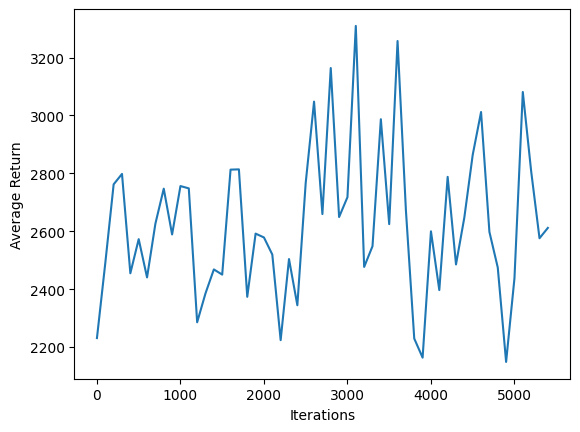

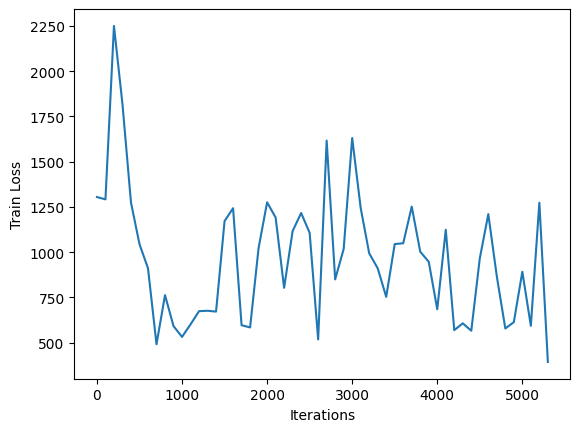

********************ITERATION NUMBER #5400
********************ITERATION NUMBER #5401
********************ITERATION NUMBER #5402
********************ITERATION NUMBER #5403
********************ITERATION NUMBER #5404
********************ITERATION NUMBER #5405
********************ITERATION NUMBER #5406
********************ITERATION NUMBER #5407
********************ITERATION NUMBER #5408
********************ITERATION NUMBER #5409
********************ITERATION NUMBER #5410
********************ITERATION NUMBER #5411
********************ITERATION NUMBER #5412
********************ITERATION NUMBER #5413
********************ITERATION NUMBER #5414
********************ITERATION NUMBER #5415
********************ITERATION NUMBER #5416
********************ITERATION NUMBER #5417
********************ITERATION NUMBER #5418
********************ITERATION NUMBER #5419
********************ITERATION NUMBER #5420
********************ITERATION NUMBER #5421
********************ITERATION NUMBER #5422
***********

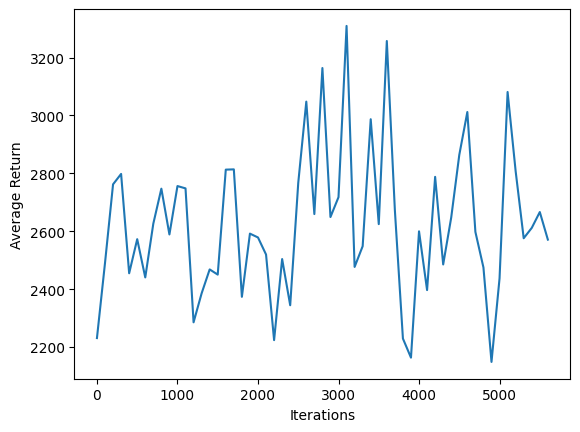

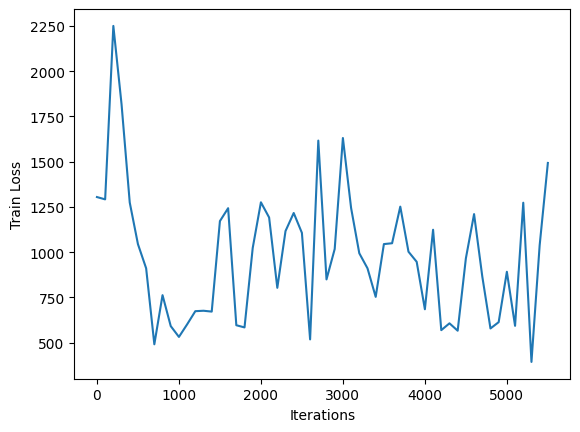

********************ITERATION NUMBER #5600
********************ITERATION NUMBER #5601
********************ITERATION NUMBER #5602
********************ITERATION NUMBER #5603
********************ITERATION NUMBER #5604
********************ITERATION NUMBER #5605
********************ITERATION NUMBER #5606
********************ITERATION NUMBER #5607
********************ITERATION NUMBER #5608
********************ITERATION NUMBER #5609
********************ITERATION NUMBER #5610
********************ITERATION NUMBER #5611
********************ITERATION NUMBER #5612
********************ITERATION NUMBER #5613
********************ITERATION NUMBER #5614
********************ITERATION NUMBER #5615
********************ITERATION NUMBER #5616
********************ITERATION NUMBER #5617
********************ITERATION NUMBER #5618
********************ITERATION NUMBER #5619
********************ITERATION NUMBER #5620
********************ITERATION NUMBER #5621
********************ITERATION NUMBER #5622
***********

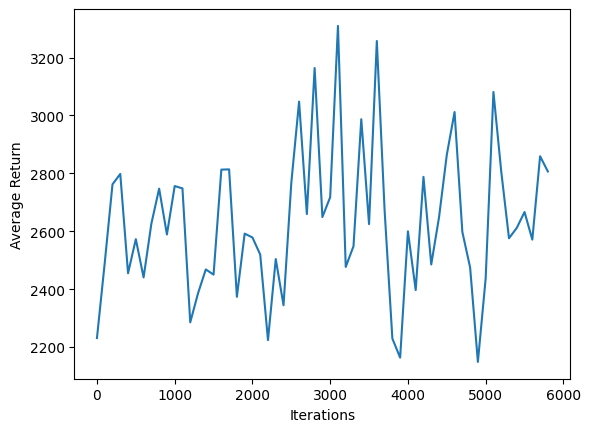

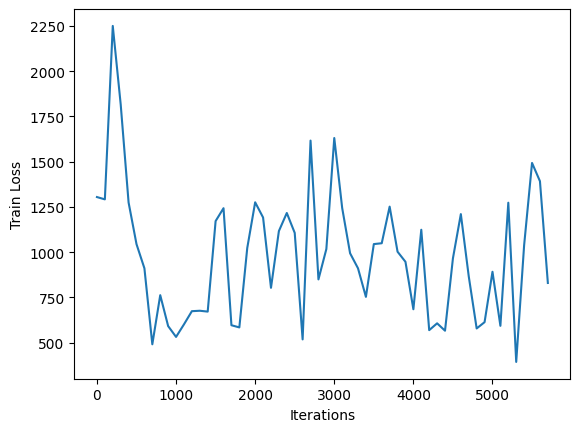

********************ITERATION NUMBER #5800
********************ITERATION NUMBER #5801
********************ITERATION NUMBER #5802
********************ITERATION NUMBER #5803
********************ITERATION NUMBER #5804
********************ITERATION NUMBER #5805
********************ITERATION NUMBER #5806
********************ITERATION NUMBER #5807
********************ITERATION NUMBER #5808
********************ITERATION NUMBER #5809
********************ITERATION NUMBER #5810
********************ITERATION NUMBER #5811
********************ITERATION NUMBER #5812
********************ITERATION NUMBER #5813
********************ITERATION NUMBER #5814
********************ITERATION NUMBER #5815
********************ITERATION NUMBER #5816
********************ITERATION NUMBER #5817
********************ITERATION NUMBER #5818
********************ITERATION NUMBER #5819
********************ITERATION NUMBER #5820
********************ITERATION NUMBER #5821
********************ITERATION NUMBER #5822
***********

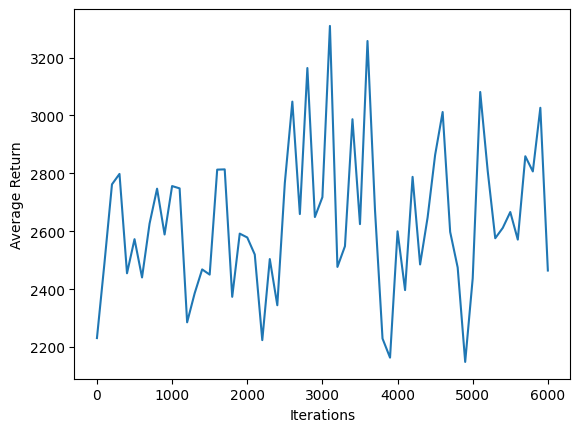

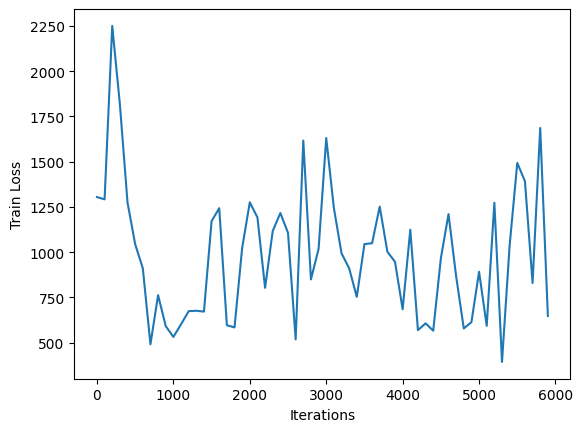

********************ITERATION NUMBER #6000
********************ITERATION NUMBER #6001
********************ITERATION NUMBER #6002
********************ITERATION NUMBER #6003
********************ITERATION NUMBER #6004
********************ITERATION NUMBER #6005
********************ITERATION NUMBER #6006
********************ITERATION NUMBER #6007
********************ITERATION NUMBER #6008
********************ITERATION NUMBER #6009
********************ITERATION NUMBER #6010
********************ITERATION NUMBER #6011
********************ITERATION NUMBER #6012
********************ITERATION NUMBER #6013
********************ITERATION NUMBER #6014
********************ITERATION NUMBER #6015
********************ITERATION NUMBER #6016
********************ITERATION NUMBER #6017
********************ITERATION NUMBER #6018
********************ITERATION NUMBER #6019
********************ITERATION NUMBER #6020
********************ITERATION NUMBER #6021
********************ITERATION NUMBER #6022
***********

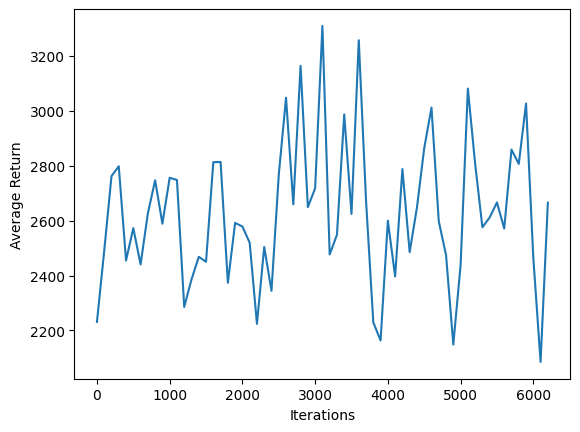

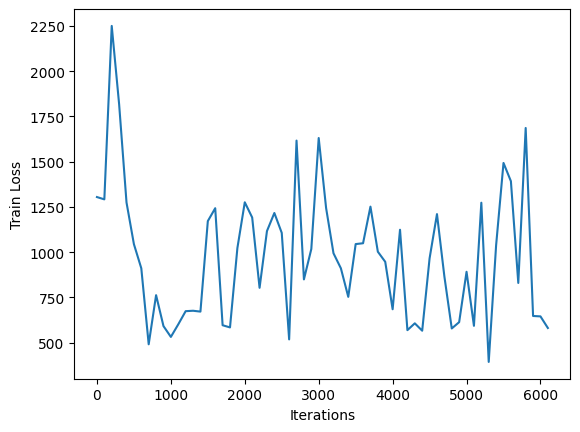

********************ITERATION NUMBER #6200
********************ITERATION NUMBER #6201
********************ITERATION NUMBER #6202
********************ITERATION NUMBER #6203
********************ITERATION NUMBER #6204
********************ITERATION NUMBER #6205
********************ITERATION NUMBER #6206
********************ITERATION NUMBER #6207
********************ITERATION NUMBER #6208
********************ITERATION NUMBER #6209
********************ITERATION NUMBER #6210
********************ITERATION NUMBER #6211
********************ITERATION NUMBER #6212
********************ITERATION NUMBER #6213
********************ITERATION NUMBER #6214
********************ITERATION NUMBER #6215
********************ITERATION NUMBER #6216
********************ITERATION NUMBER #6217
********************ITERATION NUMBER #6218
********************ITERATION NUMBER #6219
********************ITERATION NUMBER #6220
********************ITERATION NUMBER #6221
********************ITERATION NUMBER #6222
***********

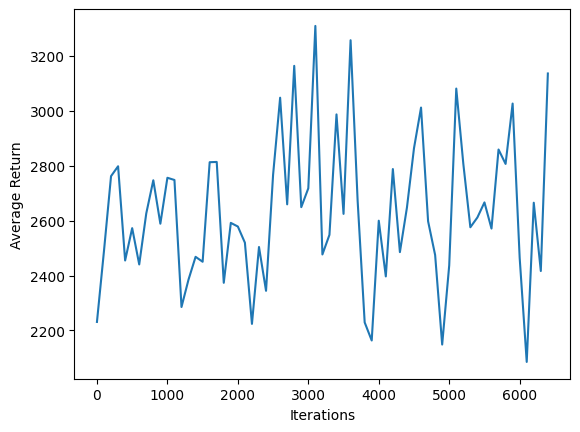

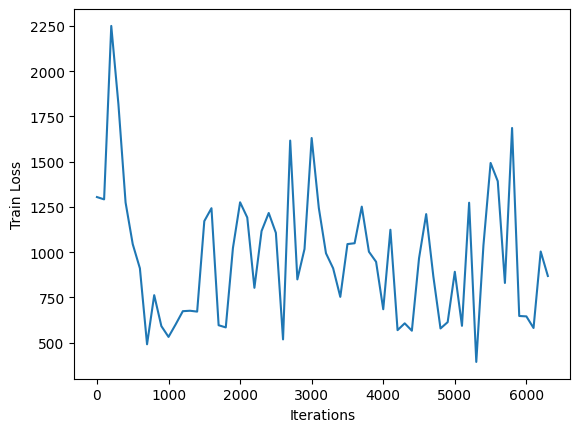

********************ITERATION NUMBER #6400
********************ITERATION NUMBER #6401
********************ITERATION NUMBER #6402
********************ITERATION NUMBER #6403
********************ITERATION NUMBER #6404
********************ITERATION NUMBER #6405
********************ITERATION NUMBER #6406
********************ITERATION NUMBER #6407
********************ITERATION NUMBER #6408
********************ITERATION NUMBER #6409
********************ITERATION NUMBER #6410
********************ITERATION NUMBER #6411
********************ITERATION NUMBER #6412
********************ITERATION NUMBER #6413
********************ITERATION NUMBER #6414
********************ITERATION NUMBER #6415
********************ITERATION NUMBER #6416
********************ITERATION NUMBER #6417
********************ITERATION NUMBER #6418
********************ITERATION NUMBER #6419
********************ITERATION NUMBER #6420
********************ITERATION NUMBER #6421
********************ITERATION NUMBER #6422
***********

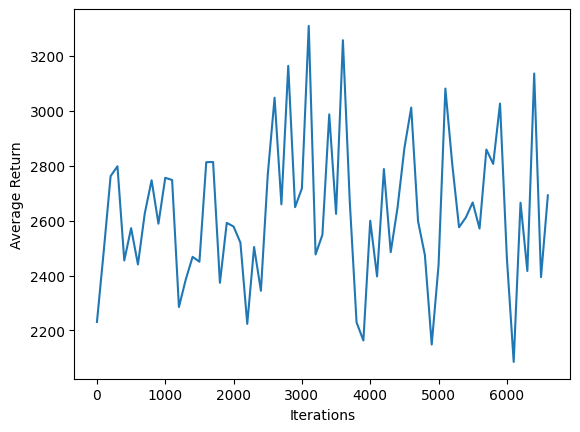

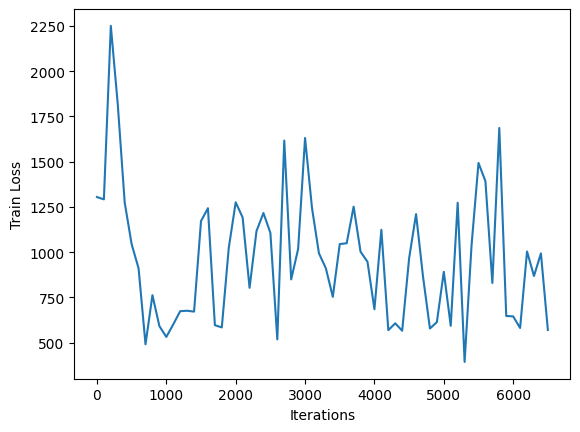

********************ITERATION NUMBER #6600
********************ITERATION NUMBER #6601
********************ITERATION NUMBER #6602
********************ITERATION NUMBER #6603
********************ITERATION NUMBER #6604
********************ITERATION NUMBER #6605
********************ITERATION NUMBER #6606
********************ITERATION NUMBER #6607
********************ITERATION NUMBER #6608
********************ITERATION NUMBER #6609
********************ITERATION NUMBER #6610
********************ITERATION NUMBER #6611
********************ITERATION NUMBER #6612
********************ITERATION NUMBER #6613
********************ITERATION NUMBER #6614
********************ITERATION NUMBER #6615
********************ITERATION NUMBER #6616
********************ITERATION NUMBER #6617
********************ITERATION NUMBER #6618
********************ITERATION NUMBER #6619
********************ITERATION NUMBER #6620
********************ITERATION NUMBER #6621
********************ITERATION NUMBER #6622
***********

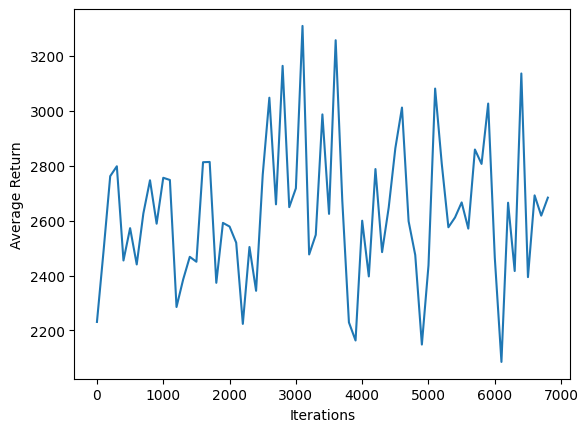

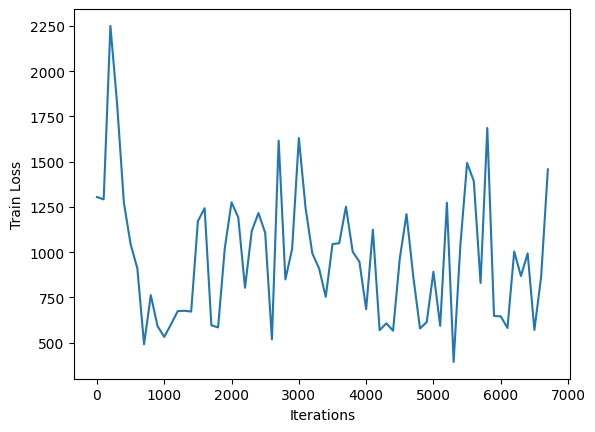

********************ITERATION NUMBER #6800
********************ITERATION NUMBER #6801
********************ITERATION NUMBER #6802
********************ITERATION NUMBER #6803
********************ITERATION NUMBER #6804
********************ITERATION NUMBER #6805
********************ITERATION NUMBER #6806
********************ITERATION NUMBER #6807
********************ITERATION NUMBER #6808
********************ITERATION NUMBER #6809
********************ITERATION NUMBER #6810
********************ITERATION NUMBER #6811
********************ITERATION NUMBER #6812
********************ITERATION NUMBER #6813
********************ITERATION NUMBER #6814
********************ITERATION NUMBER #6815
********************ITERATION NUMBER #6816
********************ITERATION NUMBER #6817
********************ITERATION NUMBER #6818
********************ITERATION NUMBER #6819
********************ITERATION NUMBER #6820
********************ITERATION NUMBER #6821
********************ITERATION NUMBER #6822
***********

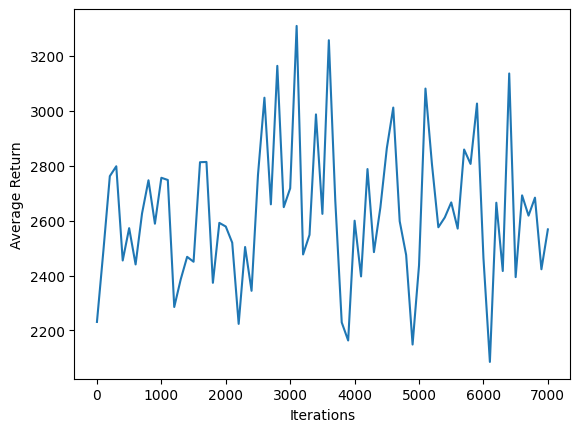

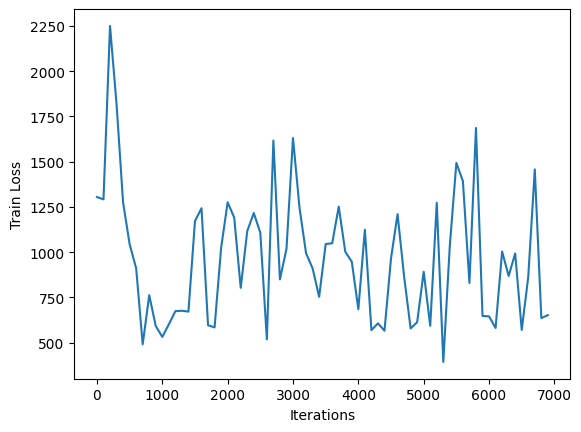

********************ITERATION NUMBER #7000
********************ITERATION NUMBER #7001
********************ITERATION NUMBER #7002
********************ITERATION NUMBER #7003
********************ITERATION NUMBER #7004
********************ITERATION NUMBER #7005
********************ITERATION NUMBER #7006
********************ITERATION NUMBER #7007
********************ITERATION NUMBER #7008
********************ITERATION NUMBER #7009
********************ITERATION NUMBER #7010
********************ITERATION NUMBER #7011
********************ITERATION NUMBER #7012
********************ITERATION NUMBER #7013
********************ITERATION NUMBER #7014
********************ITERATION NUMBER #7015
********************ITERATION NUMBER #7016
********************ITERATION NUMBER #7017
********************ITERATION NUMBER #7018
********************ITERATION NUMBER #7019
********************ITERATION NUMBER #7020
********************ITERATION NUMBER #7021
********************ITERATION NUMBER #7022
***********

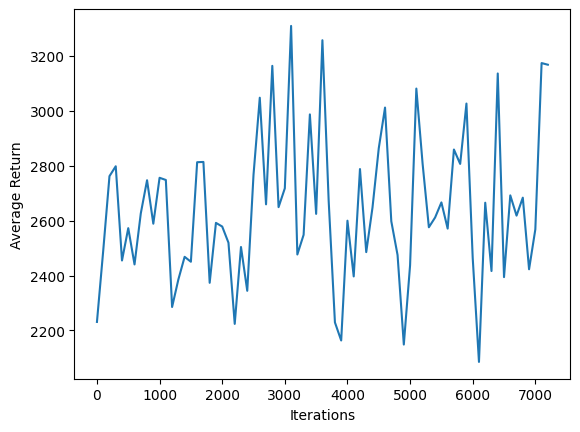

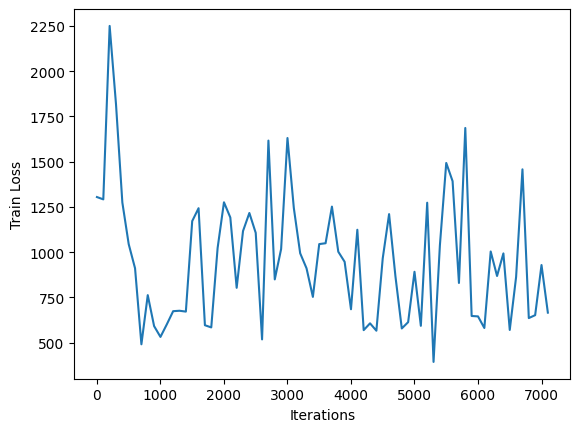

********************ITERATION NUMBER #7200
********************ITERATION NUMBER #7201
********************ITERATION NUMBER #7202
********************ITERATION NUMBER #7203
********************ITERATION NUMBER #7204
********************ITERATION NUMBER #7205
********************ITERATION NUMBER #7206
********************ITERATION NUMBER #7207
********************ITERATION NUMBER #7208
********************ITERATION NUMBER #7209
********************ITERATION NUMBER #7210
********************ITERATION NUMBER #7211
********************ITERATION NUMBER #7212
********************ITERATION NUMBER #7213
********************ITERATION NUMBER #7214
********************ITERATION NUMBER #7215
********************ITERATION NUMBER #7216
********************ITERATION NUMBER #7217
********************ITERATION NUMBER #7218
********************ITERATION NUMBER #7219
********************ITERATION NUMBER #7220
********************ITERATION NUMBER #7221
********************ITERATION NUMBER #7222
***********

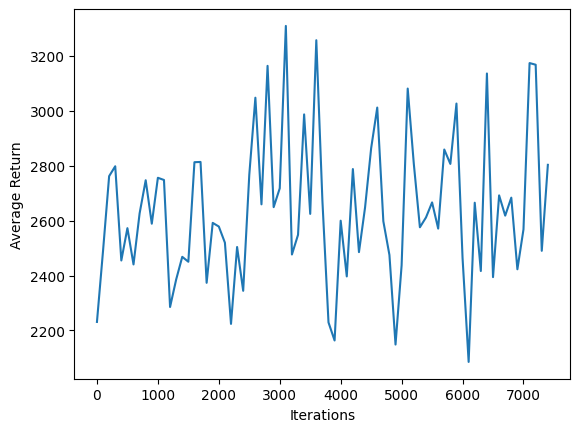

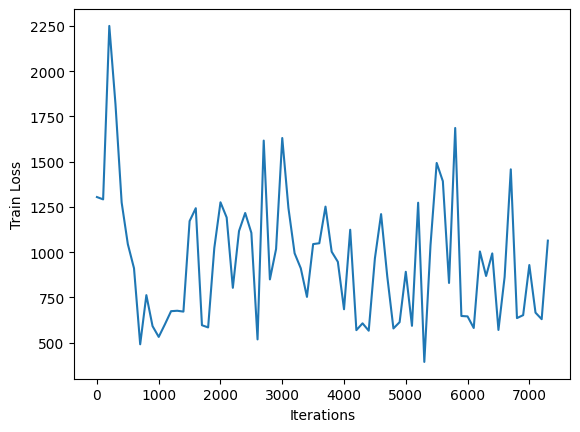

********************ITERATION NUMBER #7400
********************ITERATION NUMBER #7401
********************ITERATION NUMBER #7402
********************ITERATION NUMBER #7403
********************ITERATION NUMBER #7404
********************ITERATION NUMBER #7405
********************ITERATION NUMBER #7406
********************ITERATION NUMBER #7407
********************ITERATION NUMBER #7408
********************ITERATION NUMBER #7409
********************ITERATION NUMBER #7410
********************ITERATION NUMBER #7411
********************ITERATION NUMBER #7412
********************ITERATION NUMBER #7413
********************ITERATION NUMBER #7414
********************ITERATION NUMBER #7415
********************ITERATION NUMBER #7416
********************ITERATION NUMBER #7417
********************ITERATION NUMBER #7418
********************ITERATION NUMBER #7419
********************ITERATION NUMBER #7420
********************ITERATION NUMBER #7421
********************ITERATION NUMBER #7422
***********

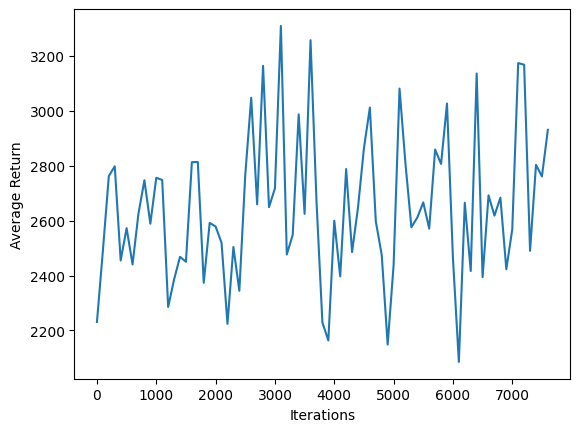

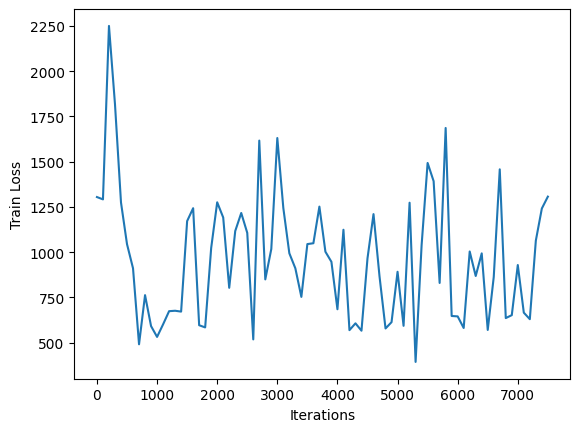

********************ITERATION NUMBER #7600
********************ITERATION NUMBER #7601
********************ITERATION NUMBER #7602
********************ITERATION NUMBER #7603
********************ITERATION NUMBER #7604
********************ITERATION NUMBER #7605
********************ITERATION NUMBER #7606
********************ITERATION NUMBER #7607
********************ITERATION NUMBER #7608
********************ITERATION NUMBER #7609
********************ITERATION NUMBER #7610
********************ITERATION NUMBER #7611
********************ITERATION NUMBER #7612
********************ITERATION NUMBER #7613
********************ITERATION NUMBER #7614
********************ITERATION NUMBER #7615
********************ITERATION NUMBER #7616
********************ITERATION NUMBER #7617
********************ITERATION NUMBER #7618
********************ITERATION NUMBER #7619
********************ITERATION NUMBER #7620
********************ITERATION NUMBER #7621
********************ITERATION NUMBER #7622
***********

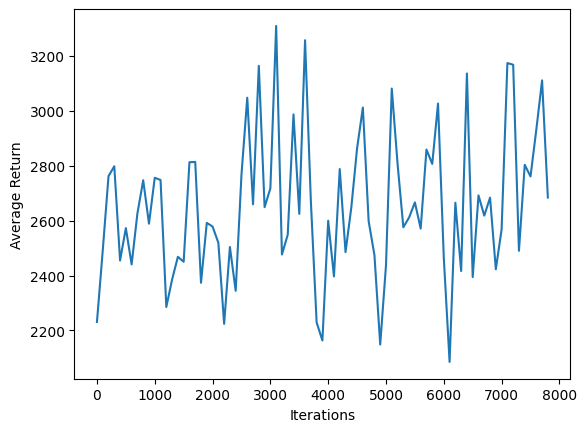

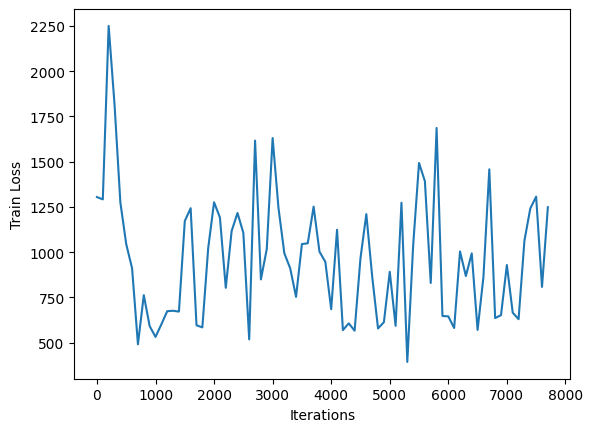

********************ITERATION NUMBER #7800
********************ITERATION NUMBER #7801
********************ITERATION NUMBER #7802
********************ITERATION NUMBER #7803
********************ITERATION NUMBER #7804
********************ITERATION NUMBER #7805
********************ITERATION NUMBER #7806
********************ITERATION NUMBER #7807
********************ITERATION NUMBER #7808
********************ITERATION NUMBER #7809
********************ITERATION NUMBER #7810
********************ITERATION NUMBER #7811
********************ITERATION NUMBER #7812
********************ITERATION NUMBER #7813
********************ITERATION NUMBER #7814
********************ITERATION NUMBER #7815
********************ITERATION NUMBER #7816
********************ITERATION NUMBER #7817
********************ITERATION NUMBER #7818
********************ITERATION NUMBER #7819
********************ITERATION NUMBER #7820
********************ITERATION NUMBER #7821
********************ITERATION NUMBER #7822
***********

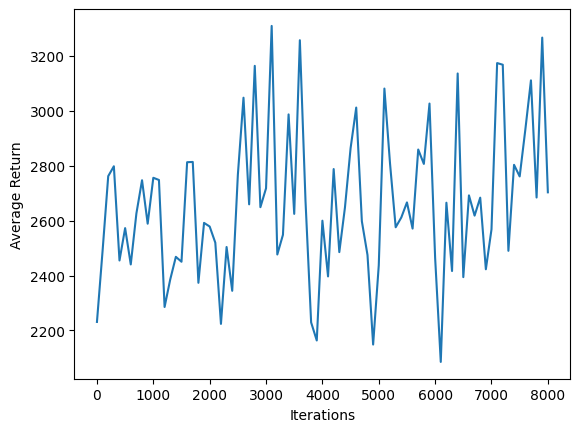

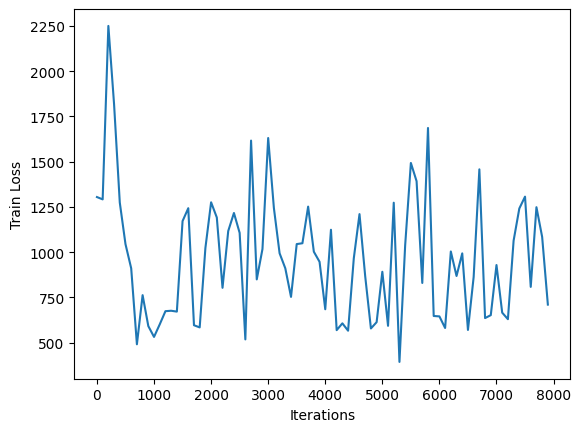

********************ITERATION NUMBER #8000
********************ITERATION NUMBER #8001
********************ITERATION NUMBER #8002
********************ITERATION NUMBER #8003
********************ITERATION NUMBER #8004
********************ITERATION NUMBER #8005
********************ITERATION NUMBER #8006
********************ITERATION NUMBER #8007
********************ITERATION NUMBER #8008
********************ITERATION NUMBER #8009
********************ITERATION NUMBER #8010
********************ITERATION NUMBER #8011
********************ITERATION NUMBER #8012
********************ITERATION NUMBER #8013
********************ITERATION NUMBER #8014
********************ITERATION NUMBER #8015
********************ITERATION NUMBER #8016
********************ITERATION NUMBER #8017
********************ITERATION NUMBER #8018
********************ITERATION NUMBER #8019
********************ITERATION NUMBER #8020
********************ITERATION NUMBER #8021
********************ITERATION NUMBER #8022
***********

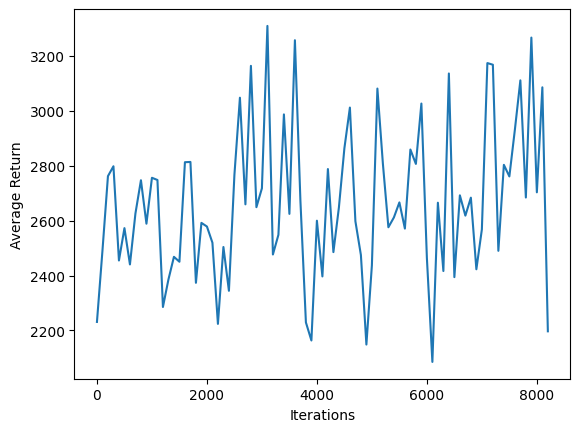

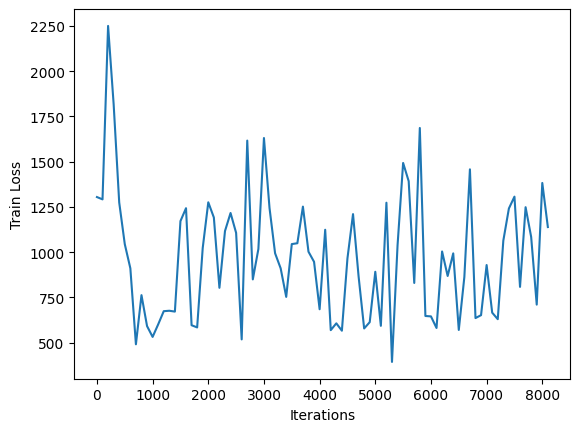

********************ITERATION NUMBER #8200
********************ITERATION NUMBER #8201
********************ITERATION NUMBER #8202
********************ITERATION NUMBER #8203
********************ITERATION NUMBER #8204
********************ITERATION NUMBER #8205
********************ITERATION NUMBER #8206
********************ITERATION NUMBER #8207
********************ITERATION NUMBER #8208
********************ITERATION NUMBER #8209
********************ITERATION NUMBER #8210
********************ITERATION NUMBER #8211
********************ITERATION NUMBER #8212
********************ITERATION NUMBER #8213
********************ITERATION NUMBER #8214
********************ITERATION NUMBER #8215
********************ITERATION NUMBER #8216
********************ITERATION NUMBER #8217
********************ITERATION NUMBER #8218
********************ITERATION NUMBER #8219
********************ITERATION NUMBER #8220
********************ITERATION NUMBER #8221
********************ITERATION NUMBER #8222
***********

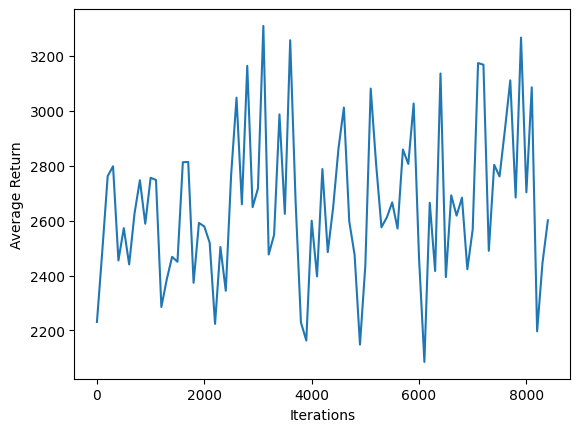

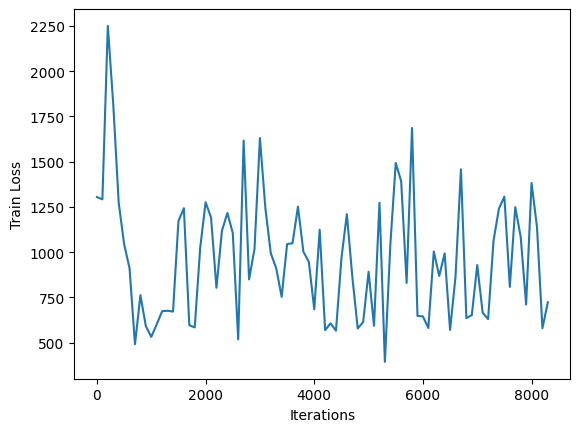

********************ITERATION NUMBER #8400
********************ITERATION NUMBER #8401
********************ITERATION NUMBER #8402
********************ITERATION NUMBER #8403
********************ITERATION NUMBER #8404
********************ITERATION NUMBER #8405
********************ITERATION NUMBER #8406
********************ITERATION NUMBER #8407
********************ITERATION NUMBER #8408
********************ITERATION NUMBER #8409
********************ITERATION NUMBER #8410
********************ITERATION NUMBER #8411
********************ITERATION NUMBER #8412
********************ITERATION NUMBER #8413
********************ITERATION NUMBER #8414
********************ITERATION NUMBER #8415
********************ITERATION NUMBER #8416
********************ITERATION NUMBER #8417
********************ITERATION NUMBER #8418
********************ITERATION NUMBER #8419
********************ITERATION NUMBER #8420
********************ITERATION NUMBER #8421
********************ITERATION NUMBER #8422
***********

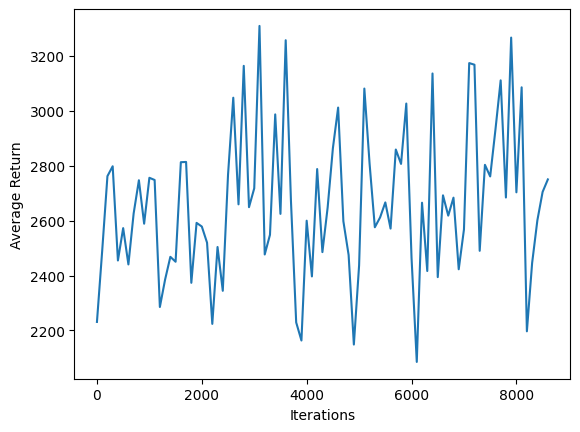

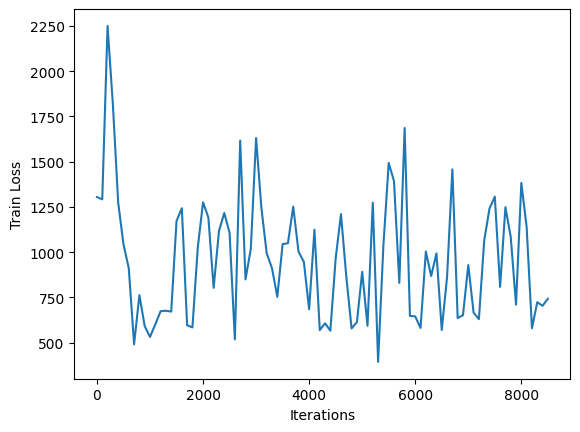

********************ITERATION NUMBER #8600
********************ITERATION NUMBER #8601
********************ITERATION NUMBER #8602
********************ITERATION NUMBER #8603
********************ITERATION NUMBER #8604
********************ITERATION NUMBER #8605
********************ITERATION NUMBER #8606
********************ITERATION NUMBER #8607
********************ITERATION NUMBER #8608
********************ITERATION NUMBER #8609
********************ITERATION NUMBER #8610
********************ITERATION NUMBER #8611
********************ITERATION NUMBER #8612
********************ITERATION NUMBER #8613
********************ITERATION NUMBER #8614
********************ITERATION NUMBER #8615
********************ITERATION NUMBER #8616
********************ITERATION NUMBER #8617
********************ITERATION NUMBER #8618
********************ITERATION NUMBER #8619
********************ITERATION NUMBER #8620
********************ITERATION NUMBER #8621
********************ITERATION NUMBER #8622
***********

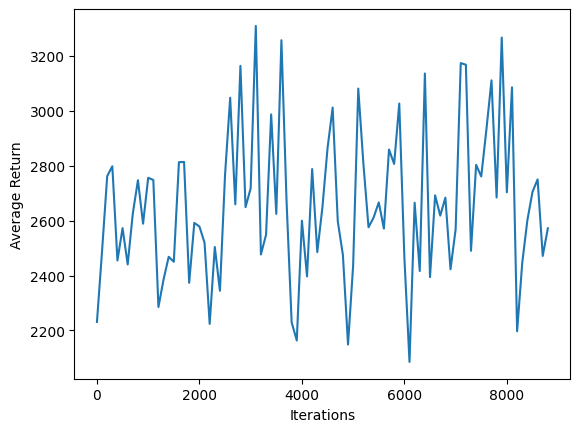

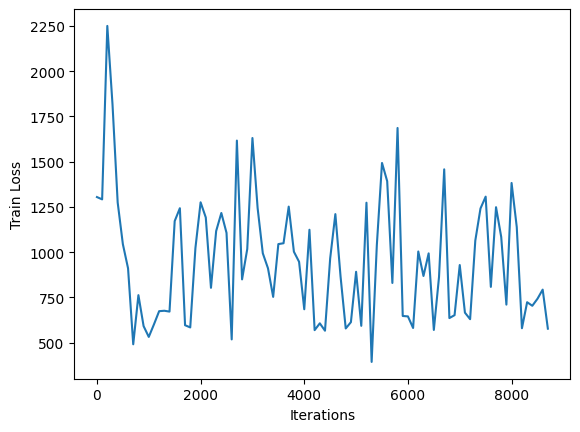

********************ITERATION NUMBER #8800
********************ITERATION NUMBER #8801
********************ITERATION NUMBER #8802
********************ITERATION NUMBER #8803
********************ITERATION NUMBER #8804
********************ITERATION NUMBER #8805
********************ITERATION NUMBER #8806
********************ITERATION NUMBER #8807
********************ITERATION NUMBER #8808
********************ITERATION NUMBER #8809
********************ITERATION NUMBER #8810
********************ITERATION NUMBER #8811
********************ITERATION NUMBER #8812
********************ITERATION NUMBER #8813
********************ITERATION NUMBER #8814
********************ITERATION NUMBER #8815
********************ITERATION NUMBER #8816
********************ITERATION NUMBER #8817
********************ITERATION NUMBER #8818
********************ITERATION NUMBER #8819
********************ITERATION NUMBER #8820
********************ITERATION NUMBER #8821
********************ITERATION NUMBER #8822
***********

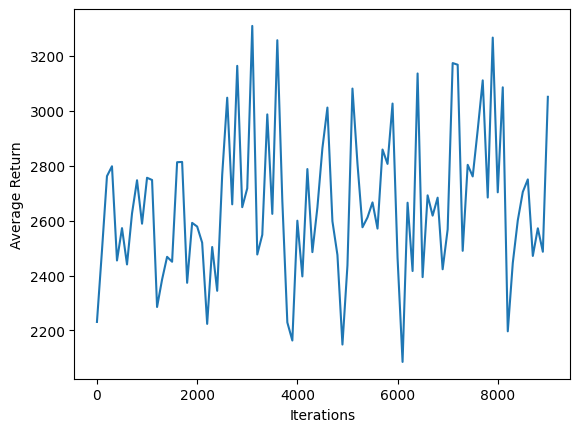

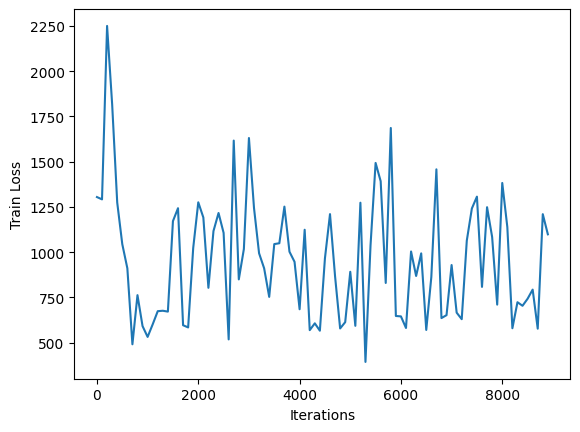

********************ITERATION NUMBER #9000
********************ITERATION NUMBER #9001
********************ITERATION NUMBER #9002
********************ITERATION NUMBER #9003
********************ITERATION NUMBER #9004
********************ITERATION NUMBER #9005
********************ITERATION NUMBER #9006
********************ITERATION NUMBER #9007
********************ITERATION NUMBER #9008
********************ITERATION NUMBER #9009
********************ITERATION NUMBER #9010
********************ITERATION NUMBER #9011
********************ITERATION NUMBER #9012
********************ITERATION NUMBER #9013
********************ITERATION NUMBER #9014
********************ITERATION NUMBER #9015
********************ITERATION NUMBER #9016
********************ITERATION NUMBER #9017
********************ITERATION NUMBER #9018
********************ITERATION NUMBER #9019
********************ITERATION NUMBER #9020
********************ITERATION NUMBER #9021
********************ITERATION NUMBER #9022
***********

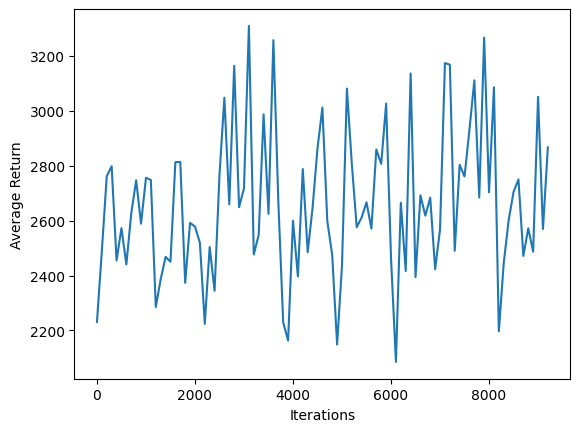

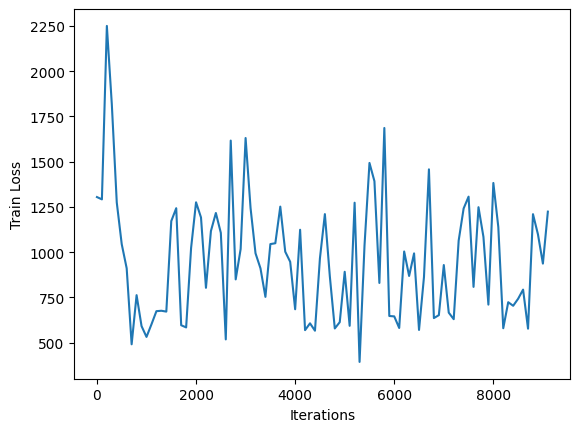

********************ITERATION NUMBER #9200
********************ITERATION NUMBER #9201
********************ITERATION NUMBER #9202
********************ITERATION NUMBER #9203
********************ITERATION NUMBER #9204
********************ITERATION NUMBER #9205
********************ITERATION NUMBER #9206
********************ITERATION NUMBER #9207
********************ITERATION NUMBER #9208
********************ITERATION NUMBER #9209
********************ITERATION NUMBER #9210
********************ITERATION NUMBER #9211
********************ITERATION NUMBER #9212
********************ITERATION NUMBER #9213
********************ITERATION NUMBER #9214
********************ITERATION NUMBER #9215
********************ITERATION NUMBER #9216
********************ITERATION NUMBER #9217
********************ITERATION NUMBER #9218
********************ITERATION NUMBER #9219
********************ITERATION NUMBER #9220
********************ITERATION NUMBER #9221
********************ITERATION NUMBER #9222
***********

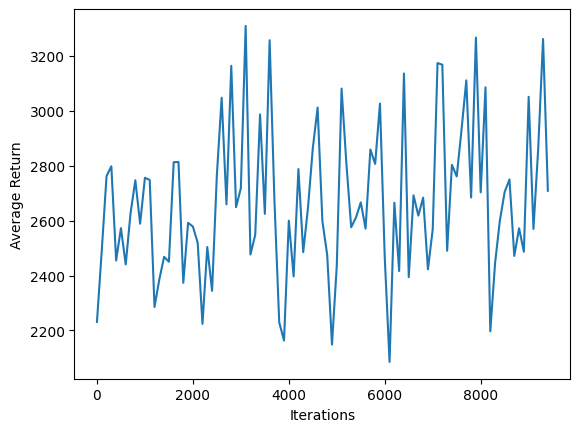

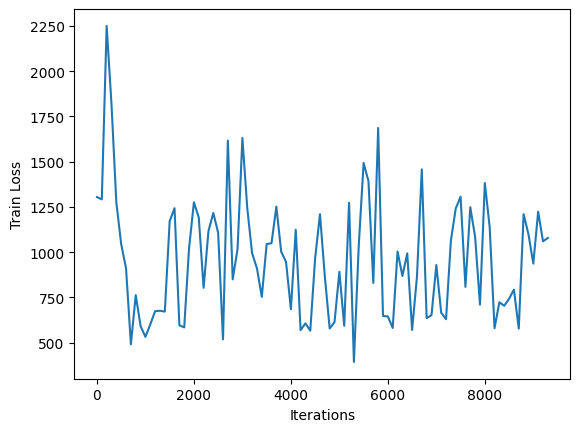

********************ITERATION NUMBER #9400
********************ITERATION NUMBER #9401
********************ITERATION NUMBER #9402
********************ITERATION NUMBER #9403
********************ITERATION NUMBER #9404
********************ITERATION NUMBER #9405
********************ITERATION NUMBER #9406
********************ITERATION NUMBER #9407
********************ITERATION NUMBER #9408
********************ITERATION NUMBER #9409
********************ITERATION NUMBER #9410
********************ITERATION NUMBER #9411
********************ITERATION NUMBER #9412
********************ITERATION NUMBER #9413
********************ITERATION NUMBER #9414
********************ITERATION NUMBER #9415
********************ITERATION NUMBER #9416
********************ITERATION NUMBER #9417
********************ITERATION NUMBER #9418
********************ITERATION NUMBER #9419
********************ITERATION NUMBER #9420
********************ITERATION NUMBER #9421
********************ITERATION NUMBER #9422
***********

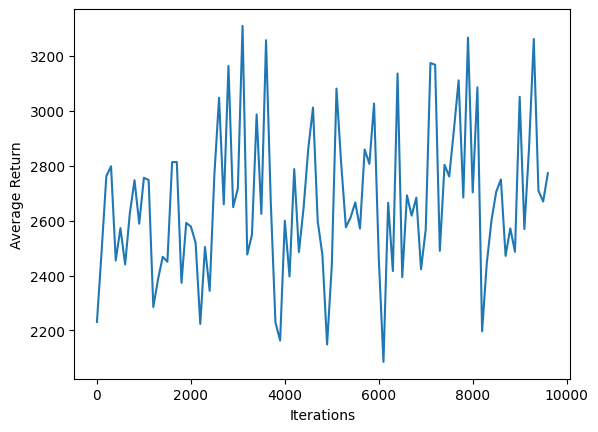

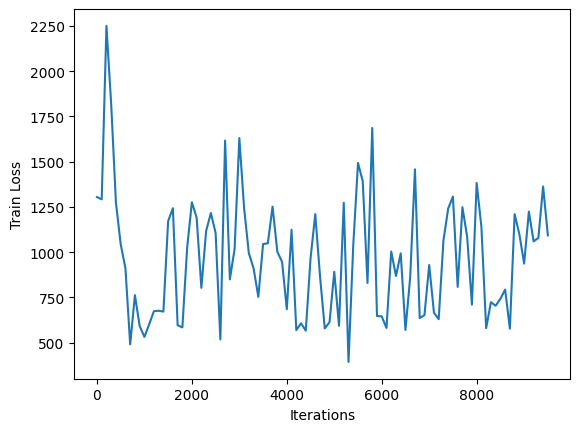

********************ITERATION NUMBER #9600
********************ITERATION NUMBER #9601
********************ITERATION NUMBER #9602
********************ITERATION NUMBER #9603
********************ITERATION NUMBER #9604
********************ITERATION NUMBER #9605
********************ITERATION NUMBER #9606
********************ITERATION NUMBER #9607
********************ITERATION NUMBER #9608
********************ITERATION NUMBER #9609
********************ITERATION NUMBER #9610
********************ITERATION NUMBER #9611
********************ITERATION NUMBER #9612
********************ITERATION NUMBER #9613
********************ITERATION NUMBER #9614
********************ITERATION NUMBER #9615
********************ITERATION NUMBER #9616
********************ITERATION NUMBER #9617
********************ITERATION NUMBER #9618
********************ITERATION NUMBER #9619
********************ITERATION NUMBER #9620
********************ITERATION NUMBER #9621
********************ITERATION NUMBER #9622
***********

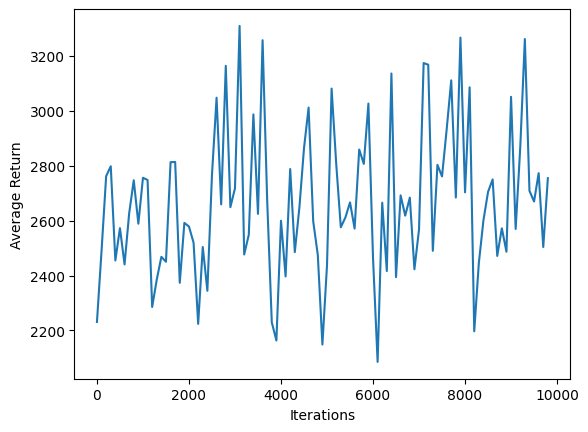

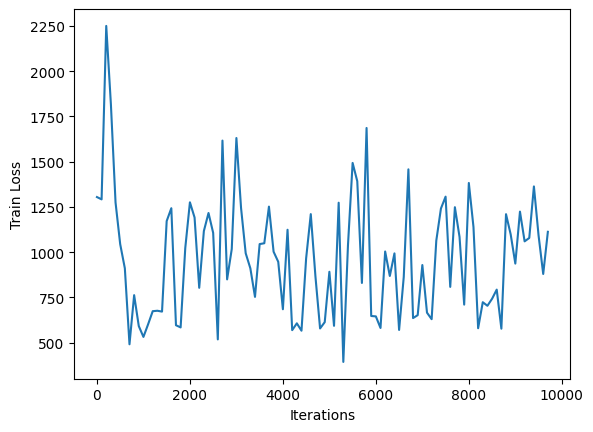

********************ITERATION NUMBER #9800
********************ITERATION NUMBER #9801
********************ITERATION NUMBER #9802
********************ITERATION NUMBER #9803
********************ITERATION NUMBER #9804
********************ITERATION NUMBER #9805
********************ITERATION NUMBER #9806
********************ITERATION NUMBER #9807
********************ITERATION NUMBER #9808
********************ITERATION NUMBER #9809
********************ITERATION NUMBER #9810
********************ITERATION NUMBER #9811
********************ITERATION NUMBER #9812
********************ITERATION NUMBER #9813
********************ITERATION NUMBER #9814
********************ITERATION NUMBER #9815
********************ITERATION NUMBER #9816
********************ITERATION NUMBER #9817
********************ITERATION NUMBER #9818
********************ITERATION NUMBER #9819
********************ITERATION NUMBER #9820
********************ITERATION NUMBER #9821
********************ITERATION NUMBER #9822
***********

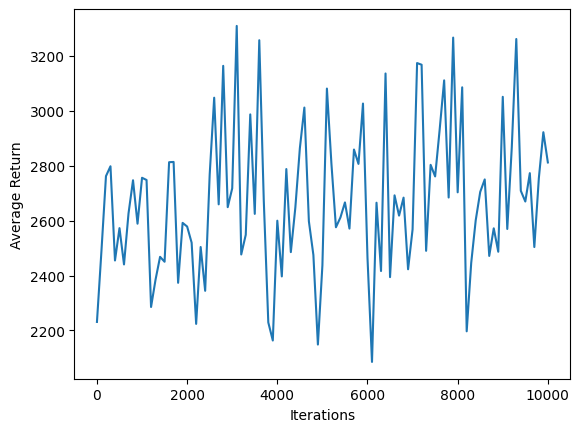

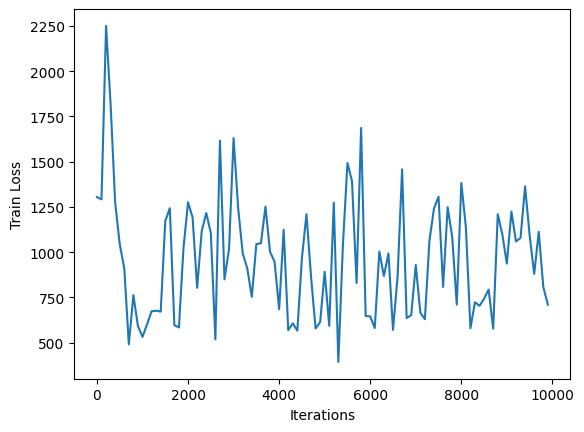

********************ITERATION NUMBER #10000
********************ITERATION NUMBER #10001
********************ITERATION NUMBER #10002
********************ITERATION NUMBER #10003
********************ITERATION NUMBER #10004
********************ITERATION NUMBER #10005
********************ITERATION NUMBER #10006
********************ITERATION NUMBER #10007
********************ITERATION NUMBER #10008
********************ITERATION NUMBER #10009
********************ITERATION NUMBER #10010
********************ITERATION NUMBER #10011
********************ITERATION NUMBER #10012
********************ITERATION NUMBER #10013
********************ITERATION NUMBER #10014
********************ITERATION NUMBER #10015
********************ITERATION NUMBER #10016
********************ITERATION NUMBER #10017
********************ITERATION NUMBER #10018
********************ITERATION NUMBER #10019
********************ITERATION NUMBER #10020
********************ITERATION NUMBER #10021
********************ITERATION NU

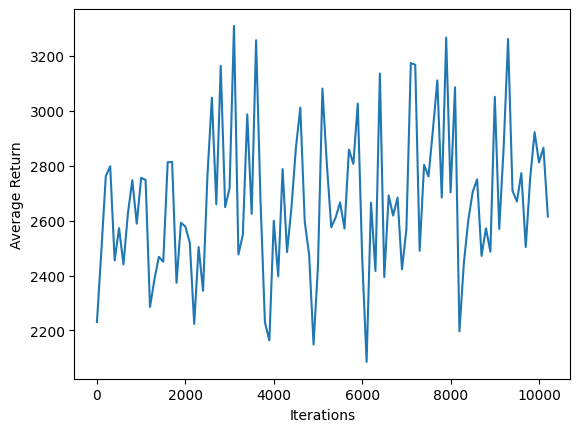

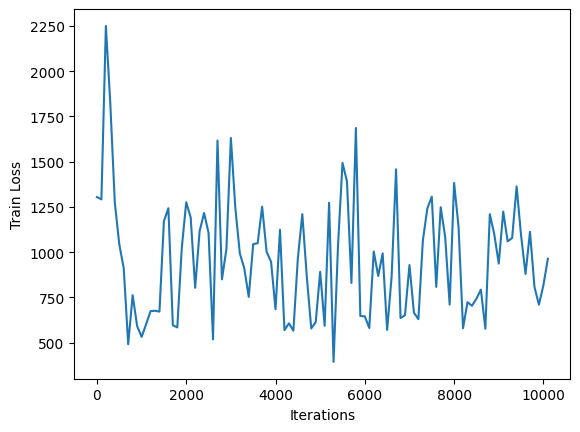

********************ITERATION NUMBER #10200
********************ITERATION NUMBER #10201
********************ITERATION NUMBER #10202
********************ITERATION NUMBER #10203
********************ITERATION NUMBER #10204
********************ITERATION NUMBER #10205
********************ITERATION NUMBER #10206
********************ITERATION NUMBER #10207
********************ITERATION NUMBER #10208
********************ITERATION NUMBER #10209
********************ITERATION NUMBER #10210
********************ITERATION NUMBER #10211
********************ITERATION NUMBER #10212
********************ITERATION NUMBER #10213
********************ITERATION NUMBER #10214
********************ITERATION NUMBER #10215
********************ITERATION NUMBER #10216
********************ITERATION NUMBER #10217
********************ITERATION NUMBER #10218
********************ITERATION NUMBER #10219
********************ITERATION NUMBER #10220
********************ITERATION NUMBER #10221
********************ITERATION NU

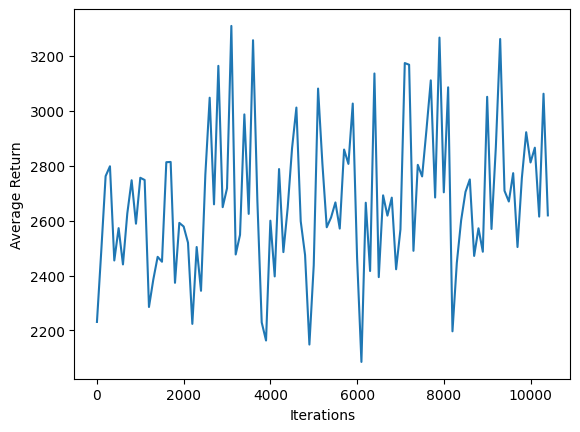

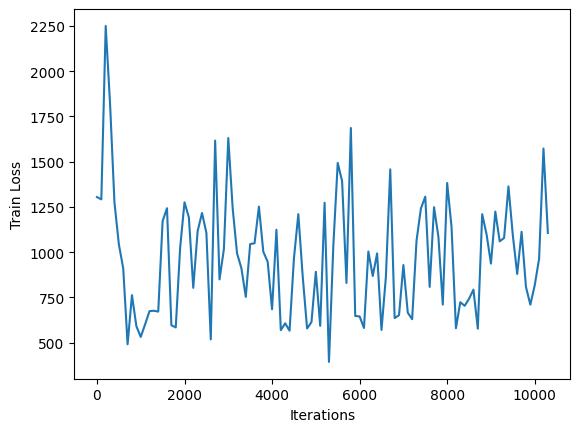

********************ITERATION NUMBER #10400
********************ITERATION NUMBER #10401
********************ITERATION NUMBER #10402
********************ITERATION NUMBER #10403
********************ITERATION NUMBER #10404
********************ITERATION NUMBER #10405
********************ITERATION NUMBER #10406
********************ITERATION NUMBER #10407
********************ITERATION NUMBER #10408
********************ITERATION NUMBER #10409
********************ITERATION NUMBER #10410
********************ITERATION NUMBER #10411
********************ITERATION NUMBER #10412
********************ITERATION NUMBER #10413
********************ITERATION NUMBER #10414
********************ITERATION NUMBER #10415
********************ITERATION NUMBER #10416
********************ITERATION NUMBER #10417
********************ITERATION NUMBER #10418
********************ITERATION NUMBER #10419
********************ITERATION NUMBER #10420
********************ITERATION NUMBER #10421
********************ITERATION NU

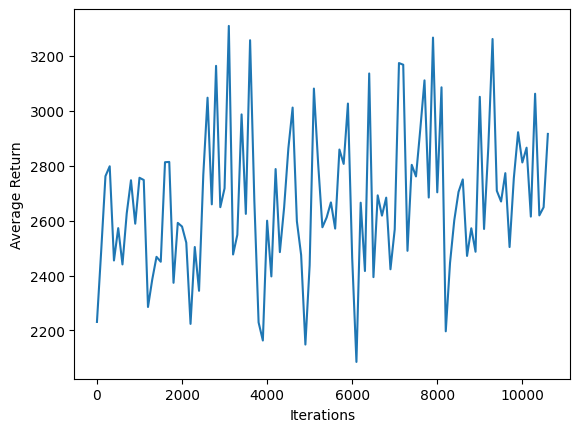

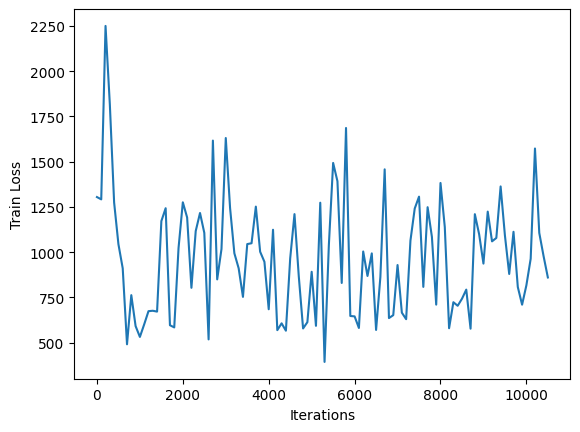

********************ITERATION NUMBER #10600
********************ITERATION NUMBER #10601
********************ITERATION NUMBER #10602
********************ITERATION NUMBER #10603
********************ITERATION NUMBER #10604
********************ITERATION NUMBER #10605
********************ITERATION NUMBER #10606
********************ITERATION NUMBER #10607
********************ITERATION NUMBER #10608
********************ITERATION NUMBER #10609
********************ITERATION NUMBER #10610
********************ITERATION NUMBER #10611
********************ITERATION NUMBER #10612
********************ITERATION NUMBER #10613
********************ITERATION NUMBER #10614
********************ITERATION NUMBER #10615
********************ITERATION NUMBER #10616
********************ITERATION NUMBER #10617
********************ITERATION NUMBER #10618
********************ITERATION NUMBER #10619
********************ITERATION NUMBER #10620
********************ITERATION NUMBER #10621
********************ITERATION NU

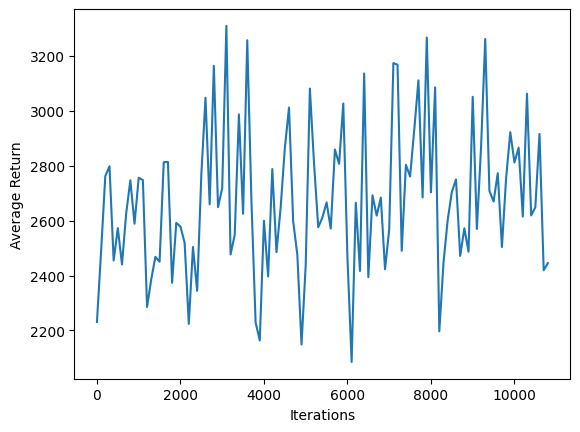

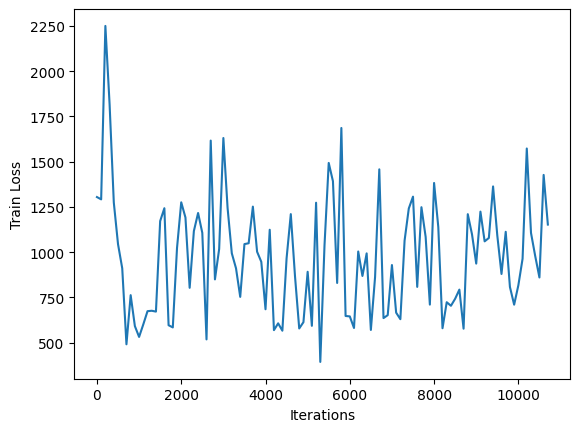

********************ITERATION NUMBER #10800
********************ITERATION NUMBER #10801
********************ITERATION NUMBER #10802
********************ITERATION NUMBER #10803
********************ITERATION NUMBER #10804
********************ITERATION NUMBER #10805
********************ITERATION NUMBER #10806
********************ITERATION NUMBER #10807
********************ITERATION NUMBER #10808
********************ITERATION NUMBER #10809
********************ITERATION NUMBER #10810
********************ITERATION NUMBER #10811
********************ITERATION NUMBER #10812
********************ITERATION NUMBER #10813
********************ITERATION NUMBER #10814
********************ITERATION NUMBER #10815
********************ITERATION NUMBER #10816
********************ITERATION NUMBER #10817
********************ITERATION NUMBER #10818
********************ITERATION NUMBER #10819
********************ITERATION NUMBER #10820
********************ITERATION NUMBER #10821
********************ITERATION NU

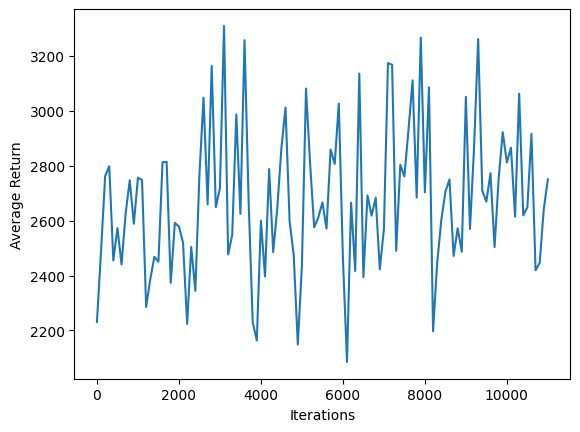

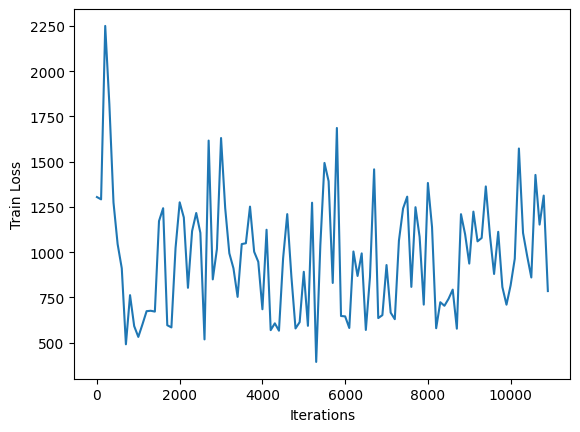

********************ITERATION NUMBER #11000
********************ITERATION NUMBER #11001
********************ITERATION NUMBER #11002
********************ITERATION NUMBER #11003
********************ITERATION NUMBER #11004
********************ITERATION NUMBER #11005
********************ITERATION NUMBER #11006
********************ITERATION NUMBER #11007
********************ITERATION NUMBER #11008
********************ITERATION NUMBER #11009
********************ITERATION NUMBER #11010
********************ITERATION NUMBER #11011
********************ITERATION NUMBER #11012
********************ITERATION NUMBER #11013
********************ITERATION NUMBER #11014
********************ITERATION NUMBER #11015
********************ITERATION NUMBER #11016
********************ITERATION NUMBER #11017
********************ITERATION NUMBER #11018
********************ITERATION NUMBER #11019
********************ITERATION NUMBER #11020
********************ITERATION NUMBER #11021
********************ITERATION NU

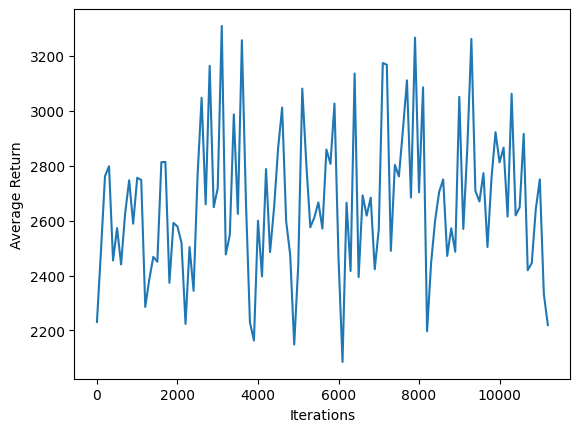

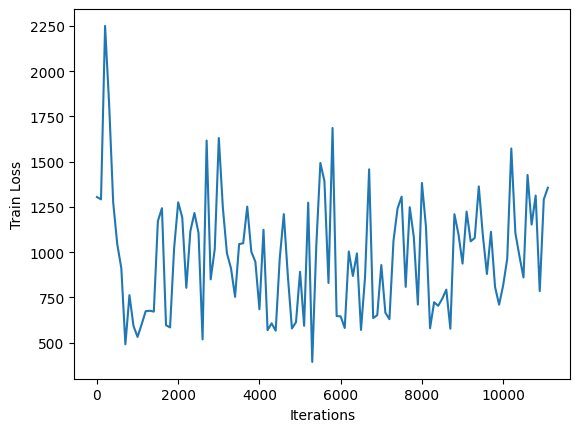

********************ITERATION NUMBER #11200
********************ITERATION NUMBER #11201
********************ITERATION NUMBER #11202
********************ITERATION NUMBER #11203
********************ITERATION NUMBER #11204
********************ITERATION NUMBER #11205
********************ITERATION NUMBER #11206
********************ITERATION NUMBER #11207
********************ITERATION NUMBER #11208
********************ITERATION NUMBER #11209
********************ITERATION NUMBER #11210
********************ITERATION NUMBER #11211
********************ITERATION NUMBER #11212
********************ITERATION NUMBER #11213
********************ITERATION NUMBER #11214
********************ITERATION NUMBER #11215
********************ITERATION NUMBER #11216
********************ITERATION NUMBER #11217
********************ITERATION NUMBER #11218
********************ITERATION NUMBER #11219
********************ITERATION NUMBER #11220
********************ITERATION NUMBER #11221
********************ITERATION NU

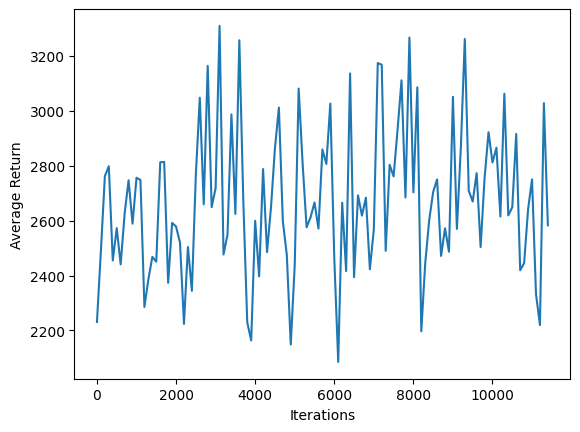

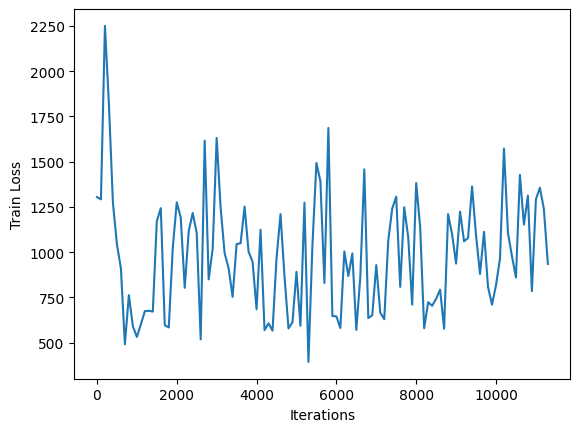

********************ITERATION NUMBER #11400
********************ITERATION NUMBER #11401
********************ITERATION NUMBER #11402
********************ITERATION NUMBER #11403
********************ITERATION NUMBER #11404
********************ITERATION NUMBER #11405
********************ITERATION NUMBER #11406
********************ITERATION NUMBER #11407
********************ITERATION NUMBER #11408
********************ITERATION NUMBER #11409
********************ITERATION NUMBER #11410
********************ITERATION NUMBER #11411
********************ITERATION NUMBER #11412
********************ITERATION NUMBER #11413
********************ITERATION NUMBER #11414
********************ITERATION NUMBER #11415
********************ITERATION NUMBER #11416
********************ITERATION NUMBER #11417
********************ITERATION NUMBER #11418
********************ITERATION NUMBER #11419
********************ITERATION NUMBER #11420
********************ITERATION NUMBER #11421
********************ITERATION NU

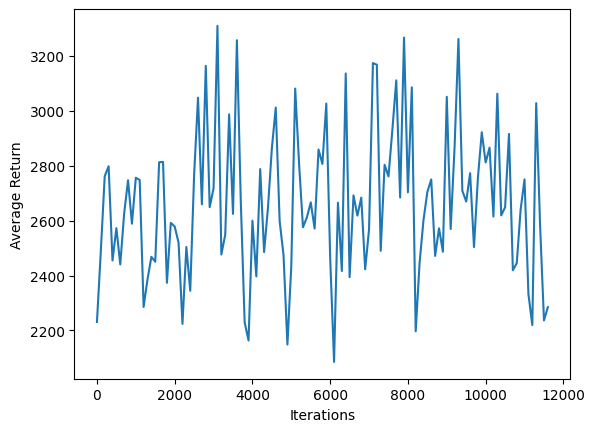

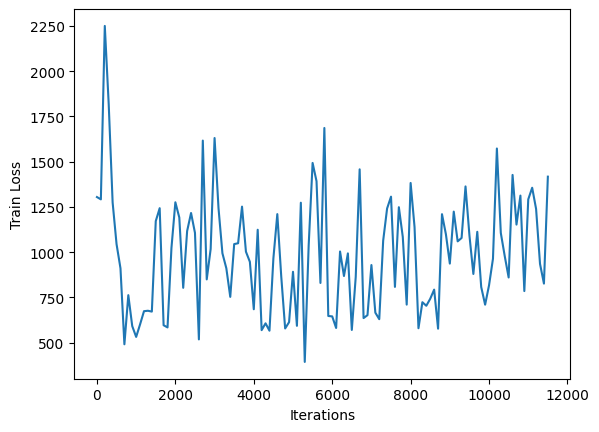

********************ITERATION NUMBER #11600
********************ITERATION NUMBER #11601
********************ITERATION NUMBER #11602
********************ITERATION NUMBER #11603
********************ITERATION NUMBER #11604
********************ITERATION NUMBER #11605
********************ITERATION NUMBER #11606
********************ITERATION NUMBER #11607
********************ITERATION NUMBER #11608
********************ITERATION NUMBER #11609
********************ITERATION NUMBER #11610
********************ITERATION NUMBER #11611
********************ITERATION NUMBER #11612
********************ITERATION NUMBER #11613
********************ITERATION NUMBER #11614
********************ITERATION NUMBER #11615
********************ITERATION NUMBER #11616
********************ITERATION NUMBER #11617
********************ITERATION NUMBER #11618
********************ITERATION NUMBER #11619
********************ITERATION NUMBER #11620
********************ITERATION NUMBER #11621
********************ITERATION NU

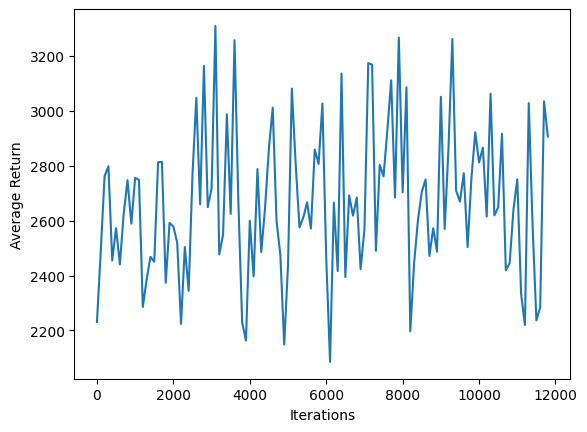

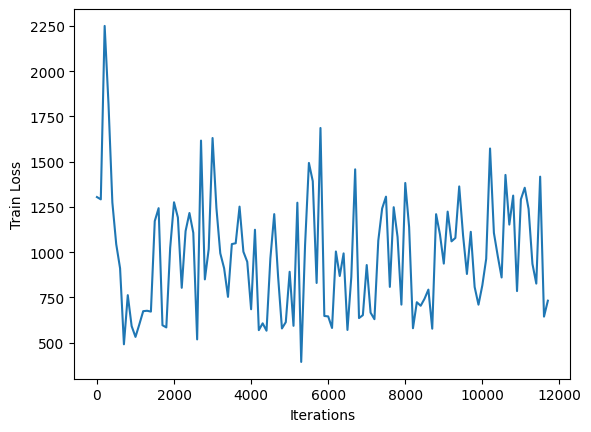

********************ITERATION NUMBER #11800
********************ITERATION NUMBER #11801
********************ITERATION NUMBER #11802
********************ITERATION NUMBER #11803
********************ITERATION NUMBER #11804
********************ITERATION NUMBER #11805
********************ITERATION NUMBER #11806
********************ITERATION NUMBER #11807
********************ITERATION NUMBER #11808
********************ITERATION NUMBER #11809
********************ITERATION NUMBER #11810
********************ITERATION NUMBER #11811
********************ITERATION NUMBER #11812
********************ITERATION NUMBER #11813
********************ITERATION NUMBER #11814
********************ITERATION NUMBER #11815
********************ITERATION NUMBER #11816
********************ITERATION NUMBER #11817
********************ITERATION NUMBER #11818
********************ITERATION NUMBER #11819
********************ITERATION NUMBER #11820
********************ITERATION NUMBER #11821
********************ITERATION NU

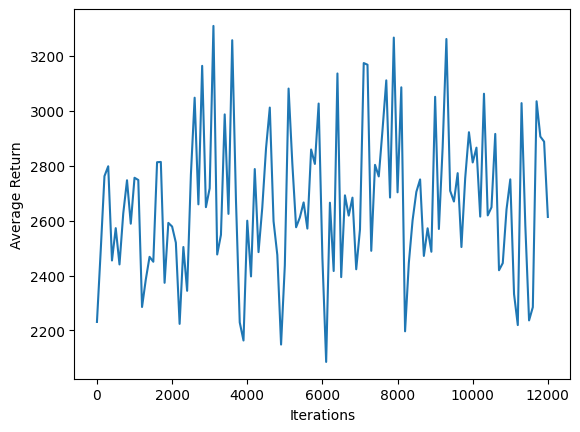

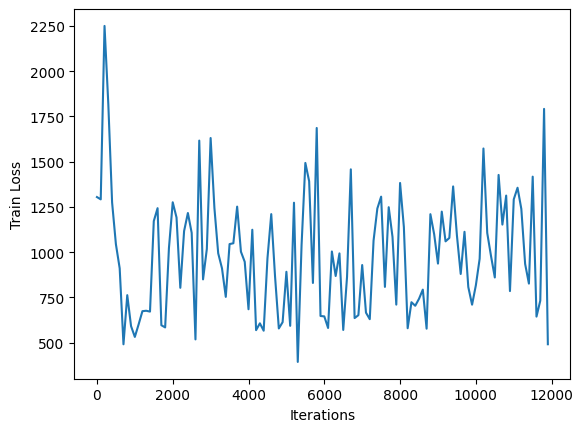

********************ITERATION NUMBER #12000
********************ITERATION NUMBER #12001
********************ITERATION NUMBER #12002
********************ITERATION NUMBER #12003
********************ITERATION NUMBER #12004
********************ITERATION NUMBER #12005
********************ITERATION NUMBER #12006
********************ITERATION NUMBER #12007
********************ITERATION NUMBER #12008
********************ITERATION NUMBER #12009
********************ITERATION NUMBER #12010
********************ITERATION NUMBER #12011
********************ITERATION NUMBER #12012
********************ITERATION NUMBER #12013
********************ITERATION NUMBER #12014
********************ITERATION NUMBER #12015
********************ITERATION NUMBER #12016
********************ITERATION NUMBER #12017
********************ITERATION NUMBER #12018
********************ITERATION NUMBER #12019
********************ITERATION NUMBER #12020
********************ITERATION NUMBER #12021
********************ITERATION NU

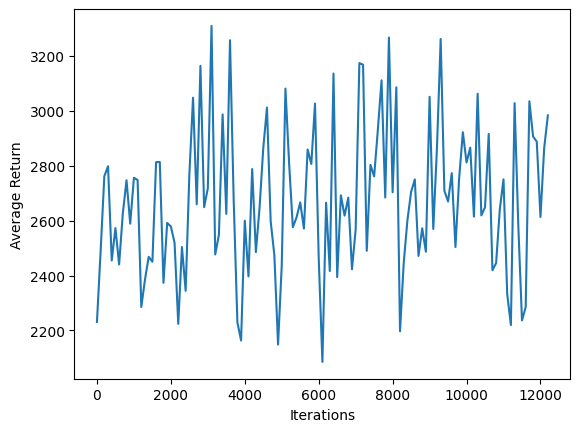

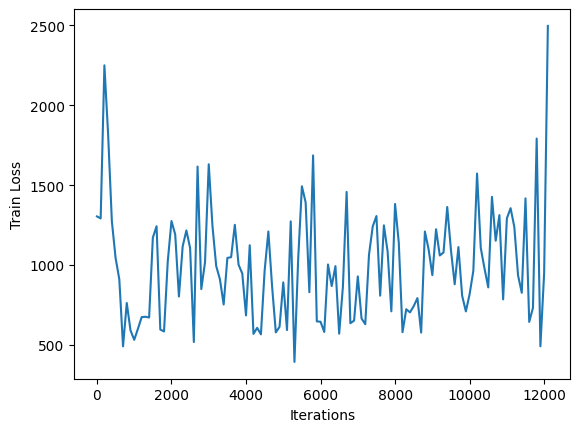

********************ITERATION NUMBER #12200
********************ITERATION NUMBER #12201
********************ITERATION NUMBER #12202
********************ITERATION NUMBER #12203
********************ITERATION NUMBER #12204
********************ITERATION NUMBER #12205
********************ITERATION NUMBER #12206
********************ITERATION NUMBER #12207
********************ITERATION NUMBER #12208
********************ITERATION NUMBER #12209
********************ITERATION NUMBER #12210
********************ITERATION NUMBER #12211
********************ITERATION NUMBER #12212
********************ITERATION NUMBER #12213
********************ITERATION NUMBER #12214
********************ITERATION NUMBER #12215
********************ITERATION NUMBER #12216
********************ITERATION NUMBER #12217
********************ITERATION NUMBER #12218
********************ITERATION NUMBER #12219
********************ITERATION NUMBER #12220
********************ITERATION NUMBER #12221
********************ITERATION NU

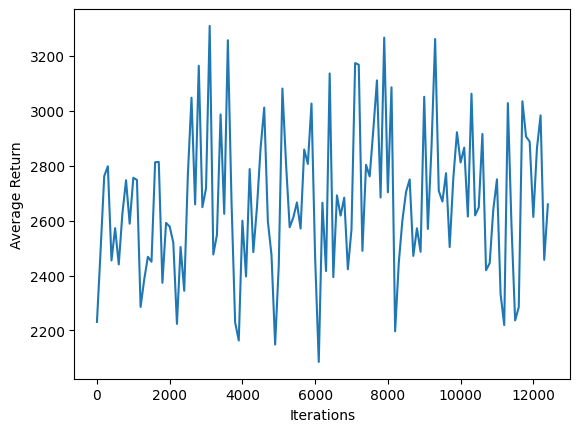

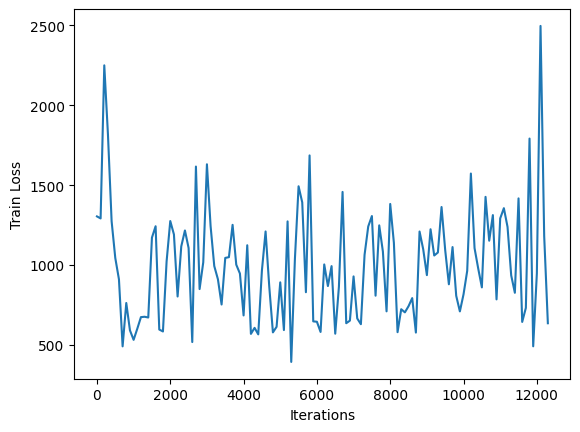

********************ITERATION NUMBER #12400
********************ITERATION NUMBER #12401
********************ITERATION NUMBER #12402
********************ITERATION NUMBER #12403
********************ITERATION NUMBER #12404
********************ITERATION NUMBER #12405
********************ITERATION NUMBER #12406
********************ITERATION NUMBER #12407
********************ITERATION NUMBER #12408
********************ITERATION NUMBER #12409
********************ITERATION NUMBER #12410
********************ITERATION NUMBER #12411
********************ITERATION NUMBER #12412
********************ITERATION NUMBER #12413
********************ITERATION NUMBER #12414
********************ITERATION NUMBER #12415
********************ITERATION NUMBER #12416
********************ITERATION NUMBER #12417
********************ITERATION NUMBER #12418
********************ITERATION NUMBER #12419
********************ITERATION NUMBER #12420
********************ITERATION NUMBER #12421
********************ITERATION NU

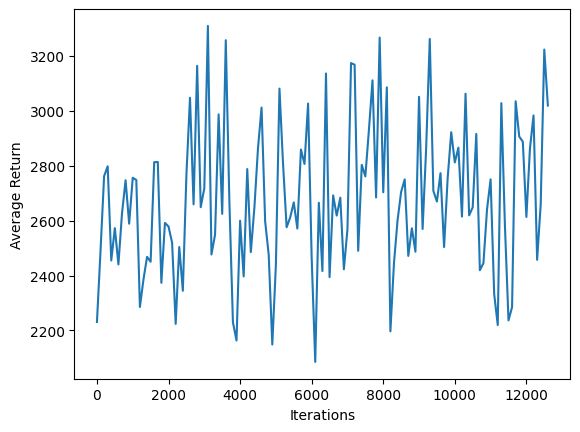

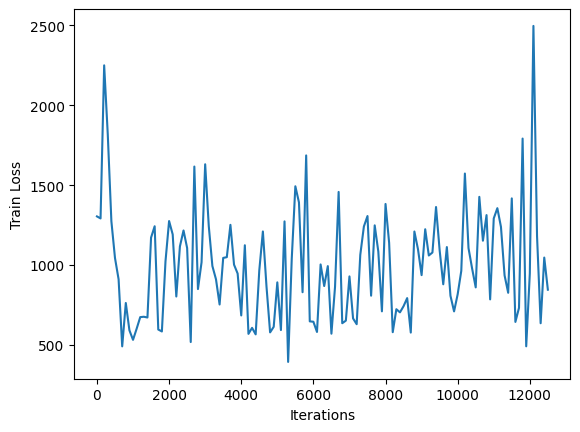

********************ITERATION NUMBER #12600
********************ITERATION NUMBER #12601
********************ITERATION NUMBER #12602
********************ITERATION NUMBER #12603
********************ITERATION NUMBER #12604
********************ITERATION NUMBER #12605
********************ITERATION NUMBER #12606
********************ITERATION NUMBER #12607
********************ITERATION NUMBER #12608
********************ITERATION NUMBER #12609
********************ITERATION NUMBER #12610
********************ITERATION NUMBER #12611
********************ITERATION NUMBER #12612
********************ITERATION NUMBER #12613
********************ITERATION NUMBER #12614
********************ITERATION NUMBER #12615
********************ITERATION NUMBER #12616
********************ITERATION NUMBER #12617
********************ITERATION NUMBER #12618
********************ITERATION NUMBER #12619
********************ITERATION NUMBER #12620
********************ITERATION NUMBER #12621
********************ITERATION NU

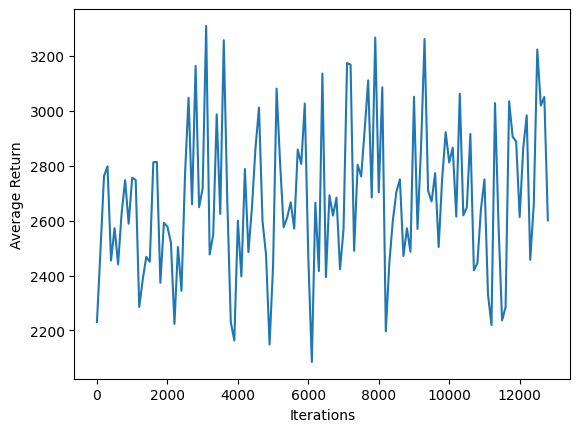

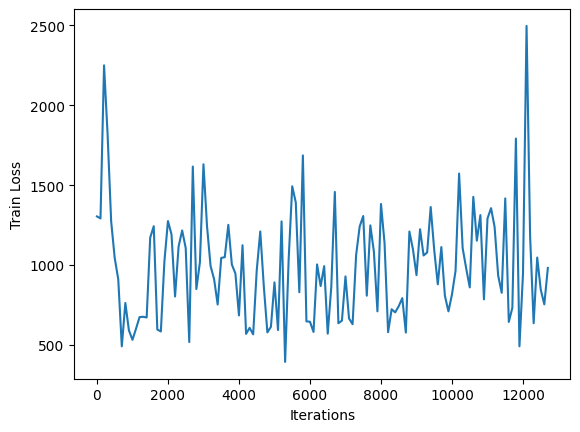

********************ITERATION NUMBER #12800
********************ITERATION NUMBER #12801
********************ITERATION NUMBER #12802
********************ITERATION NUMBER #12803
********************ITERATION NUMBER #12804
********************ITERATION NUMBER #12805
********************ITERATION NUMBER #12806
********************ITERATION NUMBER #12807
********************ITERATION NUMBER #12808
********************ITERATION NUMBER #12809
********************ITERATION NUMBER #12810
********************ITERATION NUMBER #12811
********************ITERATION NUMBER #12812
********************ITERATION NUMBER #12813
********************ITERATION NUMBER #12814
********************ITERATION NUMBER #12815
********************ITERATION NUMBER #12816
********************ITERATION NUMBER #12817
********************ITERATION NUMBER #12818
********************ITERATION NUMBER #12819
********************ITERATION NUMBER #12820
********************ITERATION NUMBER #12821
********************ITERATION NU

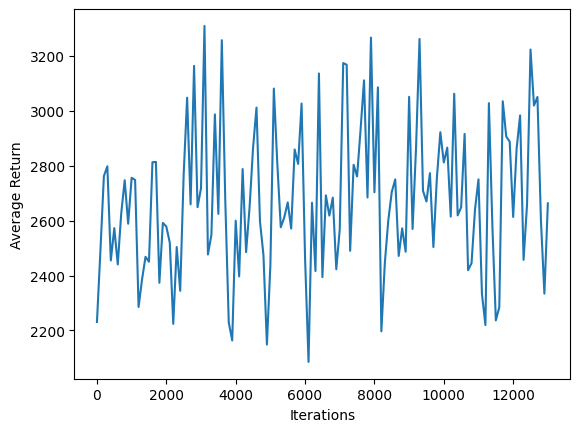

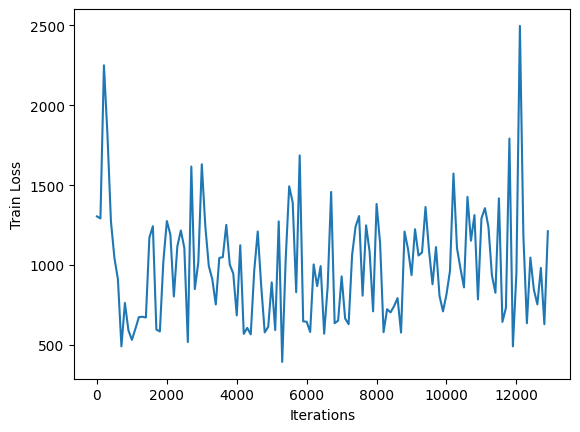

********************ITERATION NUMBER #13000
********************ITERATION NUMBER #13001
********************ITERATION NUMBER #13002
********************ITERATION NUMBER #13003
********************ITERATION NUMBER #13004
********************ITERATION NUMBER #13005
********************ITERATION NUMBER #13006
********************ITERATION NUMBER #13007
********************ITERATION NUMBER #13008
********************ITERATION NUMBER #13009
********************ITERATION NUMBER #13010
********************ITERATION NUMBER #13011
********************ITERATION NUMBER #13012
********************ITERATION NUMBER #13013
********************ITERATION NUMBER #13014
********************ITERATION NUMBER #13015
********************ITERATION NUMBER #13016
********************ITERATION NUMBER #13017
********************ITERATION NUMBER #13018
********************ITERATION NUMBER #13019
********************ITERATION NUMBER #13020
********************ITERATION NUMBER #13021
********************ITERATION NU

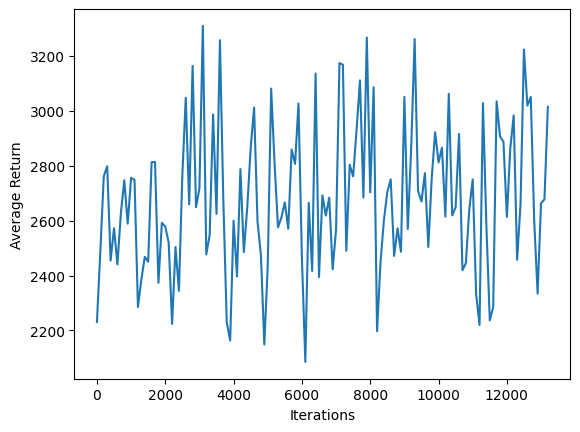

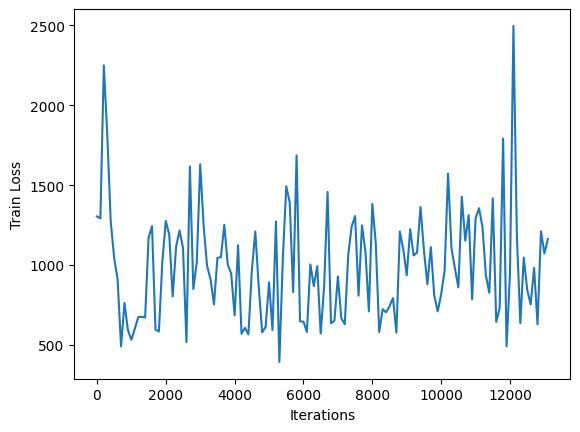

********************ITERATION NUMBER #13200
********************ITERATION NUMBER #13201
********************ITERATION NUMBER #13202
********************ITERATION NUMBER #13203
********************ITERATION NUMBER #13204
********************ITERATION NUMBER #13205
********************ITERATION NUMBER #13206
********************ITERATION NUMBER #13207
********************ITERATION NUMBER #13208
********************ITERATION NUMBER #13209
********************ITERATION NUMBER #13210
********************ITERATION NUMBER #13211
********************ITERATION NUMBER #13212
********************ITERATION NUMBER #13213
********************ITERATION NUMBER #13214
********************ITERATION NUMBER #13215
********************ITERATION NUMBER #13216
********************ITERATION NUMBER #13217
********************ITERATION NUMBER #13218
********************ITERATION NUMBER #13219
********************ITERATION NUMBER #13220
********************ITERATION NUMBER #13221
********************ITERATION NU

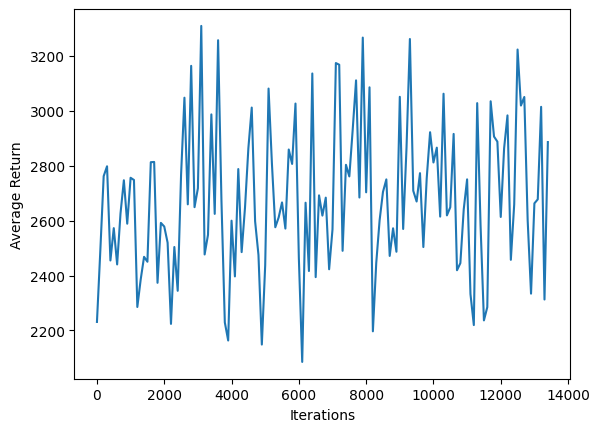

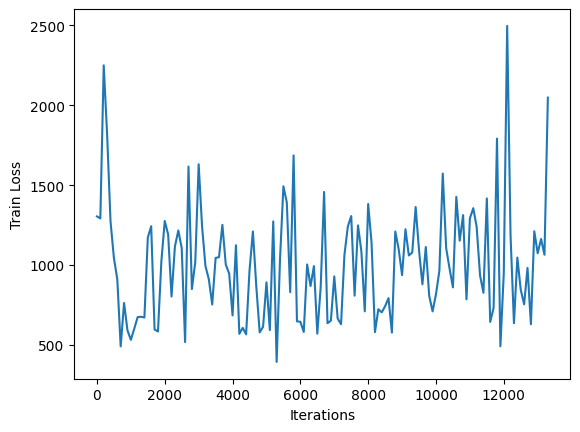

********************ITERATION NUMBER #13400
********************ITERATION NUMBER #13401
********************ITERATION NUMBER #13402
********************ITERATION NUMBER #13403
********************ITERATION NUMBER #13404
********************ITERATION NUMBER #13405
********************ITERATION NUMBER #13406
********************ITERATION NUMBER #13407
********************ITERATION NUMBER #13408
********************ITERATION NUMBER #13409
********************ITERATION NUMBER #13410
********************ITERATION NUMBER #13411
********************ITERATION NUMBER #13412
********************ITERATION NUMBER #13413
********************ITERATION NUMBER #13414
********************ITERATION NUMBER #13415
********************ITERATION NUMBER #13416
********************ITERATION NUMBER #13417
********************ITERATION NUMBER #13418
********************ITERATION NUMBER #13419
********************ITERATION NUMBER #13420
********************ITERATION NUMBER #13421
********************ITERATION NU

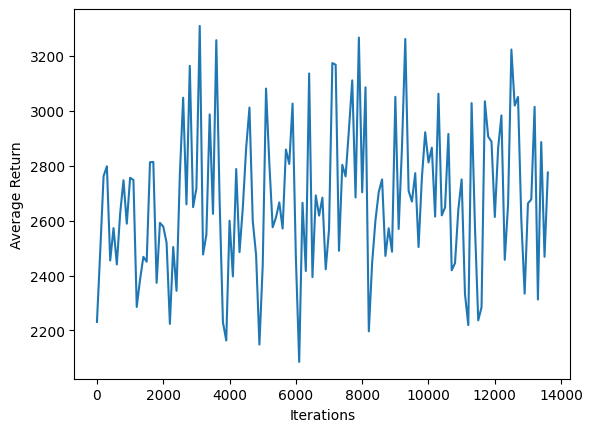

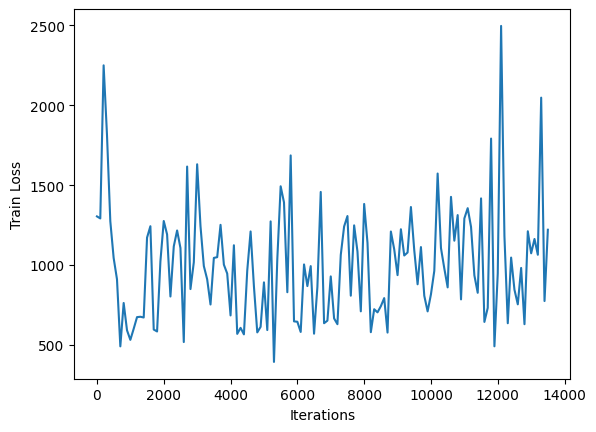

********************ITERATION NUMBER #13600
********************ITERATION NUMBER #13601
********************ITERATION NUMBER #13602
********************ITERATION NUMBER #13603
********************ITERATION NUMBER #13604
********************ITERATION NUMBER #13605
********************ITERATION NUMBER #13606
********************ITERATION NUMBER #13607
********************ITERATION NUMBER #13608
********************ITERATION NUMBER #13609
********************ITERATION NUMBER #13610
********************ITERATION NUMBER #13611
********************ITERATION NUMBER #13612
********************ITERATION NUMBER #13613
********************ITERATION NUMBER #13614
********************ITERATION NUMBER #13615
********************ITERATION NUMBER #13616
********************ITERATION NUMBER #13617
********************ITERATION NUMBER #13618
********************ITERATION NUMBER #13619
********************ITERATION NUMBER #13620
********************ITERATION NUMBER #13621
********************ITERATION NU

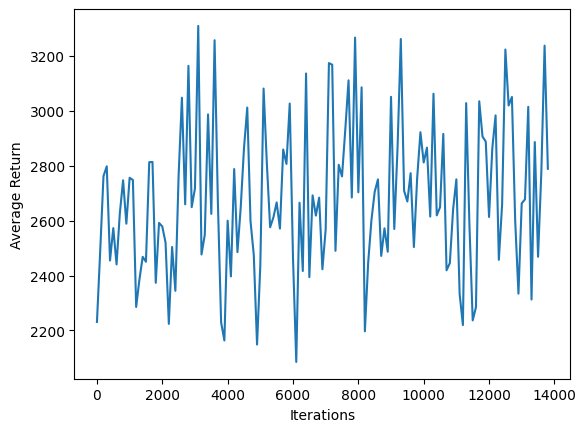

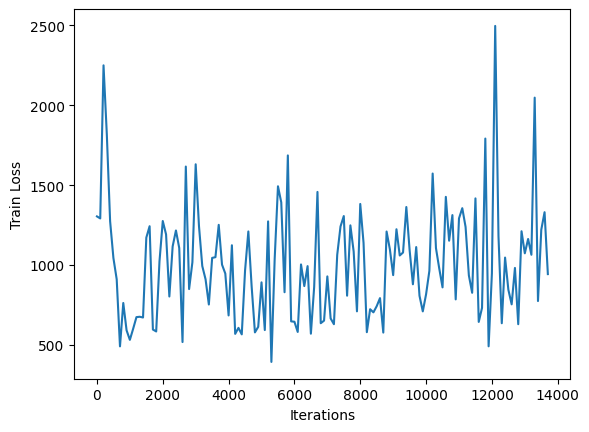

********************ITERATION NUMBER #13800
********************ITERATION NUMBER #13801
********************ITERATION NUMBER #13802
********************ITERATION NUMBER #13803
********************ITERATION NUMBER #13804
********************ITERATION NUMBER #13805
********************ITERATION NUMBER #13806
********************ITERATION NUMBER #13807
********************ITERATION NUMBER #13808
********************ITERATION NUMBER #13809
********************ITERATION NUMBER #13810
********************ITERATION NUMBER #13811
********************ITERATION NUMBER #13812
********************ITERATION NUMBER #13813
********************ITERATION NUMBER #13814
********************ITERATION NUMBER #13815
********************ITERATION NUMBER #13816
********************ITERATION NUMBER #13817
********************ITERATION NUMBER #13818
********************ITERATION NUMBER #13819
********************ITERATION NUMBER #13820
********************ITERATION NUMBER #13821
********************ITERATION NU

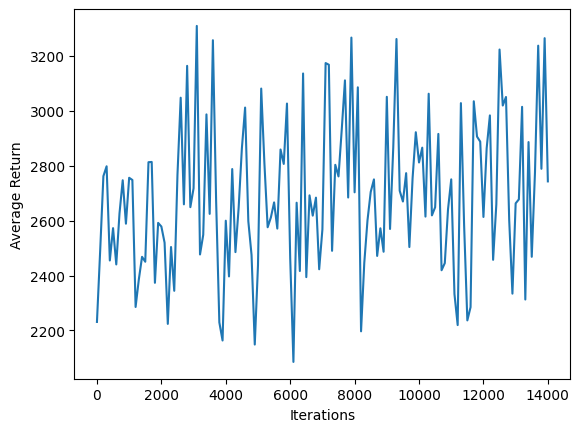

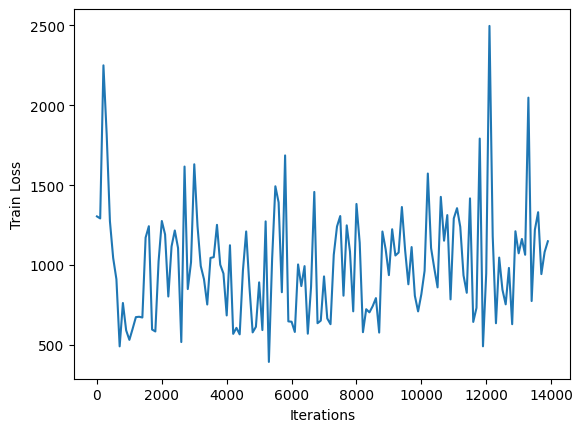

********************ITERATION NUMBER #14000
********************ITERATION NUMBER #14001
********************ITERATION NUMBER #14002
********************ITERATION NUMBER #14003
********************ITERATION NUMBER #14004
********************ITERATION NUMBER #14005
********************ITERATION NUMBER #14006
********************ITERATION NUMBER #14007
********************ITERATION NUMBER #14008
********************ITERATION NUMBER #14009
********************ITERATION NUMBER #14010
********************ITERATION NUMBER #14011
********************ITERATION NUMBER #14012
********************ITERATION NUMBER #14013
********************ITERATION NUMBER #14014
********************ITERATION NUMBER #14015
********************ITERATION NUMBER #14016
********************ITERATION NUMBER #14017
********************ITERATION NUMBER #14018
********************ITERATION NUMBER #14019
********************ITERATION NUMBER #14020
********************ITERATION NUMBER #14021
********************ITERATION NU

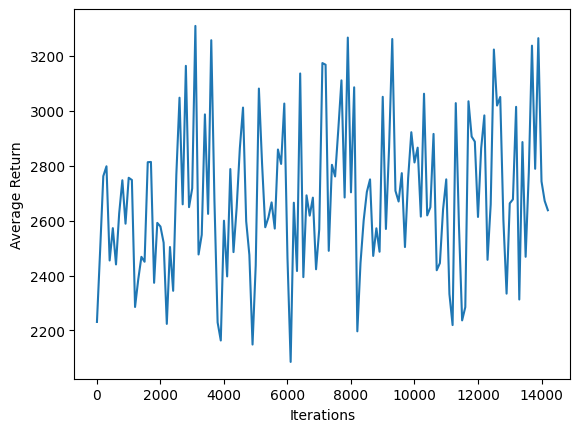

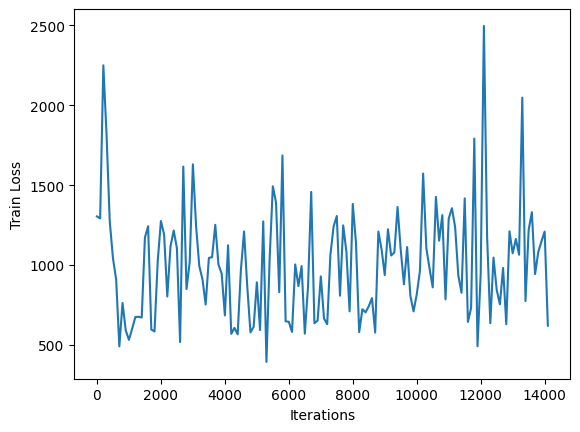

********************ITERATION NUMBER #14200
********************ITERATION NUMBER #14201
********************ITERATION NUMBER #14202
********************ITERATION NUMBER #14203
********************ITERATION NUMBER #14204
********************ITERATION NUMBER #14205
********************ITERATION NUMBER #14206
********************ITERATION NUMBER #14207
********************ITERATION NUMBER #14208
********************ITERATION NUMBER #14209
********************ITERATION NUMBER #14210
********************ITERATION NUMBER #14211
********************ITERATION NUMBER #14212
********************ITERATION NUMBER #14213
********************ITERATION NUMBER #14214
********************ITERATION NUMBER #14215
********************ITERATION NUMBER #14216
********************ITERATION NUMBER #14217
********************ITERATION NUMBER #14218
********************ITERATION NUMBER #14219
********************ITERATION NUMBER #14220
********************ITERATION NUMBER #14221
********************ITERATION NU

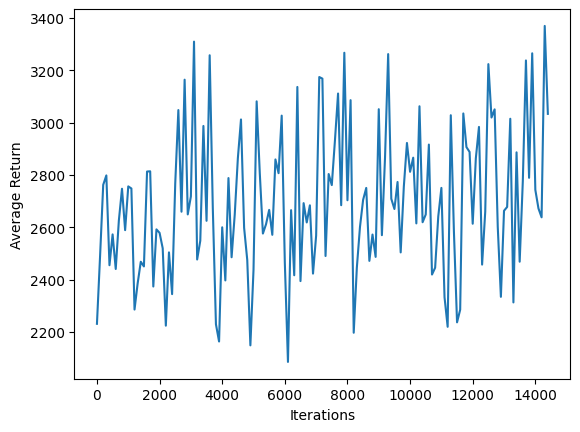

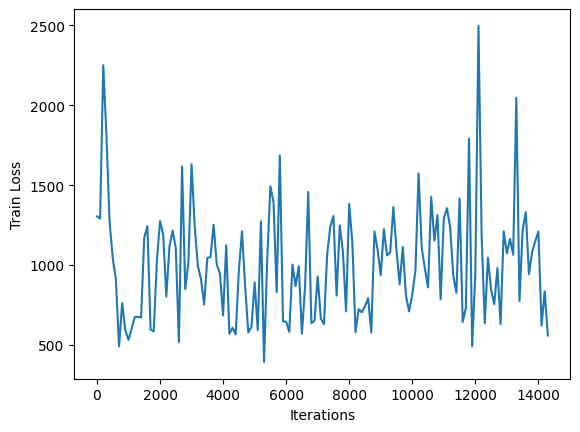

********************ITERATION NUMBER #14400
********************ITERATION NUMBER #14401
********************ITERATION NUMBER #14402
********************ITERATION NUMBER #14403
********************ITERATION NUMBER #14404
********************ITERATION NUMBER #14405
********************ITERATION NUMBER #14406
********************ITERATION NUMBER #14407
********************ITERATION NUMBER #14408
********************ITERATION NUMBER #14409
********************ITERATION NUMBER #14410
********************ITERATION NUMBER #14411
********************ITERATION NUMBER #14412
********************ITERATION NUMBER #14413
********************ITERATION NUMBER #14414
********************ITERATION NUMBER #14415
********************ITERATION NUMBER #14416
********************ITERATION NUMBER #14417
********************ITERATION NUMBER #14418
********************ITERATION NUMBER #14419
********************ITERATION NUMBER #14420
********************ITERATION NUMBER #14421
********************ITERATION NU

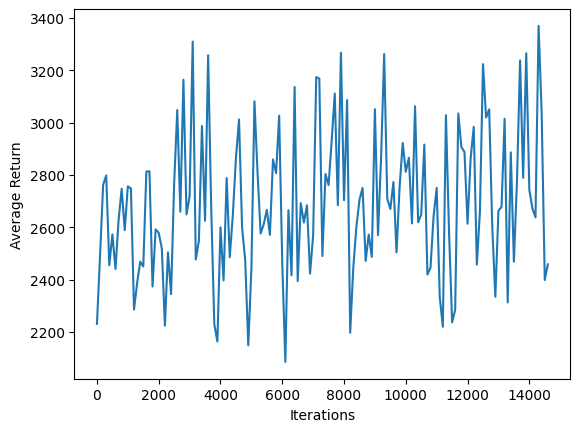

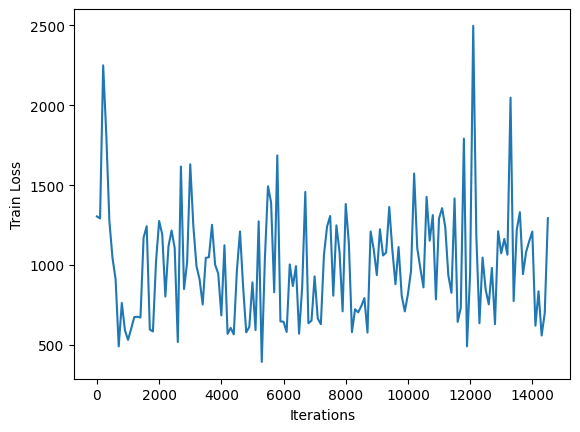

********************ITERATION NUMBER #14600
********************ITERATION NUMBER #14601
********************ITERATION NUMBER #14602
********************ITERATION NUMBER #14603
********************ITERATION NUMBER #14604
********************ITERATION NUMBER #14605
********************ITERATION NUMBER #14606
********************ITERATION NUMBER #14607
********************ITERATION NUMBER #14608
********************ITERATION NUMBER #14609
********************ITERATION NUMBER #14610
********************ITERATION NUMBER #14611
********************ITERATION NUMBER #14612
********************ITERATION NUMBER #14613
********************ITERATION NUMBER #14614
********************ITERATION NUMBER #14615
********************ITERATION NUMBER #14616
********************ITERATION NUMBER #14617
********************ITERATION NUMBER #14618
********************ITERATION NUMBER #14619
********************ITERATION NUMBER #14620
********************ITERATION NUMBER #14621
********************ITERATION NU

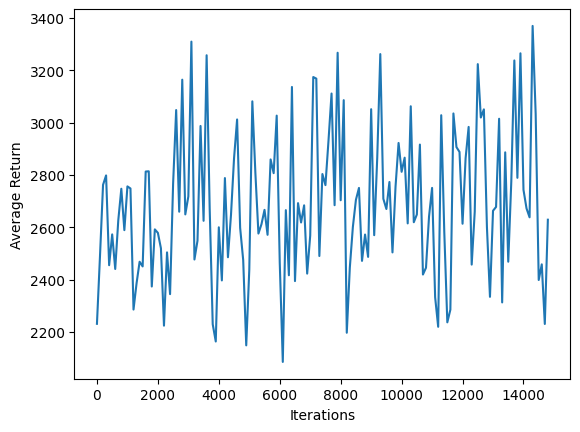

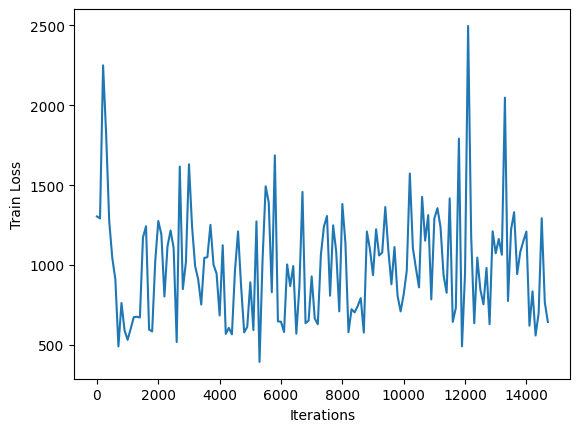

********************ITERATION NUMBER #14800
********************ITERATION NUMBER #14801
********************ITERATION NUMBER #14802
********************ITERATION NUMBER #14803
********************ITERATION NUMBER #14804
********************ITERATION NUMBER #14805
********************ITERATION NUMBER #14806
********************ITERATION NUMBER #14807
********************ITERATION NUMBER #14808
********************ITERATION NUMBER #14809
********************ITERATION NUMBER #14810
********************ITERATION NUMBER #14811
********************ITERATION NUMBER #14812
********************ITERATION NUMBER #14813
********************ITERATION NUMBER #14814
********************ITERATION NUMBER #14815
********************ITERATION NUMBER #14816
********************ITERATION NUMBER #14817
********************ITERATION NUMBER #14818
********************ITERATION NUMBER #14819
********************ITERATION NUMBER #14820
********************ITERATION NUMBER #14821
********************ITERATION NU

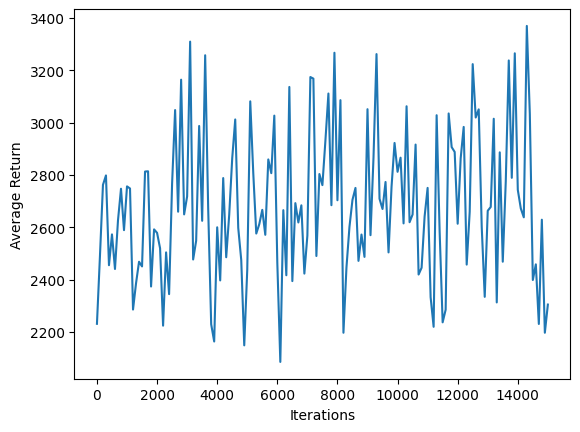

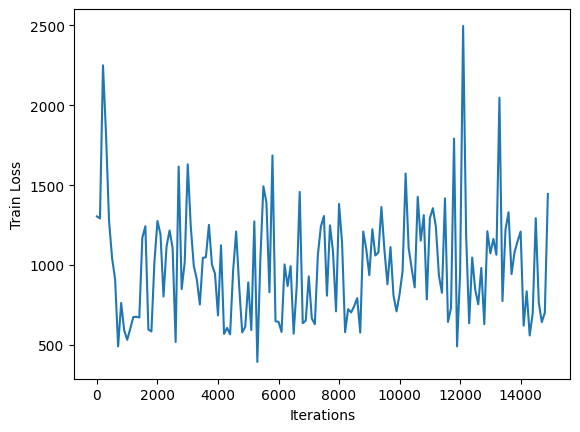

********************ITERATION NUMBER #15000
********************ITERATION NUMBER #15001
********************ITERATION NUMBER #15002
********************ITERATION NUMBER #15003
********************ITERATION NUMBER #15004
********************ITERATION NUMBER #15005
********************ITERATION NUMBER #15006
********************ITERATION NUMBER #15007
********************ITERATION NUMBER #15008
********************ITERATION NUMBER #15009
********************ITERATION NUMBER #15010
********************ITERATION NUMBER #15011
********************ITERATION NUMBER #15012
********************ITERATION NUMBER #15013
********************ITERATION NUMBER #15014
********************ITERATION NUMBER #15015
********************ITERATION NUMBER #15016
********************ITERATION NUMBER #15017
********************ITERATION NUMBER #15018
********************ITERATION NUMBER #15019
********************ITERATION NUMBER #15020
********************ITERATION NUMBER #15021
********************ITERATION NU

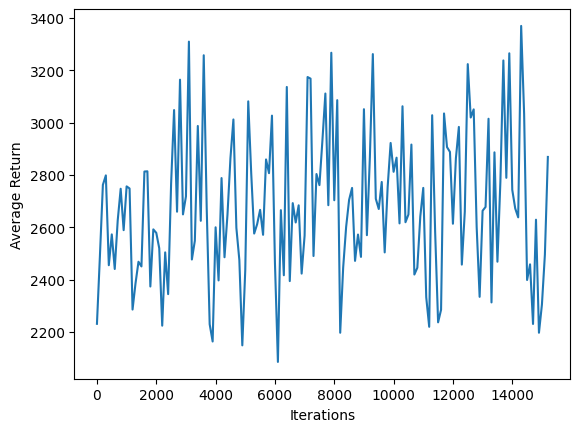

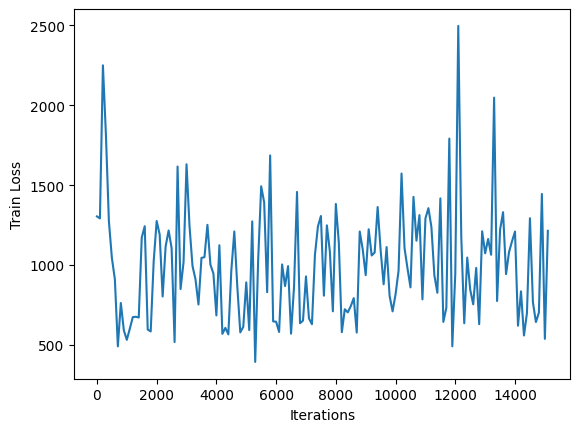

********************ITERATION NUMBER #15200
********************ITERATION NUMBER #15201
********************ITERATION NUMBER #15202
********************ITERATION NUMBER #15203
********************ITERATION NUMBER #15204
********************ITERATION NUMBER #15205
********************ITERATION NUMBER #15206
********************ITERATION NUMBER #15207
********************ITERATION NUMBER #15208
********************ITERATION NUMBER #15209
********************ITERATION NUMBER #15210
********************ITERATION NUMBER #15211
********************ITERATION NUMBER #15212
********************ITERATION NUMBER #15213
********************ITERATION NUMBER #15214
********************ITERATION NUMBER #15215
********************ITERATION NUMBER #15216
********************ITERATION NUMBER #15217
********************ITERATION NUMBER #15218
********************ITERATION NUMBER #15219
********************ITERATION NUMBER #15220
********************ITERATION NUMBER #15221
********************ITERATION NU

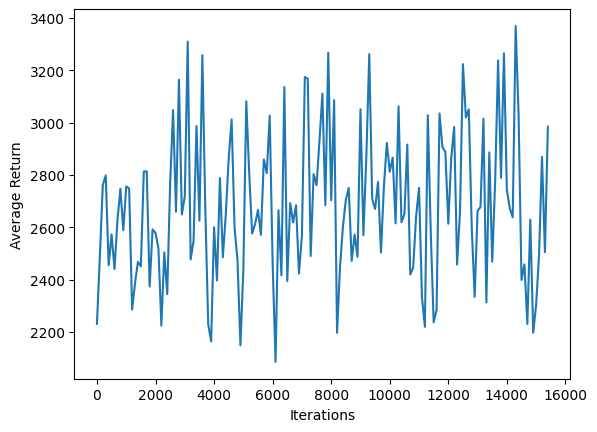

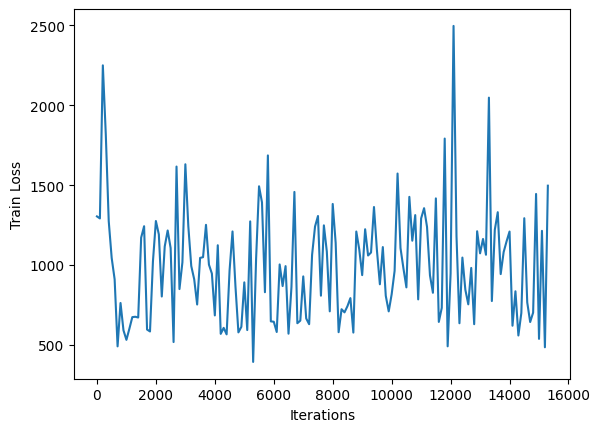

********************ITERATION NUMBER #15400
********************ITERATION NUMBER #15401
********************ITERATION NUMBER #15402
********************ITERATION NUMBER #15403
********************ITERATION NUMBER #15404
********************ITERATION NUMBER #15405
********************ITERATION NUMBER #15406
********************ITERATION NUMBER #15407
********************ITERATION NUMBER #15408
********************ITERATION NUMBER #15409
********************ITERATION NUMBER #15410
********************ITERATION NUMBER #15411
********************ITERATION NUMBER #15412
********************ITERATION NUMBER #15413
********************ITERATION NUMBER #15414
********************ITERATION NUMBER #15415
********************ITERATION NUMBER #15416
********************ITERATION NUMBER #15417
********************ITERATION NUMBER #15418
********************ITERATION NUMBER #15419
********************ITERATION NUMBER #15420
********************ITERATION NUMBER #15421
********************ITERATION NU

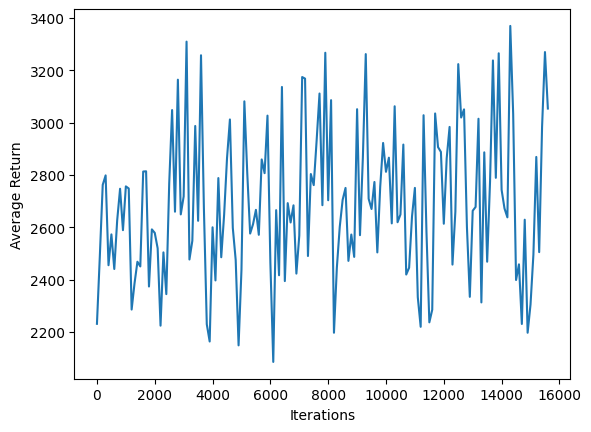

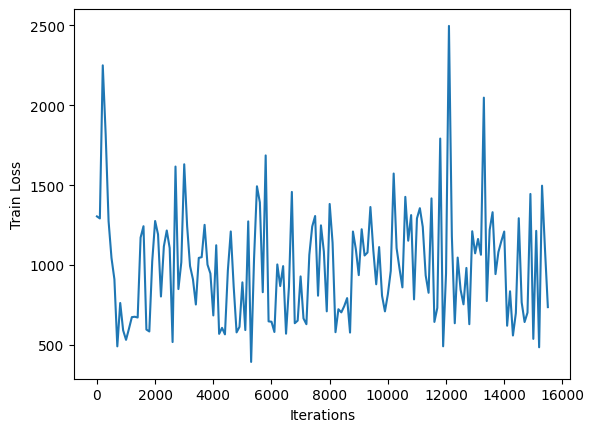

********************ITERATION NUMBER #15600
********************ITERATION NUMBER #15601
********************ITERATION NUMBER #15602
********************ITERATION NUMBER #15603
********************ITERATION NUMBER #15604
********************ITERATION NUMBER #15605
********************ITERATION NUMBER #15606
********************ITERATION NUMBER #15607
********************ITERATION NUMBER #15608
********************ITERATION NUMBER #15609
********************ITERATION NUMBER #15610
********************ITERATION NUMBER #15611
********************ITERATION NUMBER #15612
********************ITERATION NUMBER #15613
********************ITERATION NUMBER #15614
********************ITERATION NUMBER #15615
********************ITERATION NUMBER #15616
********************ITERATION NUMBER #15617
********************ITERATION NUMBER #15618
********************ITERATION NUMBER #15619
********************ITERATION NUMBER #15620
********************ITERATION NUMBER #15621
********************ITERATION NU

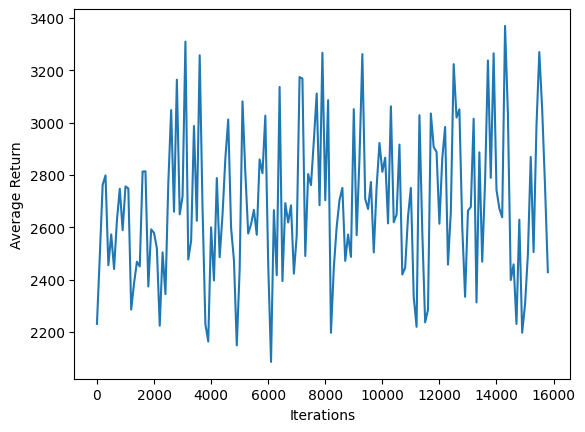

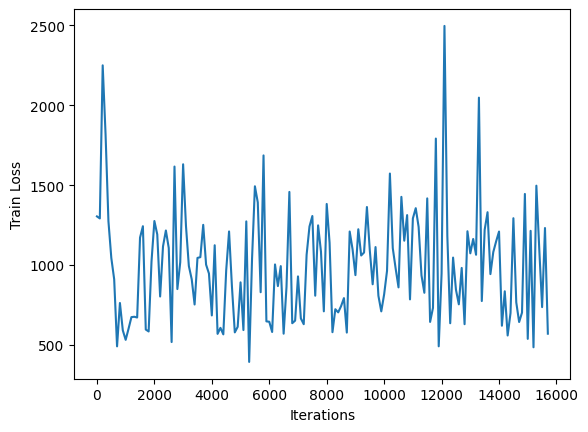

********************ITERATION NUMBER #15800
********************ITERATION NUMBER #15801
********************ITERATION NUMBER #15802
********************ITERATION NUMBER #15803
********************ITERATION NUMBER #15804
********************ITERATION NUMBER #15805
********************ITERATION NUMBER #15806
********************ITERATION NUMBER #15807
********************ITERATION NUMBER #15808
********************ITERATION NUMBER #15809
********************ITERATION NUMBER #15810
********************ITERATION NUMBER #15811
********************ITERATION NUMBER #15812
********************ITERATION NUMBER #15813
********************ITERATION NUMBER #15814
********************ITERATION NUMBER #15815
********************ITERATION NUMBER #15816
********************ITERATION NUMBER #15817
********************ITERATION NUMBER #15818
********************ITERATION NUMBER #15819
********************ITERATION NUMBER #15820
********************ITERATION NUMBER #15821
********************ITERATION NU

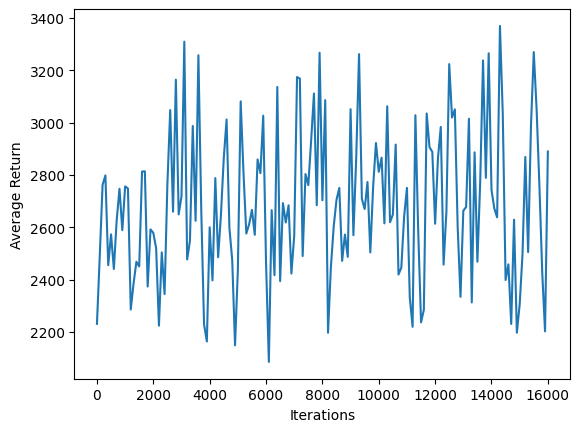

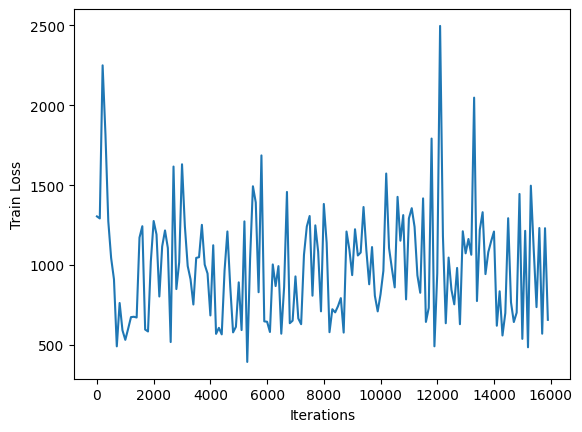

********************ITERATION NUMBER #16000
********************ITERATION NUMBER #16001
********************ITERATION NUMBER #16002
********************ITERATION NUMBER #16003
********************ITERATION NUMBER #16004
********************ITERATION NUMBER #16005
********************ITERATION NUMBER #16006
********************ITERATION NUMBER #16007
********************ITERATION NUMBER #16008
********************ITERATION NUMBER #16009
********************ITERATION NUMBER #16010
********************ITERATION NUMBER #16011
********************ITERATION NUMBER #16012
********************ITERATION NUMBER #16013
********************ITERATION NUMBER #16014
********************ITERATION NUMBER #16015
********************ITERATION NUMBER #16016
********************ITERATION NUMBER #16017
********************ITERATION NUMBER #16018
********************ITERATION NUMBER #16019
********************ITERATION NUMBER #16020
********************ITERATION NUMBER #16021
********************ITERATION NU

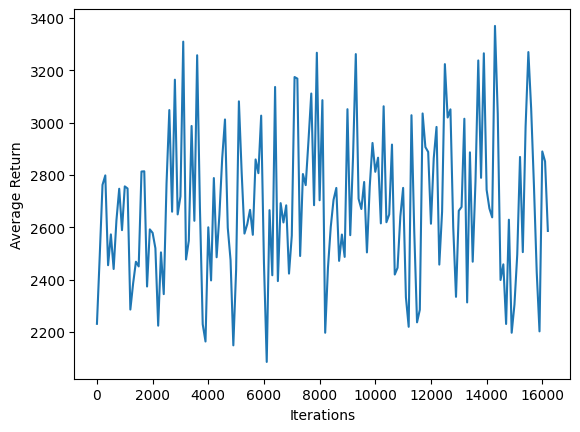

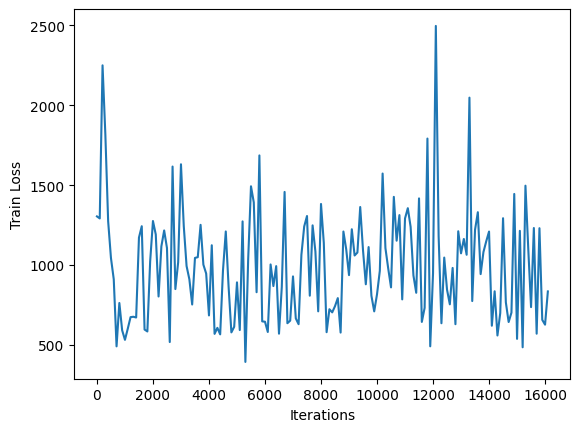

********************ITERATION NUMBER #16200
********************ITERATION NUMBER #16201
********************ITERATION NUMBER #16202
********************ITERATION NUMBER #16203
********************ITERATION NUMBER #16204
********************ITERATION NUMBER #16205
********************ITERATION NUMBER #16206
********************ITERATION NUMBER #16207
********************ITERATION NUMBER #16208
********************ITERATION NUMBER #16209
********************ITERATION NUMBER #16210
********************ITERATION NUMBER #16211
********************ITERATION NUMBER #16212
********************ITERATION NUMBER #16213
********************ITERATION NUMBER #16214
********************ITERATION NUMBER #16215
********************ITERATION NUMBER #16216
********************ITERATION NUMBER #16217
********************ITERATION NUMBER #16218
********************ITERATION NUMBER #16219
********************ITERATION NUMBER #16220
********************ITERATION NUMBER #16221
********************ITERATION NU

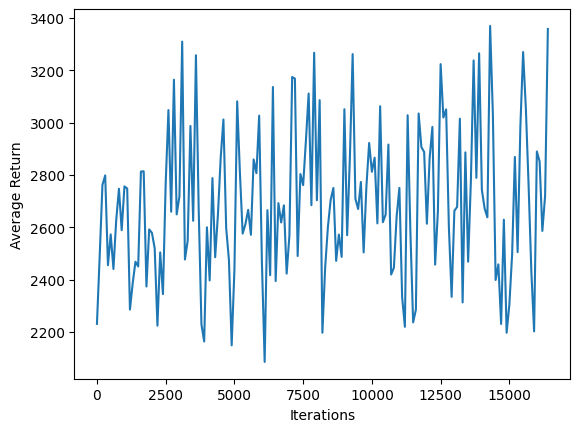

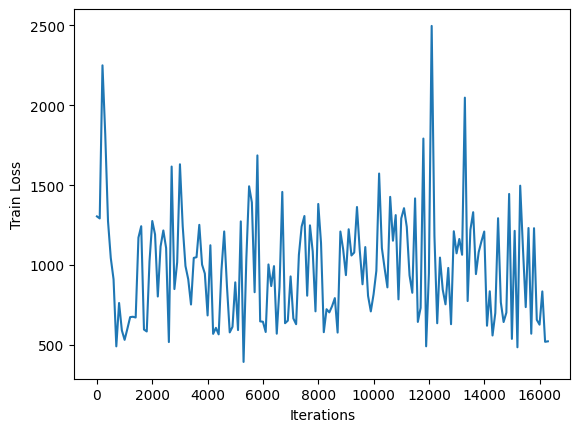

********************ITERATION NUMBER #16400
********************ITERATION NUMBER #16401
********************ITERATION NUMBER #16402
********************ITERATION NUMBER #16403
********************ITERATION NUMBER #16404
********************ITERATION NUMBER #16405
********************ITERATION NUMBER #16406
********************ITERATION NUMBER #16407
********************ITERATION NUMBER #16408
********************ITERATION NUMBER #16409
********************ITERATION NUMBER #16410
********************ITERATION NUMBER #16411
********************ITERATION NUMBER #16412
********************ITERATION NUMBER #16413
********************ITERATION NUMBER #16414
********************ITERATION NUMBER #16415
********************ITERATION NUMBER #16416
********************ITERATION NUMBER #16417
********************ITERATION NUMBER #16418
********************ITERATION NUMBER #16419
********************ITERATION NUMBER #16420
********************ITERATION NUMBER #16421
********************ITERATION NU

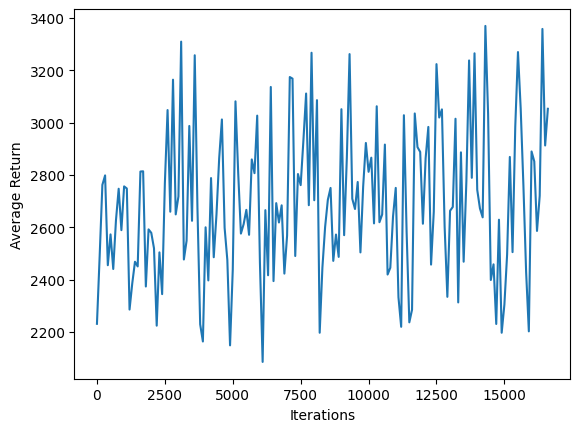

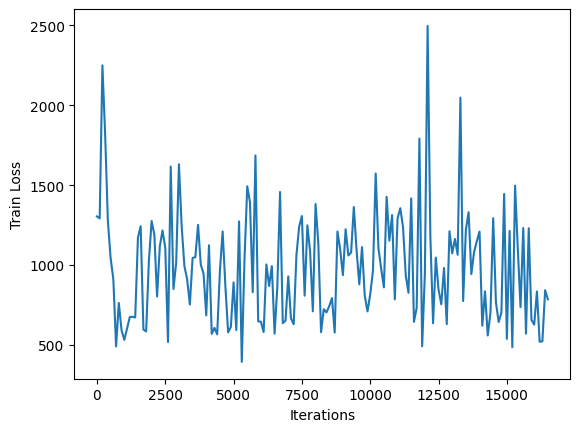

********************ITERATION NUMBER #16600
********************ITERATION NUMBER #16601
********************ITERATION NUMBER #16602
********************ITERATION NUMBER #16603
********************ITERATION NUMBER #16604
********************ITERATION NUMBER #16605
********************ITERATION NUMBER #16606
********************ITERATION NUMBER #16607
********************ITERATION NUMBER #16608
********************ITERATION NUMBER #16609
********************ITERATION NUMBER #16610
********************ITERATION NUMBER #16611
********************ITERATION NUMBER #16612
********************ITERATION NUMBER #16613
********************ITERATION NUMBER #16614
********************ITERATION NUMBER #16615
********************ITERATION NUMBER #16616
********************ITERATION NUMBER #16617
********************ITERATION NUMBER #16618
********************ITERATION NUMBER #16619
********************ITERATION NUMBER #16620
********************ITERATION NUMBER #16621
********************ITERATION NU

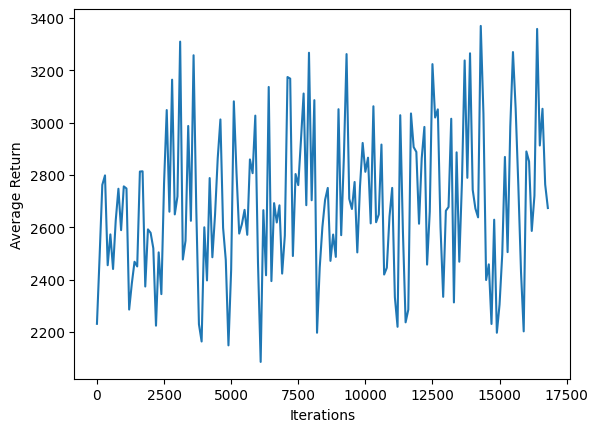

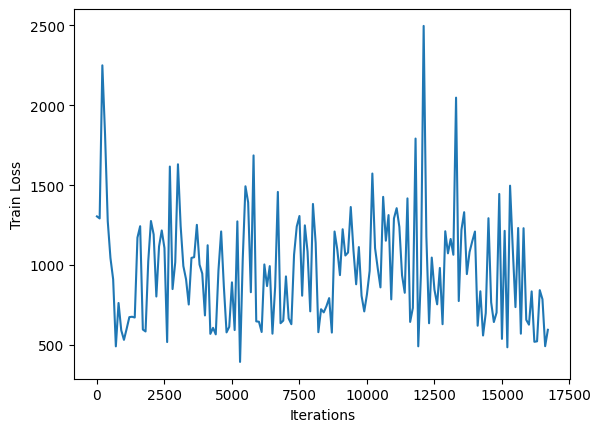

********************ITERATION NUMBER #16800
********************ITERATION NUMBER #16801
********************ITERATION NUMBER #16802
********************ITERATION NUMBER #16803
********************ITERATION NUMBER #16804
********************ITERATION NUMBER #16805
********************ITERATION NUMBER #16806
********************ITERATION NUMBER #16807
********************ITERATION NUMBER #16808
********************ITERATION NUMBER #16809
********************ITERATION NUMBER #16810
********************ITERATION NUMBER #16811
********************ITERATION NUMBER #16812
********************ITERATION NUMBER #16813
********************ITERATION NUMBER #16814
********************ITERATION NUMBER #16815
********************ITERATION NUMBER #16816
********************ITERATION NUMBER #16817
********************ITERATION NUMBER #16818
********************ITERATION NUMBER #16819
********************ITERATION NUMBER #16820
********************ITERATION NUMBER #16821
********************ITERATION NU

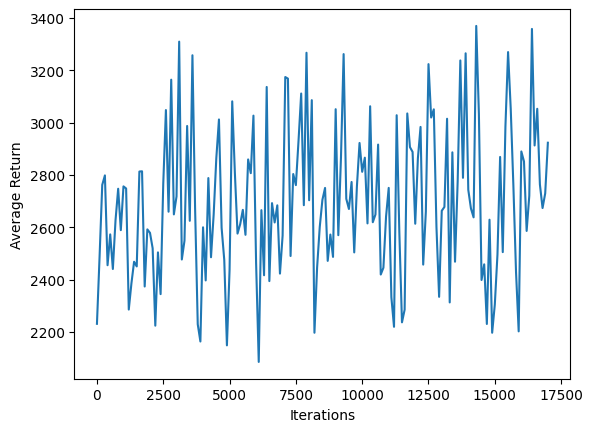

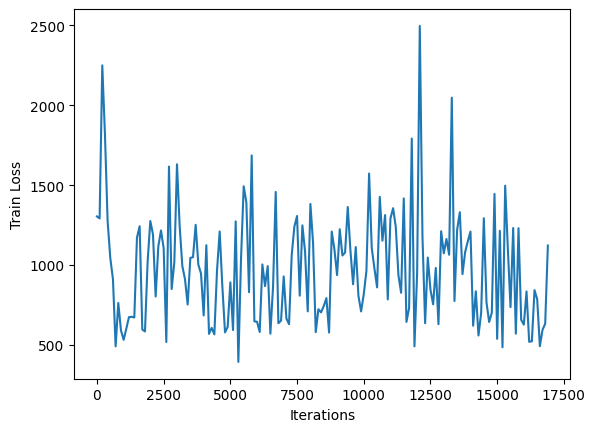

********************ITERATION NUMBER #17000
********************ITERATION NUMBER #17001
********************ITERATION NUMBER #17002
********************ITERATION NUMBER #17003
********************ITERATION NUMBER #17004
********************ITERATION NUMBER #17005
********************ITERATION NUMBER #17006
********************ITERATION NUMBER #17007
********************ITERATION NUMBER #17008
********************ITERATION NUMBER #17009
********************ITERATION NUMBER #17010
********************ITERATION NUMBER #17011
********************ITERATION NUMBER #17012
********************ITERATION NUMBER #17013
********************ITERATION NUMBER #17014
********************ITERATION NUMBER #17015
********************ITERATION NUMBER #17016
********************ITERATION NUMBER #17017
********************ITERATION NUMBER #17018
********************ITERATION NUMBER #17019
********************ITERATION NUMBER #17020
********************ITERATION NUMBER #17021
********************ITERATION NU

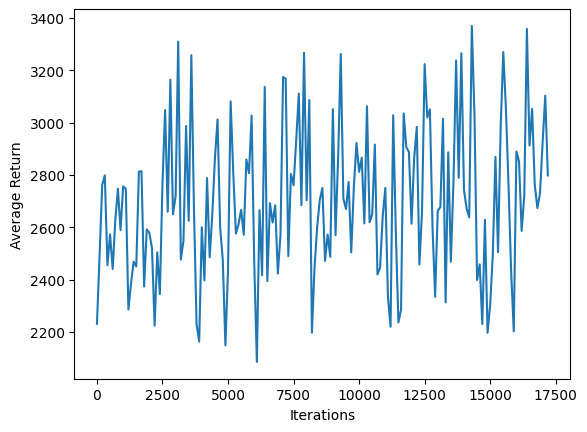

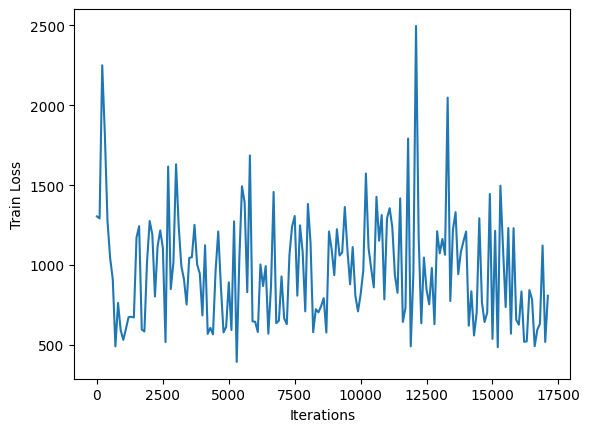

********************ITERATION NUMBER #17200
********************ITERATION NUMBER #17201
********************ITERATION NUMBER #17202
********************ITERATION NUMBER #17203
********************ITERATION NUMBER #17204
********************ITERATION NUMBER #17205
********************ITERATION NUMBER #17206
********************ITERATION NUMBER #17207
********************ITERATION NUMBER #17208
********************ITERATION NUMBER #17209
********************ITERATION NUMBER #17210
********************ITERATION NUMBER #17211
********************ITERATION NUMBER #17212
********************ITERATION NUMBER #17213
********************ITERATION NUMBER #17214
********************ITERATION NUMBER #17215
********************ITERATION NUMBER #17216
********************ITERATION NUMBER #17217
********************ITERATION NUMBER #17218
********************ITERATION NUMBER #17219
********************ITERATION NUMBER #17220
********************ITERATION NUMBER #17221
********************ITERATION NU

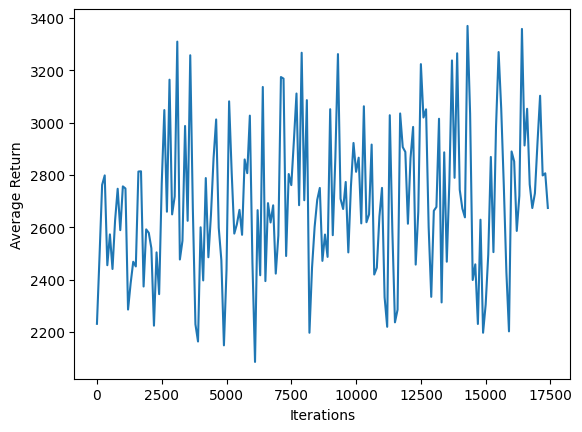

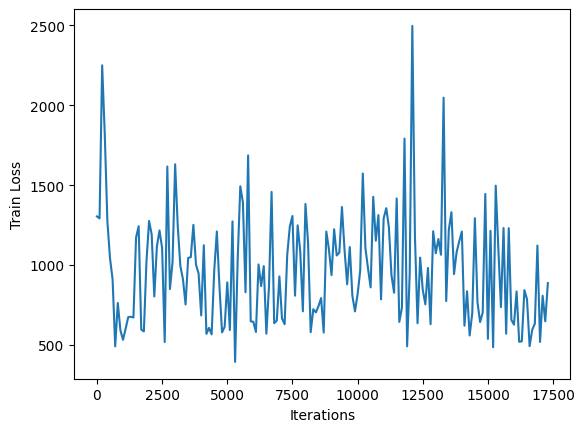

********************ITERATION NUMBER #17400
********************ITERATION NUMBER #17401
********************ITERATION NUMBER #17402
********************ITERATION NUMBER #17403
********************ITERATION NUMBER #17404
********************ITERATION NUMBER #17405
********************ITERATION NUMBER #17406
********************ITERATION NUMBER #17407
********************ITERATION NUMBER #17408
********************ITERATION NUMBER #17409
********************ITERATION NUMBER #17410
********************ITERATION NUMBER #17411
********************ITERATION NUMBER #17412
********************ITERATION NUMBER #17413
********************ITERATION NUMBER #17414
********************ITERATION NUMBER #17415
********************ITERATION NUMBER #17416
********************ITERATION NUMBER #17417
********************ITERATION NUMBER #17418
********************ITERATION NUMBER #17419
********************ITERATION NUMBER #17420
********************ITERATION NUMBER #17421
********************ITERATION NU

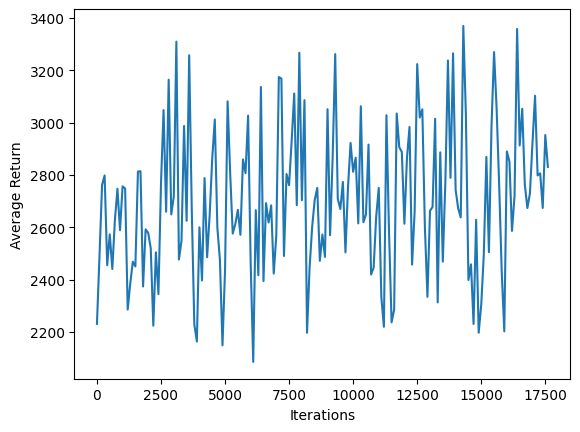

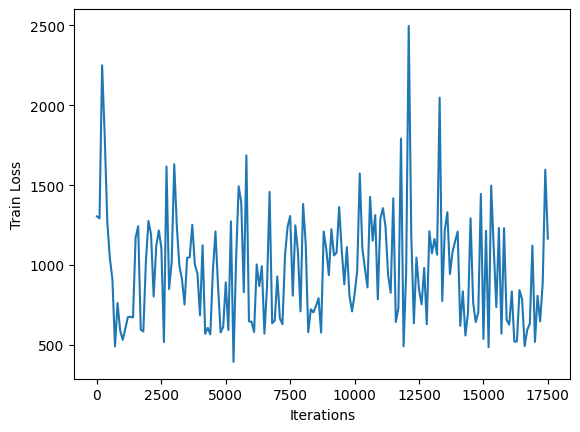

********************ITERATION NUMBER #17600
********************ITERATION NUMBER #17601
********************ITERATION NUMBER #17602
********************ITERATION NUMBER #17603
********************ITERATION NUMBER #17604
********************ITERATION NUMBER #17605
********************ITERATION NUMBER #17606
********************ITERATION NUMBER #17607
********************ITERATION NUMBER #17608
********************ITERATION NUMBER #17609
********************ITERATION NUMBER #17610
********************ITERATION NUMBER #17611
********************ITERATION NUMBER #17612
********************ITERATION NUMBER #17613
********************ITERATION NUMBER #17614
********************ITERATION NUMBER #17615
********************ITERATION NUMBER #17616
********************ITERATION NUMBER #17617
********************ITERATION NUMBER #17618
********************ITERATION NUMBER #17619
********************ITERATION NUMBER #17620
********************ITERATION NUMBER #17621
********************ITERATION NU

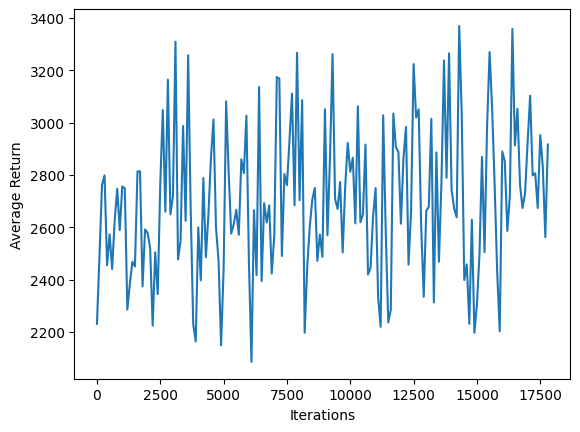

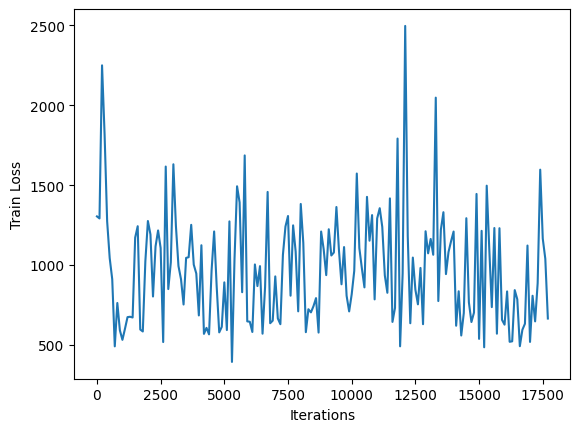

********************ITERATION NUMBER #17800
********************ITERATION NUMBER #17801
********************ITERATION NUMBER #17802
********************ITERATION NUMBER #17803
********************ITERATION NUMBER #17804
********************ITERATION NUMBER #17805
********************ITERATION NUMBER #17806
********************ITERATION NUMBER #17807
********************ITERATION NUMBER #17808
********************ITERATION NUMBER #17809
********************ITERATION NUMBER #17810
********************ITERATION NUMBER #17811
********************ITERATION NUMBER #17812
********************ITERATION NUMBER #17813
********************ITERATION NUMBER #17814
********************ITERATION NUMBER #17815
********************ITERATION NUMBER #17816
********************ITERATION NUMBER #17817
********************ITERATION NUMBER #17818
********************ITERATION NUMBER #17819
********************ITERATION NUMBER #17820
********************ITERATION NUMBER #17821
********************ITERATION NU

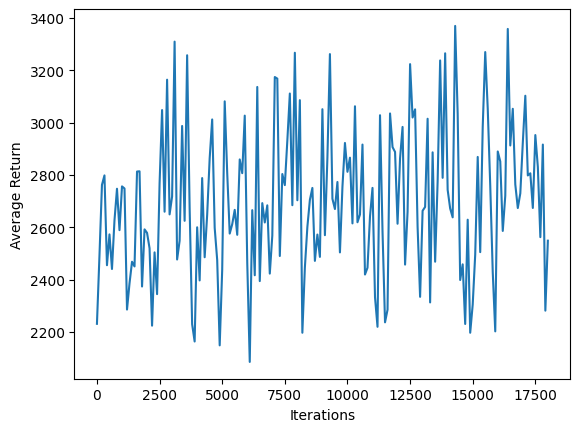

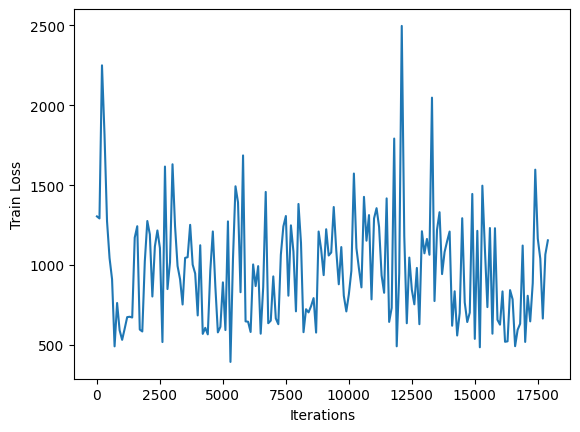

********************ITERATION NUMBER #18000
********************ITERATION NUMBER #18001
********************ITERATION NUMBER #18002
********************ITERATION NUMBER #18003
********************ITERATION NUMBER #18004
********************ITERATION NUMBER #18005
********************ITERATION NUMBER #18006
********************ITERATION NUMBER #18007
********************ITERATION NUMBER #18008
********************ITERATION NUMBER #18009
********************ITERATION NUMBER #18010
********************ITERATION NUMBER #18011
********************ITERATION NUMBER #18012
********************ITERATION NUMBER #18013
********************ITERATION NUMBER #18014
********************ITERATION NUMBER #18015
********************ITERATION NUMBER #18016
********************ITERATION NUMBER #18017
********************ITERATION NUMBER #18018
********************ITERATION NUMBER #18019
********************ITERATION NUMBER #18020
********************ITERATION NUMBER #18021
********************ITERATION NU

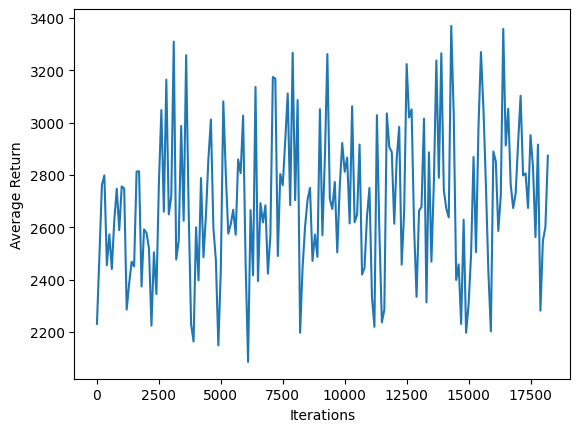

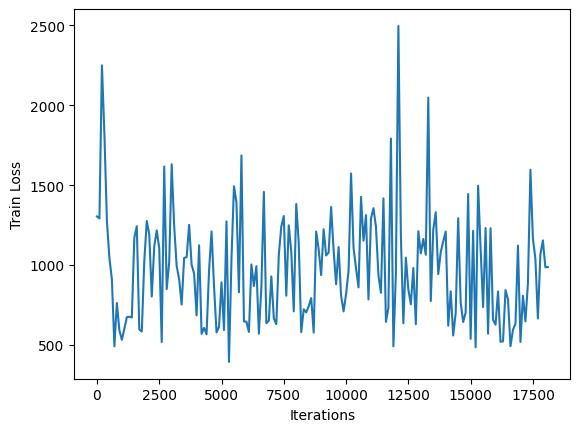

********************ITERATION NUMBER #18200
********************ITERATION NUMBER #18201
********************ITERATION NUMBER #18202
********************ITERATION NUMBER #18203
********************ITERATION NUMBER #18204
********************ITERATION NUMBER #18205
********************ITERATION NUMBER #18206
********************ITERATION NUMBER #18207
********************ITERATION NUMBER #18208
********************ITERATION NUMBER #18209
********************ITERATION NUMBER #18210
********************ITERATION NUMBER #18211
********************ITERATION NUMBER #18212
********************ITERATION NUMBER #18213
********************ITERATION NUMBER #18214
********************ITERATION NUMBER #18215
********************ITERATION NUMBER #18216
********************ITERATION NUMBER #18217
********************ITERATION NUMBER #18218
********************ITERATION NUMBER #18219
********************ITERATION NUMBER #18220
********************ITERATION NUMBER #18221
********************ITERATION NU

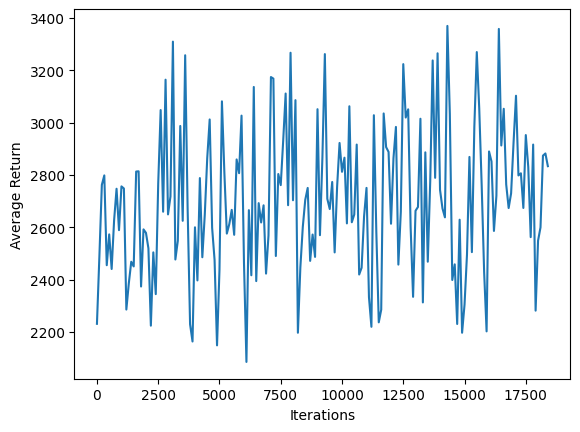

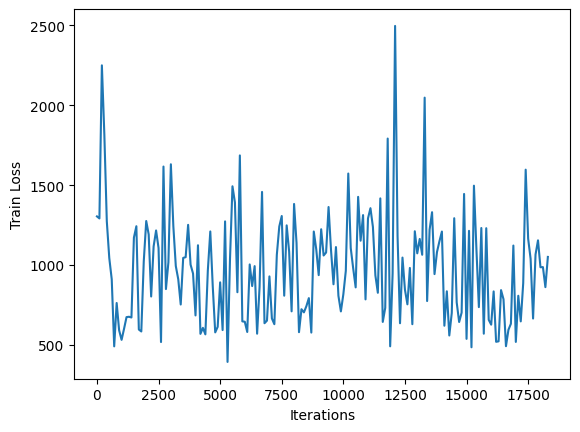

********************ITERATION NUMBER #18400
********************ITERATION NUMBER #18401
********************ITERATION NUMBER #18402
********************ITERATION NUMBER #18403
********************ITERATION NUMBER #18404
********************ITERATION NUMBER #18405
********************ITERATION NUMBER #18406
********************ITERATION NUMBER #18407
********************ITERATION NUMBER #18408
********************ITERATION NUMBER #18409
********************ITERATION NUMBER #18410
********************ITERATION NUMBER #18411
********************ITERATION NUMBER #18412
********************ITERATION NUMBER #18413
********************ITERATION NUMBER #18414
********************ITERATION NUMBER #18415
********************ITERATION NUMBER #18416
********************ITERATION NUMBER #18417
********************ITERATION NUMBER #18418
********************ITERATION NUMBER #18419
********************ITERATION NUMBER #18420
********************ITERATION NUMBER #18421
********************ITERATION NU

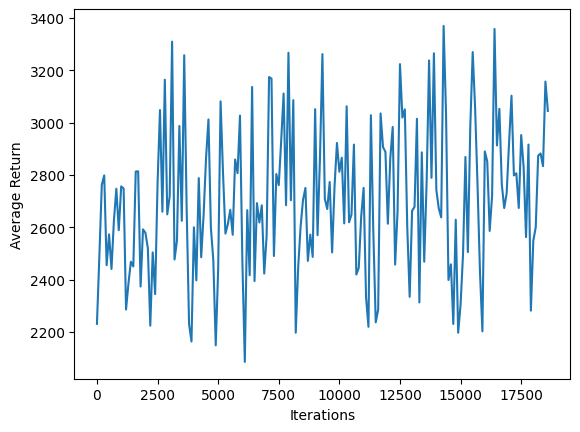

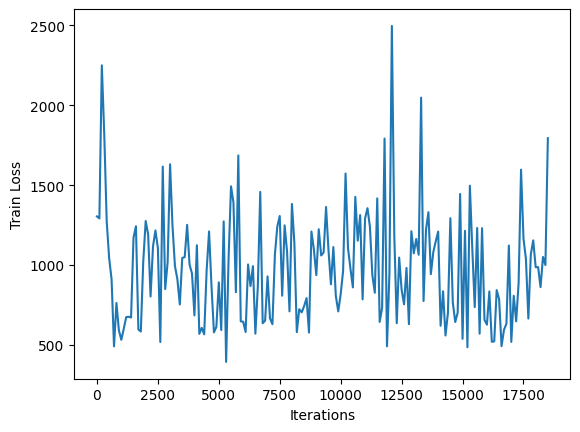

********************ITERATION NUMBER #18600
********************ITERATION NUMBER #18601
********************ITERATION NUMBER #18602
********************ITERATION NUMBER #18603
********************ITERATION NUMBER #18604
********************ITERATION NUMBER #18605
********************ITERATION NUMBER #18606
********************ITERATION NUMBER #18607
********************ITERATION NUMBER #18608
********************ITERATION NUMBER #18609
********************ITERATION NUMBER #18610
********************ITERATION NUMBER #18611
********************ITERATION NUMBER #18612
********************ITERATION NUMBER #18613
********************ITERATION NUMBER #18614
********************ITERATION NUMBER #18615
********************ITERATION NUMBER #18616
********************ITERATION NUMBER #18617
********************ITERATION NUMBER #18618
********************ITERATION NUMBER #18619
********************ITERATION NUMBER #18620
********************ITERATION NUMBER #18621
********************ITERATION NU

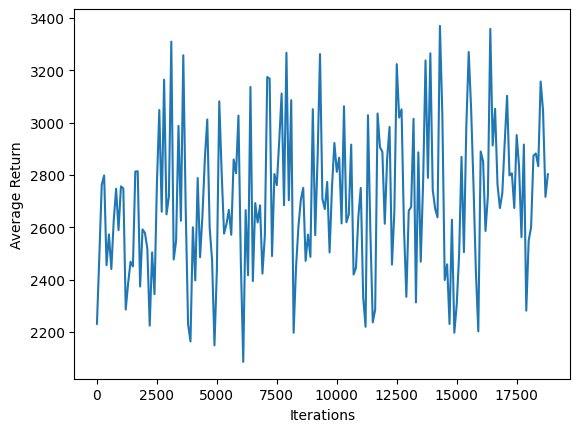

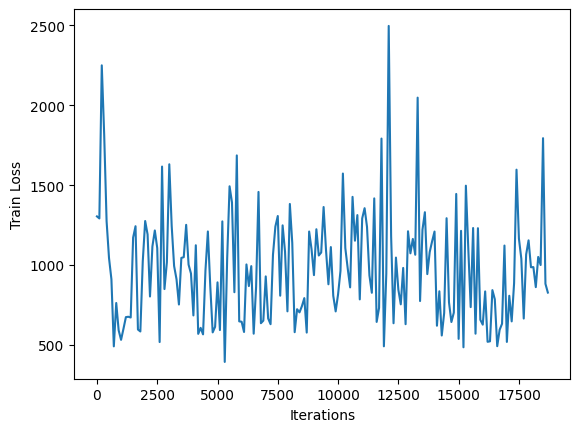

********************ITERATION NUMBER #18800
********************ITERATION NUMBER #18801
********************ITERATION NUMBER #18802
********************ITERATION NUMBER #18803
********************ITERATION NUMBER #18804
********************ITERATION NUMBER #18805
********************ITERATION NUMBER #18806
********************ITERATION NUMBER #18807
********************ITERATION NUMBER #18808
********************ITERATION NUMBER #18809
********************ITERATION NUMBER #18810
********************ITERATION NUMBER #18811
********************ITERATION NUMBER #18812
********************ITERATION NUMBER #18813
********************ITERATION NUMBER #18814
********************ITERATION NUMBER #18815
********************ITERATION NUMBER #18816
********************ITERATION NUMBER #18817
********************ITERATION NUMBER #18818
********************ITERATION NUMBER #18819
********************ITERATION NUMBER #18820
********************ITERATION NUMBER #18821
********************ITERATION NU

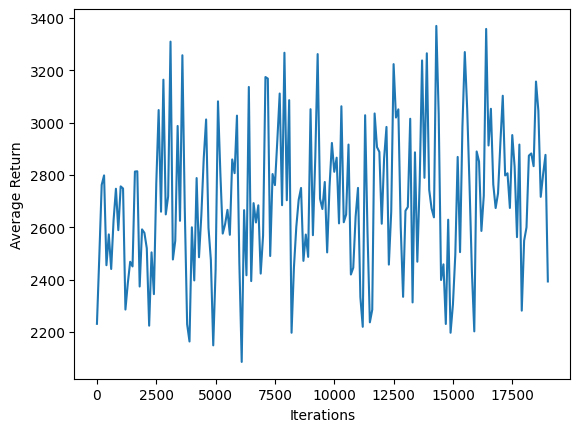

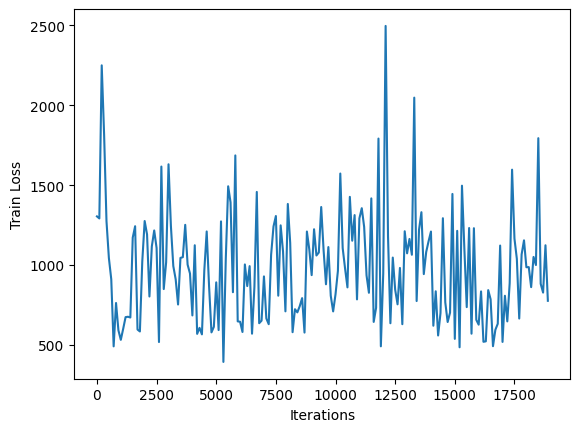

********************ITERATION NUMBER #19000
********************ITERATION NUMBER #19001
********************ITERATION NUMBER #19002
********************ITERATION NUMBER #19003
********************ITERATION NUMBER #19004
********************ITERATION NUMBER #19005
********************ITERATION NUMBER #19006
********************ITERATION NUMBER #19007
********************ITERATION NUMBER #19008
********************ITERATION NUMBER #19009
********************ITERATION NUMBER #19010
********************ITERATION NUMBER #19011
********************ITERATION NUMBER #19012
********************ITERATION NUMBER #19013
********************ITERATION NUMBER #19014
********************ITERATION NUMBER #19015
********************ITERATION NUMBER #19016
********************ITERATION NUMBER #19017
********************ITERATION NUMBER #19018
********************ITERATION NUMBER #19019
********************ITERATION NUMBER #19020
********************ITERATION NUMBER #19021
********************ITERATION NU

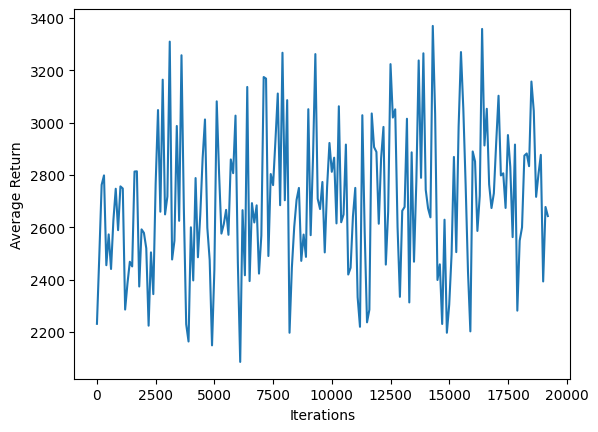

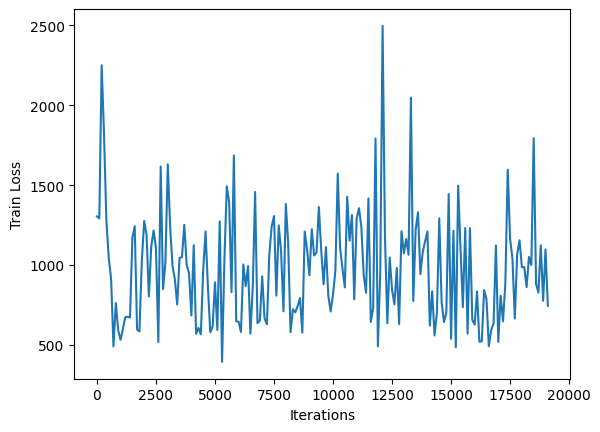

********************ITERATION NUMBER #19200
********************ITERATION NUMBER #19201
********************ITERATION NUMBER #19202
********************ITERATION NUMBER #19203
********************ITERATION NUMBER #19204
********************ITERATION NUMBER #19205
********************ITERATION NUMBER #19206
********************ITERATION NUMBER #19207
********************ITERATION NUMBER #19208
********************ITERATION NUMBER #19209
********************ITERATION NUMBER #19210
********************ITERATION NUMBER #19211
********************ITERATION NUMBER #19212
********************ITERATION NUMBER #19213
********************ITERATION NUMBER #19214
********************ITERATION NUMBER #19215
********************ITERATION NUMBER #19216
********************ITERATION NUMBER #19217
********************ITERATION NUMBER #19218
********************ITERATION NUMBER #19219
********************ITERATION NUMBER #19220
********************ITERATION NUMBER #19221
********************ITERATION NU

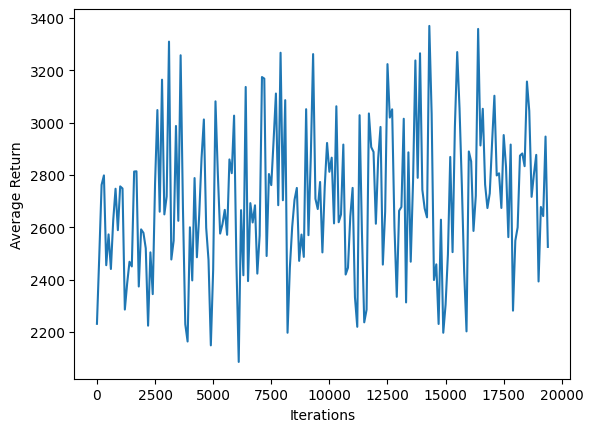

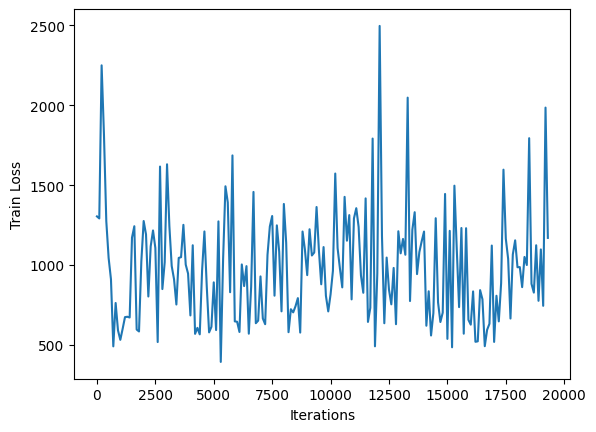

********************ITERATION NUMBER #19400
********************ITERATION NUMBER #19401
********************ITERATION NUMBER #19402
********************ITERATION NUMBER #19403
********************ITERATION NUMBER #19404
********************ITERATION NUMBER #19405
********************ITERATION NUMBER #19406
********************ITERATION NUMBER #19407
********************ITERATION NUMBER #19408
********************ITERATION NUMBER #19409
********************ITERATION NUMBER #19410
********************ITERATION NUMBER #19411
********************ITERATION NUMBER #19412
********************ITERATION NUMBER #19413
********************ITERATION NUMBER #19414
********************ITERATION NUMBER #19415
********************ITERATION NUMBER #19416
********************ITERATION NUMBER #19417
********************ITERATION NUMBER #19418
********************ITERATION NUMBER #19419
********************ITERATION NUMBER #19420
********************ITERATION NUMBER #19421
********************ITERATION NU

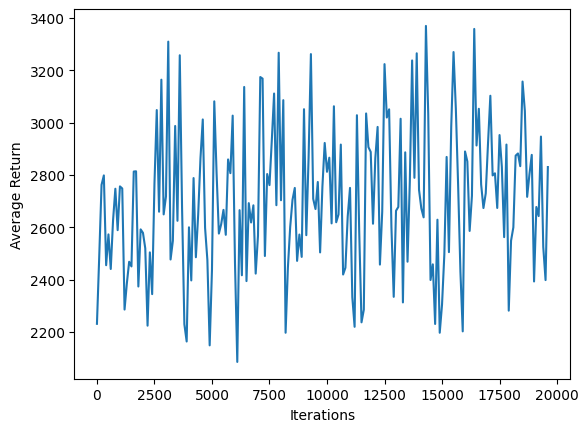

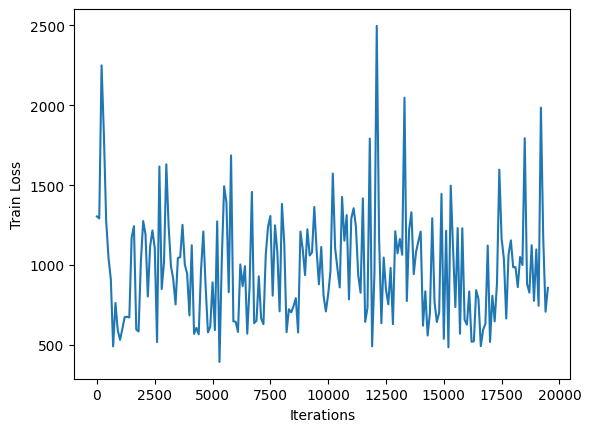

********************ITERATION NUMBER #19600
********************ITERATION NUMBER #19601
********************ITERATION NUMBER #19602
********************ITERATION NUMBER #19603
********************ITERATION NUMBER #19604
********************ITERATION NUMBER #19605
********************ITERATION NUMBER #19606
********************ITERATION NUMBER #19607
********************ITERATION NUMBER #19608
********************ITERATION NUMBER #19609
********************ITERATION NUMBER #19610
********************ITERATION NUMBER #19611
********************ITERATION NUMBER #19612
********************ITERATION NUMBER #19613
********************ITERATION NUMBER #19614
********************ITERATION NUMBER #19615
********************ITERATION NUMBER #19616
********************ITERATION NUMBER #19617
********************ITERATION NUMBER #19618
********************ITERATION NUMBER #19619
********************ITERATION NUMBER #19620
********************ITERATION NUMBER #19621
********************ITERATION NU

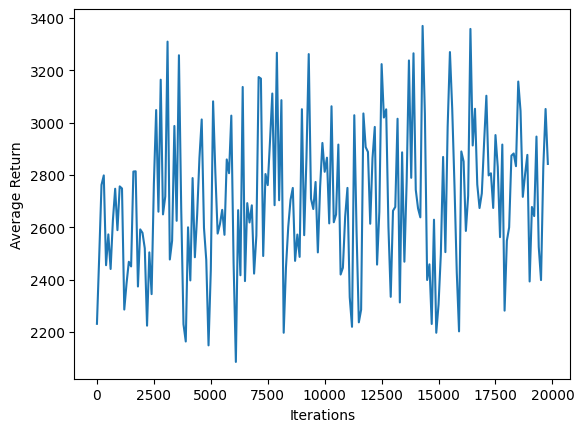

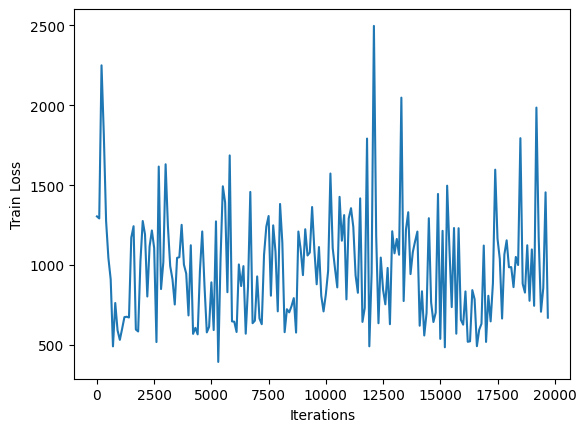

********************ITERATION NUMBER #19800
********************ITERATION NUMBER #19801
********************ITERATION NUMBER #19802
********************ITERATION NUMBER #19803
********************ITERATION NUMBER #19804
********************ITERATION NUMBER #19805
********************ITERATION NUMBER #19806
********************ITERATION NUMBER #19807
********************ITERATION NUMBER #19808
********************ITERATION NUMBER #19809
********************ITERATION NUMBER #19810
********************ITERATION NUMBER #19811
********************ITERATION NUMBER #19812
********************ITERATION NUMBER #19813
********************ITERATION NUMBER #19814
********************ITERATION NUMBER #19815
********************ITERATION NUMBER #19816
********************ITERATION NUMBER #19817
********************ITERATION NUMBER #19818
********************ITERATION NUMBER #19819
********************ITERATION NUMBER #19820
********************ITERATION NUMBER #19821
********************ITERATION NU

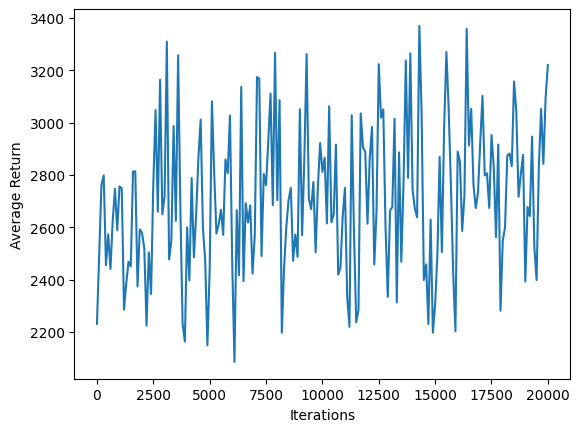

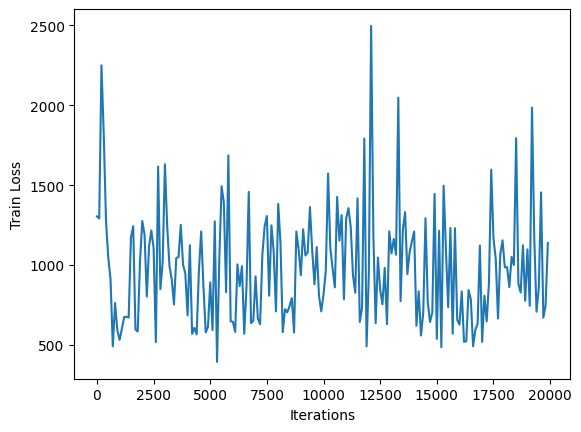

********************ITERATION NUMBER #20000
********************ITERATION NUMBER #20001
********************ITERATION NUMBER #20002
********************ITERATION NUMBER #20003
********************ITERATION NUMBER #20004
********************ITERATION NUMBER #20005
********************ITERATION NUMBER #20006
********************ITERATION NUMBER #20007
********************ITERATION NUMBER #20008
********************ITERATION NUMBER #20009
********************ITERATION NUMBER #20010
********************ITERATION NUMBER #20011
********************ITERATION NUMBER #20012
********************ITERATION NUMBER #20013
********************ITERATION NUMBER #20014
********************ITERATION NUMBER #20015
********************ITERATION NUMBER #20016
********************ITERATION NUMBER #20017
********************ITERATION NUMBER #20018
********************ITERATION NUMBER #20019
********************ITERATION NUMBER #20020
********************ITERATION NUMBER #20021
********************ITERATION NU

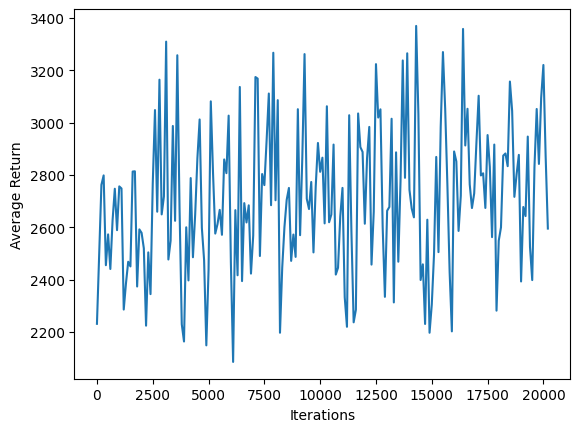

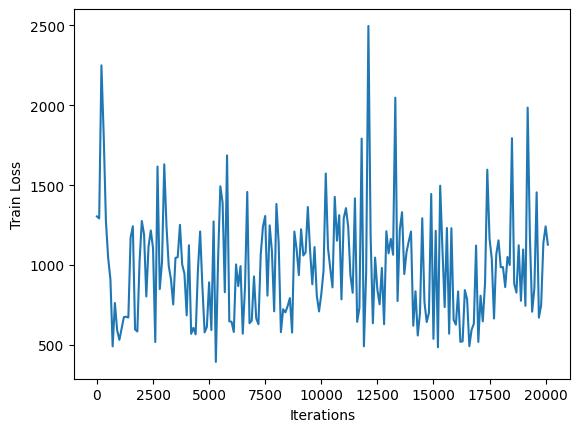

********************ITERATION NUMBER #20200
********************ITERATION NUMBER #20201
********************ITERATION NUMBER #20202
********************ITERATION NUMBER #20203
********************ITERATION NUMBER #20204
********************ITERATION NUMBER #20205
********************ITERATION NUMBER #20206
********************ITERATION NUMBER #20207
********************ITERATION NUMBER #20208
********************ITERATION NUMBER #20209
********************ITERATION NUMBER #20210
********************ITERATION NUMBER #20211
********************ITERATION NUMBER #20212
********************ITERATION NUMBER #20213
********************ITERATION NUMBER #20214
********************ITERATION NUMBER #20215
********************ITERATION NUMBER #20216
********************ITERATION NUMBER #20217
********************ITERATION NUMBER #20218
********************ITERATION NUMBER #20219
********************ITERATION NUMBER #20220
********************ITERATION NUMBER #20221
********************ITERATION NU

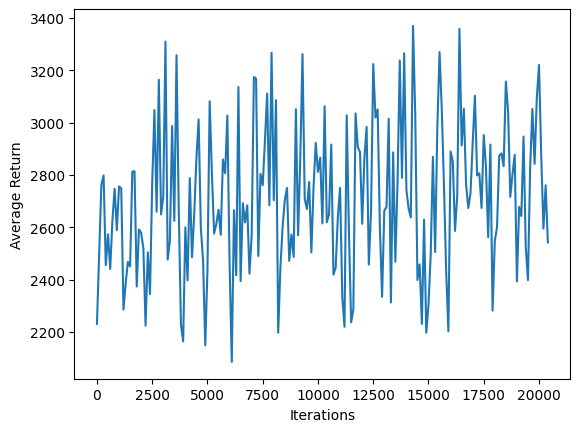

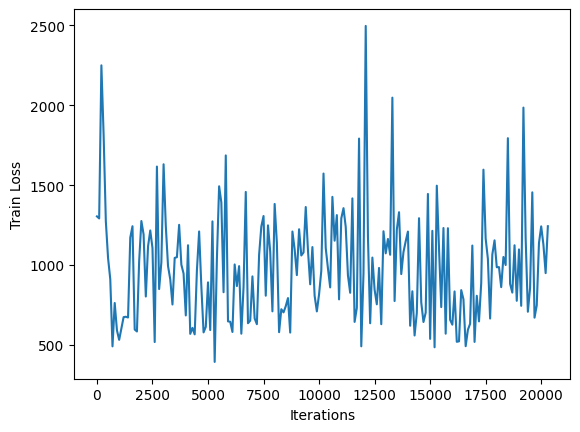

********************ITERATION NUMBER #20400
********************ITERATION NUMBER #20401
********************ITERATION NUMBER #20402
********************ITERATION NUMBER #20403
********************ITERATION NUMBER #20404
********************ITERATION NUMBER #20405
********************ITERATION NUMBER #20406
********************ITERATION NUMBER #20407
********************ITERATION NUMBER #20408
********************ITERATION NUMBER #20409
********************ITERATION NUMBER #20410
********************ITERATION NUMBER #20411
********************ITERATION NUMBER #20412
********************ITERATION NUMBER #20413
********************ITERATION NUMBER #20414
********************ITERATION NUMBER #20415
********************ITERATION NUMBER #20416
********************ITERATION NUMBER #20417
********************ITERATION NUMBER #20418
********************ITERATION NUMBER #20419
********************ITERATION NUMBER #20420
********************ITERATION NUMBER #20421
********************ITERATION NU

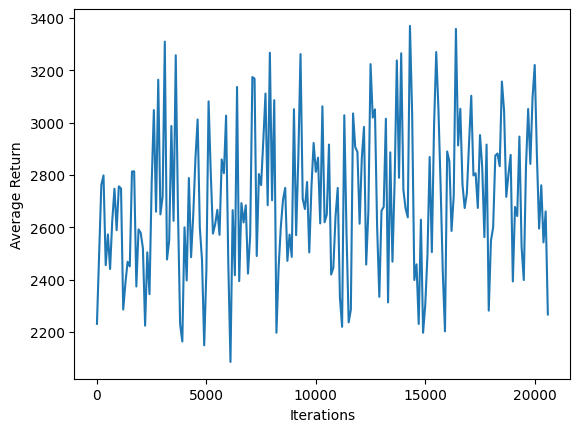

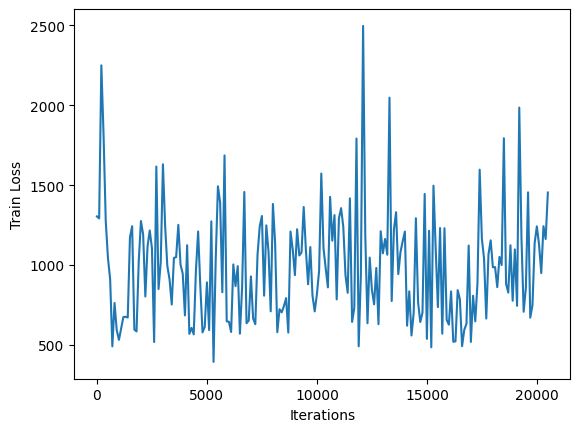

********************ITERATION NUMBER #20600
********************ITERATION NUMBER #20601
********************ITERATION NUMBER #20602
********************ITERATION NUMBER #20603
********************ITERATION NUMBER #20604
********************ITERATION NUMBER #20605
********************ITERATION NUMBER #20606
********************ITERATION NUMBER #20607
********************ITERATION NUMBER #20608
********************ITERATION NUMBER #20609
********************ITERATION NUMBER #20610
********************ITERATION NUMBER #20611
********************ITERATION NUMBER #20612
********************ITERATION NUMBER #20613
********************ITERATION NUMBER #20614
********************ITERATION NUMBER #20615
********************ITERATION NUMBER #20616
********************ITERATION NUMBER #20617
********************ITERATION NUMBER #20618
********************ITERATION NUMBER #20619
********************ITERATION NUMBER #20620
********************ITERATION NUMBER #20621
********************ITERATION NU

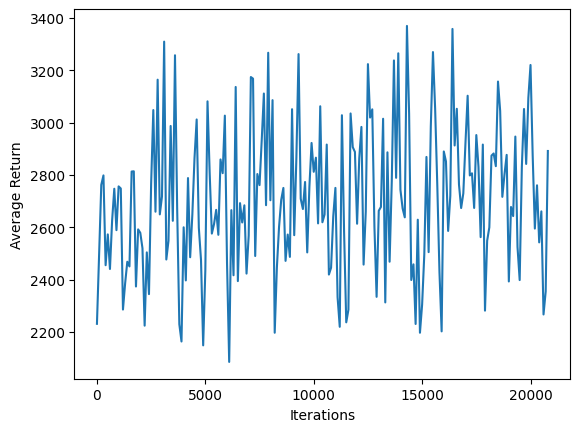

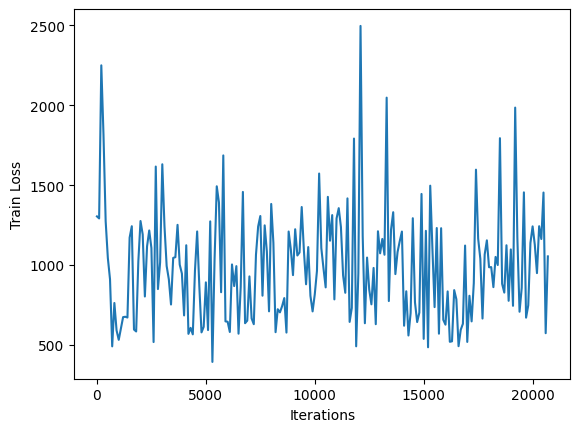

********************ITERATION NUMBER #20800
********************ITERATION NUMBER #20801
********************ITERATION NUMBER #20802
********************ITERATION NUMBER #20803
********************ITERATION NUMBER #20804
********************ITERATION NUMBER #20805
********************ITERATION NUMBER #20806
********************ITERATION NUMBER #20807
********************ITERATION NUMBER #20808
********************ITERATION NUMBER #20809
********************ITERATION NUMBER #20810
********************ITERATION NUMBER #20811
********************ITERATION NUMBER #20812
********************ITERATION NUMBER #20813
********************ITERATION NUMBER #20814
********************ITERATION NUMBER #20815
********************ITERATION NUMBER #20816
********************ITERATION NUMBER #20817
********************ITERATION NUMBER #20818
********************ITERATION NUMBER #20819
********************ITERATION NUMBER #20820
********************ITERATION NUMBER #20821
********************ITERATION NU

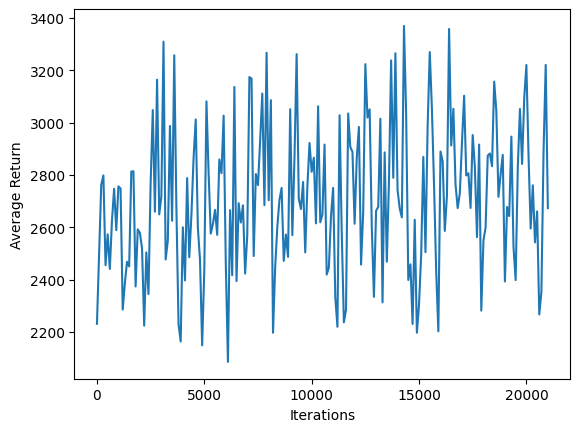

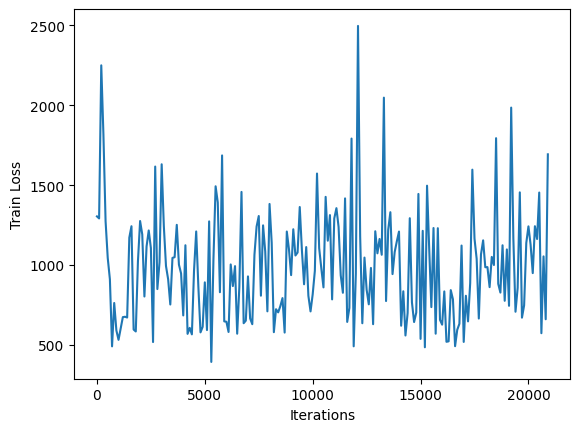

********************ITERATION NUMBER #21000
********************ITERATION NUMBER #21001
********************ITERATION NUMBER #21002
********************ITERATION NUMBER #21003
********************ITERATION NUMBER #21004
********************ITERATION NUMBER #21005
********************ITERATION NUMBER #21006
********************ITERATION NUMBER #21007
********************ITERATION NUMBER #21008
********************ITERATION NUMBER #21009
********************ITERATION NUMBER #21010
********************ITERATION NUMBER #21011
********************ITERATION NUMBER #21012
********************ITERATION NUMBER #21013
********************ITERATION NUMBER #21014
********************ITERATION NUMBER #21015
********************ITERATION NUMBER #21016
********************ITERATION NUMBER #21017
********************ITERATION NUMBER #21018
********************ITERATION NUMBER #21019
********************ITERATION NUMBER #21020
********************ITERATION NUMBER #21021
********************ITERATION NU

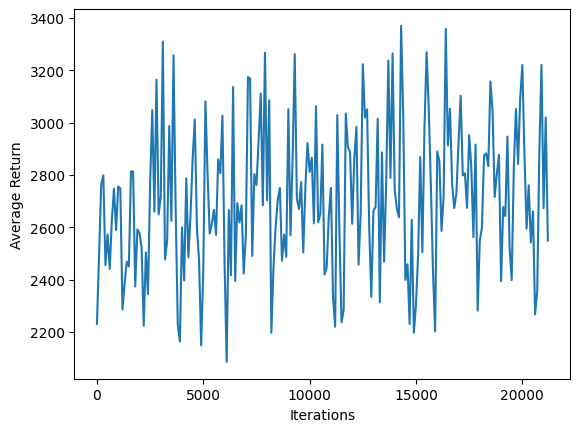

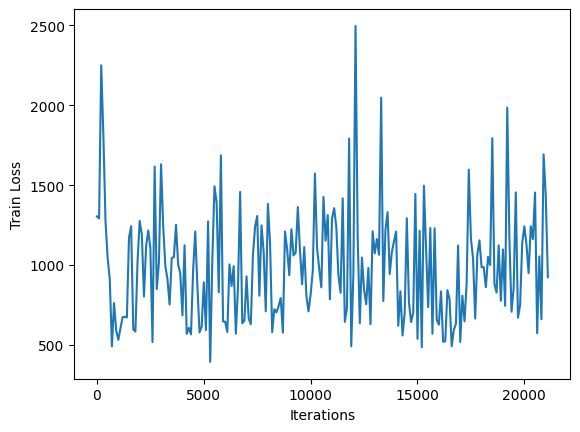

********************ITERATION NUMBER #21200
********************ITERATION NUMBER #21201
********************ITERATION NUMBER #21202
********************ITERATION NUMBER #21203
********************ITERATION NUMBER #21204
********************ITERATION NUMBER #21205
********************ITERATION NUMBER #21206
********************ITERATION NUMBER #21207
********************ITERATION NUMBER #21208
********************ITERATION NUMBER #21209
********************ITERATION NUMBER #21210
********************ITERATION NUMBER #21211
********************ITERATION NUMBER #21212
********************ITERATION NUMBER #21213
********************ITERATION NUMBER #21214
********************ITERATION NUMBER #21215
********************ITERATION NUMBER #21216
********************ITERATION NUMBER #21217
********************ITERATION NUMBER #21218
********************ITERATION NUMBER #21219
********************ITERATION NUMBER #21220
********************ITERATION NUMBER #21221
********************ITERATION NU

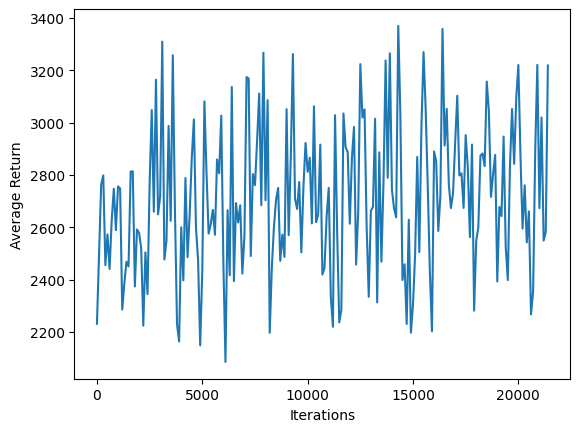

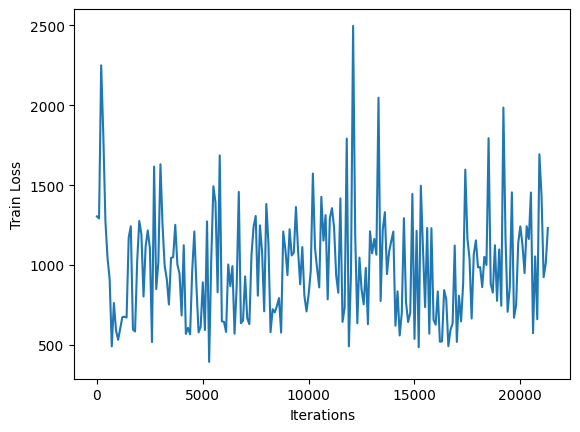

********************ITERATION NUMBER #21400
********************ITERATION NUMBER #21401
********************ITERATION NUMBER #21402
********************ITERATION NUMBER #21403
********************ITERATION NUMBER #21404
********************ITERATION NUMBER #21405
********************ITERATION NUMBER #21406
********************ITERATION NUMBER #21407
********************ITERATION NUMBER #21408
********************ITERATION NUMBER #21409
********************ITERATION NUMBER #21410
********************ITERATION NUMBER #21411
********************ITERATION NUMBER #21412
********************ITERATION NUMBER #21413
********************ITERATION NUMBER #21414
********************ITERATION NUMBER #21415
********************ITERATION NUMBER #21416
********************ITERATION NUMBER #21417
********************ITERATION NUMBER #21418
********************ITERATION NUMBER #21419
********************ITERATION NUMBER #21420
********************ITERATION NUMBER #21421
********************ITERATION NU

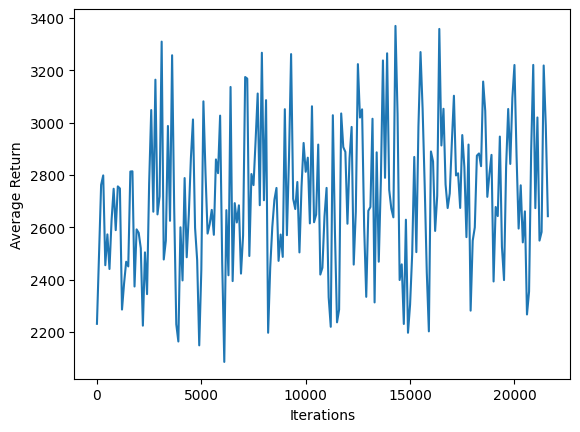

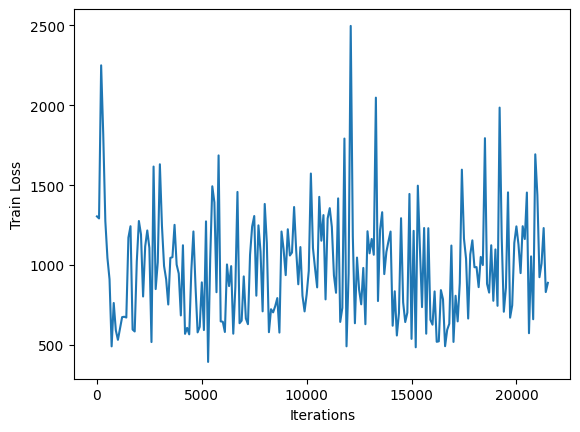

********************ITERATION NUMBER #21600
********************ITERATION NUMBER #21601
********************ITERATION NUMBER #21602
********************ITERATION NUMBER #21603
********************ITERATION NUMBER #21604
********************ITERATION NUMBER #21605
********************ITERATION NUMBER #21606
********************ITERATION NUMBER #21607
********************ITERATION NUMBER #21608
********************ITERATION NUMBER #21609
********************ITERATION NUMBER #21610
********************ITERATION NUMBER #21611
********************ITERATION NUMBER #21612
********************ITERATION NUMBER #21613
********************ITERATION NUMBER #21614
********************ITERATION NUMBER #21615
********************ITERATION NUMBER #21616
********************ITERATION NUMBER #21617
********************ITERATION NUMBER #21618
********************ITERATION NUMBER #21619
********************ITERATION NUMBER #21620
********************ITERATION NUMBER #21621
********************ITERATION NU

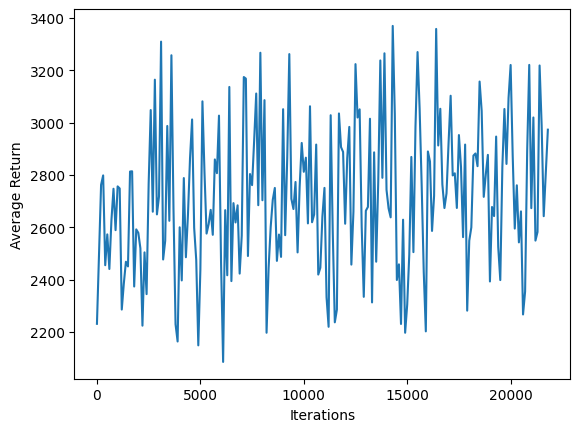

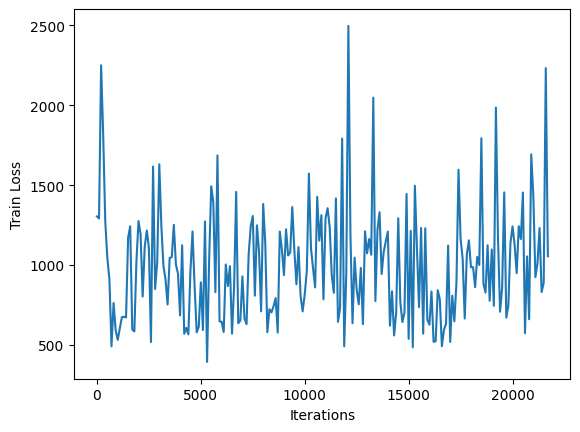

********************ITERATION NUMBER #21800
********************ITERATION NUMBER #21801
********************ITERATION NUMBER #21802
********************ITERATION NUMBER #21803
********************ITERATION NUMBER #21804
********************ITERATION NUMBER #21805
********************ITERATION NUMBER #21806
********************ITERATION NUMBER #21807
********************ITERATION NUMBER #21808
********************ITERATION NUMBER #21809
********************ITERATION NUMBER #21810
********************ITERATION NUMBER #21811
********************ITERATION NUMBER #21812
********************ITERATION NUMBER #21813
********************ITERATION NUMBER #21814
********************ITERATION NUMBER #21815
********************ITERATION NUMBER #21816
********************ITERATION NUMBER #21817
********************ITERATION NUMBER #21818
********************ITERATION NUMBER #21819
********************ITERATION NUMBER #21820
********************ITERATION NUMBER #21821
********************ITERATION NU

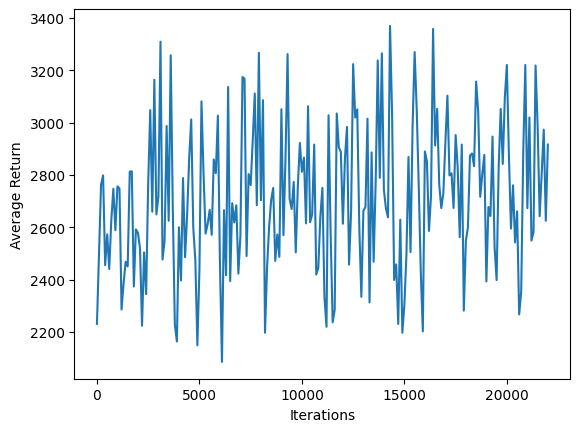

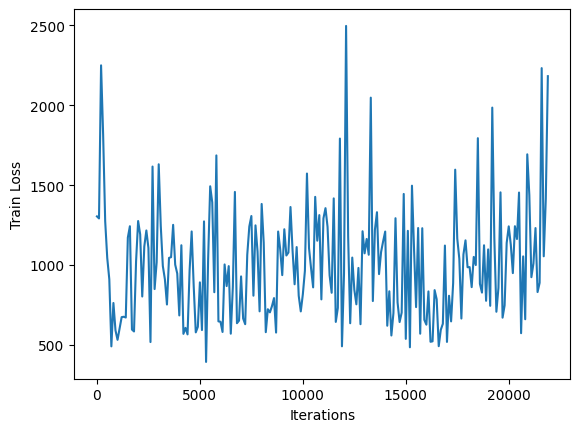

********************ITERATION NUMBER #22000
********************ITERATION NUMBER #22001
********************ITERATION NUMBER #22002
********************ITERATION NUMBER #22003
********************ITERATION NUMBER #22004
********************ITERATION NUMBER #22005
********************ITERATION NUMBER #22006
********************ITERATION NUMBER #22007
********************ITERATION NUMBER #22008
********************ITERATION NUMBER #22009
********************ITERATION NUMBER #22010
********************ITERATION NUMBER #22011
********************ITERATION NUMBER #22012
********************ITERATION NUMBER #22013
********************ITERATION NUMBER #22014
********************ITERATION NUMBER #22015
********************ITERATION NUMBER #22016
********************ITERATION NUMBER #22017
********************ITERATION NUMBER #22018
********************ITERATION NUMBER #22019
********************ITERATION NUMBER #22020
********************ITERATION NUMBER #22021
********************ITERATION NU

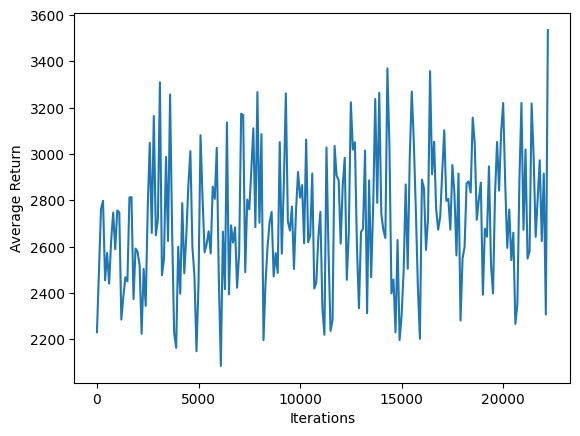

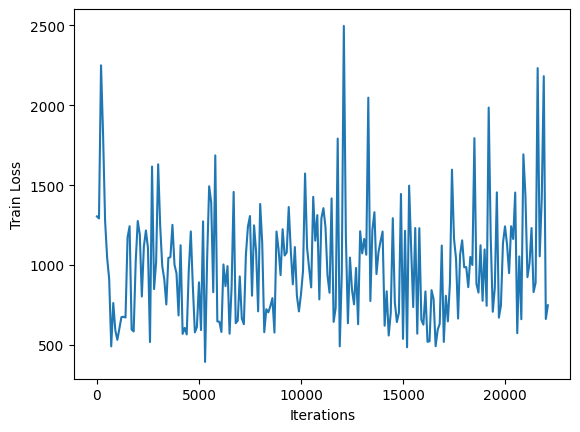

********************ITERATION NUMBER #22200
********************ITERATION NUMBER #22201
********************ITERATION NUMBER #22202
********************ITERATION NUMBER #22203
********************ITERATION NUMBER #22204
********************ITERATION NUMBER #22205
********************ITERATION NUMBER #22206
********************ITERATION NUMBER #22207
********************ITERATION NUMBER #22208
********************ITERATION NUMBER #22209
********************ITERATION NUMBER #22210
********************ITERATION NUMBER #22211
********************ITERATION NUMBER #22212
********************ITERATION NUMBER #22213
********************ITERATION NUMBER #22214
********************ITERATION NUMBER #22215
********************ITERATION NUMBER #22216
********************ITERATION NUMBER #22217
********************ITERATION NUMBER #22218
********************ITERATION NUMBER #22219
********************ITERATION NUMBER #22220
********************ITERATION NUMBER #22221
********************ITERATION NU

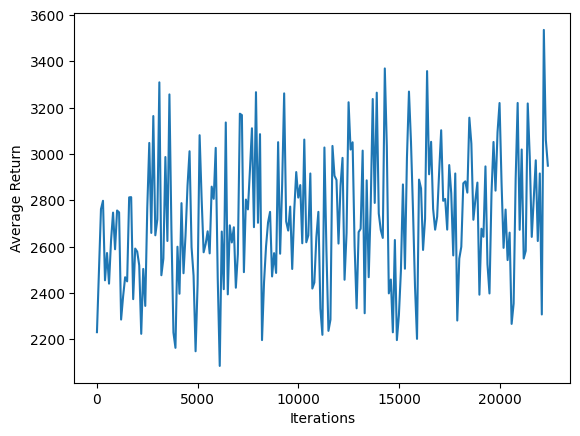

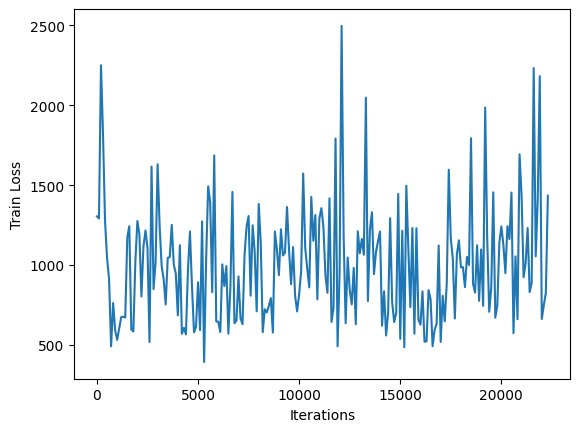

********************ITERATION NUMBER #22400
********************ITERATION NUMBER #22401
********************ITERATION NUMBER #22402
********************ITERATION NUMBER #22403
********************ITERATION NUMBER #22404
********************ITERATION NUMBER #22405
********************ITERATION NUMBER #22406
********************ITERATION NUMBER #22407
********************ITERATION NUMBER #22408
********************ITERATION NUMBER #22409
********************ITERATION NUMBER #22410
********************ITERATION NUMBER #22411
********************ITERATION NUMBER #22412
********************ITERATION NUMBER #22413
********************ITERATION NUMBER #22414
********************ITERATION NUMBER #22415
********************ITERATION NUMBER #22416
********************ITERATION NUMBER #22417
********************ITERATION NUMBER #22418
********************ITERATION NUMBER #22419
********************ITERATION NUMBER #22420
********************ITERATION NUMBER #22421
********************ITERATION NU

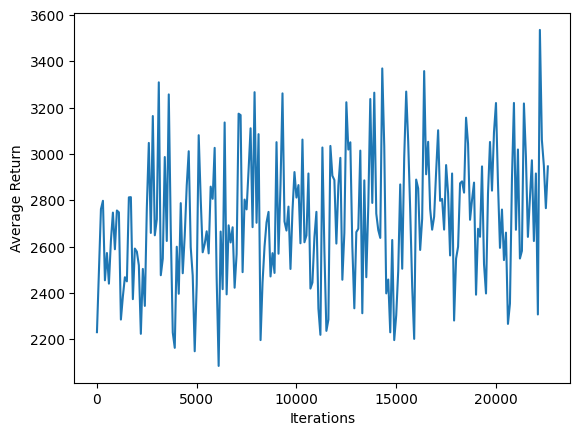

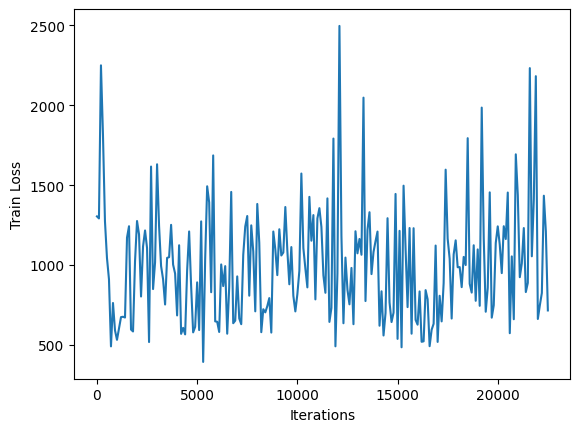

********************ITERATION NUMBER #22600
********************ITERATION NUMBER #22601
********************ITERATION NUMBER #22602
********************ITERATION NUMBER #22603
********************ITERATION NUMBER #22604
********************ITERATION NUMBER #22605
********************ITERATION NUMBER #22606
********************ITERATION NUMBER #22607
********************ITERATION NUMBER #22608
********************ITERATION NUMBER #22609
********************ITERATION NUMBER #22610
********************ITERATION NUMBER #22611
********************ITERATION NUMBER #22612
********************ITERATION NUMBER #22613
********************ITERATION NUMBER #22614
********************ITERATION NUMBER #22615
********************ITERATION NUMBER #22616
********************ITERATION NUMBER #22617
********************ITERATION NUMBER #22618
********************ITERATION NUMBER #22619
********************ITERATION NUMBER #22620
********************ITERATION NUMBER #22621
********************ITERATION NU

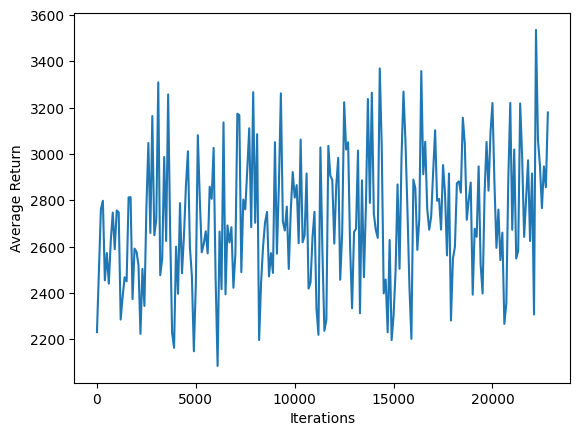

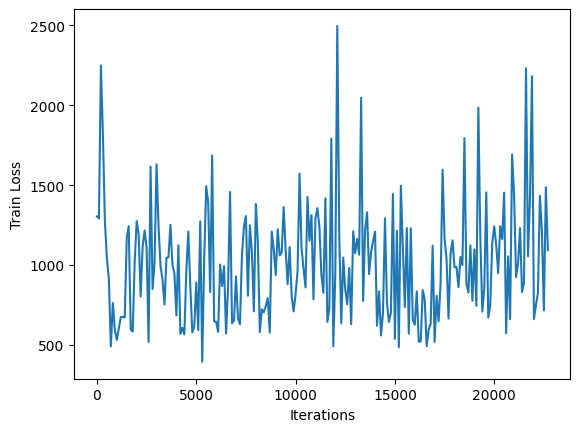

********************ITERATION NUMBER #22800
********************ITERATION NUMBER #22801
********************ITERATION NUMBER #22802
********************ITERATION NUMBER #22803
********************ITERATION NUMBER #22804
********************ITERATION NUMBER #22805
********************ITERATION NUMBER #22806
********************ITERATION NUMBER #22807
********************ITERATION NUMBER #22808
********************ITERATION NUMBER #22809
********************ITERATION NUMBER #22810
********************ITERATION NUMBER #22811
********************ITERATION NUMBER #22812
********************ITERATION NUMBER #22813
********************ITERATION NUMBER #22814
********************ITERATION NUMBER #22815
********************ITERATION NUMBER #22816
********************ITERATION NUMBER #22817
********************ITERATION NUMBER #22818
********************ITERATION NUMBER #22819
********************ITERATION NUMBER #22820
********************ITERATION NUMBER #22821
********************ITERATION NU

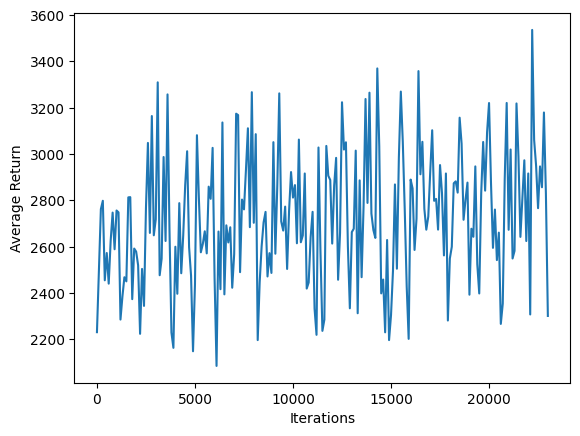

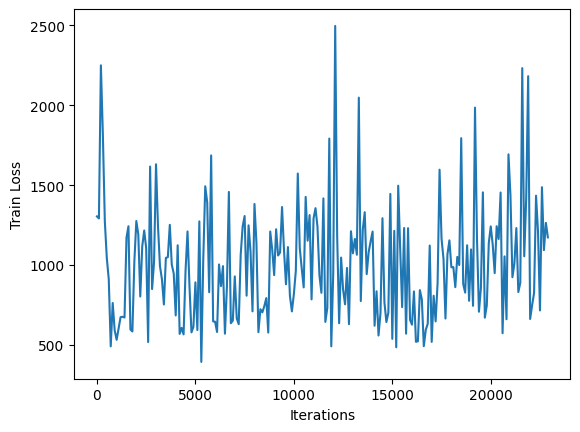

********************ITERATION NUMBER #23000
********************ITERATION NUMBER #23001
********************ITERATION NUMBER #23002
********************ITERATION NUMBER #23003
********************ITERATION NUMBER #23004
********************ITERATION NUMBER #23005
********************ITERATION NUMBER #23006
********************ITERATION NUMBER #23007
********************ITERATION NUMBER #23008
********************ITERATION NUMBER #23009
********************ITERATION NUMBER #23010
********************ITERATION NUMBER #23011
********************ITERATION NUMBER #23012
********************ITERATION NUMBER #23013
********************ITERATION NUMBER #23014
********************ITERATION NUMBER #23015
********************ITERATION NUMBER #23016
********************ITERATION NUMBER #23017
********************ITERATION NUMBER #23018
********************ITERATION NUMBER #23019
********************ITERATION NUMBER #23020
********************ITERATION NUMBER #23021
********************ITERATION NU

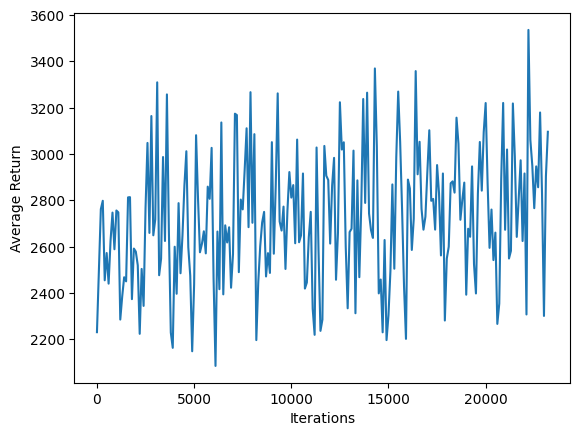

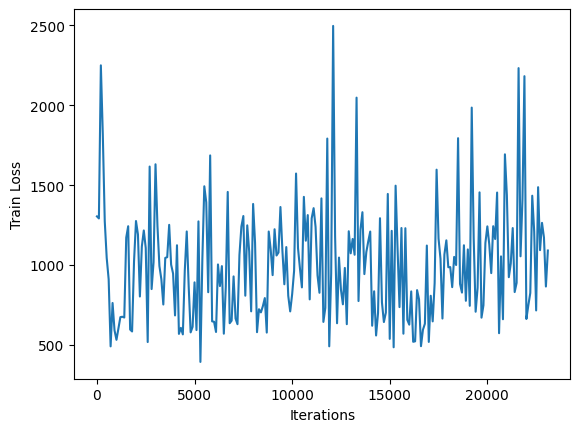

********************ITERATION NUMBER #23200
********************ITERATION NUMBER #23201
********************ITERATION NUMBER #23202
********************ITERATION NUMBER #23203
********************ITERATION NUMBER #23204
********************ITERATION NUMBER #23205
********************ITERATION NUMBER #23206
********************ITERATION NUMBER #23207
********************ITERATION NUMBER #23208
********************ITERATION NUMBER #23209
********************ITERATION NUMBER #23210
********************ITERATION NUMBER #23211
********************ITERATION NUMBER #23212
********************ITERATION NUMBER #23213
********************ITERATION NUMBER #23214
********************ITERATION NUMBER #23215
********************ITERATION NUMBER #23216
********************ITERATION NUMBER #23217
********************ITERATION NUMBER #23218
********************ITERATION NUMBER #23219
********************ITERATION NUMBER #23220
********************ITERATION NUMBER #23221
********************ITERATION NU

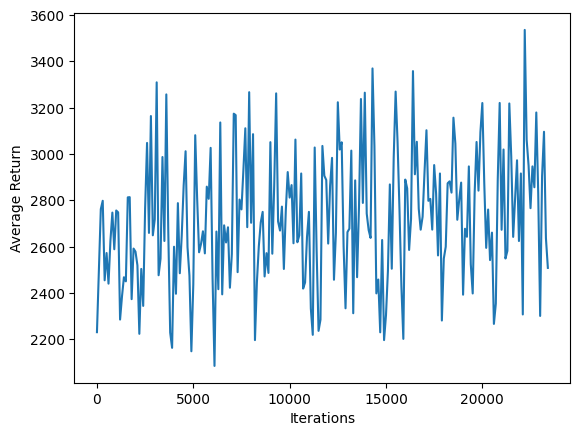

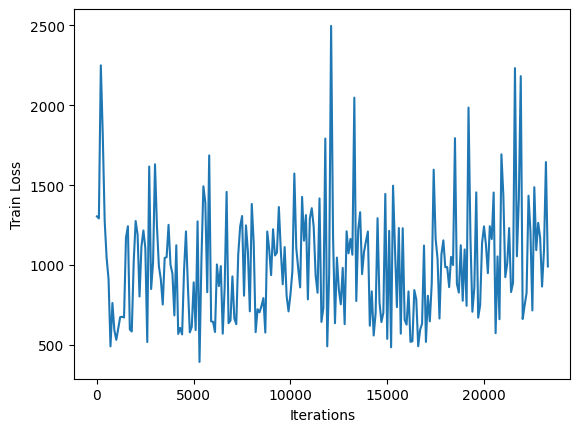

********************ITERATION NUMBER #23400
********************ITERATION NUMBER #23401
********************ITERATION NUMBER #23402
********************ITERATION NUMBER #23403
********************ITERATION NUMBER #23404
********************ITERATION NUMBER #23405
********************ITERATION NUMBER #23406
********************ITERATION NUMBER #23407
********************ITERATION NUMBER #23408
********************ITERATION NUMBER #23409
********************ITERATION NUMBER #23410
********************ITERATION NUMBER #23411
********************ITERATION NUMBER #23412
********************ITERATION NUMBER #23413
********************ITERATION NUMBER #23414
********************ITERATION NUMBER #23415
********************ITERATION NUMBER #23416
********************ITERATION NUMBER #23417
********************ITERATION NUMBER #23418
********************ITERATION NUMBER #23419
********************ITERATION NUMBER #23420
********************ITERATION NUMBER #23421
********************ITERATION NU

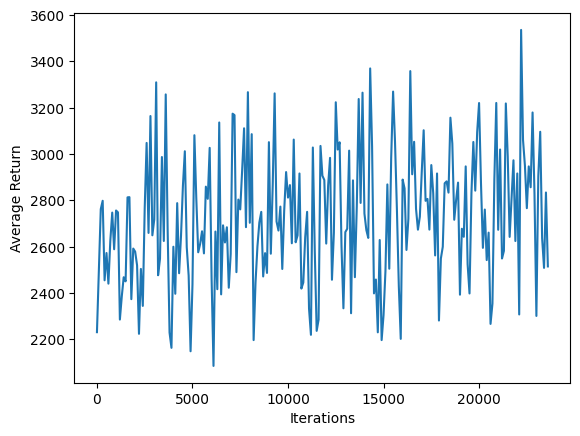

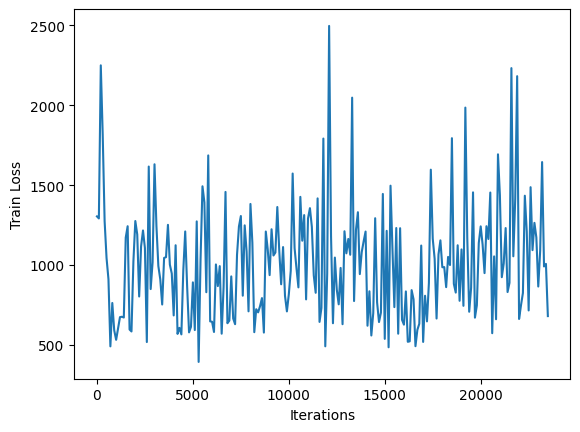

********************ITERATION NUMBER #23600
********************ITERATION NUMBER #23601
********************ITERATION NUMBER #23602
********************ITERATION NUMBER #23603
********************ITERATION NUMBER #23604
********************ITERATION NUMBER #23605
********************ITERATION NUMBER #23606
********************ITERATION NUMBER #23607
********************ITERATION NUMBER #23608
********************ITERATION NUMBER #23609
********************ITERATION NUMBER #23610
********************ITERATION NUMBER #23611
********************ITERATION NUMBER #23612
********************ITERATION NUMBER #23613
********************ITERATION NUMBER #23614
********************ITERATION NUMBER #23615
********************ITERATION NUMBER #23616
********************ITERATION NUMBER #23617
********************ITERATION NUMBER #23618
********************ITERATION NUMBER #23619
********************ITERATION NUMBER #23620
********************ITERATION NUMBER #23621
********************ITERATION NU

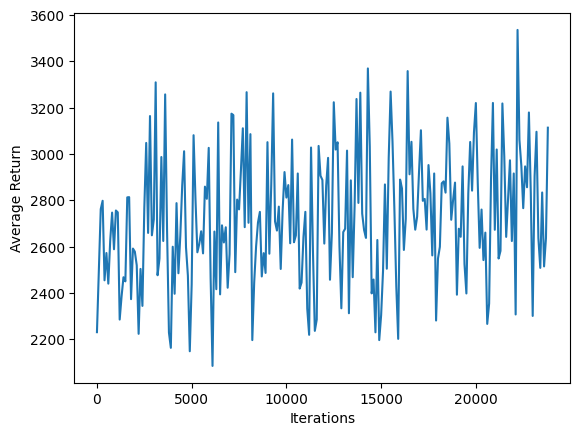

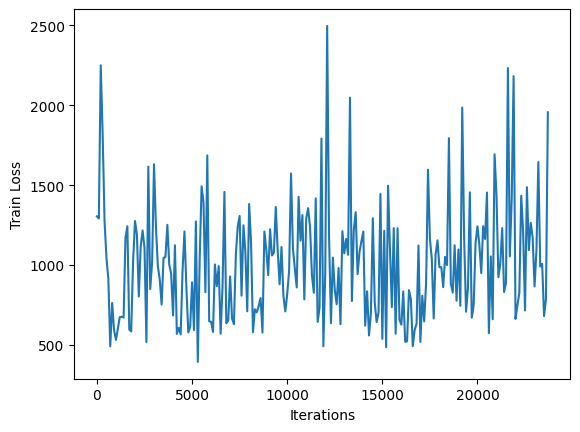

********************ITERATION NUMBER #23800
********************ITERATION NUMBER #23801
********************ITERATION NUMBER #23802
********************ITERATION NUMBER #23803
********************ITERATION NUMBER #23804
********************ITERATION NUMBER #23805
********************ITERATION NUMBER #23806
********************ITERATION NUMBER #23807
********************ITERATION NUMBER #23808
********************ITERATION NUMBER #23809
********************ITERATION NUMBER #23810
********************ITERATION NUMBER #23811
********************ITERATION NUMBER #23812
********************ITERATION NUMBER #23813
********************ITERATION NUMBER #23814
********************ITERATION NUMBER #23815
********************ITERATION NUMBER #23816
********************ITERATION NUMBER #23817
********************ITERATION NUMBER #23818
********************ITERATION NUMBER #23819
********************ITERATION NUMBER #23820
********************ITERATION NUMBER #23821
********************ITERATION NU

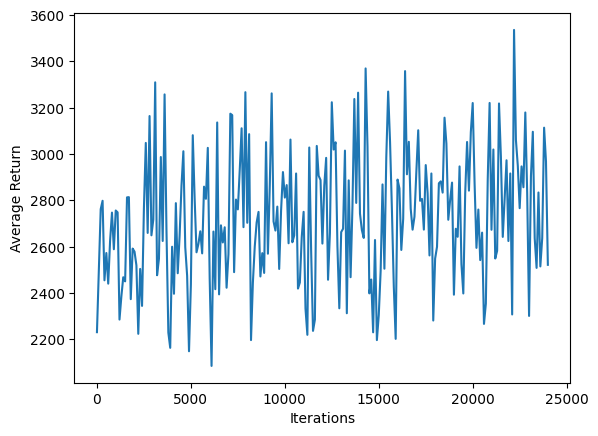

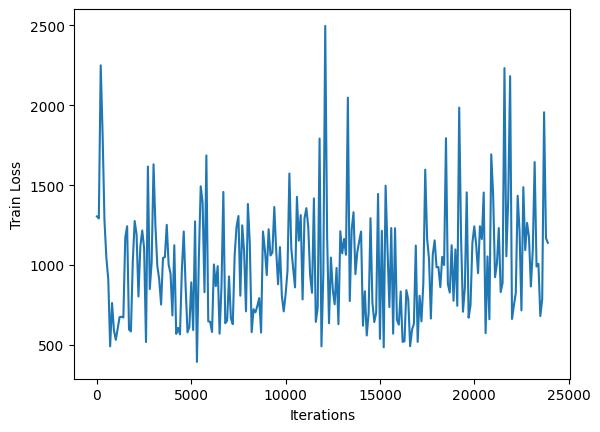

********************ITERATION NUMBER #24000
********************ITERATION NUMBER #24001
********************ITERATION NUMBER #24002
********************ITERATION NUMBER #24003
********************ITERATION NUMBER #24004
********************ITERATION NUMBER #24005
********************ITERATION NUMBER #24006
********************ITERATION NUMBER #24007
********************ITERATION NUMBER #24008
********************ITERATION NUMBER #24009
********************ITERATION NUMBER #24010
********************ITERATION NUMBER #24011
********************ITERATION NUMBER #24012
********************ITERATION NUMBER #24013
********************ITERATION NUMBER #24014
********************ITERATION NUMBER #24015
********************ITERATION NUMBER #24016
********************ITERATION NUMBER #24017
********************ITERATION NUMBER #24018
********************ITERATION NUMBER #24019
********************ITERATION NUMBER #24020
********************ITERATION NUMBER #24021
********************ITERATION NU

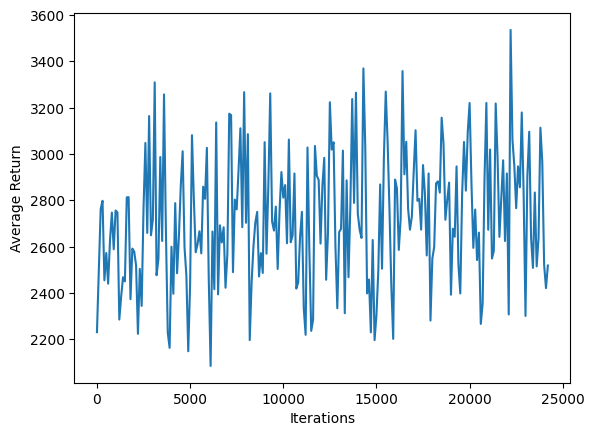

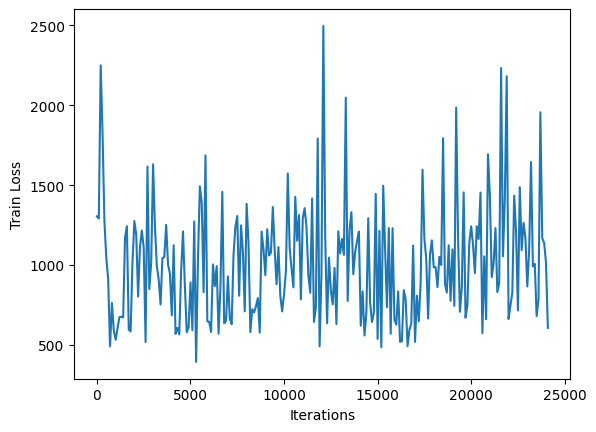

********************ITERATION NUMBER #24200
********************ITERATION NUMBER #24201
********************ITERATION NUMBER #24202
********************ITERATION NUMBER #24203
********************ITERATION NUMBER #24204
********************ITERATION NUMBER #24205
********************ITERATION NUMBER #24206
********************ITERATION NUMBER #24207
********************ITERATION NUMBER #24208
********************ITERATION NUMBER #24209
********************ITERATION NUMBER #24210
********************ITERATION NUMBER #24211
********************ITERATION NUMBER #24212
********************ITERATION NUMBER #24213
********************ITERATION NUMBER #24214
********************ITERATION NUMBER #24215
********************ITERATION NUMBER #24216
********************ITERATION NUMBER #24217
********************ITERATION NUMBER #24218
********************ITERATION NUMBER #24219
********************ITERATION NUMBER #24220
********************ITERATION NUMBER #24221
********************ITERATION NU

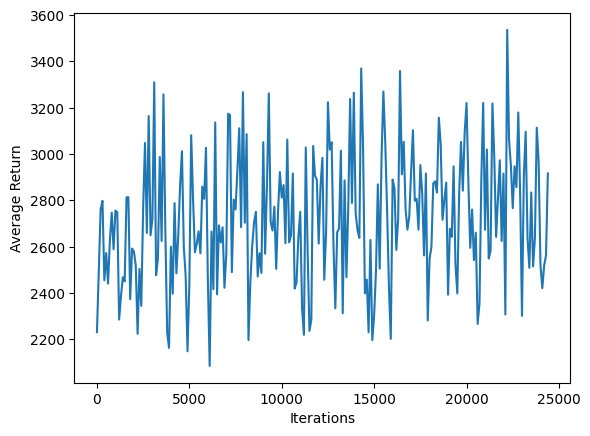

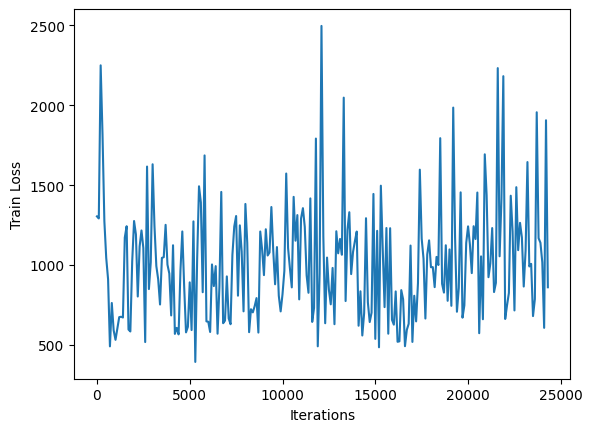

********************ITERATION NUMBER #24400
********************ITERATION NUMBER #24401
********************ITERATION NUMBER #24402
********************ITERATION NUMBER #24403
********************ITERATION NUMBER #24404
********************ITERATION NUMBER #24405
********************ITERATION NUMBER #24406
********************ITERATION NUMBER #24407
********************ITERATION NUMBER #24408
********************ITERATION NUMBER #24409
********************ITERATION NUMBER #24410
********************ITERATION NUMBER #24411
********************ITERATION NUMBER #24412
********************ITERATION NUMBER #24413
********************ITERATION NUMBER #24414
********************ITERATION NUMBER #24415
********************ITERATION NUMBER #24416
********************ITERATION NUMBER #24417
********************ITERATION NUMBER #24418
********************ITERATION NUMBER #24419
********************ITERATION NUMBER #24420
********************ITERATION NUMBER #24421
********************ITERATION NU

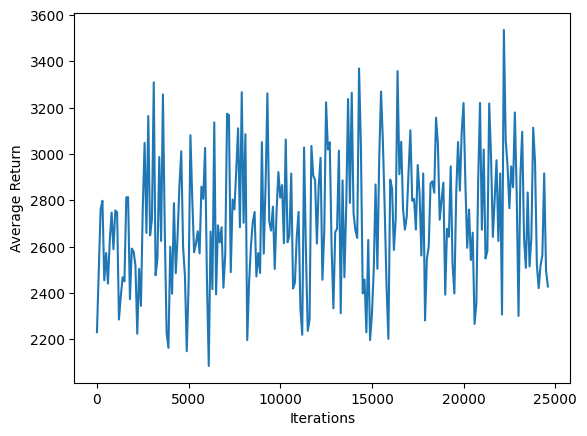

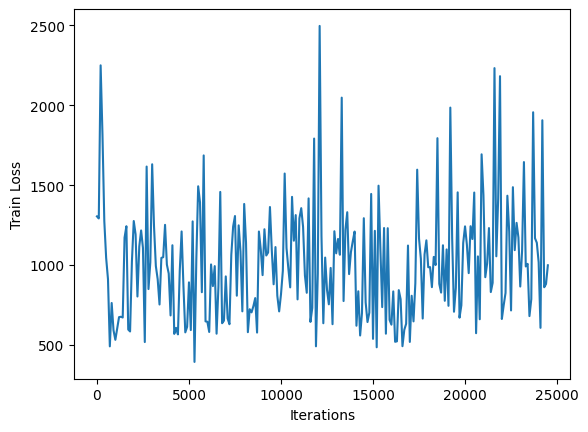

********************ITERATION NUMBER #24600
********************ITERATION NUMBER #24601
********************ITERATION NUMBER #24602
********************ITERATION NUMBER #24603
********************ITERATION NUMBER #24604
********************ITERATION NUMBER #24605
********************ITERATION NUMBER #24606
********************ITERATION NUMBER #24607
********************ITERATION NUMBER #24608
********************ITERATION NUMBER #24609
********************ITERATION NUMBER #24610
********************ITERATION NUMBER #24611
********************ITERATION NUMBER #24612
********************ITERATION NUMBER #24613
********************ITERATION NUMBER #24614
********************ITERATION NUMBER #24615
********************ITERATION NUMBER #24616
********************ITERATION NUMBER #24617
********************ITERATION NUMBER #24618
********************ITERATION NUMBER #24619
********************ITERATION NUMBER #24620
********************ITERATION NUMBER #24621
********************ITERATION NU

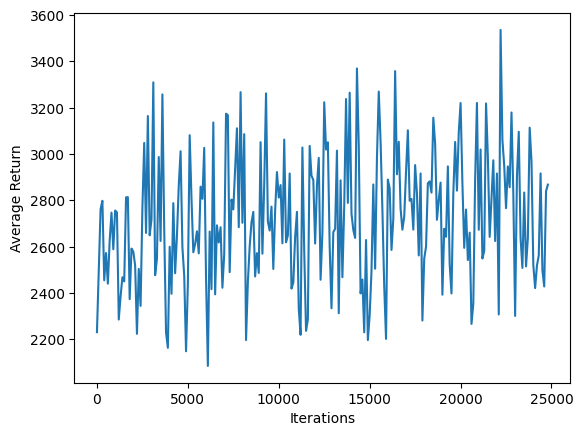

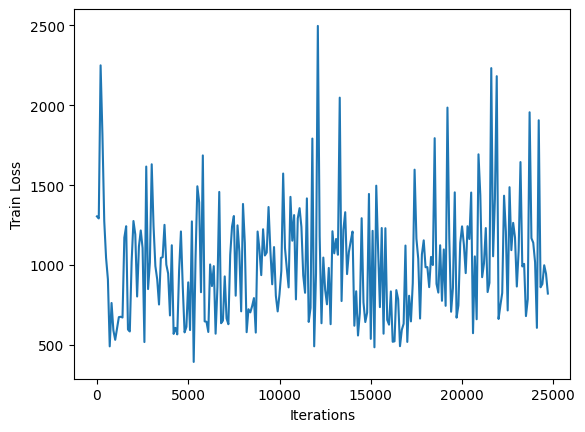

********************ITERATION NUMBER #24800
********************ITERATION NUMBER #24801
********************ITERATION NUMBER #24802
********************ITERATION NUMBER #24803
********************ITERATION NUMBER #24804
********************ITERATION NUMBER #24805
********************ITERATION NUMBER #24806
********************ITERATION NUMBER #24807
********************ITERATION NUMBER #24808
********************ITERATION NUMBER #24809
********************ITERATION NUMBER #24810
********************ITERATION NUMBER #24811
********************ITERATION NUMBER #24812
********************ITERATION NUMBER #24813
********************ITERATION NUMBER #24814
********************ITERATION NUMBER #24815
********************ITERATION NUMBER #24816
********************ITERATION NUMBER #24817
********************ITERATION NUMBER #24818
********************ITERATION NUMBER #24819
********************ITERATION NUMBER #24820
********************ITERATION NUMBER #24821
********************ITERATION NU

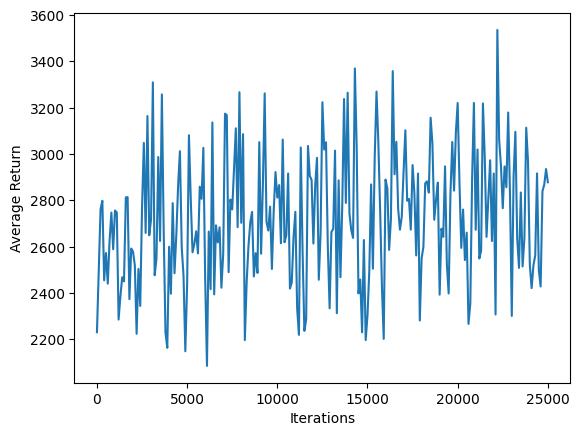

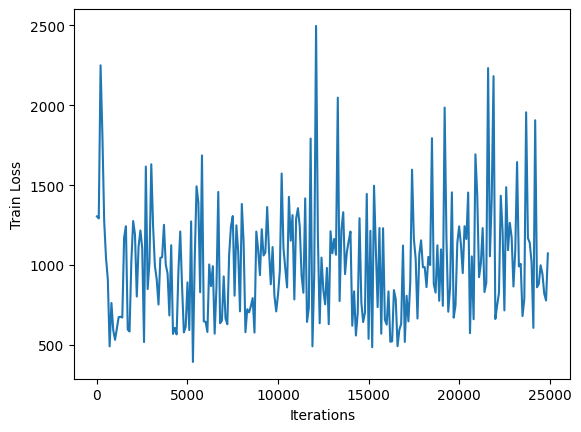

********************ITERATION NUMBER #25000
********************ITERATION NUMBER #25001
********************ITERATION NUMBER #25002
********************ITERATION NUMBER #25003
********************ITERATION NUMBER #25004
********************ITERATION NUMBER #25005
********************ITERATION NUMBER #25006
********************ITERATION NUMBER #25007
********************ITERATION NUMBER #25008
********************ITERATION NUMBER #25009
********************ITERATION NUMBER #25010
********************ITERATION NUMBER #25011
********************ITERATION NUMBER #25012
********************ITERATION NUMBER #25013
********************ITERATION NUMBER #25014
********************ITERATION NUMBER #25015
********************ITERATION NUMBER #25016
********************ITERATION NUMBER #25017
********************ITERATION NUMBER #25018
********************ITERATION NUMBER #25019
********************ITERATION NUMBER #25020
********************ITERATION NUMBER #25021
********************ITERATION NU

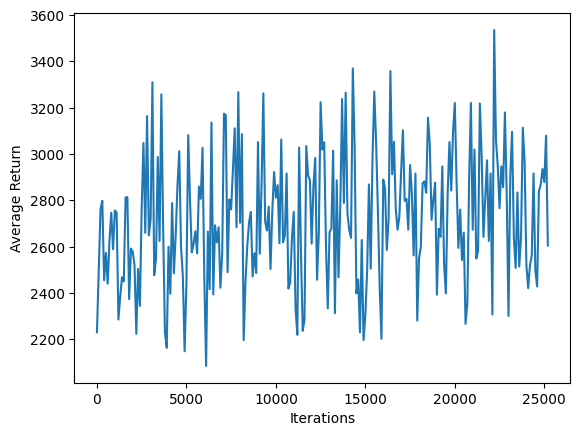

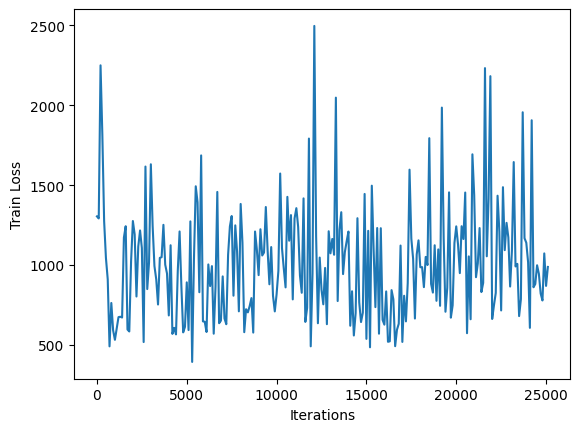

********************ITERATION NUMBER #25200
********************ITERATION NUMBER #25201
********************ITERATION NUMBER #25202
********************ITERATION NUMBER #25203
********************ITERATION NUMBER #25204
********************ITERATION NUMBER #25205
********************ITERATION NUMBER #25206
********************ITERATION NUMBER #25207
********************ITERATION NUMBER #25208
********************ITERATION NUMBER #25209
********************ITERATION NUMBER #25210
********************ITERATION NUMBER #25211
********************ITERATION NUMBER #25212
********************ITERATION NUMBER #25213
********************ITERATION NUMBER #25214
********************ITERATION NUMBER #25215
********************ITERATION NUMBER #25216
********************ITERATION NUMBER #25217
********************ITERATION NUMBER #25218
********************ITERATION NUMBER #25219
********************ITERATION NUMBER #25220
********************ITERATION NUMBER #25221
********************ITERATION NU

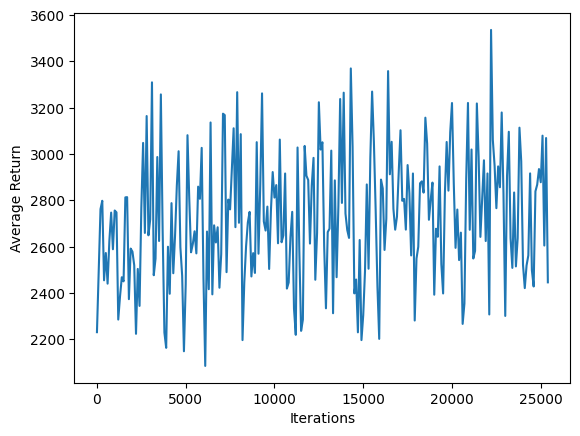

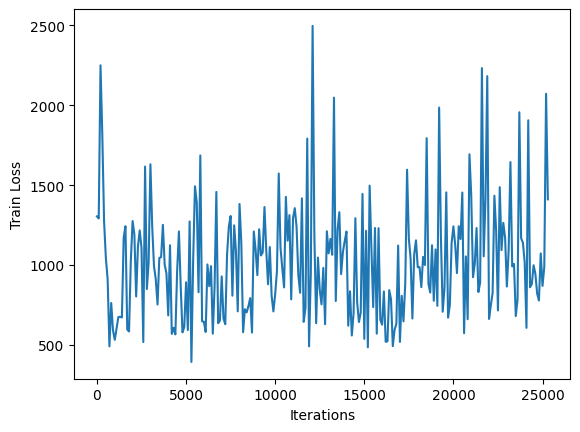

********************ITERATION NUMBER #25400
********************ITERATION NUMBER #25401
********************ITERATION NUMBER #25402
********************ITERATION NUMBER #25403
********************ITERATION NUMBER #25404
********************ITERATION NUMBER #25405
********************ITERATION NUMBER #25406
********************ITERATION NUMBER #25407
********************ITERATION NUMBER #25408
********************ITERATION NUMBER #25409
********************ITERATION NUMBER #25410
********************ITERATION NUMBER #25411
********************ITERATION NUMBER #25412
********************ITERATION NUMBER #25413
********************ITERATION NUMBER #25414
********************ITERATION NUMBER #25415
********************ITERATION NUMBER #25416
********************ITERATION NUMBER #25417
********************ITERATION NUMBER #25418
********************ITERATION NUMBER #25419
********************ITERATION NUMBER #25420
********************ITERATION NUMBER #25421
********************ITERATION NU

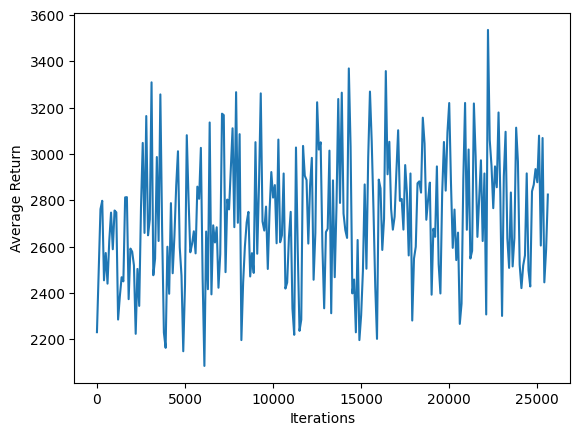

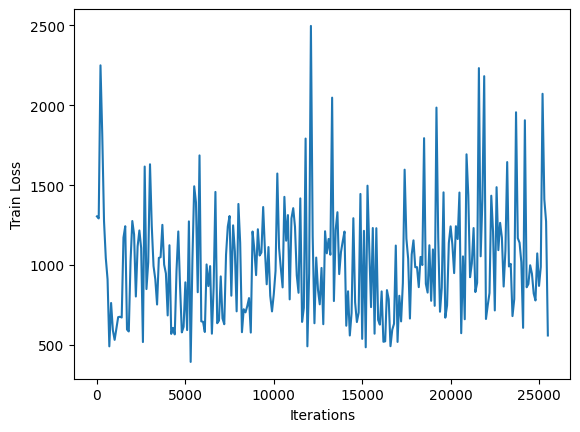

********************ITERATION NUMBER #25600
********************ITERATION NUMBER #25601
********************ITERATION NUMBER #25602
********************ITERATION NUMBER #25603
********************ITERATION NUMBER #25604
********************ITERATION NUMBER #25605
********************ITERATION NUMBER #25606
********************ITERATION NUMBER #25607
********************ITERATION NUMBER #25608
********************ITERATION NUMBER #25609
********************ITERATION NUMBER #25610
********************ITERATION NUMBER #25611
********************ITERATION NUMBER #25612
********************ITERATION NUMBER #25613
********************ITERATION NUMBER #25614
********************ITERATION NUMBER #25615
********************ITERATION NUMBER #25616
********************ITERATION NUMBER #25617
********************ITERATION NUMBER #25618
********************ITERATION NUMBER #25619
********************ITERATION NUMBER #25620
********************ITERATION NUMBER #25621
********************ITERATION NU

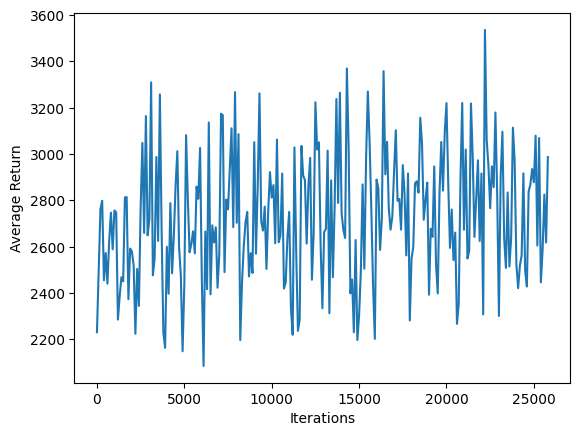

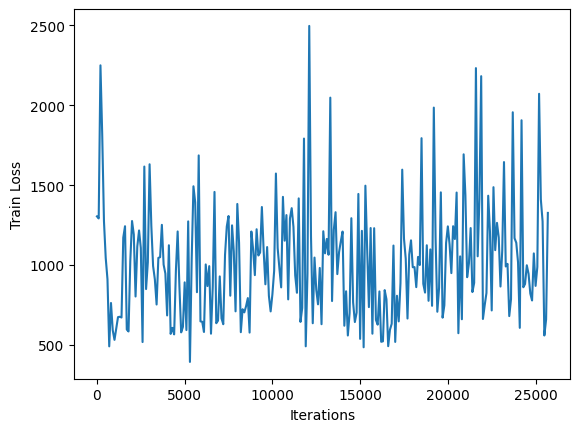

********************ITERATION NUMBER #25800
********************ITERATION NUMBER #25801
********************ITERATION NUMBER #25802
********************ITERATION NUMBER #25803
********************ITERATION NUMBER #25804
********************ITERATION NUMBER #25805
********************ITERATION NUMBER #25806
********************ITERATION NUMBER #25807
********************ITERATION NUMBER #25808
********************ITERATION NUMBER #25809
********************ITERATION NUMBER #25810
********************ITERATION NUMBER #25811
********************ITERATION NUMBER #25812
********************ITERATION NUMBER #25813
********************ITERATION NUMBER #25814
********************ITERATION NUMBER #25815
********************ITERATION NUMBER #25816
********************ITERATION NUMBER #25817
********************ITERATION NUMBER #25818
********************ITERATION NUMBER #25819
********************ITERATION NUMBER #25820
********************ITERATION NUMBER #25821
********************ITERATION NU

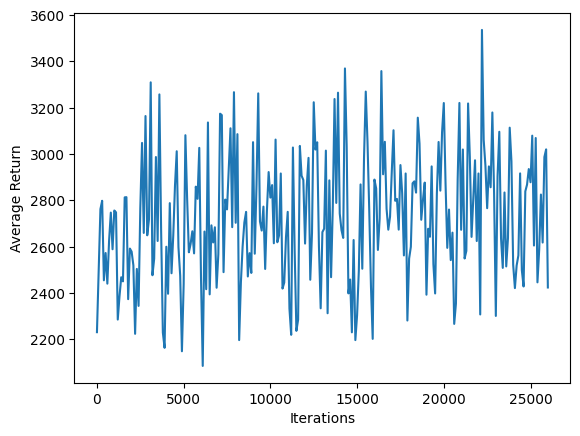

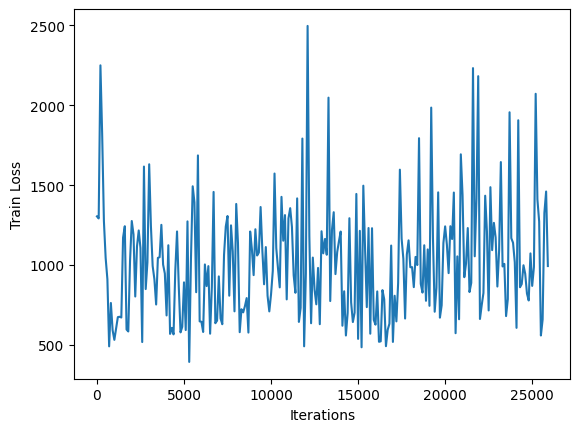

********************ITERATION NUMBER #26000
********************ITERATION NUMBER #26001
********************ITERATION NUMBER #26002
********************ITERATION NUMBER #26003
********************ITERATION NUMBER #26004
********************ITERATION NUMBER #26005
********************ITERATION NUMBER #26006
********************ITERATION NUMBER #26007
********************ITERATION NUMBER #26008
********************ITERATION NUMBER #26009
********************ITERATION NUMBER #26010
********************ITERATION NUMBER #26011
********************ITERATION NUMBER #26012
********************ITERATION NUMBER #26013
********************ITERATION NUMBER #26014
********************ITERATION NUMBER #26015
********************ITERATION NUMBER #26016
********************ITERATION NUMBER #26017
********************ITERATION NUMBER #26018
********************ITERATION NUMBER #26019
********************ITERATION NUMBER #26020
********************ITERATION NUMBER #26021
********************ITERATION NU

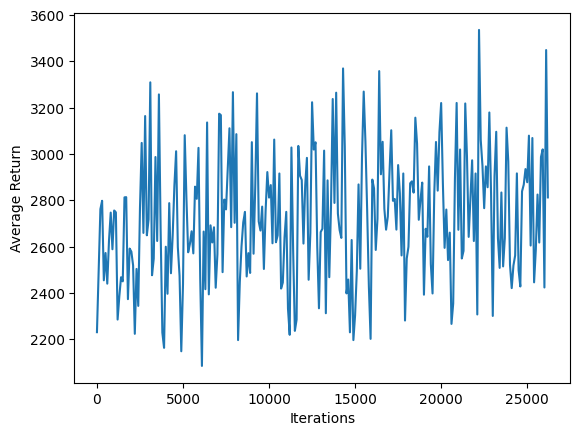

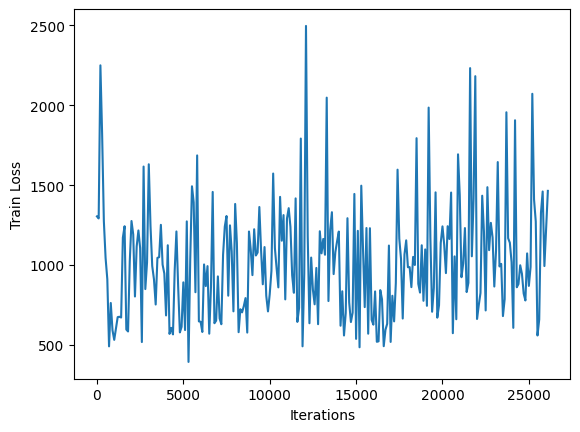

********************ITERATION NUMBER #26200
********************ITERATION NUMBER #26201
********************ITERATION NUMBER #26202
********************ITERATION NUMBER #26203
********************ITERATION NUMBER #26204
********************ITERATION NUMBER #26205
********************ITERATION NUMBER #26206
********************ITERATION NUMBER #26207
********************ITERATION NUMBER #26208
********************ITERATION NUMBER #26209
********************ITERATION NUMBER #26210
********************ITERATION NUMBER #26211
********************ITERATION NUMBER #26212
********************ITERATION NUMBER #26213
********************ITERATION NUMBER #26214
********************ITERATION NUMBER #26215
********************ITERATION NUMBER #26216
********************ITERATION NUMBER #26217
********************ITERATION NUMBER #26218
********************ITERATION NUMBER #26219
********************ITERATION NUMBER #26220
********************ITERATION NUMBER #26221
********************ITERATION NU

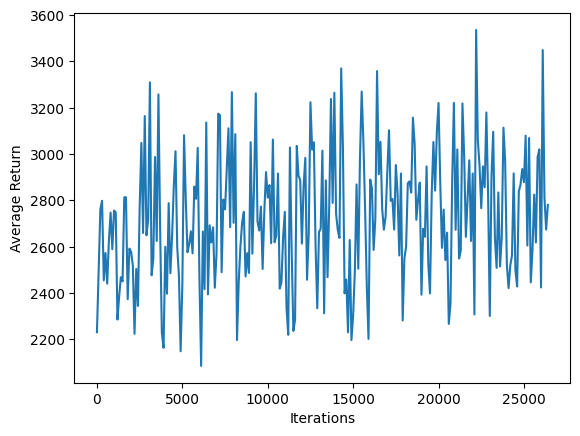

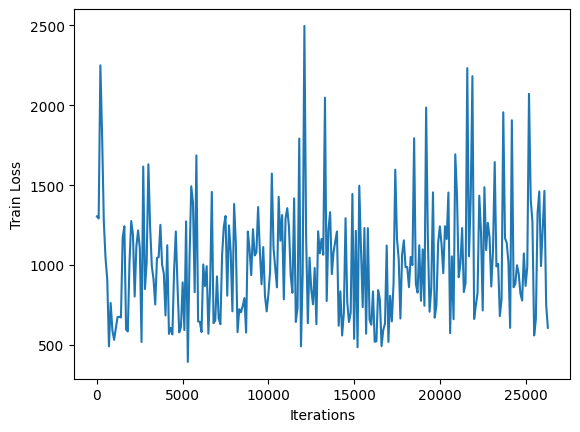

********************ITERATION NUMBER #26400
********************ITERATION NUMBER #26401
********************ITERATION NUMBER #26402
********************ITERATION NUMBER #26403
********************ITERATION NUMBER #26404
********************ITERATION NUMBER #26405
********************ITERATION NUMBER #26406
********************ITERATION NUMBER #26407
********************ITERATION NUMBER #26408
********************ITERATION NUMBER #26409
********************ITERATION NUMBER #26410
********************ITERATION NUMBER #26411
********************ITERATION NUMBER #26412
********************ITERATION NUMBER #26413
********************ITERATION NUMBER #26414
********************ITERATION NUMBER #26415
********************ITERATION NUMBER #26416
********************ITERATION NUMBER #26417
********************ITERATION NUMBER #26418
********************ITERATION NUMBER #26419
********************ITERATION NUMBER #26420
********************ITERATION NUMBER #26421
********************ITERATION NU

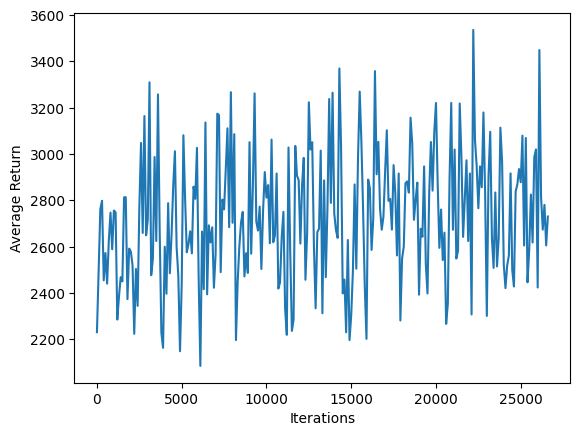

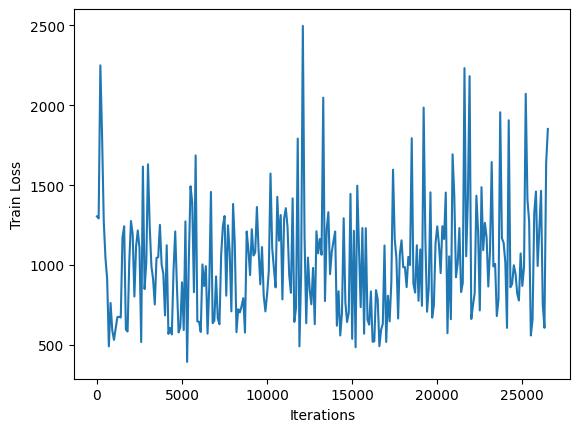

********************ITERATION NUMBER #26600
********************ITERATION NUMBER #26601
********************ITERATION NUMBER #26602
********************ITERATION NUMBER #26603
********************ITERATION NUMBER #26604
********************ITERATION NUMBER #26605
********************ITERATION NUMBER #26606
********************ITERATION NUMBER #26607
********************ITERATION NUMBER #26608
********************ITERATION NUMBER #26609
********************ITERATION NUMBER #26610
********************ITERATION NUMBER #26611
********************ITERATION NUMBER #26612
********************ITERATION NUMBER #26613
********************ITERATION NUMBER #26614
********************ITERATION NUMBER #26615
********************ITERATION NUMBER #26616
********************ITERATION NUMBER #26617
********************ITERATION NUMBER #26618
********************ITERATION NUMBER #26619
********************ITERATION NUMBER #26620
********************ITERATION NUMBER #26621
********************ITERATION NU

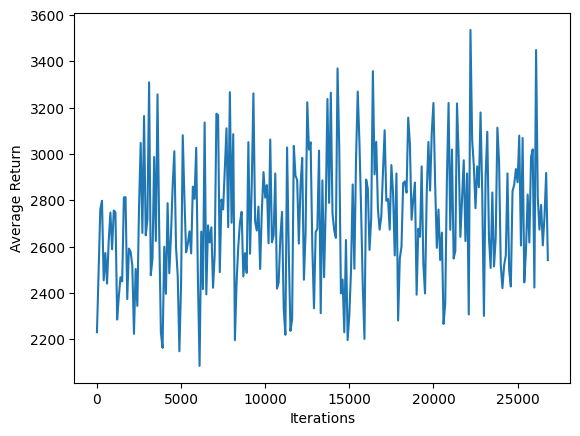

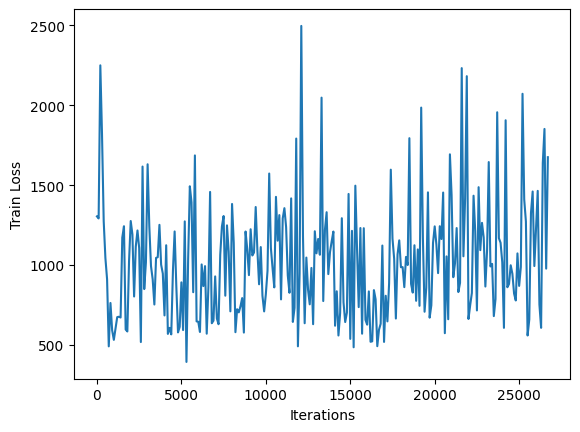

********************ITERATION NUMBER #26800
********************ITERATION NUMBER #26801
********************ITERATION NUMBER #26802
********************ITERATION NUMBER #26803
********************ITERATION NUMBER #26804
********************ITERATION NUMBER #26805
********************ITERATION NUMBER #26806
********************ITERATION NUMBER #26807
********************ITERATION NUMBER #26808
********************ITERATION NUMBER #26809
********************ITERATION NUMBER #26810
********************ITERATION NUMBER #26811
********************ITERATION NUMBER #26812
********************ITERATION NUMBER #26813
********************ITERATION NUMBER #26814
********************ITERATION NUMBER #26815
********************ITERATION NUMBER #26816
********************ITERATION NUMBER #26817
********************ITERATION NUMBER #26818
********************ITERATION NUMBER #26819
********************ITERATION NUMBER #26820
********************ITERATION NUMBER #26821
********************ITERATION NU

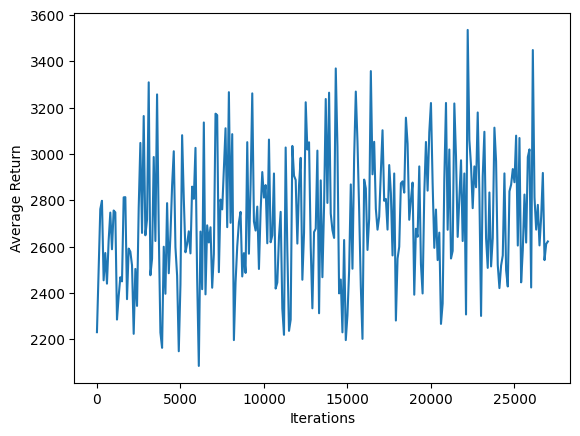

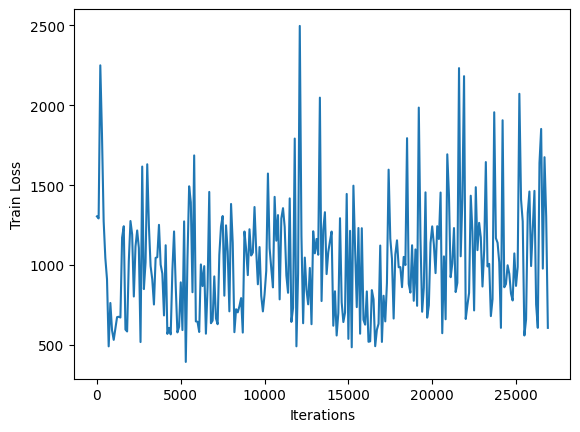

********************ITERATION NUMBER #27000
********************ITERATION NUMBER #27001
********************ITERATION NUMBER #27002
********************ITERATION NUMBER #27003
********************ITERATION NUMBER #27004
********************ITERATION NUMBER #27005
********************ITERATION NUMBER #27006
********************ITERATION NUMBER #27007
********************ITERATION NUMBER #27008
********************ITERATION NUMBER #27009
********************ITERATION NUMBER #27010
********************ITERATION NUMBER #27011
********************ITERATION NUMBER #27012
********************ITERATION NUMBER #27013
********************ITERATION NUMBER #27014
********************ITERATION NUMBER #27015
********************ITERATION NUMBER #27016
********************ITERATION NUMBER #27017
********************ITERATION NUMBER #27018
********************ITERATION NUMBER #27019
********************ITERATION NUMBER #27020
********************ITERATION NUMBER #27021
********************ITERATION NU

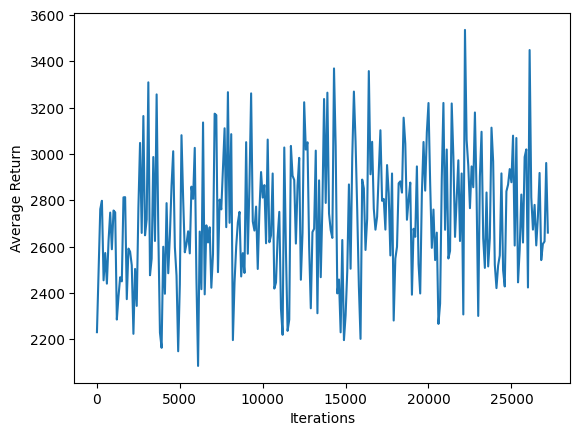

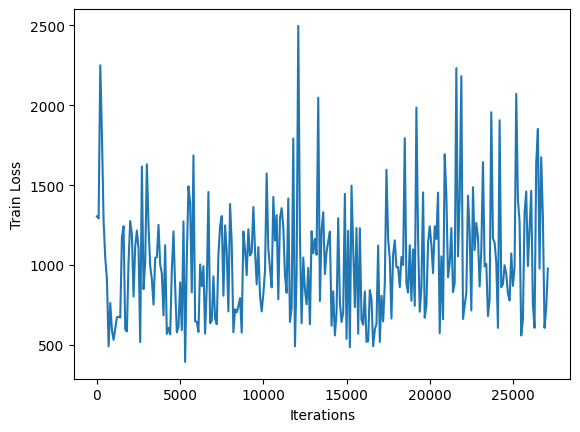

********************ITERATION NUMBER #27200
********************ITERATION NUMBER #27201
********************ITERATION NUMBER #27202
********************ITERATION NUMBER #27203
********************ITERATION NUMBER #27204
********************ITERATION NUMBER #27205
********************ITERATION NUMBER #27206
********************ITERATION NUMBER #27207
********************ITERATION NUMBER #27208
********************ITERATION NUMBER #27209
********************ITERATION NUMBER #27210
********************ITERATION NUMBER #27211
********************ITERATION NUMBER #27212
********************ITERATION NUMBER #27213
********************ITERATION NUMBER #27214
********************ITERATION NUMBER #27215
********************ITERATION NUMBER #27216
********************ITERATION NUMBER #27217
********************ITERATION NUMBER #27218
********************ITERATION NUMBER #27219
********************ITERATION NUMBER #27220
********************ITERATION NUMBER #27221
********************ITERATION NU

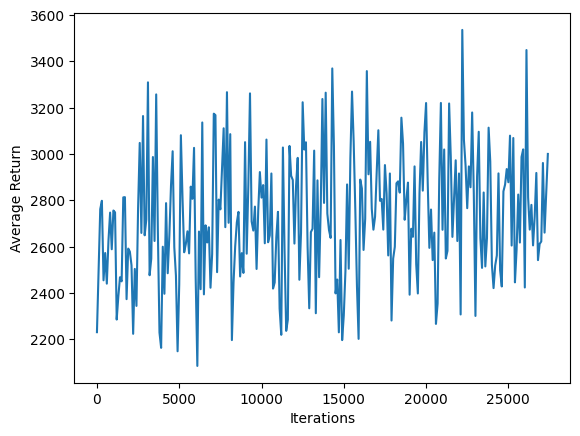

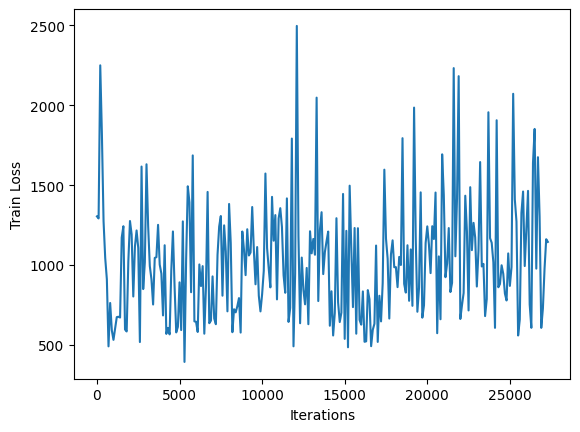

********************ITERATION NUMBER #27400
********************ITERATION NUMBER #27401
********************ITERATION NUMBER #27402
********************ITERATION NUMBER #27403
********************ITERATION NUMBER #27404
********************ITERATION NUMBER #27405
********************ITERATION NUMBER #27406
********************ITERATION NUMBER #27407
********************ITERATION NUMBER #27408
********************ITERATION NUMBER #27409
********************ITERATION NUMBER #27410
********************ITERATION NUMBER #27411
********************ITERATION NUMBER #27412
********************ITERATION NUMBER #27413
********************ITERATION NUMBER #27414
********************ITERATION NUMBER #27415
********************ITERATION NUMBER #27416
********************ITERATION NUMBER #27417
********************ITERATION NUMBER #27418
********************ITERATION NUMBER #27419
********************ITERATION NUMBER #27420
********************ITERATION NUMBER #27421
********************ITERATION NU

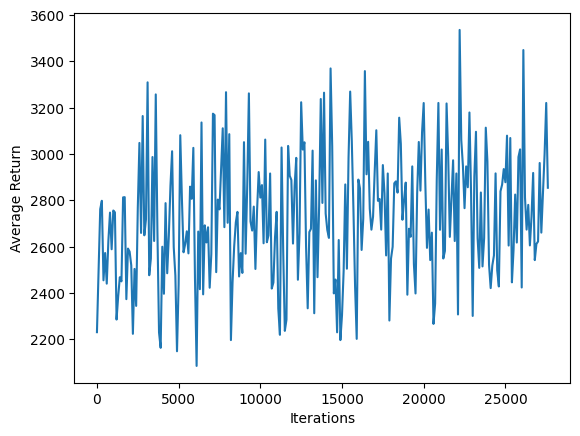

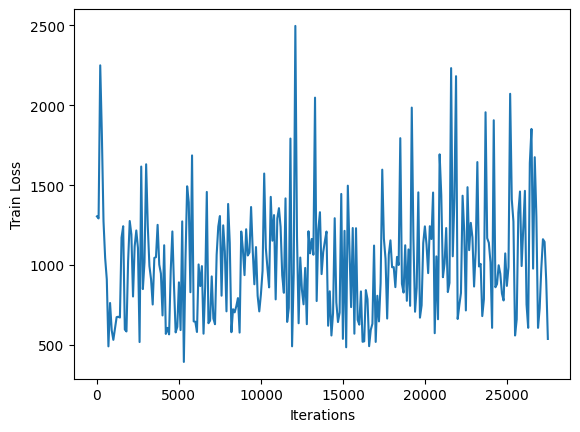

********************ITERATION NUMBER #27600
********************ITERATION NUMBER #27601
********************ITERATION NUMBER #27602
********************ITERATION NUMBER #27603
********************ITERATION NUMBER #27604
********************ITERATION NUMBER #27605
********************ITERATION NUMBER #27606
********************ITERATION NUMBER #27607
********************ITERATION NUMBER #27608
********************ITERATION NUMBER #27609
********************ITERATION NUMBER #27610
********************ITERATION NUMBER #27611
********************ITERATION NUMBER #27612
********************ITERATION NUMBER #27613
********************ITERATION NUMBER #27614
********************ITERATION NUMBER #27615
********************ITERATION NUMBER #27616
********************ITERATION NUMBER #27617
********************ITERATION NUMBER #27618
********************ITERATION NUMBER #27619
********************ITERATION NUMBER #27620
********************ITERATION NUMBER #27621
********************ITERATION NU

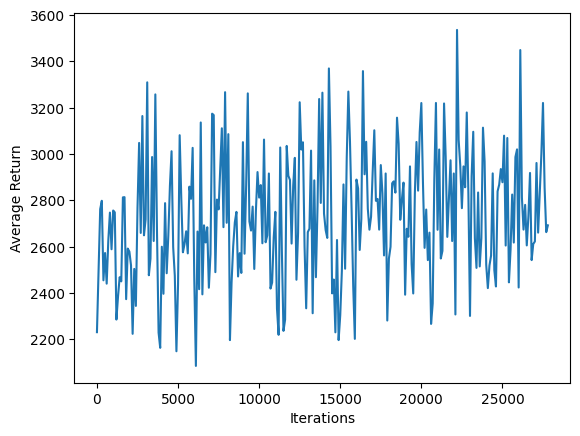

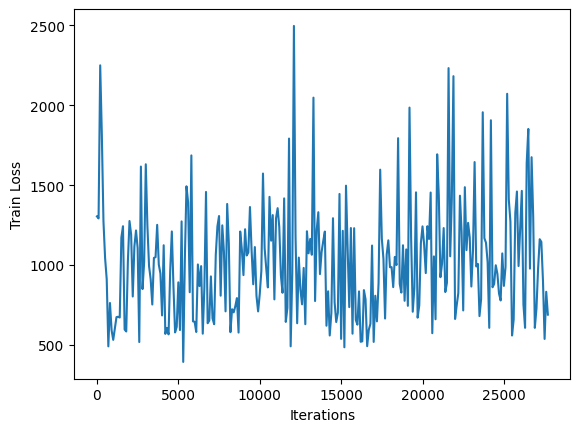

********************ITERATION NUMBER #27800
********************ITERATION NUMBER #27801
********************ITERATION NUMBER #27802
********************ITERATION NUMBER #27803
********************ITERATION NUMBER #27804
********************ITERATION NUMBER #27805
********************ITERATION NUMBER #27806
********************ITERATION NUMBER #27807
********************ITERATION NUMBER #27808
********************ITERATION NUMBER #27809
********************ITERATION NUMBER #27810
********************ITERATION NUMBER #27811
********************ITERATION NUMBER #27812
********************ITERATION NUMBER #27813
********************ITERATION NUMBER #27814
********************ITERATION NUMBER #27815
********************ITERATION NUMBER #27816
********************ITERATION NUMBER #27817
********************ITERATION NUMBER #27818
********************ITERATION NUMBER #27819
********************ITERATION NUMBER #27820
********************ITERATION NUMBER #27821
********************ITERATION NU

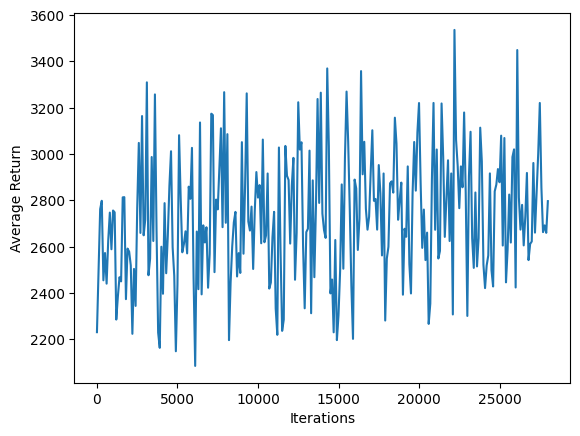

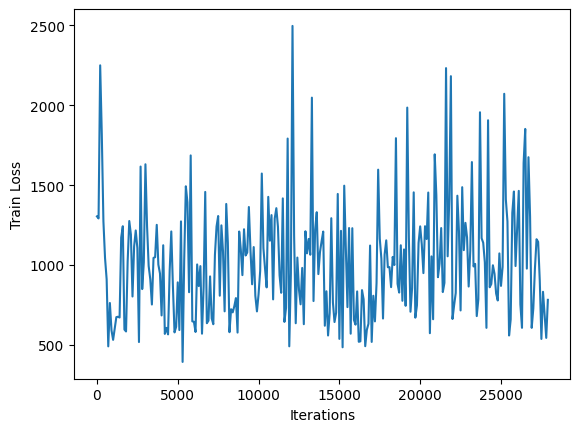

********************ITERATION NUMBER #28000
********************ITERATION NUMBER #28001
********************ITERATION NUMBER #28002
********************ITERATION NUMBER #28003
********************ITERATION NUMBER #28004
********************ITERATION NUMBER #28005
********************ITERATION NUMBER #28006
********************ITERATION NUMBER #28007
********************ITERATION NUMBER #28008
********************ITERATION NUMBER #28009
********************ITERATION NUMBER #28010
********************ITERATION NUMBER #28011
********************ITERATION NUMBER #28012
********************ITERATION NUMBER #28013
********************ITERATION NUMBER #28014
********************ITERATION NUMBER #28015
********************ITERATION NUMBER #28016
********************ITERATION NUMBER #28017
********************ITERATION NUMBER #28018
********************ITERATION NUMBER #28019
********************ITERATION NUMBER #28020
********************ITERATION NUMBER #28021
********************ITERATION NU

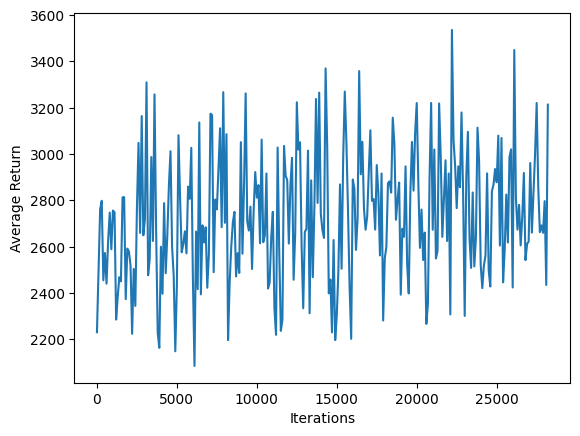

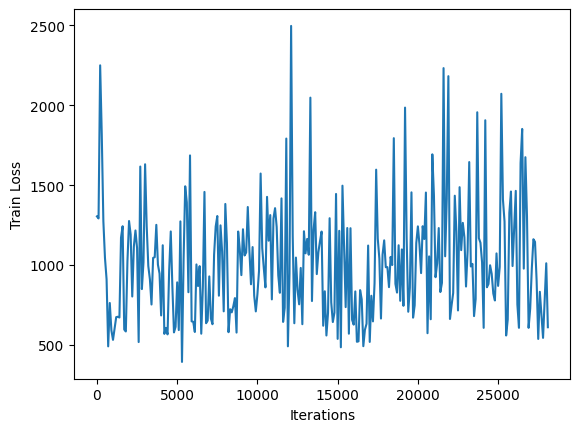

********************ITERATION NUMBER #28200
********************ITERATION NUMBER #28201
********************ITERATION NUMBER #28202
********************ITERATION NUMBER #28203
********************ITERATION NUMBER #28204
********************ITERATION NUMBER #28205
********************ITERATION NUMBER #28206
********************ITERATION NUMBER #28207
********************ITERATION NUMBER #28208
********************ITERATION NUMBER #28209
********************ITERATION NUMBER #28210
********************ITERATION NUMBER #28211
********************ITERATION NUMBER #28212
********************ITERATION NUMBER #28213
********************ITERATION NUMBER #28214
********************ITERATION NUMBER #28215
********************ITERATION NUMBER #28216
********************ITERATION NUMBER #28217
********************ITERATION NUMBER #28218
********************ITERATION NUMBER #28219
********************ITERATION NUMBER #28220
********************ITERATION NUMBER #28221
********************ITERATION NU

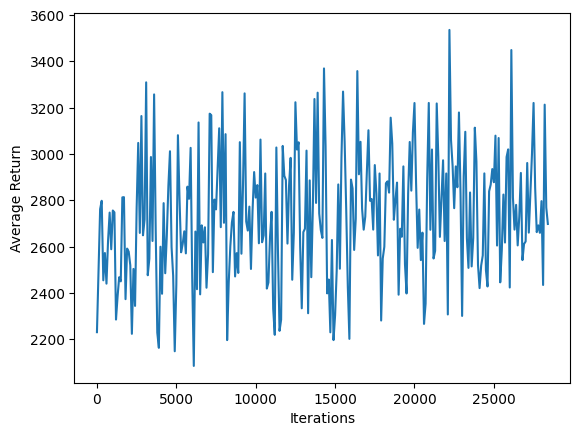

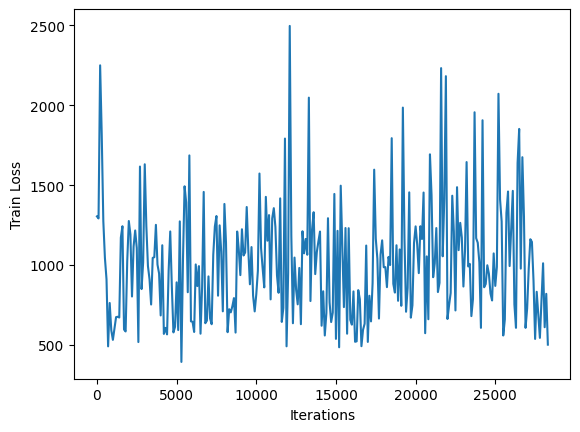

********************ITERATION NUMBER #28400
********************ITERATION NUMBER #28401
********************ITERATION NUMBER #28402
********************ITERATION NUMBER #28403
********************ITERATION NUMBER #28404
********************ITERATION NUMBER #28405
********************ITERATION NUMBER #28406
********************ITERATION NUMBER #28407
********************ITERATION NUMBER #28408
********************ITERATION NUMBER #28409
********************ITERATION NUMBER #28410
********************ITERATION NUMBER #28411
********************ITERATION NUMBER #28412
********************ITERATION NUMBER #28413
********************ITERATION NUMBER #28414
********************ITERATION NUMBER #28415
********************ITERATION NUMBER #28416
********************ITERATION NUMBER #28417
********************ITERATION NUMBER #28418
********************ITERATION NUMBER #28419
********************ITERATION NUMBER #28420
********************ITERATION NUMBER #28421
********************ITERATION NU

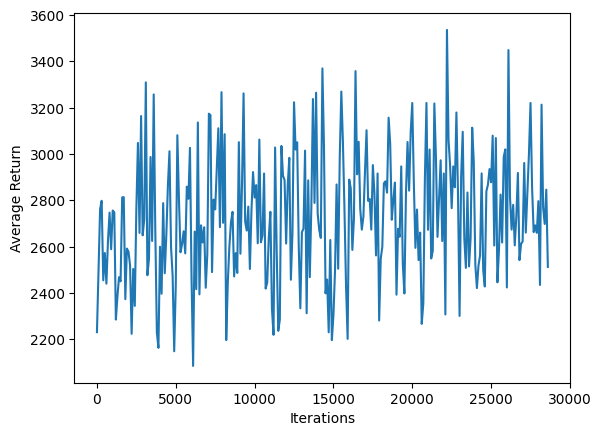

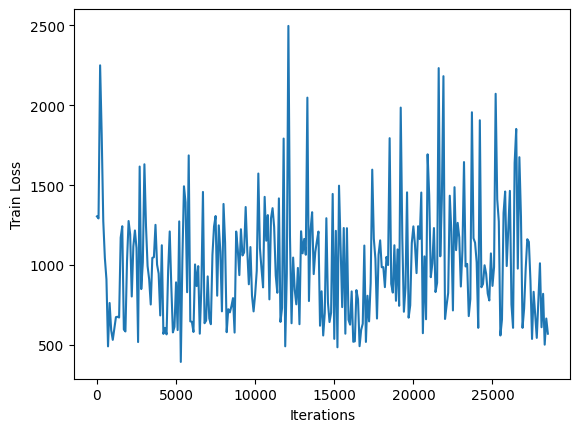

********************ITERATION NUMBER #28600
********************ITERATION NUMBER #28601
********************ITERATION NUMBER #28602
********************ITERATION NUMBER #28603
********************ITERATION NUMBER #28604
********************ITERATION NUMBER #28605
********************ITERATION NUMBER #28606
********************ITERATION NUMBER #28607
********************ITERATION NUMBER #28608
********************ITERATION NUMBER #28609
********************ITERATION NUMBER #28610
********************ITERATION NUMBER #28611
********************ITERATION NUMBER #28612
********************ITERATION NUMBER #28613
********************ITERATION NUMBER #28614
********************ITERATION NUMBER #28615
********************ITERATION NUMBER #28616
********************ITERATION NUMBER #28617
********************ITERATION NUMBER #28618
********************ITERATION NUMBER #28619
********************ITERATION NUMBER #28620
********************ITERATION NUMBER #28621
********************ITERATION NU

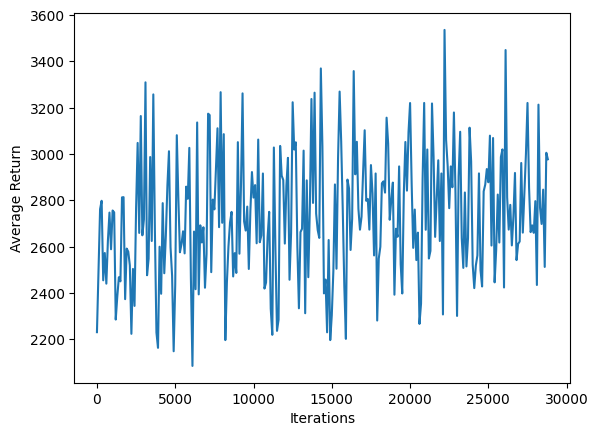

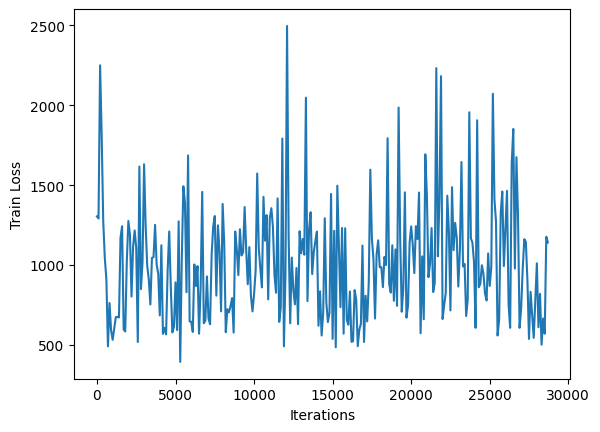

********************ITERATION NUMBER #28800
********************ITERATION NUMBER #28801
********************ITERATION NUMBER #28802
********************ITERATION NUMBER #28803
********************ITERATION NUMBER #28804
********************ITERATION NUMBER #28805
********************ITERATION NUMBER #28806
********************ITERATION NUMBER #28807
********************ITERATION NUMBER #28808
********************ITERATION NUMBER #28809
********************ITERATION NUMBER #28810
********************ITERATION NUMBER #28811
********************ITERATION NUMBER #28812
********************ITERATION NUMBER #28813
********************ITERATION NUMBER #28814
********************ITERATION NUMBER #28815
********************ITERATION NUMBER #28816
********************ITERATION NUMBER #28817
********************ITERATION NUMBER #28818
********************ITERATION NUMBER #28819
********************ITERATION NUMBER #28820
********************ITERATION NUMBER #28821
********************ITERATION NU

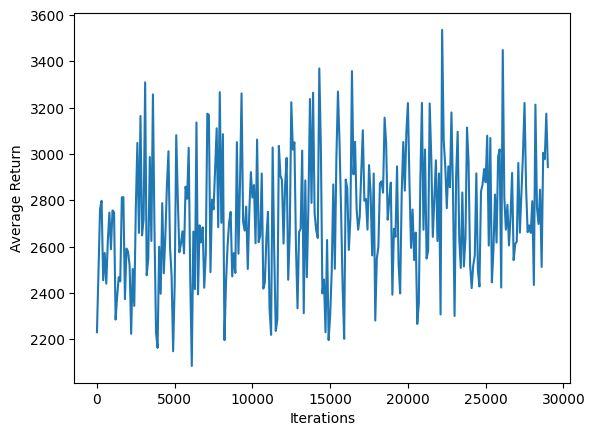

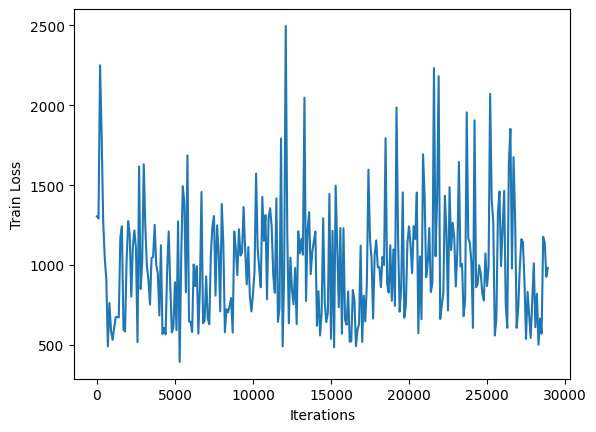

********************ITERATION NUMBER #29000
********************ITERATION NUMBER #29001
********************ITERATION NUMBER #29002
********************ITERATION NUMBER #29003
********************ITERATION NUMBER #29004
********************ITERATION NUMBER #29005
********************ITERATION NUMBER #29006
********************ITERATION NUMBER #29007
********************ITERATION NUMBER #29008
********************ITERATION NUMBER #29009
********************ITERATION NUMBER #29010
********************ITERATION NUMBER #29011
********************ITERATION NUMBER #29012
********************ITERATION NUMBER #29013
********************ITERATION NUMBER #29014
********************ITERATION NUMBER #29015
********************ITERATION NUMBER #29016
********************ITERATION NUMBER #29017
********************ITERATION NUMBER #29018
********************ITERATION NUMBER #29019
********************ITERATION NUMBER #29020
********************ITERATION NUMBER #29021
********************ITERATION NU

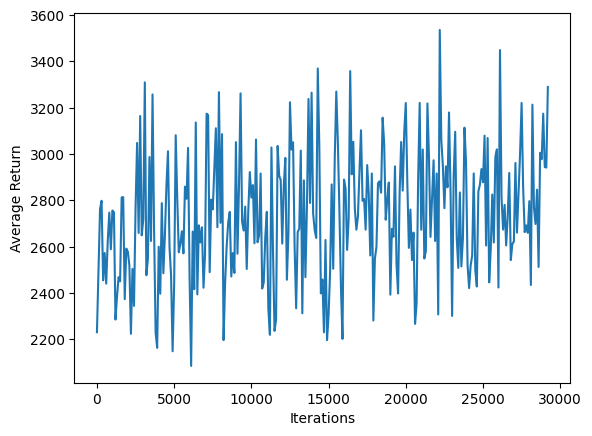

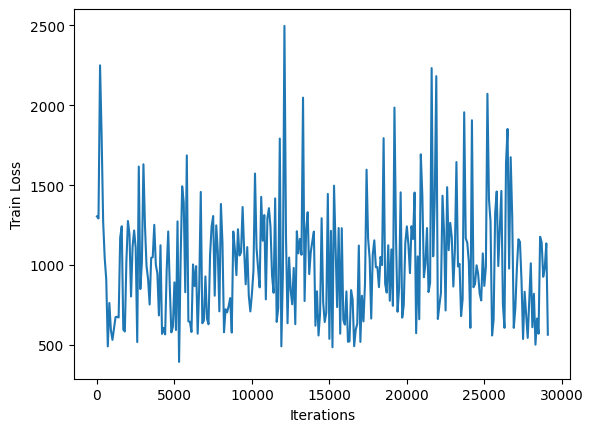

********************ITERATION NUMBER #29200
********************ITERATION NUMBER #29201
********************ITERATION NUMBER #29202
********************ITERATION NUMBER #29203
********************ITERATION NUMBER #29204
********************ITERATION NUMBER #29205
********************ITERATION NUMBER #29206
********************ITERATION NUMBER #29207
********************ITERATION NUMBER #29208
********************ITERATION NUMBER #29209
********************ITERATION NUMBER #29210
********************ITERATION NUMBER #29211
********************ITERATION NUMBER #29212
********************ITERATION NUMBER #29213
********************ITERATION NUMBER #29214
********************ITERATION NUMBER #29215
********************ITERATION NUMBER #29216
********************ITERATION NUMBER #29217
********************ITERATION NUMBER #29218
********************ITERATION NUMBER #29219
********************ITERATION NUMBER #29220
********************ITERATION NUMBER #29221
********************ITERATION NU

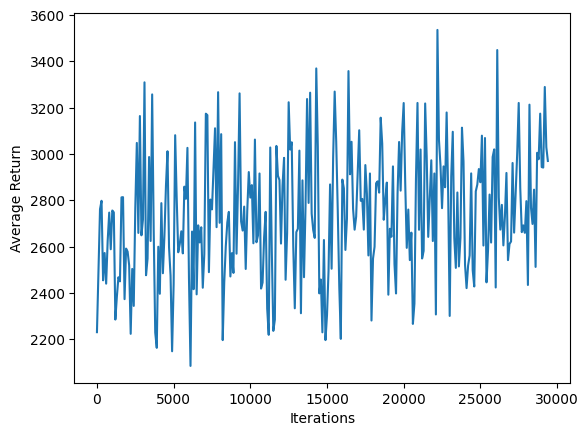

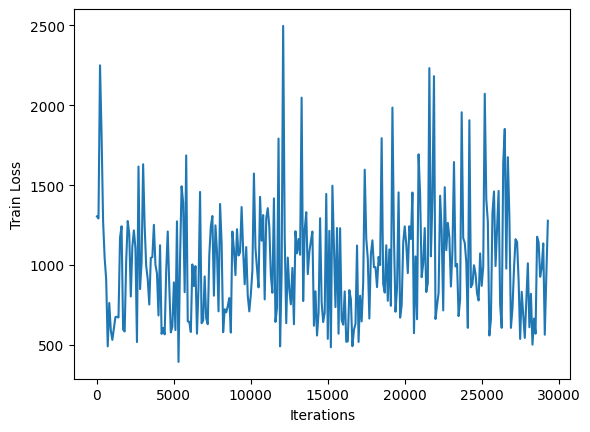

********************ITERATION NUMBER #29400
********************ITERATION NUMBER #29401
********************ITERATION NUMBER #29402
********************ITERATION NUMBER #29403
********************ITERATION NUMBER #29404
********************ITERATION NUMBER #29405
********************ITERATION NUMBER #29406
********************ITERATION NUMBER #29407
********************ITERATION NUMBER #29408
********************ITERATION NUMBER #29409
********************ITERATION NUMBER #29410
********************ITERATION NUMBER #29411
********************ITERATION NUMBER #29412
********************ITERATION NUMBER #29413
********************ITERATION NUMBER #29414
********************ITERATION NUMBER #29415
********************ITERATION NUMBER #29416
********************ITERATION NUMBER #29417
********************ITERATION NUMBER #29418
********************ITERATION NUMBER #29419
********************ITERATION NUMBER #29420
********************ITERATION NUMBER #29421
********************ITERATION NU

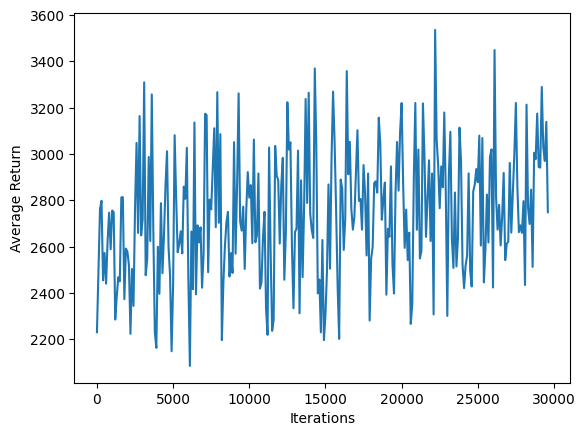

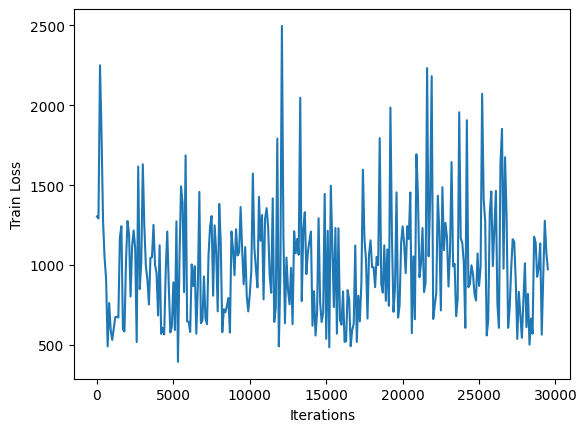

********************ITERATION NUMBER #29600
********************ITERATION NUMBER #29601
********************ITERATION NUMBER #29602
********************ITERATION NUMBER #29603
********************ITERATION NUMBER #29604
********************ITERATION NUMBER #29605
********************ITERATION NUMBER #29606
********************ITERATION NUMBER #29607
********************ITERATION NUMBER #29608
********************ITERATION NUMBER #29609
********************ITERATION NUMBER #29610
********************ITERATION NUMBER #29611
********************ITERATION NUMBER #29612
********************ITERATION NUMBER #29613
********************ITERATION NUMBER #29614
********************ITERATION NUMBER #29615
********************ITERATION NUMBER #29616
********************ITERATION NUMBER #29617
********************ITERATION NUMBER #29618
********************ITERATION NUMBER #29619
********************ITERATION NUMBER #29620
********************ITERATION NUMBER #29621
********************ITERATION NU

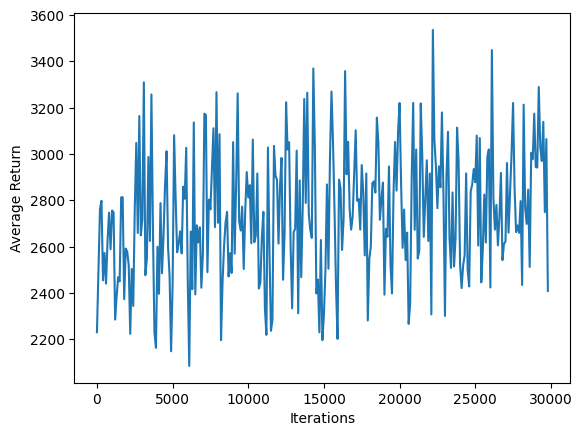

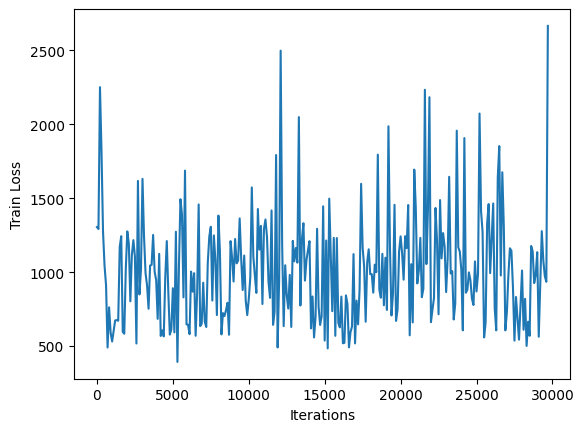

********************ITERATION NUMBER #29800
********************ITERATION NUMBER #29801
********************ITERATION NUMBER #29802
********************ITERATION NUMBER #29803
********************ITERATION NUMBER #29804
********************ITERATION NUMBER #29805
********************ITERATION NUMBER #29806
********************ITERATION NUMBER #29807
********************ITERATION NUMBER #29808
********************ITERATION NUMBER #29809
********************ITERATION NUMBER #29810
********************ITERATION NUMBER #29811
********************ITERATION NUMBER #29812
********************ITERATION NUMBER #29813
********************ITERATION NUMBER #29814
********************ITERATION NUMBER #29815
********************ITERATION NUMBER #29816
********************ITERATION NUMBER #29817
********************ITERATION NUMBER #29818
********************ITERATION NUMBER #29819
********************ITERATION NUMBER #29820
********************ITERATION NUMBER #29821
********************ITERATION NU

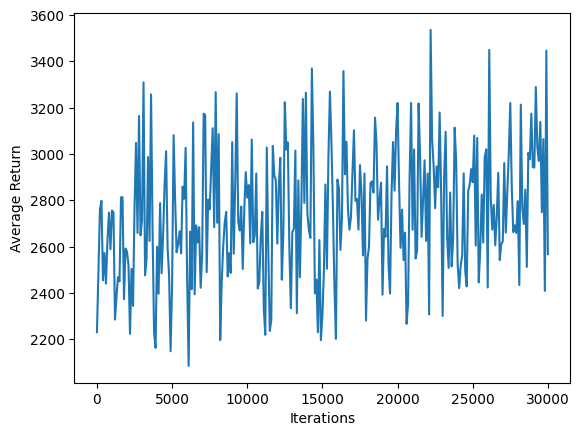

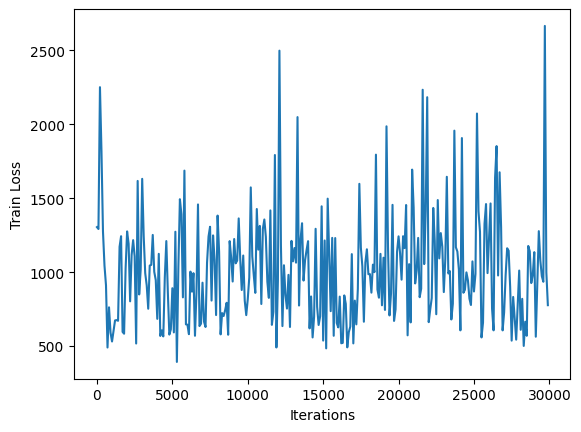

********************ITERATION NUMBER #30000
********************ITERATION NUMBER #30001
********************ITERATION NUMBER #30002
********************ITERATION NUMBER #30003
********************ITERATION NUMBER #30004
********************ITERATION NUMBER #30005
********************ITERATION NUMBER #30006
********************ITERATION NUMBER #30007
********************ITERATION NUMBER #30008
********************ITERATION NUMBER #30009
********************ITERATION NUMBER #30010
********************ITERATION NUMBER #30011
********************ITERATION NUMBER #30012
********************ITERATION NUMBER #30013
********************ITERATION NUMBER #30014
********************ITERATION NUMBER #30015
********************ITERATION NUMBER #30016
********************ITERATION NUMBER #30017
********************ITERATION NUMBER #30018
********************ITERATION NUMBER #30019
********************ITERATION NUMBER #30020
********************ITERATION NUMBER #30021
********************ITERATION NU

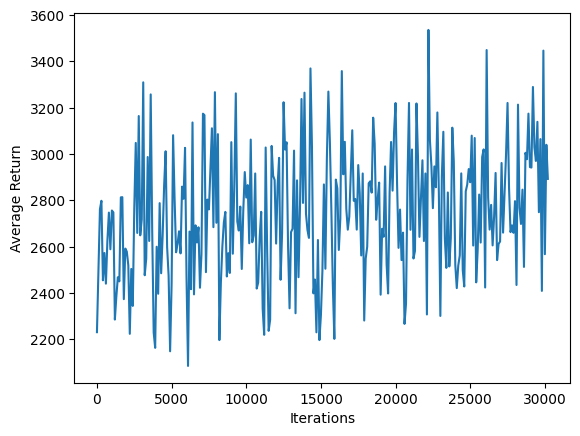

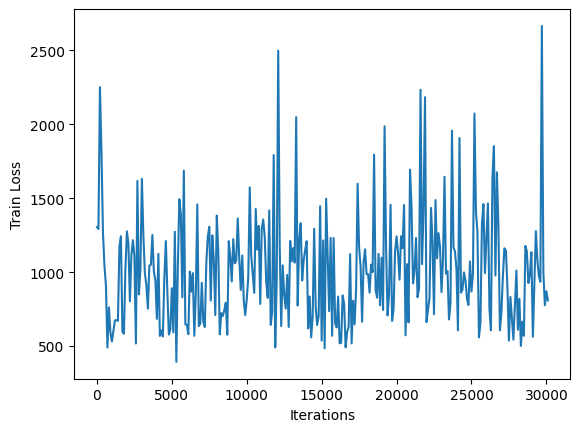

********************ITERATION NUMBER #30200
********************ITERATION NUMBER #30201
********************ITERATION NUMBER #30202
********************ITERATION NUMBER #30203
********************ITERATION NUMBER #30204
********************ITERATION NUMBER #30205
********************ITERATION NUMBER #30206
********************ITERATION NUMBER #30207
********************ITERATION NUMBER #30208
********************ITERATION NUMBER #30209
********************ITERATION NUMBER #30210
********************ITERATION NUMBER #30211
********************ITERATION NUMBER #30212
********************ITERATION NUMBER #30213
********************ITERATION NUMBER #30214
********************ITERATION NUMBER #30215
********************ITERATION NUMBER #30216
********************ITERATION NUMBER #30217
********************ITERATION NUMBER #30218
********************ITERATION NUMBER #30219
********************ITERATION NUMBER #30220
********************ITERATION NUMBER #30221
********************ITERATION NU

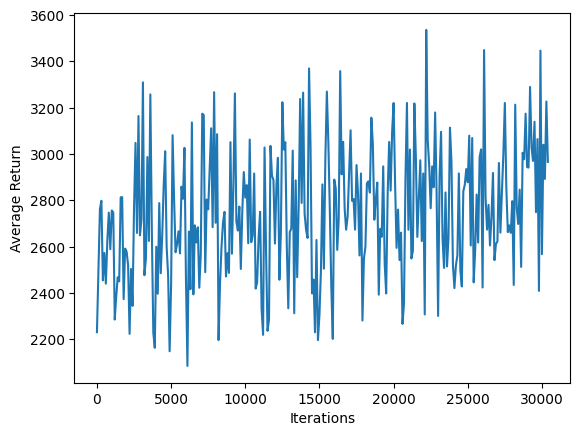

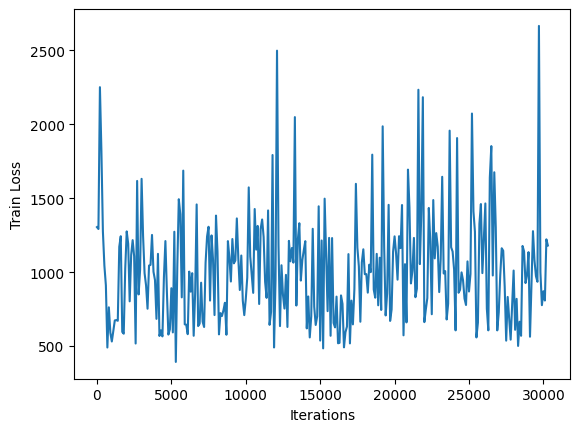

********************ITERATION NUMBER #30400
********************ITERATION NUMBER #30401
********************ITERATION NUMBER #30402
********************ITERATION NUMBER #30403
********************ITERATION NUMBER #30404
********************ITERATION NUMBER #30405
********************ITERATION NUMBER #30406
********************ITERATION NUMBER #30407
********************ITERATION NUMBER #30408
********************ITERATION NUMBER #30409
********************ITERATION NUMBER #30410
********************ITERATION NUMBER #30411
********************ITERATION NUMBER #30412
********************ITERATION NUMBER #30413
********************ITERATION NUMBER #30414
********************ITERATION NUMBER #30415
********************ITERATION NUMBER #30416
********************ITERATION NUMBER #30417
********************ITERATION NUMBER #30418
********************ITERATION NUMBER #30419
********************ITERATION NUMBER #30420
********************ITERATION NUMBER #30421
********************ITERATION NU

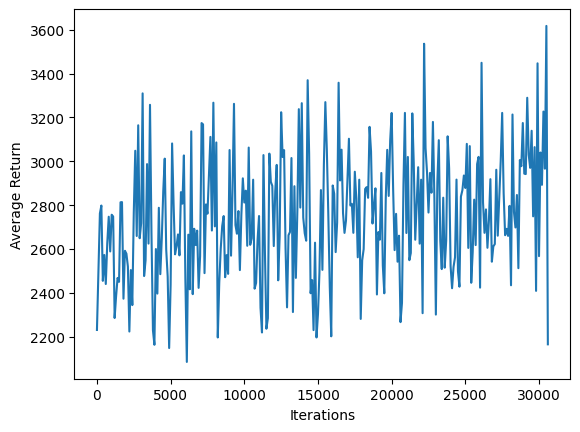

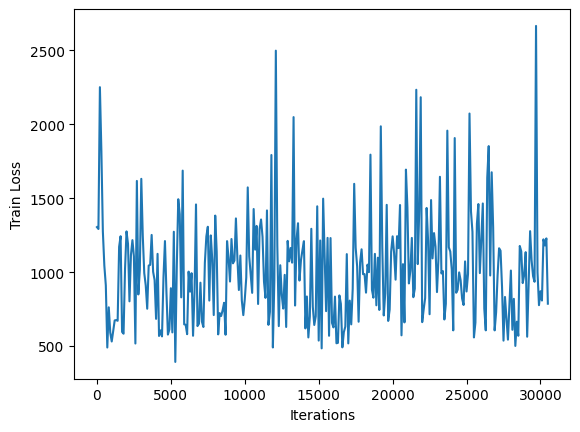

********************ITERATION NUMBER #30600
********************ITERATION NUMBER #30601
********************ITERATION NUMBER #30602
********************ITERATION NUMBER #30603
********************ITERATION NUMBER #30604
********************ITERATION NUMBER #30605
********************ITERATION NUMBER #30606
********************ITERATION NUMBER #30607
********************ITERATION NUMBER #30608
********************ITERATION NUMBER #30609
********************ITERATION NUMBER #30610
********************ITERATION NUMBER #30611
********************ITERATION NUMBER #30612
********************ITERATION NUMBER #30613
********************ITERATION NUMBER #30614
********************ITERATION NUMBER #30615
********************ITERATION NUMBER #30616
********************ITERATION NUMBER #30617
********************ITERATION NUMBER #30618
********************ITERATION NUMBER #30619
********************ITERATION NUMBER #30620
********************ITERATION NUMBER #30621
********************ITERATION NU

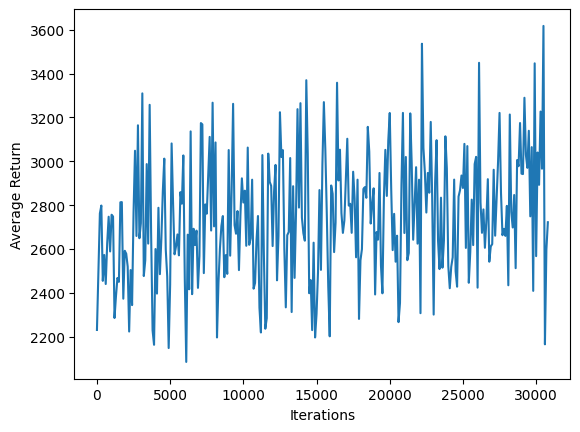

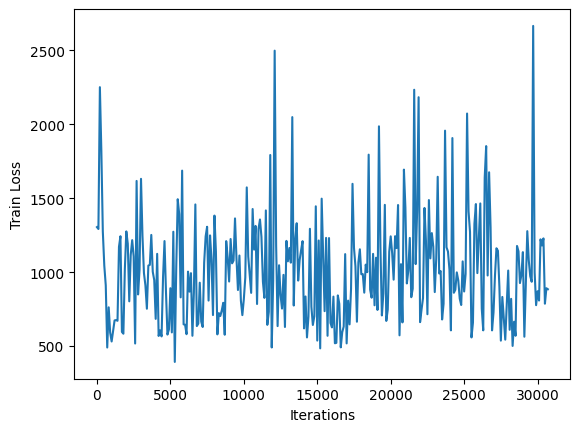

********************ITERATION NUMBER #30800
********************ITERATION NUMBER #30801
********************ITERATION NUMBER #30802
********************ITERATION NUMBER #30803
********************ITERATION NUMBER #30804
********************ITERATION NUMBER #30805
********************ITERATION NUMBER #30806
********************ITERATION NUMBER #30807
********************ITERATION NUMBER #30808
********************ITERATION NUMBER #30809
********************ITERATION NUMBER #30810
********************ITERATION NUMBER #30811
********************ITERATION NUMBER #30812
********************ITERATION NUMBER #30813
********************ITERATION NUMBER #30814
********************ITERATION NUMBER #30815
********************ITERATION NUMBER #30816
********************ITERATION NUMBER #30817
********************ITERATION NUMBER #30818
********************ITERATION NUMBER #30819
********************ITERATION NUMBER #30820
********************ITERATION NUMBER #30821
********************ITERATION NU

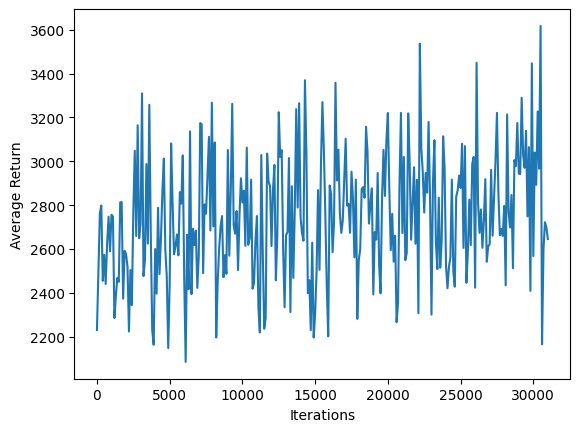

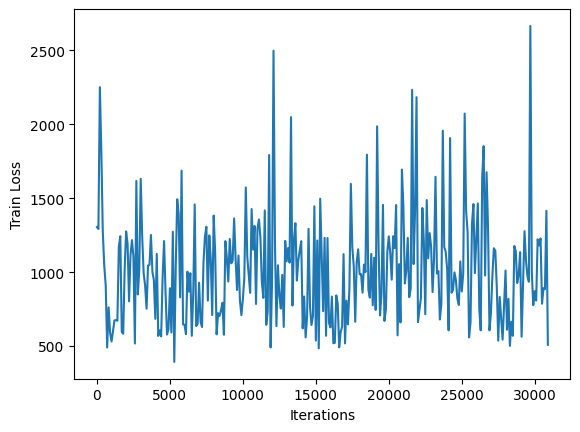

********************ITERATION NUMBER #31000
********************ITERATION NUMBER #31001
********************ITERATION NUMBER #31002
********************ITERATION NUMBER #31003
********************ITERATION NUMBER #31004
********************ITERATION NUMBER #31005
********************ITERATION NUMBER #31006
********************ITERATION NUMBER #31007
********************ITERATION NUMBER #31008
********************ITERATION NUMBER #31009
********************ITERATION NUMBER #31010
********************ITERATION NUMBER #31011
********************ITERATION NUMBER #31012
********************ITERATION NUMBER #31013
********************ITERATION NUMBER #31014
********************ITERATION NUMBER #31015
********************ITERATION NUMBER #31016
********************ITERATION NUMBER #31017
********************ITERATION NUMBER #31018
********************ITERATION NUMBER #31019
********************ITERATION NUMBER #31020
********************ITERATION NUMBER #31021
********************ITERATION NU

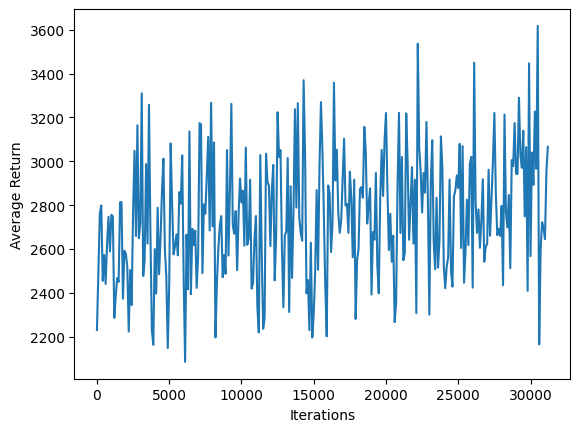

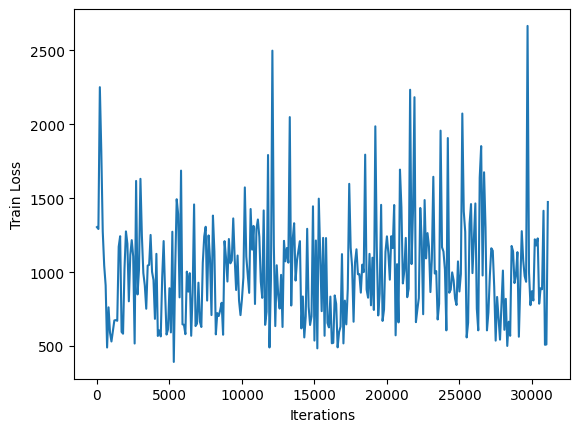

********************ITERATION NUMBER #31200
********************ITERATION NUMBER #31201
********************ITERATION NUMBER #31202
********************ITERATION NUMBER #31203
********************ITERATION NUMBER #31204
********************ITERATION NUMBER #31205
********************ITERATION NUMBER #31206
********************ITERATION NUMBER #31207
********************ITERATION NUMBER #31208
********************ITERATION NUMBER #31209
********************ITERATION NUMBER #31210
********************ITERATION NUMBER #31211
********************ITERATION NUMBER #31212
********************ITERATION NUMBER #31213
********************ITERATION NUMBER #31214
********************ITERATION NUMBER #31215
********************ITERATION NUMBER #31216
********************ITERATION NUMBER #31217
********************ITERATION NUMBER #31218
********************ITERATION NUMBER #31219
********************ITERATION NUMBER #31220
********************ITERATION NUMBER #31221
********************ITERATION NU

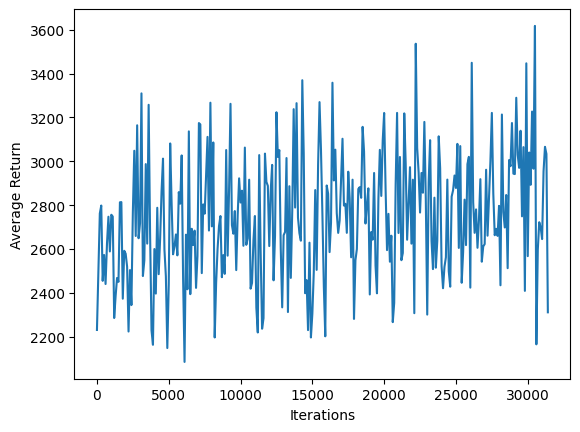

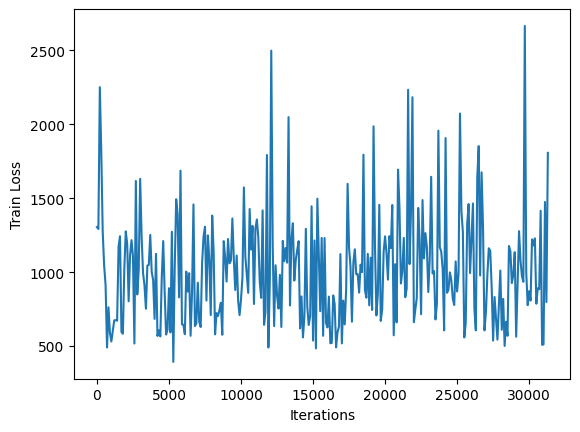

********************ITERATION NUMBER #31400
********************ITERATION NUMBER #31401
********************ITERATION NUMBER #31402
********************ITERATION NUMBER #31403
********************ITERATION NUMBER #31404
********************ITERATION NUMBER #31405
********************ITERATION NUMBER #31406
********************ITERATION NUMBER #31407
********************ITERATION NUMBER #31408
********************ITERATION NUMBER #31409
********************ITERATION NUMBER #31410
********************ITERATION NUMBER #31411
********************ITERATION NUMBER #31412
********************ITERATION NUMBER #31413
********************ITERATION NUMBER #31414
********************ITERATION NUMBER #31415
********************ITERATION NUMBER #31416
********************ITERATION NUMBER #31417
********************ITERATION NUMBER #31418
********************ITERATION NUMBER #31419
********************ITERATION NUMBER #31420
********************ITERATION NUMBER #31421
********************ITERATION NU

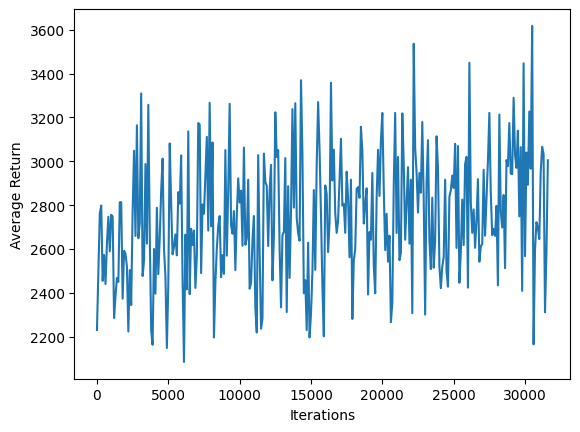

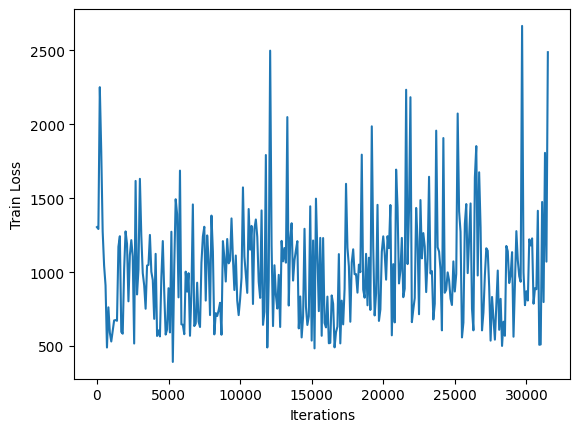

********************ITERATION NUMBER #31600
********************ITERATION NUMBER #31601
********************ITERATION NUMBER #31602
********************ITERATION NUMBER #31603
********************ITERATION NUMBER #31604
********************ITERATION NUMBER #31605
********************ITERATION NUMBER #31606
********************ITERATION NUMBER #31607
********************ITERATION NUMBER #31608
********************ITERATION NUMBER #31609
********************ITERATION NUMBER #31610
********************ITERATION NUMBER #31611
********************ITERATION NUMBER #31612
********************ITERATION NUMBER #31613
********************ITERATION NUMBER #31614
********************ITERATION NUMBER #31615
********************ITERATION NUMBER #31616
********************ITERATION NUMBER #31617
********************ITERATION NUMBER #31618
********************ITERATION NUMBER #31619
********************ITERATION NUMBER #31620
********************ITERATION NUMBER #31621
********************ITERATION NU

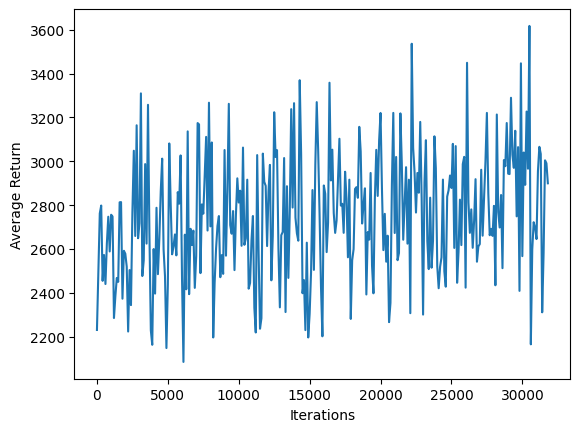

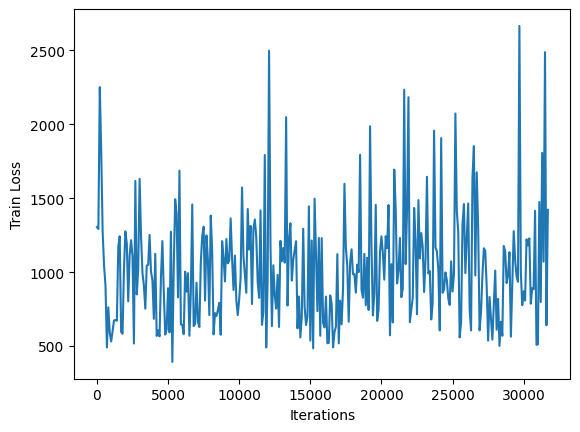

********************ITERATION NUMBER #31800
********************ITERATION NUMBER #31801
********************ITERATION NUMBER #31802
********************ITERATION NUMBER #31803
********************ITERATION NUMBER #31804
********************ITERATION NUMBER #31805
********************ITERATION NUMBER #31806
********************ITERATION NUMBER #31807
********************ITERATION NUMBER #31808
********************ITERATION NUMBER #31809
********************ITERATION NUMBER #31810
********************ITERATION NUMBER #31811
********************ITERATION NUMBER #31812
********************ITERATION NUMBER #31813
********************ITERATION NUMBER #31814
********************ITERATION NUMBER #31815
********************ITERATION NUMBER #31816
********************ITERATION NUMBER #31817
********************ITERATION NUMBER #31818
********************ITERATION NUMBER #31819
********************ITERATION NUMBER #31820
********************ITERATION NUMBER #31821
********************ITERATION NU

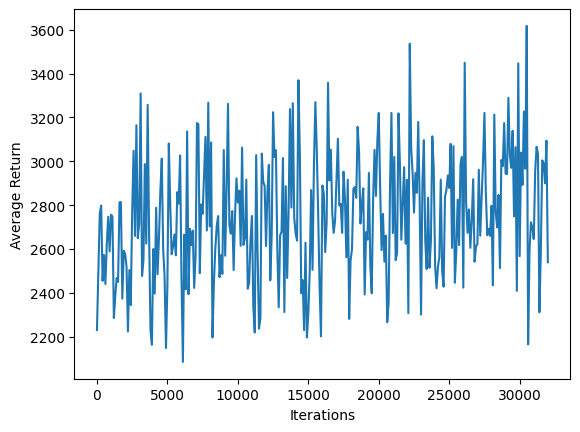

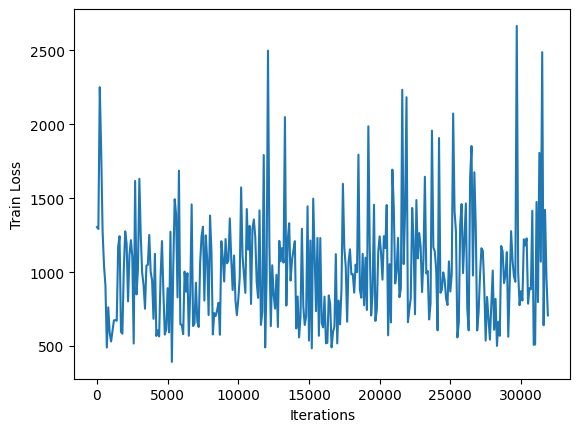

********************ITERATION NUMBER #32000
********************ITERATION NUMBER #32001
********************ITERATION NUMBER #32002
********************ITERATION NUMBER #32003
********************ITERATION NUMBER #32004
********************ITERATION NUMBER #32005
********************ITERATION NUMBER #32006
********************ITERATION NUMBER #32007
********************ITERATION NUMBER #32008
********************ITERATION NUMBER #32009
********************ITERATION NUMBER #32010
********************ITERATION NUMBER #32011
********************ITERATION NUMBER #32012
********************ITERATION NUMBER #32013
********************ITERATION NUMBER #32014
********************ITERATION NUMBER #32015
********************ITERATION NUMBER #32016
********************ITERATION NUMBER #32017
********************ITERATION NUMBER #32018
********************ITERATION NUMBER #32019
********************ITERATION NUMBER #32020
********************ITERATION NUMBER #32021
********************ITERATION NU

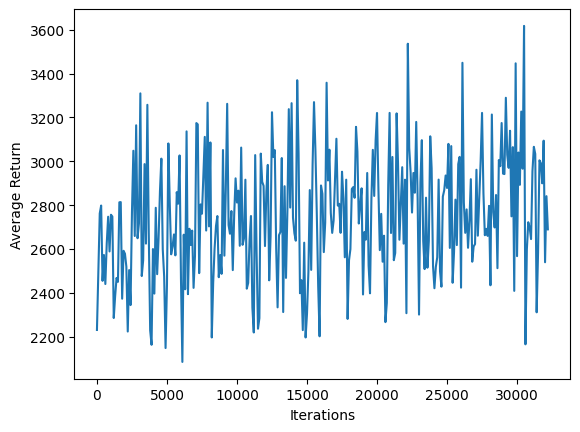

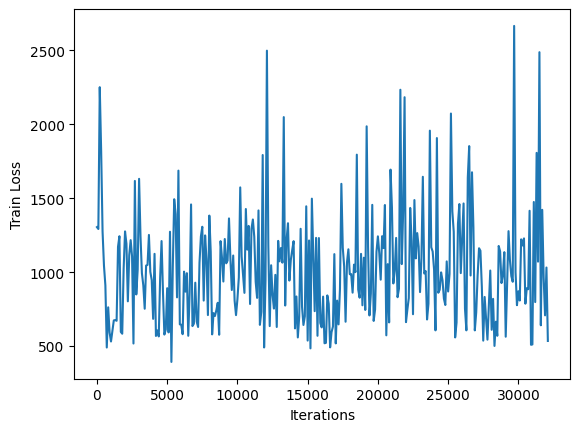

********************ITERATION NUMBER #32200
********************ITERATION NUMBER #32201
********************ITERATION NUMBER #32202
********************ITERATION NUMBER #32203
********************ITERATION NUMBER #32204
********************ITERATION NUMBER #32205
********************ITERATION NUMBER #32206
********************ITERATION NUMBER #32207
********************ITERATION NUMBER #32208
********************ITERATION NUMBER #32209
********************ITERATION NUMBER #32210
********************ITERATION NUMBER #32211
********************ITERATION NUMBER #32212
********************ITERATION NUMBER #32213
********************ITERATION NUMBER #32214
********************ITERATION NUMBER #32215
********************ITERATION NUMBER #32216
********************ITERATION NUMBER #32217
********************ITERATION NUMBER #32218
********************ITERATION NUMBER #32219
********************ITERATION NUMBER #32220
********************ITERATION NUMBER #32221
********************ITERATION NU

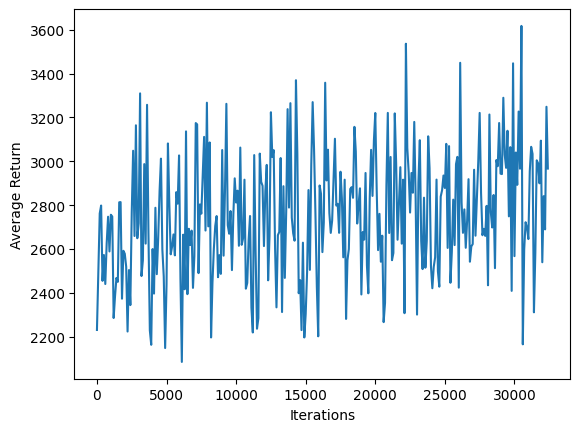

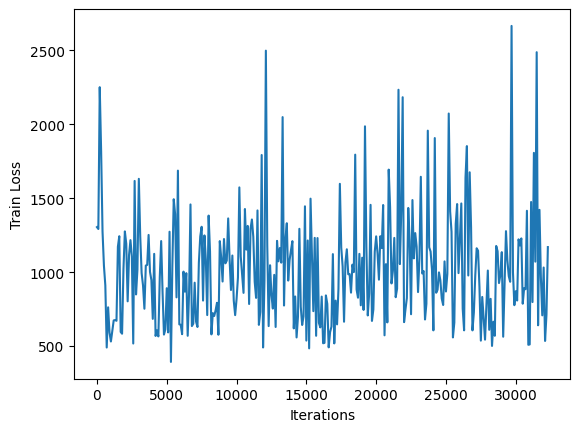

********************ITERATION NUMBER #32400
********************ITERATION NUMBER #32401
********************ITERATION NUMBER #32402
********************ITERATION NUMBER #32403
********************ITERATION NUMBER #32404
********************ITERATION NUMBER #32405
********************ITERATION NUMBER #32406
********************ITERATION NUMBER #32407
********************ITERATION NUMBER #32408
********************ITERATION NUMBER #32409
********************ITERATION NUMBER #32410
********************ITERATION NUMBER #32411
********************ITERATION NUMBER #32412
********************ITERATION NUMBER #32413
********************ITERATION NUMBER #32414
********************ITERATION NUMBER #32415
********************ITERATION NUMBER #32416
********************ITERATION NUMBER #32417
********************ITERATION NUMBER #32418
********************ITERATION NUMBER #32419
********************ITERATION NUMBER #32420
********************ITERATION NUMBER #32421
********************ITERATION NU

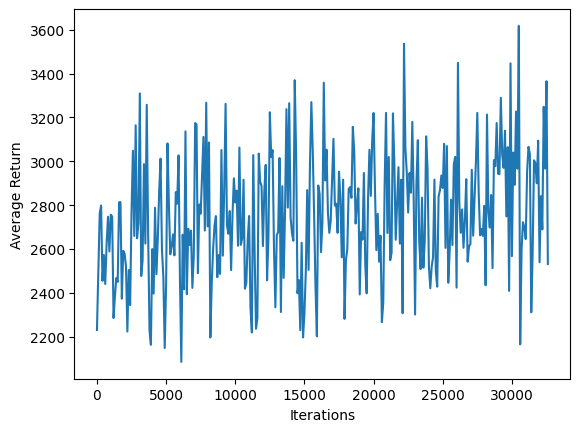

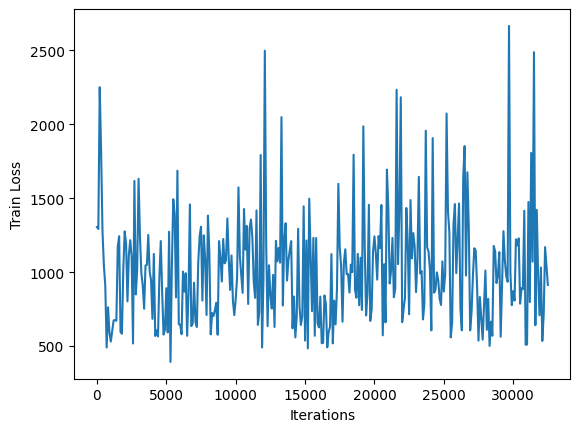

********************ITERATION NUMBER #32600
********************ITERATION NUMBER #32601
********************ITERATION NUMBER #32602
********************ITERATION NUMBER #32603
********************ITERATION NUMBER #32604
********************ITERATION NUMBER #32605
********************ITERATION NUMBER #32606
********************ITERATION NUMBER #32607
********************ITERATION NUMBER #32608
********************ITERATION NUMBER #32609
********************ITERATION NUMBER #32610
********************ITERATION NUMBER #32611
********************ITERATION NUMBER #32612
********************ITERATION NUMBER #32613
********************ITERATION NUMBER #32614
********************ITERATION NUMBER #32615
********************ITERATION NUMBER #32616
********************ITERATION NUMBER #32617
********************ITERATION NUMBER #32618
********************ITERATION NUMBER #32619
********************ITERATION NUMBER #32620
********************ITERATION NUMBER #32621
********************ITERATION NU

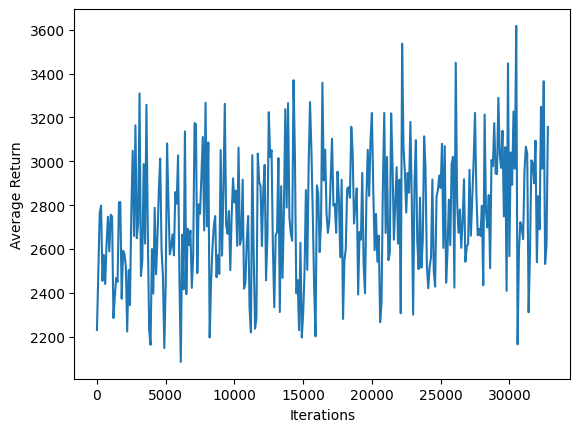

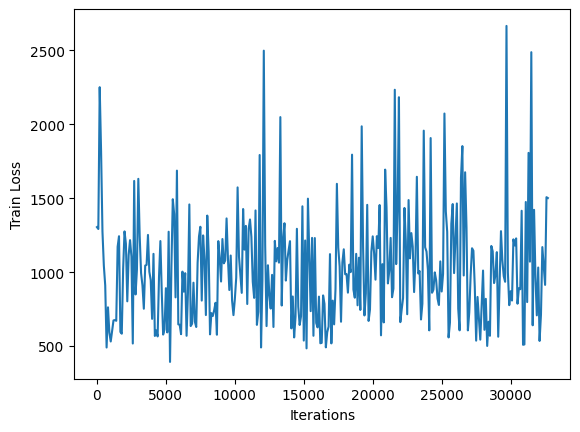

********************ITERATION NUMBER #32800
********************ITERATION NUMBER #32801
********************ITERATION NUMBER #32802
********************ITERATION NUMBER #32803
********************ITERATION NUMBER #32804
********************ITERATION NUMBER #32805
********************ITERATION NUMBER #32806
********************ITERATION NUMBER #32807
********************ITERATION NUMBER #32808
********************ITERATION NUMBER #32809
********************ITERATION NUMBER #32810
********************ITERATION NUMBER #32811
********************ITERATION NUMBER #32812
********************ITERATION NUMBER #32813
********************ITERATION NUMBER #32814
********************ITERATION NUMBER #32815
********************ITERATION NUMBER #32816
********************ITERATION NUMBER #32817
********************ITERATION NUMBER #32818
********************ITERATION NUMBER #32819
********************ITERATION NUMBER #32820
********************ITERATION NUMBER #32821
********************ITERATION NU

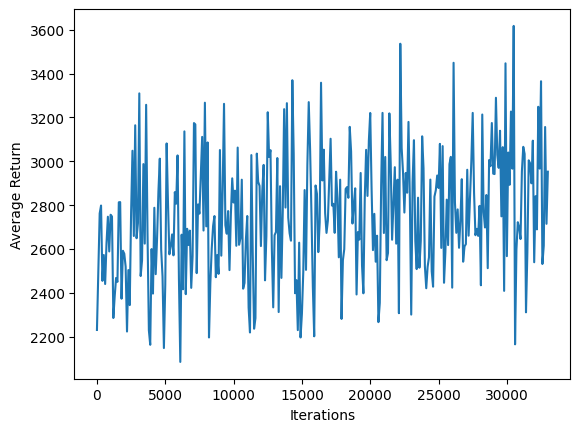

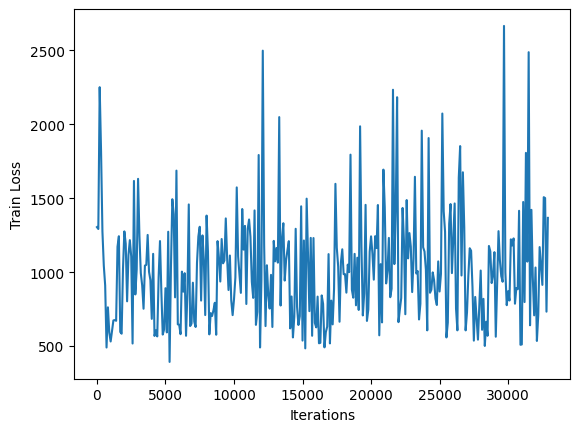

********************ITERATION NUMBER #33000
********************ITERATION NUMBER #33001
********************ITERATION NUMBER #33002
********************ITERATION NUMBER #33003
********************ITERATION NUMBER #33004
********************ITERATION NUMBER #33005
********************ITERATION NUMBER #33006
********************ITERATION NUMBER #33007
********************ITERATION NUMBER #33008
********************ITERATION NUMBER #33009
********************ITERATION NUMBER #33010
********************ITERATION NUMBER #33011
********************ITERATION NUMBER #33012
********************ITERATION NUMBER #33013
********************ITERATION NUMBER #33014
********************ITERATION NUMBER #33015
********************ITERATION NUMBER #33016
********************ITERATION NUMBER #33017
********************ITERATION NUMBER #33018
********************ITERATION NUMBER #33019
********************ITERATION NUMBER #33020
********************ITERATION NUMBER #33021
********************ITERATION NU

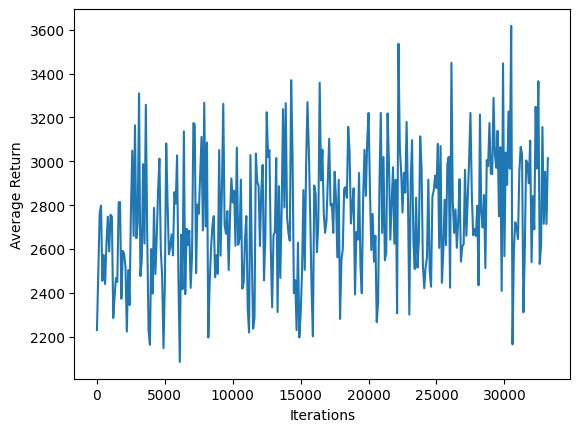

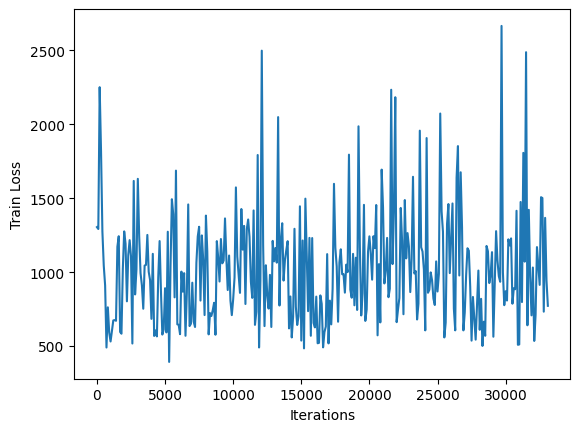

********************ITERATION NUMBER #33200
********************ITERATION NUMBER #33201
********************ITERATION NUMBER #33202
********************ITERATION NUMBER #33203
********************ITERATION NUMBER #33204
********************ITERATION NUMBER #33205
********************ITERATION NUMBER #33206
********************ITERATION NUMBER #33207
********************ITERATION NUMBER #33208
********************ITERATION NUMBER #33209
********************ITERATION NUMBER #33210
********************ITERATION NUMBER #33211
********************ITERATION NUMBER #33212
********************ITERATION NUMBER #33213
********************ITERATION NUMBER #33214
********************ITERATION NUMBER #33215
********************ITERATION NUMBER #33216
********************ITERATION NUMBER #33217
********************ITERATION NUMBER #33218
********************ITERATION NUMBER #33219
********************ITERATION NUMBER #33220
********************ITERATION NUMBER #33221
********************ITERATION NU

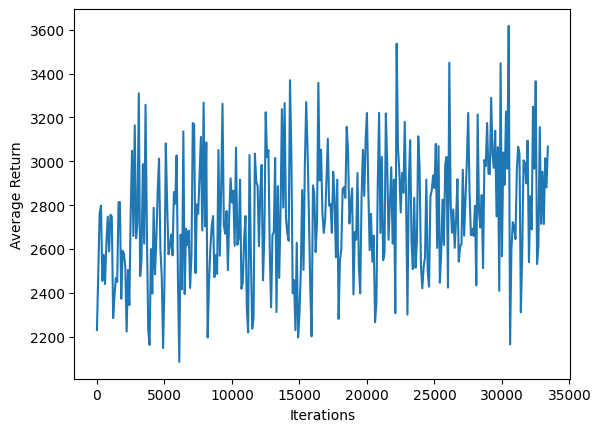

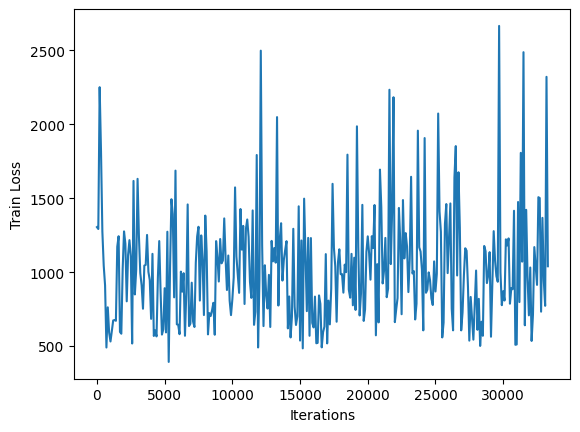

********************ITERATION NUMBER #33400
********************ITERATION NUMBER #33401
********************ITERATION NUMBER #33402
********************ITERATION NUMBER #33403
********************ITERATION NUMBER #33404
********************ITERATION NUMBER #33405
********************ITERATION NUMBER #33406
********************ITERATION NUMBER #33407
********************ITERATION NUMBER #33408
********************ITERATION NUMBER #33409
********************ITERATION NUMBER #33410
********************ITERATION NUMBER #33411
********************ITERATION NUMBER #33412
********************ITERATION NUMBER #33413
********************ITERATION NUMBER #33414
********************ITERATION NUMBER #33415
********************ITERATION NUMBER #33416
********************ITERATION NUMBER #33417
********************ITERATION NUMBER #33418
********************ITERATION NUMBER #33419
********************ITERATION NUMBER #33420
********************ITERATION NUMBER #33421
********************ITERATION NU

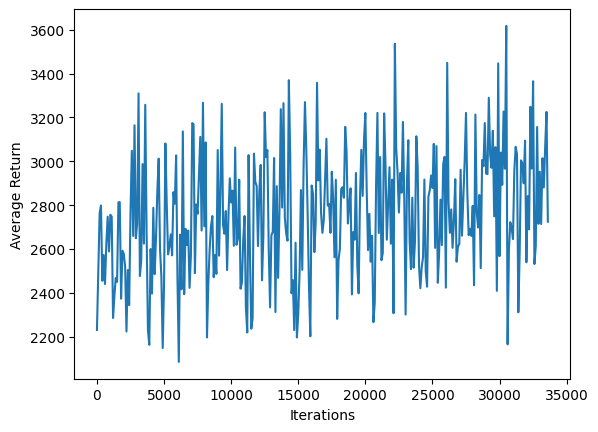

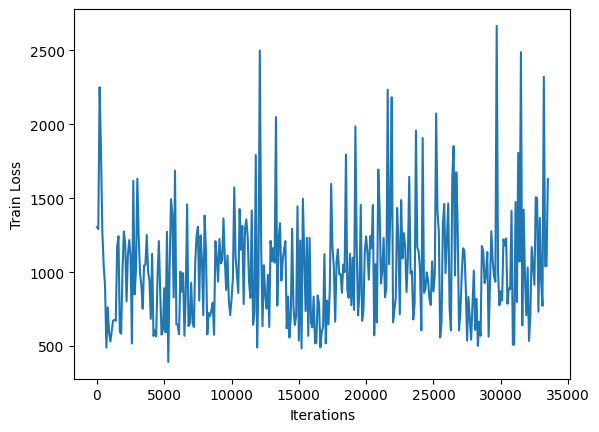

********************ITERATION NUMBER #33600
********************ITERATION NUMBER #33601
********************ITERATION NUMBER #33602
********************ITERATION NUMBER #33603
********************ITERATION NUMBER #33604
********************ITERATION NUMBER #33605
********************ITERATION NUMBER #33606
********************ITERATION NUMBER #33607
********************ITERATION NUMBER #33608
********************ITERATION NUMBER #33609
********************ITERATION NUMBER #33610
********************ITERATION NUMBER #33611
********************ITERATION NUMBER #33612
********************ITERATION NUMBER #33613
********************ITERATION NUMBER #33614
********************ITERATION NUMBER #33615
********************ITERATION NUMBER #33616
********************ITERATION NUMBER #33617
********************ITERATION NUMBER #33618
********************ITERATION NUMBER #33619
********************ITERATION NUMBER #33620
********************ITERATION NUMBER #33621
********************ITERATION NU

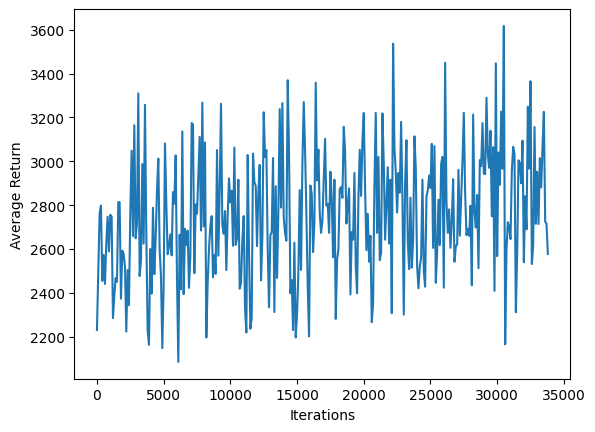

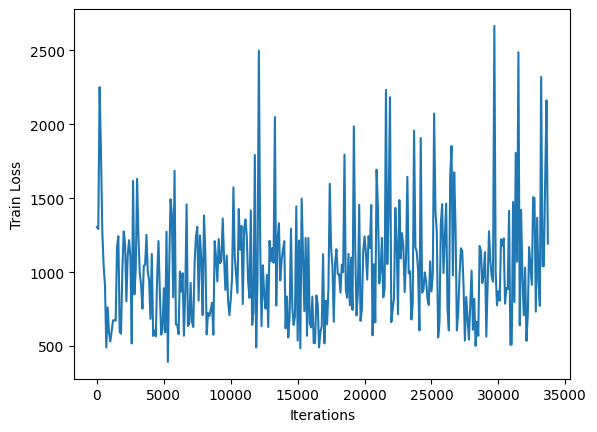

********************ITERATION NUMBER #33800
********************ITERATION NUMBER #33801
********************ITERATION NUMBER #33802
********************ITERATION NUMBER #33803
********************ITERATION NUMBER #33804
********************ITERATION NUMBER #33805
********************ITERATION NUMBER #33806
********************ITERATION NUMBER #33807
********************ITERATION NUMBER #33808
********************ITERATION NUMBER #33809
********************ITERATION NUMBER #33810
********************ITERATION NUMBER #33811
********************ITERATION NUMBER #33812
********************ITERATION NUMBER #33813
********************ITERATION NUMBER #33814
********************ITERATION NUMBER #33815
********************ITERATION NUMBER #33816
********************ITERATION NUMBER #33817
********************ITERATION NUMBER #33818
********************ITERATION NUMBER #33819
********************ITERATION NUMBER #33820
********************ITERATION NUMBER #33821
********************ITERATION NU

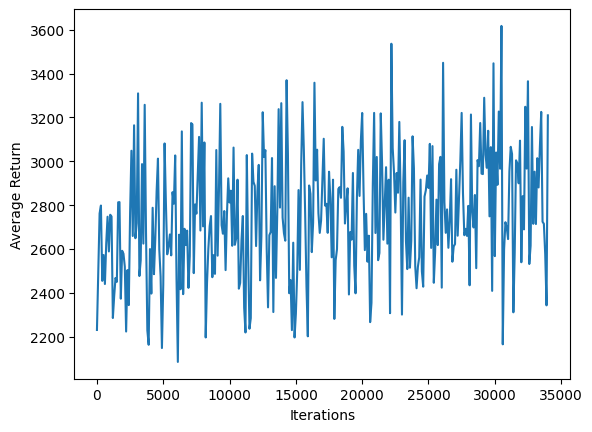

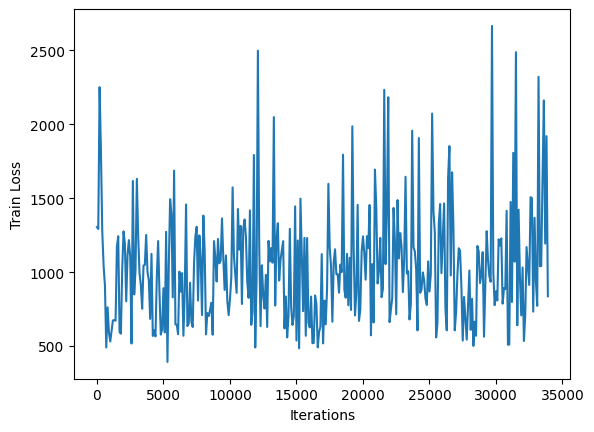

********************ITERATION NUMBER #34000
********************ITERATION NUMBER #34001
********************ITERATION NUMBER #34002
********************ITERATION NUMBER #34003
********************ITERATION NUMBER #34004
********************ITERATION NUMBER #34005
********************ITERATION NUMBER #34006
********************ITERATION NUMBER #34007
********************ITERATION NUMBER #34008
********************ITERATION NUMBER #34009
********************ITERATION NUMBER #34010
********************ITERATION NUMBER #34011
********************ITERATION NUMBER #34012
********************ITERATION NUMBER #34013
********************ITERATION NUMBER #34014
********************ITERATION NUMBER #34015
********************ITERATION NUMBER #34016
********************ITERATION NUMBER #34017
********************ITERATION NUMBER #34018
********************ITERATION NUMBER #34019
********************ITERATION NUMBER #34020
********************ITERATION NUMBER #34021
********************ITERATION NU

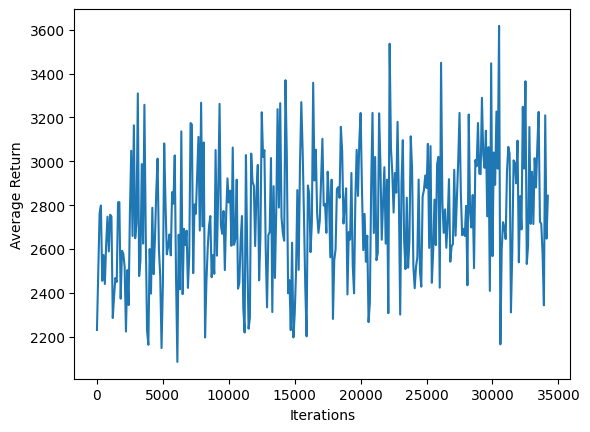

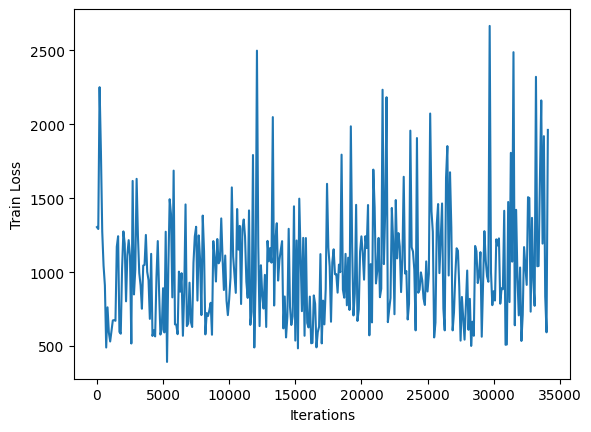

********************ITERATION NUMBER #34200
********************ITERATION NUMBER #34201
********************ITERATION NUMBER #34202
********************ITERATION NUMBER #34203
********************ITERATION NUMBER #34204
********************ITERATION NUMBER #34205
********************ITERATION NUMBER #34206
********************ITERATION NUMBER #34207
********************ITERATION NUMBER #34208
********************ITERATION NUMBER #34209
********************ITERATION NUMBER #34210
********************ITERATION NUMBER #34211
********************ITERATION NUMBER #34212
********************ITERATION NUMBER #34213
********************ITERATION NUMBER #34214
********************ITERATION NUMBER #34215
********************ITERATION NUMBER #34216
********************ITERATION NUMBER #34217
********************ITERATION NUMBER #34218
********************ITERATION NUMBER #34219
********************ITERATION NUMBER #34220
********************ITERATION NUMBER #34221
********************ITERATION NU

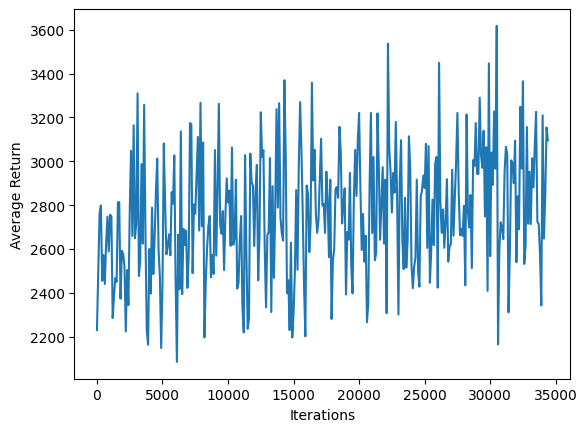

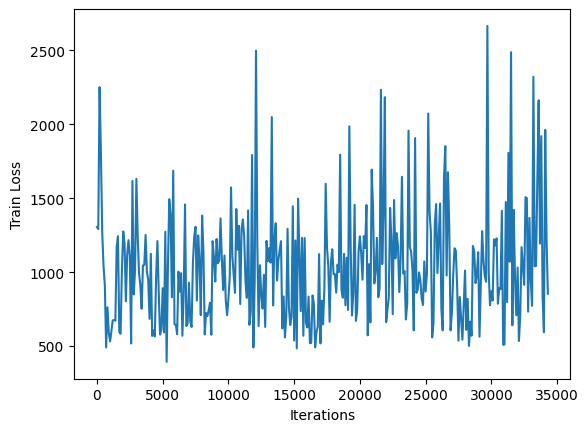

********************ITERATION NUMBER #34400
********************ITERATION NUMBER #34401
********************ITERATION NUMBER #34402
********************ITERATION NUMBER #34403
********************ITERATION NUMBER #34404
********************ITERATION NUMBER #34405
********************ITERATION NUMBER #34406
********************ITERATION NUMBER #34407
********************ITERATION NUMBER #34408
********************ITERATION NUMBER #34409
********************ITERATION NUMBER #34410
********************ITERATION NUMBER #34411
********************ITERATION NUMBER #34412
********************ITERATION NUMBER #34413
********************ITERATION NUMBER #34414
********************ITERATION NUMBER #34415
********************ITERATION NUMBER #34416
********************ITERATION NUMBER #34417
********************ITERATION NUMBER #34418
********************ITERATION NUMBER #34419
********************ITERATION NUMBER #34420
********************ITERATION NUMBER #34421
********************ITERATION NU

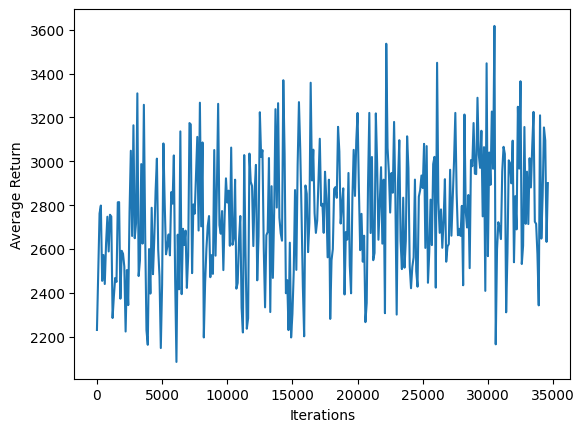

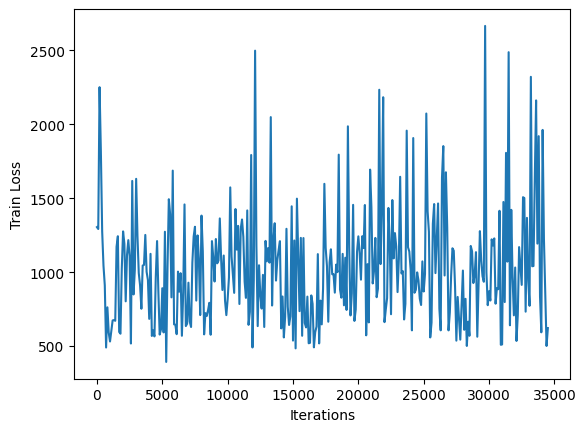

********************ITERATION NUMBER #34600
********************ITERATION NUMBER #34601
********************ITERATION NUMBER #34602
********************ITERATION NUMBER #34603
********************ITERATION NUMBER #34604
********************ITERATION NUMBER #34605
********************ITERATION NUMBER #34606
********************ITERATION NUMBER #34607
********************ITERATION NUMBER #34608
********************ITERATION NUMBER #34609
********************ITERATION NUMBER #34610
********************ITERATION NUMBER #34611
********************ITERATION NUMBER #34612
********************ITERATION NUMBER #34613
********************ITERATION NUMBER #34614
********************ITERATION NUMBER #34615
********************ITERATION NUMBER #34616
********************ITERATION NUMBER #34617
********************ITERATION NUMBER #34618
********************ITERATION NUMBER #34619
********************ITERATION NUMBER #34620
********************ITERATION NUMBER #34621
********************ITERATION NU

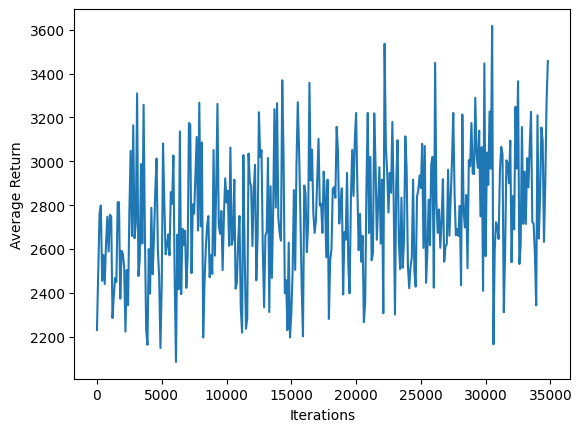

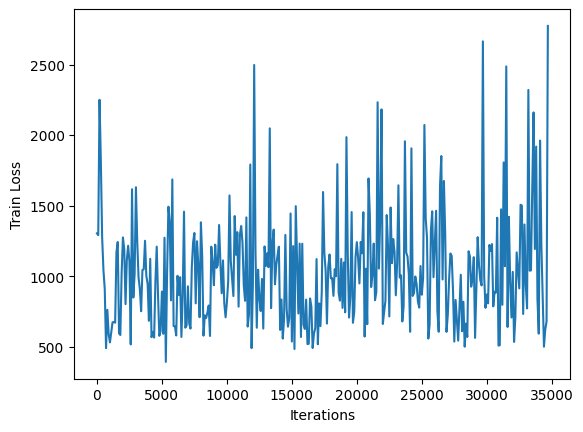

********************ITERATION NUMBER #34800
********************ITERATION NUMBER #34801
********************ITERATION NUMBER #34802
********************ITERATION NUMBER #34803
********************ITERATION NUMBER #34804
********************ITERATION NUMBER #34805
********************ITERATION NUMBER #34806
********************ITERATION NUMBER #34807
********************ITERATION NUMBER #34808
********************ITERATION NUMBER #34809
********************ITERATION NUMBER #34810
********************ITERATION NUMBER #34811
********************ITERATION NUMBER #34812
********************ITERATION NUMBER #34813
********************ITERATION NUMBER #34814
********************ITERATION NUMBER #34815
********************ITERATION NUMBER #34816
********************ITERATION NUMBER #34817
********************ITERATION NUMBER #34818
********************ITERATION NUMBER #34819
********************ITERATION NUMBER #34820
********************ITERATION NUMBER #34821
********************ITERATION NU

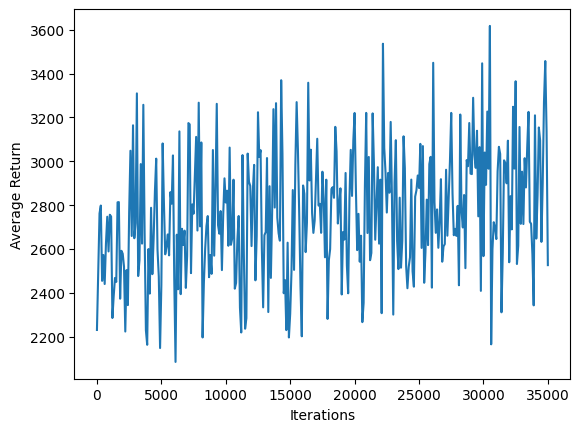

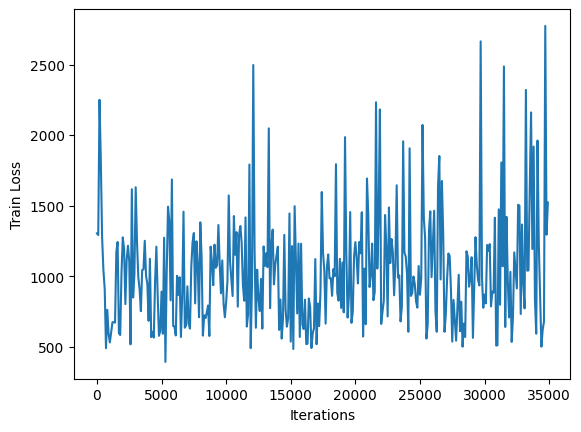

********************ITERATION NUMBER #35000
********************ITERATION NUMBER #35001
********************ITERATION NUMBER #35002
********************ITERATION NUMBER #35003
********************ITERATION NUMBER #35004
********************ITERATION NUMBER #35005
********************ITERATION NUMBER #35006
********************ITERATION NUMBER #35007
********************ITERATION NUMBER #35008
********************ITERATION NUMBER #35009
********************ITERATION NUMBER #35010
********************ITERATION NUMBER #35011
********************ITERATION NUMBER #35012
********************ITERATION NUMBER #35013
********************ITERATION NUMBER #35014
********************ITERATION NUMBER #35015
********************ITERATION NUMBER #35016
********************ITERATION NUMBER #35017
********************ITERATION NUMBER #35018
********************ITERATION NUMBER #35019
********************ITERATION NUMBER #35020
********************ITERATION NUMBER #35021
********************ITERATION NU

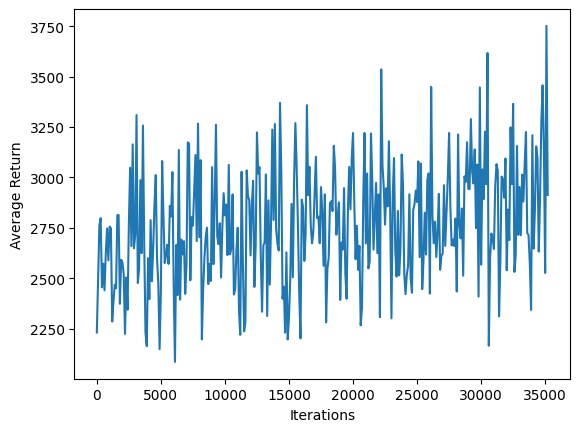

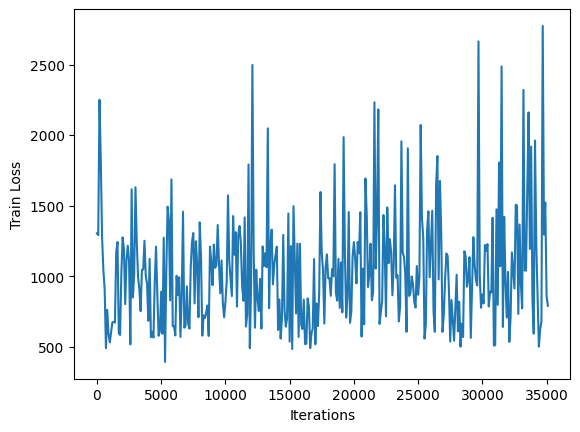

********************ITERATION NUMBER #35200
********************ITERATION NUMBER #35201
********************ITERATION NUMBER #35202
********************ITERATION NUMBER #35203
********************ITERATION NUMBER #35204
********************ITERATION NUMBER #35205
********************ITERATION NUMBER #35206
********************ITERATION NUMBER #35207
********************ITERATION NUMBER #35208
********************ITERATION NUMBER #35209
********************ITERATION NUMBER #35210
********************ITERATION NUMBER #35211
********************ITERATION NUMBER #35212
********************ITERATION NUMBER #35213
********************ITERATION NUMBER #35214
********************ITERATION NUMBER #35215
********************ITERATION NUMBER #35216
********************ITERATION NUMBER #35217
********************ITERATION NUMBER #35218
********************ITERATION NUMBER #35219
********************ITERATION NUMBER #35220
********************ITERATION NUMBER #35221
********************ITERATION NU

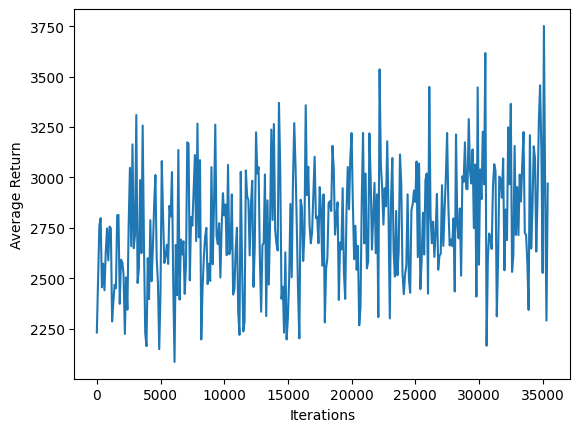

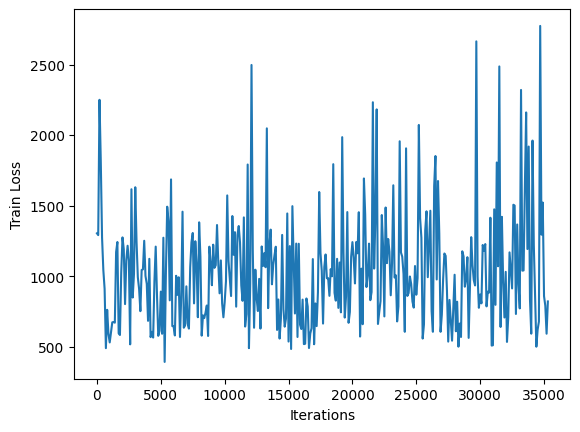

********************ITERATION NUMBER #35400
********************ITERATION NUMBER #35401
********************ITERATION NUMBER #35402
********************ITERATION NUMBER #35403
********************ITERATION NUMBER #35404
********************ITERATION NUMBER #35405
********************ITERATION NUMBER #35406
********************ITERATION NUMBER #35407
********************ITERATION NUMBER #35408
********************ITERATION NUMBER #35409
********************ITERATION NUMBER #35410
********************ITERATION NUMBER #35411
********************ITERATION NUMBER #35412
********************ITERATION NUMBER #35413
********************ITERATION NUMBER #35414
********************ITERATION NUMBER #35415
********************ITERATION NUMBER #35416
********************ITERATION NUMBER #35417
********************ITERATION NUMBER #35418
********************ITERATION NUMBER #35419
********************ITERATION NUMBER #35420
********************ITERATION NUMBER #35421
********************ITERATION NU

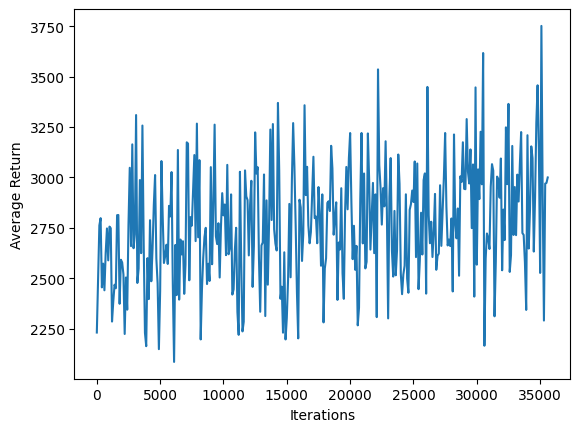

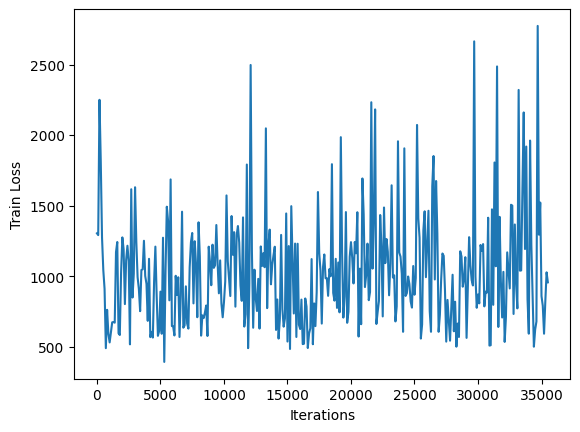

********************ITERATION NUMBER #35600
********************ITERATION NUMBER #35601
********************ITERATION NUMBER #35602
********************ITERATION NUMBER #35603
********************ITERATION NUMBER #35604
********************ITERATION NUMBER #35605
********************ITERATION NUMBER #35606
********************ITERATION NUMBER #35607
********************ITERATION NUMBER #35608
********************ITERATION NUMBER #35609
********************ITERATION NUMBER #35610
********************ITERATION NUMBER #35611
********************ITERATION NUMBER #35612
********************ITERATION NUMBER #35613
********************ITERATION NUMBER #35614
********************ITERATION NUMBER #35615
********************ITERATION NUMBER #35616
********************ITERATION NUMBER #35617
********************ITERATION NUMBER #35618
********************ITERATION NUMBER #35619
********************ITERATION NUMBER #35620
********************ITERATION NUMBER #35621
********************ITERATION NU

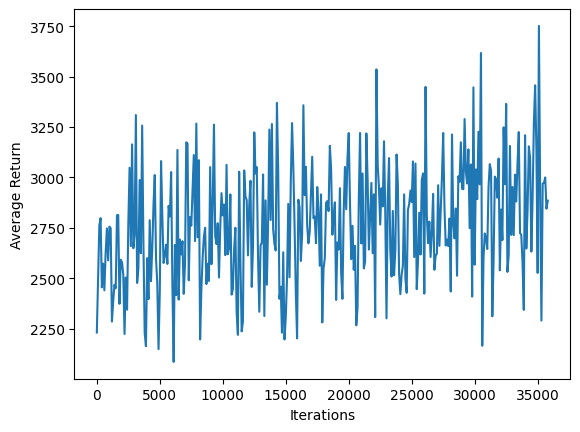

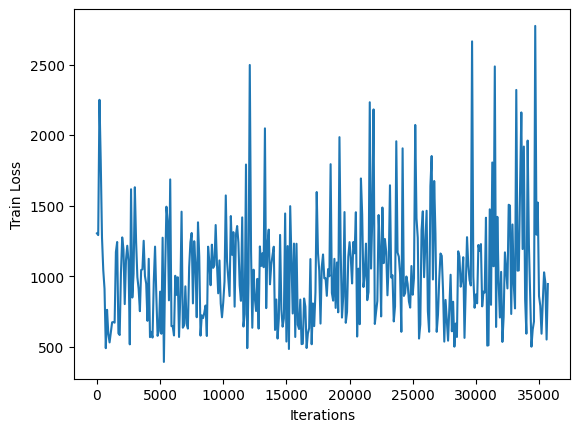

********************ITERATION NUMBER #35800
********************ITERATION NUMBER #35801
********************ITERATION NUMBER #35802
********************ITERATION NUMBER #35803
********************ITERATION NUMBER #35804
********************ITERATION NUMBER #35805
********************ITERATION NUMBER #35806
********************ITERATION NUMBER #35807
********************ITERATION NUMBER #35808
********************ITERATION NUMBER #35809
********************ITERATION NUMBER #35810
********************ITERATION NUMBER #35811
********************ITERATION NUMBER #35812
********************ITERATION NUMBER #35813
********************ITERATION NUMBER #35814
********************ITERATION NUMBER #35815
********************ITERATION NUMBER #35816
********************ITERATION NUMBER #35817
********************ITERATION NUMBER #35818
********************ITERATION NUMBER #35819
********************ITERATION NUMBER #35820
********************ITERATION NUMBER #35821
********************ITERATION NU

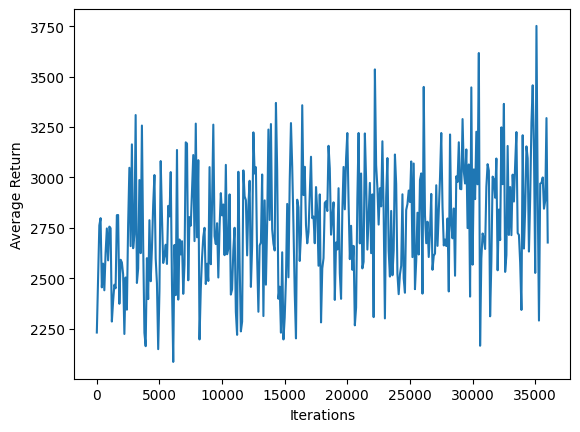

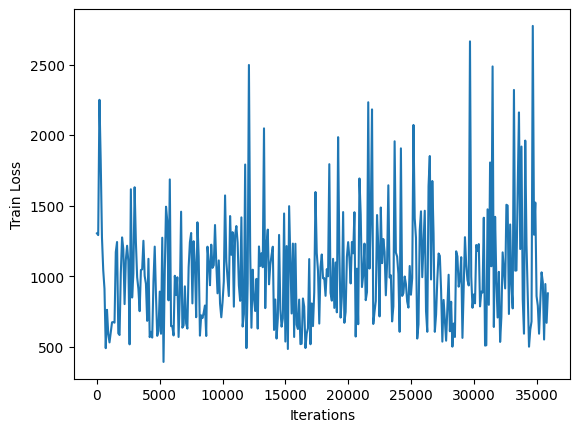

********************ITERATION NUMBER #36000
********************ITERATION NUMBER #36001
********************ITERATION NUMBER #36002
********************ITERATION NUMBER #36003
********************ITERATION NUMBER #36004
********************ITERATION NUMBER #36005
********************ITERATION NUMBER #36006
********************ITERATION NUMBER #36007
********************ITERATION NUMBER #36008
********************ITERATION NUMBER #36009
********************ITERATION NUMBER #36010
********************ITERATION NUMBER #36011
********************ITERATION NUMBER #36012
********************ITERATION NUMBER #36013
********************ITERATION NUMBER #36014
********************ITERATION NUMBER #36015
********************ITERATION NUMBER #36016
********************ITERATION NUMBER #36017
********************ITERATION NUMBER #36018
********************ITERATION NUMBER #36019
********************ITERATION NUMBER #36020
********************ITERATION NUMBER #36021
********************ITERATION NU

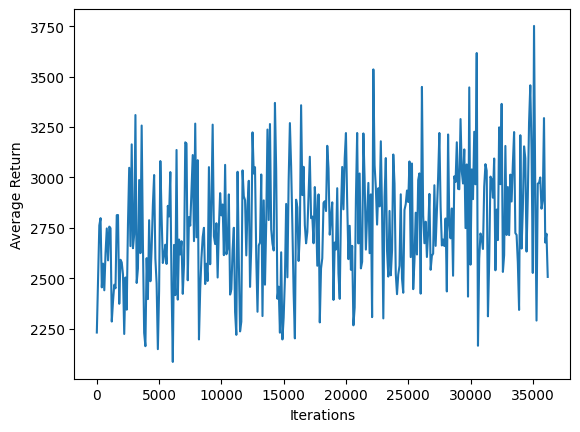

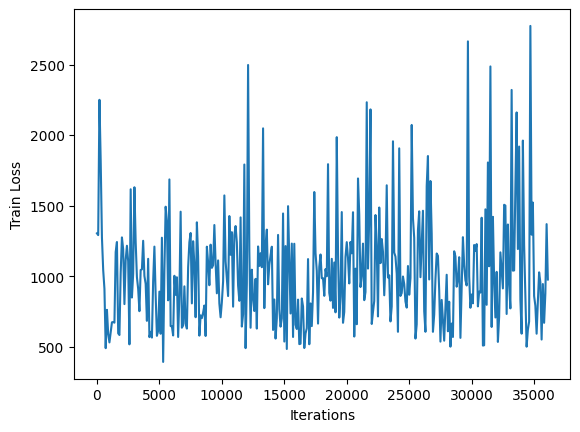

********************ITERATION NUMBER #36200
********************ITERATION NUMBER #36201
********************ITERATION NUMBER #36202
********************ITERATION NUMBER #36203
********************ITERATION NUMBER #36204
********************ITERATION NUMBER #36205
********************ITERATION NUMBER #36206
********************ITERATION NUMBER #36207
********************ITERATION NUMBER #36208
********************ITERATION NUMBER #36209
********************ITERATION NUMBER #36210
********************ITERATION NUMBER #36211
********************ITERATION NUMBER #36212
********************ITERATION NUMBER #36213
********************ITERATION NUMBER #36214
********************ITERATION NUMBER #36215
********************ITERATION NUMBER #36216
********************ITERATION NUMBER #36217
********************ITERATION NUMBER #36218
********************ITERATION NUMBER #36219
********************ITERATION NUMBER #36220
********************ITERATION NUMBER #36221
********************ITERATION NU

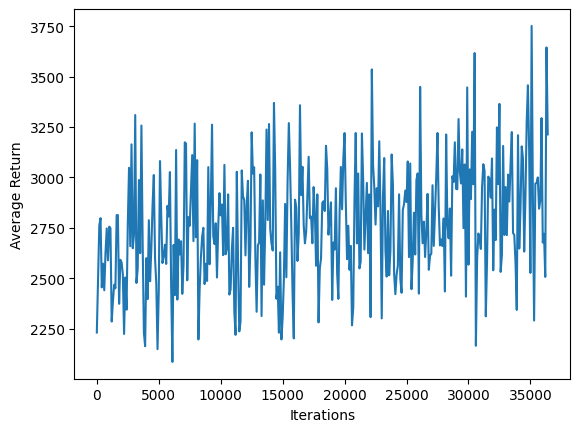

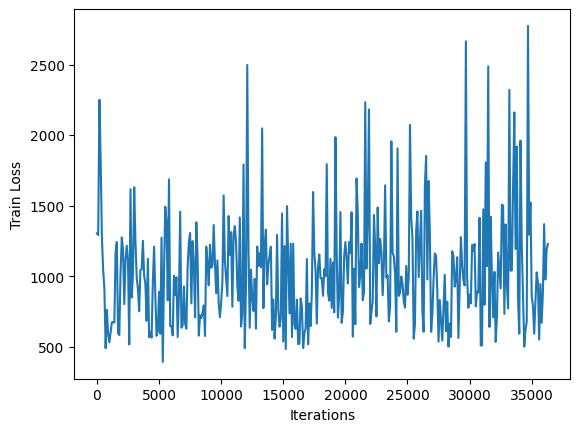

********************ITERATION NUMBER #36400
********************ITERATION NUMBER #36401
********************ITERATION NUMBER #36402
********************ITERATION NUMBER #36403
********************ITERATION NUMBER #36404
********************ITERATION NUMBER #36405
********************ITERATION NUMBER #36406
********************ITERATION NUMBER #36407
********************ITERATION NUMBER #36408
********************ITERATION NUMBER #36409
********************ITERATION NUMBER #36410
********************ITERATION NUMBER #36411
********************ITERATION NUMBER #36412
********************ITERATION NUMBER #36413
********************ITERATION NUMBER #36414
********************ITERATION NUMBER #36415
********************ITERATION NUMBER #36416
********************ITERATION NUMBER #36417
********************ITERATION NUMBER #36418
********************ITERATION NUMBER #36419
********************ITERATION NUMBER #36420
********************ITERATION NUMBER #36421
********************ITERATION NU

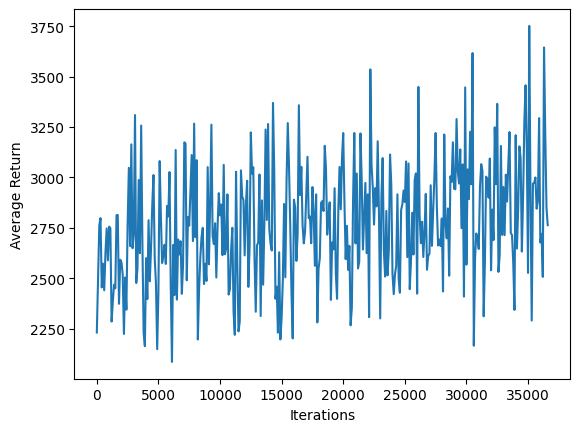

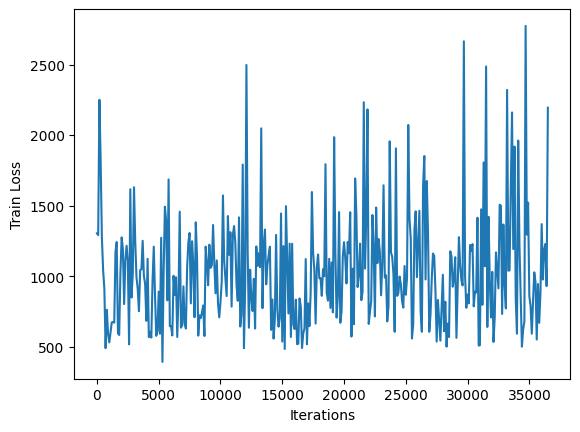

********************ITERATION NUMBER #36600
********************ITERATION NUMBER #36601
********************ITERATION NUMBER #36602
********************ITERATION NUMBER #36603
********************ITERATION NUMBER #36604
********************ITERATION NUMBER #36605
********************ITERATION NUMBER #36606
********************ITERATION NUMBER #36607
********************ITERATION NUMBER #36608
********************ITERATION NUMBER #36609
********************ITERATION NUMBER #36610
********************ITERATION NUMBER #36611
********************ITERATION NUMBER #36612
********************ITERATION NUMBER #36613
********************ITERATION NUMBER #36614
********************ITERATION NUMBER #36615
********************ITERATION NUMBER #36616
********************ITERATION NUMBER #36617
********************ITERATION NUMBER #36618
********************ITERATION NUMBER #36619
********************ITERATION NUMBER #36620
********************ITERATION NUMBER #36621
********************ITERATION NU

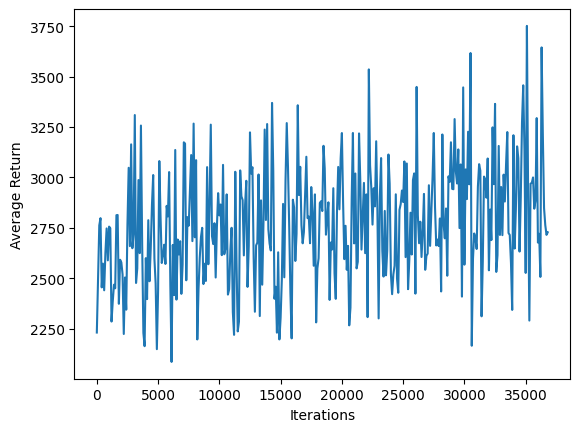

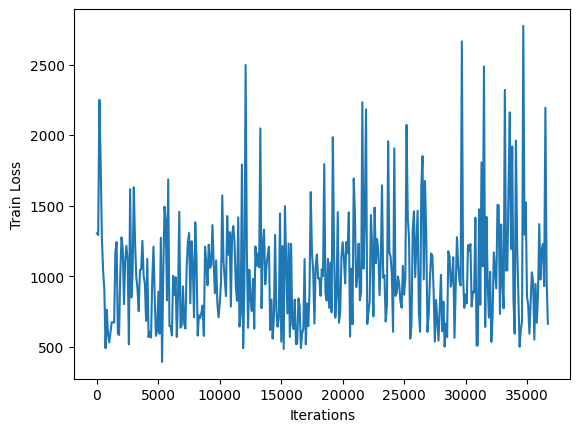

********************ITERATION NUMBER #36800
********************ITERATION NUMBER #36801
********************ITERATION NUMBER #36802
********************ITERATION NUMBER #36803
********************ITERATION NUMBER #36804
********************ITERATION NUMBER #36805
********************ITERATION NUMBER #36806
********************ITERATION NUMBER #36807
********************ITERATION NUMBER #36808
********************ITERATION NUMBER #36809
********************ITERATION NUMBER #36810
********************ITERATION NUMBER #36811
********************ITERATION NUMBER #36812
********************ITERATION NUMBER #36813
********************ITERATION NUMBER #36814
********************ITERATION NUMBER #36815
********************ITERATION NUMBER #36816
********************ITERATION NUMBER #36817
********************ITERATION NUMBER #36818
********************ITERATION NUMBER #36819
********************ITERATION NUMBER #36820
********************ITERATION NUMBER #36821
********************ITERATION NU

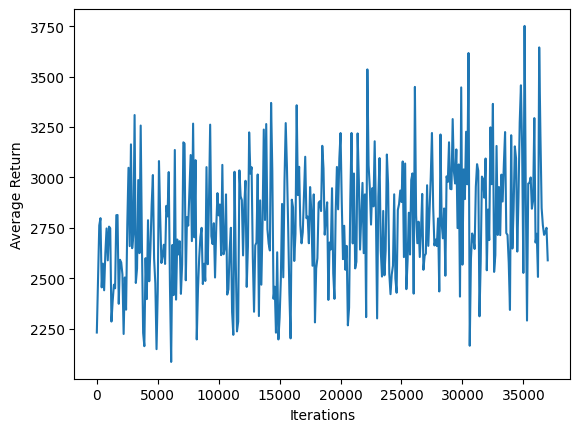

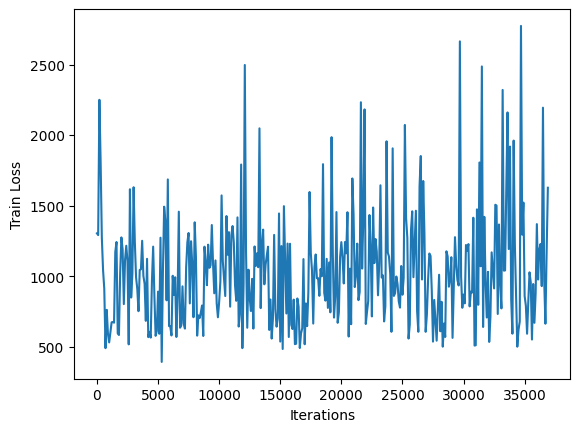

********************ITERATION NUMBER #37000
********************ITERATION NUMBER #37001
********************ITERATION NUMBER #37002
********************ITERATION NUMBER #37003
********************ITERATION NUMBER #37004
********************ITERATION NUMBER #37005
********************ITERATION NUMBER #37006
********************ITERATION NUMBER #37007
********************ITERATION NUMBER #37008
********************ITERATION NUMBER #37009
********************ITERATION NUMBER #37010
********************ITERATION NUMBER #37011
********************ITERATION NUMBER #37012
********************ITERATION NUMBER #37013
********************ITERATION NUMBER #37014
********************ITERATION NUMBER #37015
********************ITERATION NUMBER #37016
********************ITERATION NUMBER #37017
********************ITERATION NUMBER #37018
********************ITERATION NUMBER #37019
********************ITERATION NUMBER #37020
********************ITERATION NUMBER #37021
********************ITERATION NU

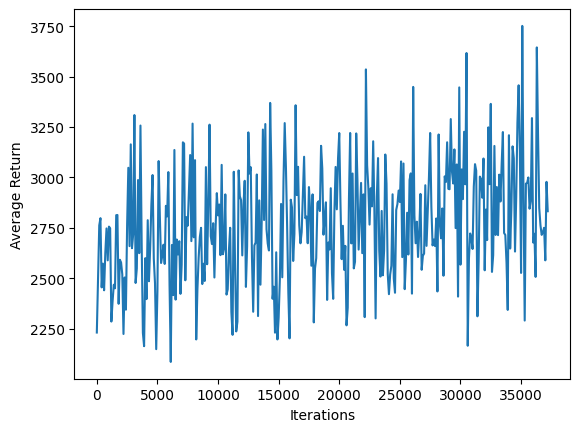

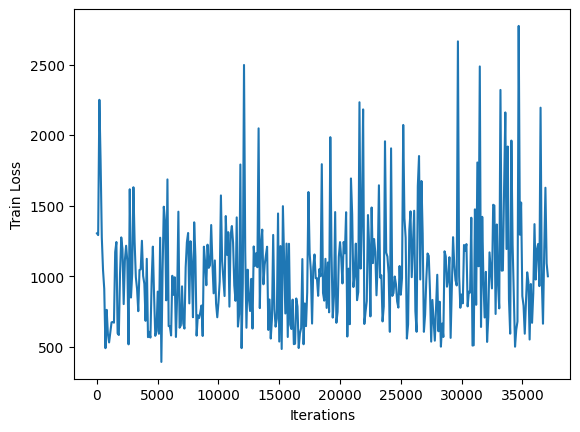

********************ITERATION NUMBER #37200
********************ITERATION NUMBER #37201
********************ITERATION NUMBER #37202
********************ITERATION NUMBER #37203
********************ITERATION NUMBER #37204
********************ITERATION NUMBER #37205
********************ITERATION NUMBER #37206
********************ITERATION NUMBER #37207
********************ITERATION NUMBER #37208
********************ITERATION NUMBER #37209
********************ITERATION NUMBER #37210
********************ITERATION NUMBER #37211
********************ITERATION NUMBER #37212
********************ITERATION NUMBER #37213
********************ITERATION NUMBER #37214
********************ITERATION NUMBER #37215
********************ITERATION NUMBER #37216
********************ITERATION NUMBER #37217
********************ITERATION NUMBER #37218
********************ITERATION NUMBER #37219
********************ITERATION NUMBER #37220
********************ITERATION NUMBER #37221
********************ITERATION NU

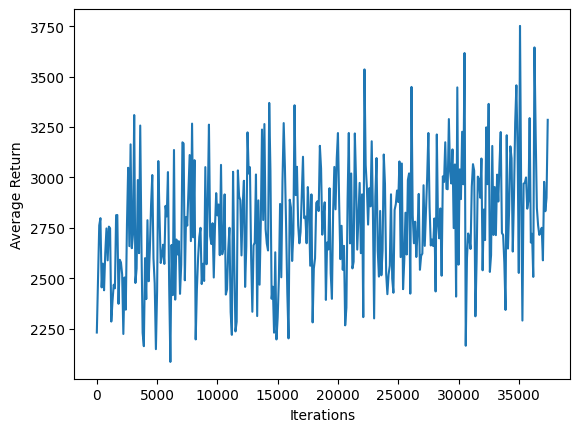

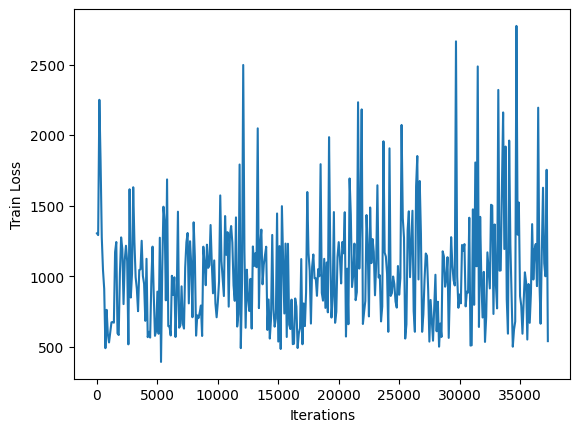

********************ITERATION NUMBER #37400
********************ITERATION NUMBER #37401
********************ITERATION NUMBER #37402
********************ITERATION NUMBER #37403
********************ITERATION NUMBER #37404
********************ITERATION NUMBER #37405
********************ITERATION NUMBER #37406
********************ITERATION NUMBER #37407
********************ITERATION NUMBER #37408
********************ITERATION NUMBER #37409
********************ITERATION NUMBER #37410
********************ITERATION NUMBER #37411
********************ITERATION NUMBER #37412
********************ITERATION NUMBER #37413
********************ITERATION NUMBER #37414
********************ITERATION NUMBER #37415
********************ITERATION NUMBER #37416
********************ITERATION NUMBER #37417
********************ITERATION NUMBER #37418
********************ITERATION NUMBER #37419
********************ITERATION NUMBER #37420
********************ITERATION NUMBER #37421
********************ITERATION NU

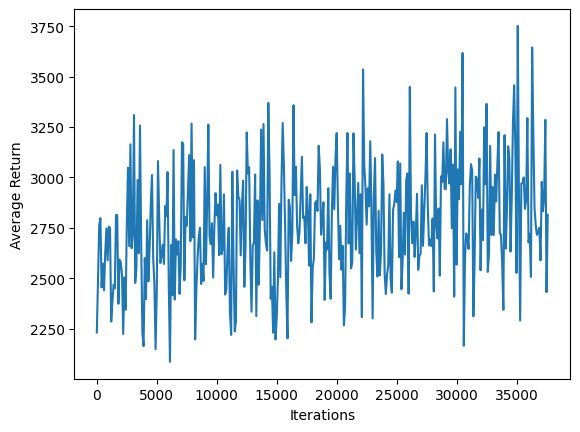

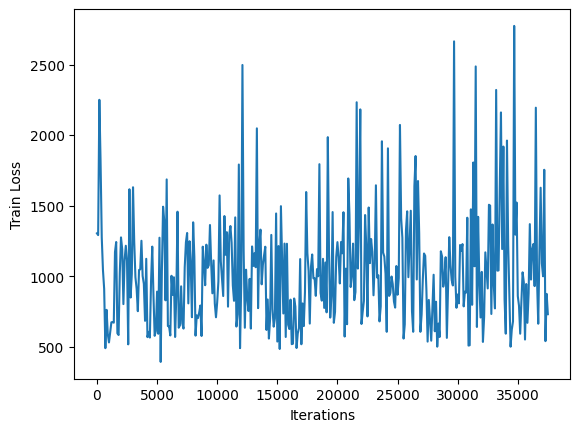

********************ITERATION NUMBER #37600
********************ITERATION NUMBER #37601
********************ITERATION NUMBER #37602
********************ITERATION NUMBER #37603
********************ITERATION NUMBER #37604
********************ITERATION NUMBER #37605
********************ITERATION NUMBER #37606
********************ITERATION NUMBER #37607
********************ITERATION NUMBER #37608
********************ITERATION NUMBER #37609
********************ITERATION NUMBER #37610
********************ITERATION NUMBER #37611
********************ITERATION NUMBER #37612
********************ITERATION NUMBER #37613
********************ITERATION NUMBER #37614
********************ITERATION NUMBER #37615
********************ITERATION NUMBER #37616
********************ITERATION NUMBER #37617
********************ITERATION NUMBER #37618
********************ITERATION NUMBER #37619
********************ITERATION NUMBER #37620
********************ITERATION NUMBER #37621
********************ITERATION NU

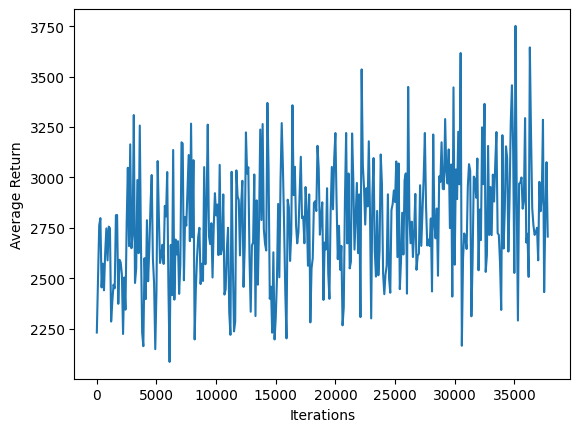

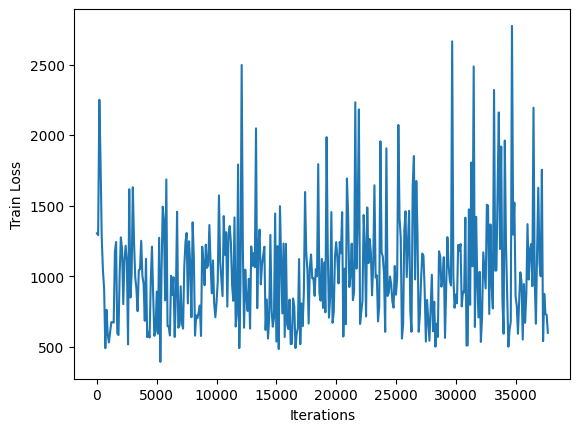

********************ITERATION NUMBER #37800
********************ITERATION NUMBER #37801
********************ITERATION NUMBER #37802
********************ITERATION NUMBER #37803
********************ITERATION NUMBER #37804
********************ITERATION NUMBER #37805
********************ITERATION NUMBER #37806
********************ITERATION NUMBER #37807
********************ITERATION NUMBER #37808
********************ITERATION NUMBER #37809
********************ITERATION NUMBER #37810
********************ITERATION NUMBER #37811
********************ITERATION NUMBER #37812
********************ITERATION NUMBER #37813
********************ITERATION NUMBER #37814
********************ITERATION NUMBER #37815
********************ITERATION NUMBER #37816
********************ITERATION NUMBER #37817
********************ITERATION NUMBER #37818
********************ITERATION NUMBER #37819
********************ITERATION NUMBER #37820
********************ITERATION NUMBER #37821
********************ITERATION NU

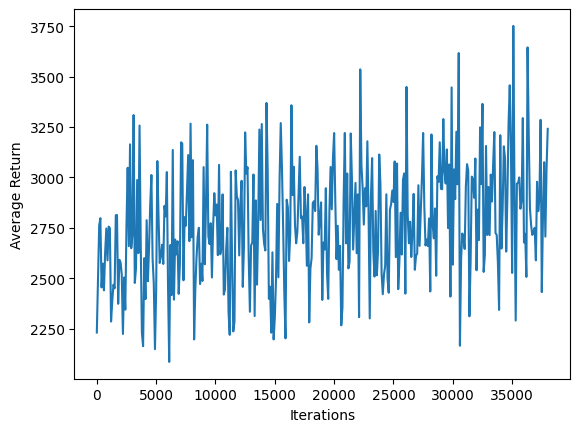

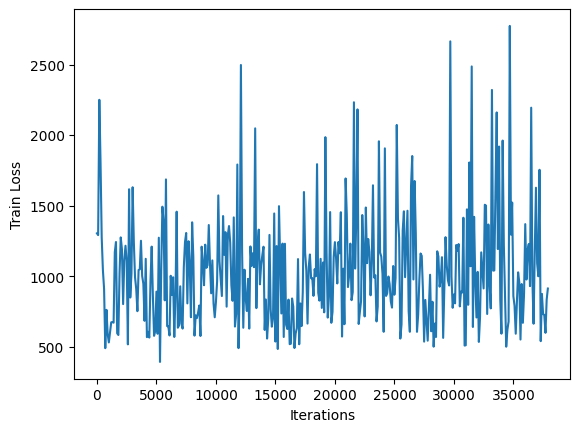

********************ITERATION NUMBER #38000
********************ITERATION NUMBER #38001
********************ITERATION NUMBER #38002
********************ITERATION NUMBER #38003
********************ITERATION NUMBER #38004
********************ITERATION NUMBER #38005
********************ITERATION NUMBER #38006
********************ITERATION NUMBER #38007
********************ITERATION NUMBER #38008
********************ITERATION NUMBER #38009
********************ITERATION NUMBER #38010
********************ITERATION NUMBER #38011
********************ITERATION NUMBER #38012
********************ITERATION NUMBER #38013
********************ITERATION NUMBER #38014
********************ITERATION NUMBER #38015
********************ITERATION NUMBER #38016
********************ITERATION NUMBER #38017
********************ITERATION NUMBER #38018
********************ITERATION NUMBER #38019
********************ITERATION NUMBER #38020
********************ITERATION NUMBER #38021
********************ITERATION NU

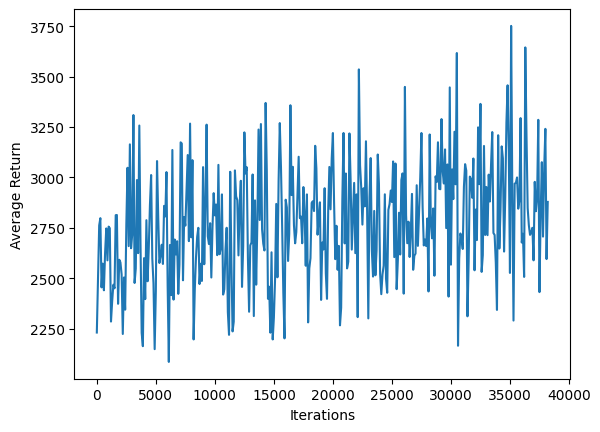

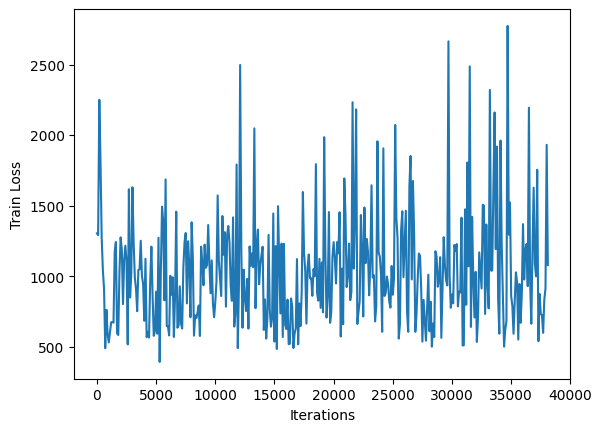

********************ITERATION NUMBER #38200
********************ITERATION NUMBER #38201
********************ITERATION NUMBER #38202
********************ITERATION NUMBER #38203
********************ITERATION NUMBER #38204
********************ITERATION NUMBER #38205
********************ITERATION NUMBER #38206
********************ITERATION NUMBER #38207
********************ITERATION NUMBER #38208
********************ITERATION NUMBER #38209
********************ITERATION NUMBER #38210
********************ITERATION NUMBER #38211
********************ITERATION NUMBER #38212
********************ITERATION NUMBER #38213
********************ITERATION NUMBER #38214
********************ITERATION NUMBER #38215
********************ITERATION NUMBER #38216
********************ITERATION NUMBER #38217
********************ITERATION NUMBER #38218
********************ITERATION NUMBER #38219
********************ITERATION NUMBER #38220
********************ITERATION NUMBER #38221
********************ITERATION NU

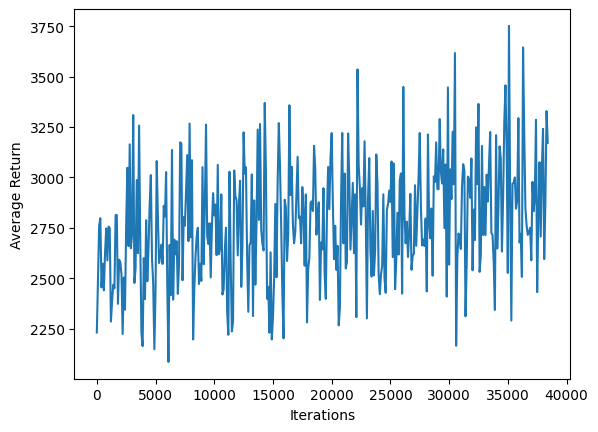

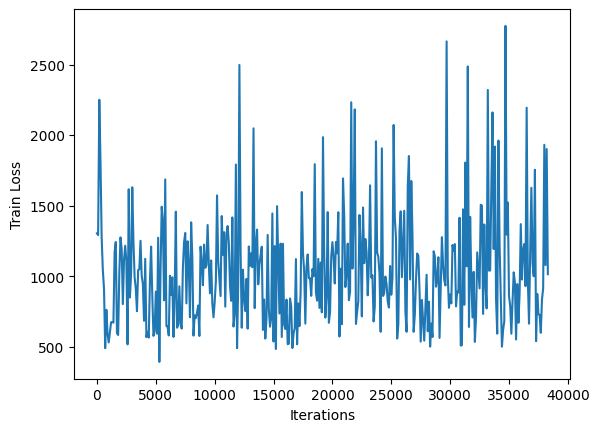

********************ITERATION NUMBER #38400
********************ITERATION NUMBER #38401
********************ITERATION NUMBER #38402
********************ITERATION NUMBER #38403
********************ITERATION NUMBER #38404
********************ITERATION NUMBER #38405
********************ITERATION NUMBER #38406
********************ITERATION NUMBER #38407
********************ITERATION NUMBER #38408
********************ITERATION NUMBER #38409
********************ITERATION NUMBER #38410
********************ITERATION NUMBER #38411
********************ITERATION NUMBER #38412
********************ITERATION NUMBER #38413
********************ITERATION NUMBER #38414
********************ITERATION NUMBER #38415
********************ITERATION NUMBER #38416
********************ITERATION NUMBER #38417
********************ITERATION NUMBER #38418
********************ITERATION NUMBER #38419
********************ITERATION NUMBER #38420
********************ITERATION NUMBER #38421
********************ITERATION NU

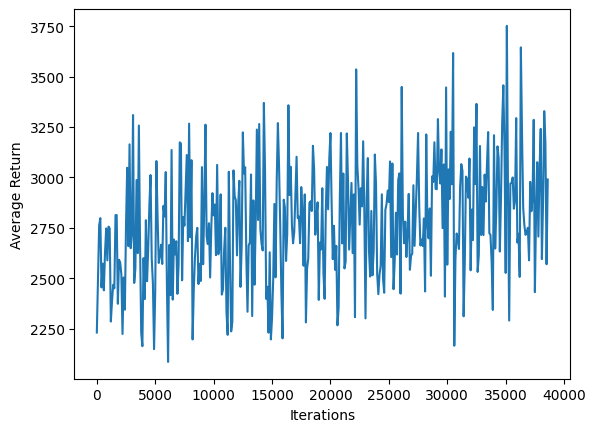

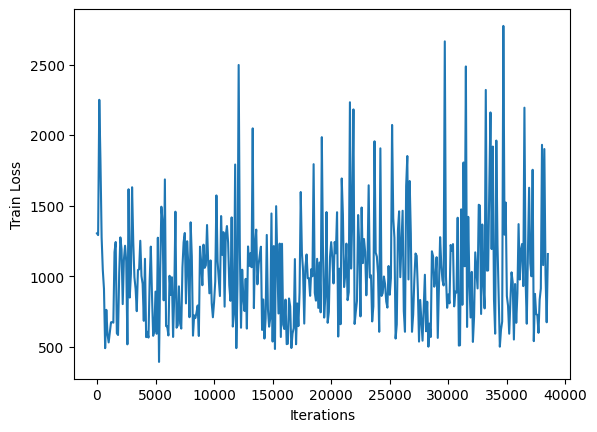

********************ITERATION NUMBER #38600
********************ITERATION NUMBER #38601
********************ITERATION NUMBER #38602
********************ITERATION NUMBER #38603
********************ITERATION NUMBER #38604
********************ITERATION NUMBER #38605
********************ITERATION NUMBER #38606
********************ITERATION NUMBER #38607
********************ITERATION NUMBER #38608
********************ITERATION NUMBER #38609
********************ITERATION NUMBER #38610
********************ITERATION NUMBER #38611
********************ITERATION NUMBER #38612
********************ITERATION NUMBER #38613
********************ITERATION NUMBER #38614
********************ITERATION NUMBER #38615
********************ITERATION NUMBER #38616
********************ITERATION NUMBER #38617
********************ITERATION NUMBER #38618
********************ITERATION NUMBER #38619
********************ITERATION NUMBER #38620
********************ITERATION NUMBER #38621
********************ITERATION NU

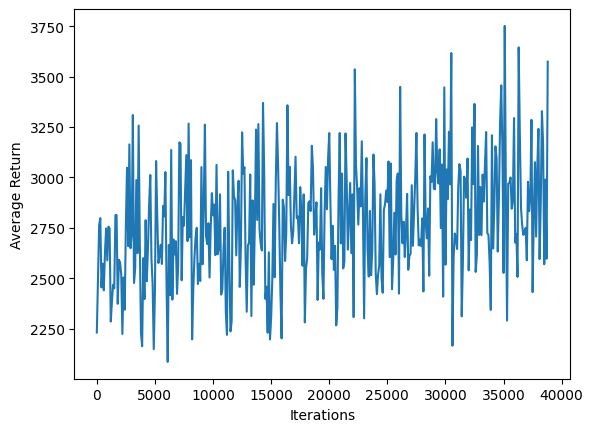

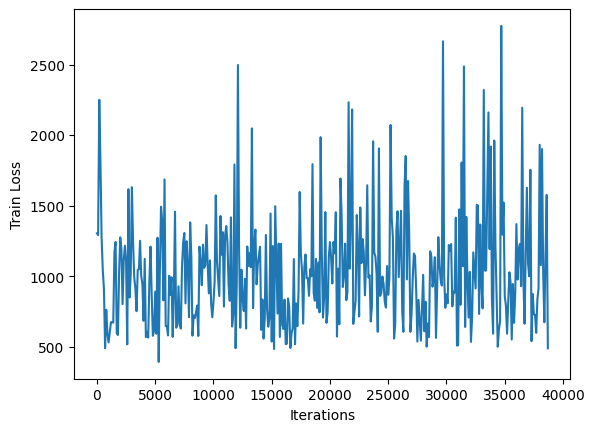

********************ITERATION NUMBER #38800
********************ITERATION NUMBER #38801
********************ITERATION NUMBER #38802
********************ITERATION NUMBER #38803
********************ITERATION NUMBER #38804
********************ITERATION NUMBER #38805
********************ITERATION NUMBER #38806
********************ITERATION NUMBER #38807
********************ITERATION NUMBER #38808
********************ITERATION NUMBER #38809
********************ITERATION NUMBER #38810
********************ITERATION NUMBER #38811
********************ITERATION NUMBER #38812
********************ITERATION NUMBER #38813
********************ITERATION NUMBER #38814
********************ITERATION NUMBER #38815
********************ITERATION NUMBER #38816
********************ITERATION NUMBER #38817
********************ITERATION NUMBER #38818
********************ITERATION NUMBER #38819
********************ITERATION NUMBER #38820
********************ITERATION NUMBER #38821
********************ITERATION NU

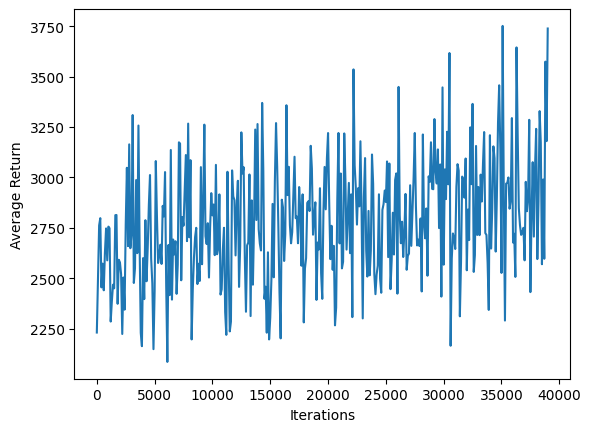

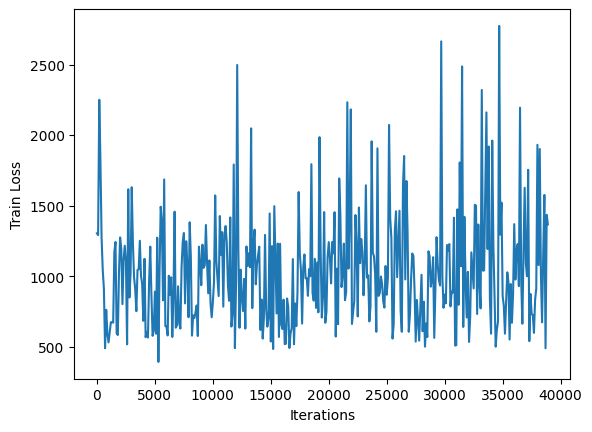

********************ITERATION NUMBER #39000
********************ITERATION NUMBER #39001
********************ITERATION NUMBER #39002
********************ITERATION NUMBER #39003
********************ITERATION NUMBER #39004
********************ITERATION NUMBER #39005
********************ITERATION NUMBER #39006
********************ITERATION NUMBER #39007
********************ITERATION NUMBER #39008
********************ITERATION NUMBER #39009
********************ITERATION NUMBER #39010
********************ITERATION NUMBER #39011
********************ITERATION NUMBER #39012
********************ITERATION NUMBER #39013
********************ITERATION NUMBER #39014
********************ITERATION NUMBER #39015
********************ITERATION NUMBER #39016
********************ITERATION NUMBER #39017
********************ITERATION NUMBER #39018
********************ITERATION NUMBER #39019
********************ITERATION NUMBER #39020
********************ITERATION NUMBER #39021
********************ITERATION NU

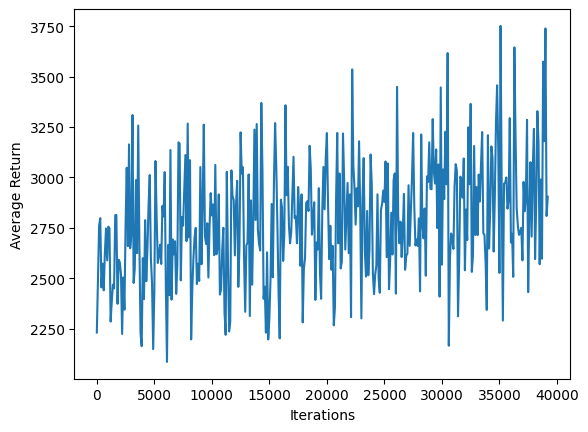

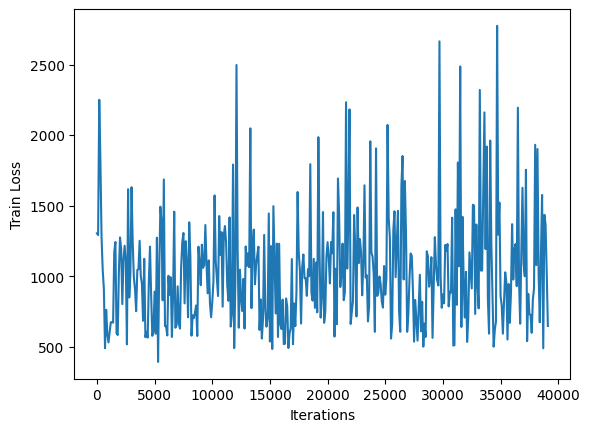

********************ITERATION NUMBER #39200
********************ITERATION NUMBER #39201
********************ITERATION NUMBER #39202
********************ITERATION NUMBER #39203
********************ITERATION NUMBER #39204
********************ITERATION NUMBER #39205
********************ITERATION NUMBER #39206
********************ITERATION NUMBER #39207
********************ITERATION NUMBER #39208
********************ITERATION NUMBER #39209
********************ITERATION NUMBER #39210
********************ITERATION NUMBER #39211
********************ITERATION NUMBER #39212
********************ITERATION NUMBER #39213
********************ITERATION NUMBER #39214
********************ITERATION NUMBER #39215
********************ITERATION NUMBER #39216
********************ITERATION NUMBER #39217
********************ITERATION NUMBER #39218
********************ITERATION NUMBER #39219
********************ITERATION NUMBER #39220
********************ITERATION NUMBER #39221
********************ITERATION NU

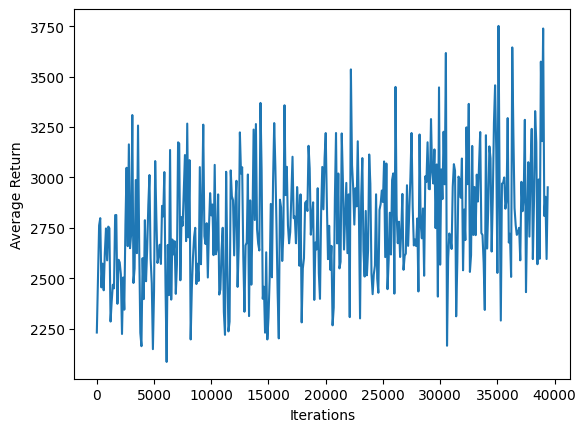

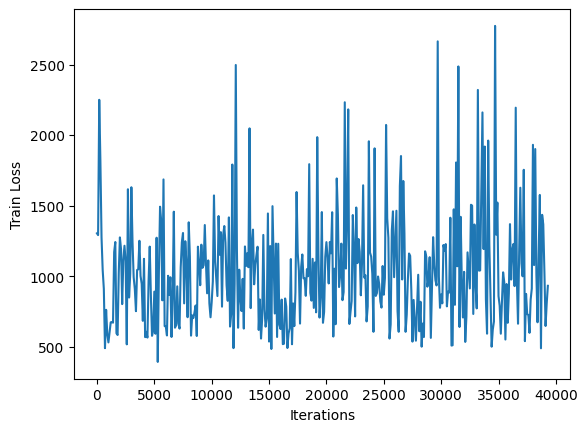

********************ITERATION NUMBER #39400
********************ITERATION NUMBER #39401
********************ITERATION NUMBER #39402
********************ITERATION NUMBER #39403
********************ITERATION NUMBER #39404
********************ITERATION NUMBER #39405
********************ITERATION NUMBER #39406
********************ITERATION NUMBER #39407
********************ITERATION NUMBER #39408
********************ITERATION NUMBER #39409
********************ITERATION NUMBER #39410
********************ITERATION NUMBER #39411
********************ITERATION NUMBER #39412
********************ITERATION NUMBER #39413
********************ITERATION NUMBER #39414
********************ITERATION NUMBER #39415
********************ITERATION NUMBER #39416
********************ITERATION NUMBER #39417
********************ITERATION NUMBER #39418
********************ITERATION NUMBER #39419
********************ITERATION NUMBER #39420
********************ITERATION NUMBER #39421
********************ITERATION NU

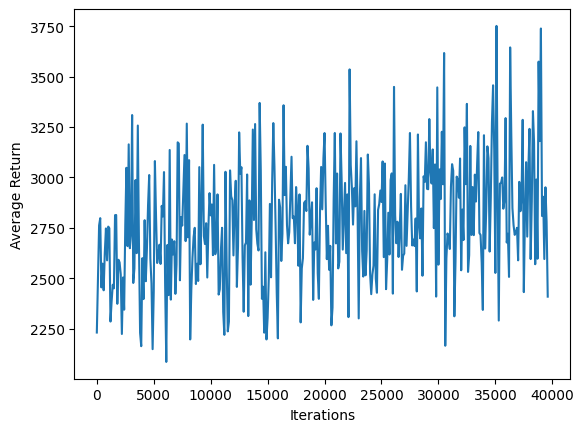

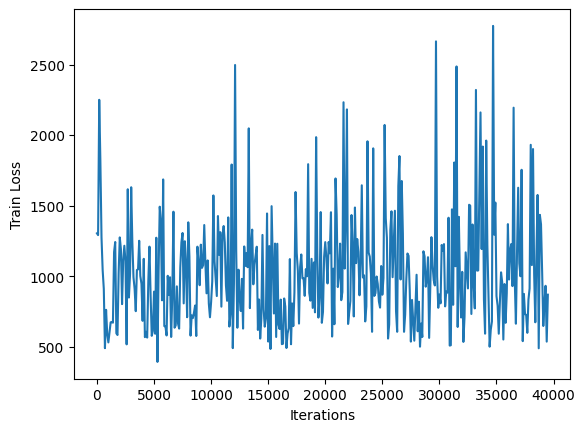

********************ITERATION NUMBER #39600
********************ITERATION NUMBER #39601
********************ITERATION NUMBER #39602
********************ITERATION NUMBER #39603
********************ITERATION NUMBER #39604
********************ITERATION NUMBER #39605
********************ITERATION NUMBER #39606
********************ITERATION NUMBER #39607
********************ITERATION NUMBER #39608
********************ITERATION NUMBER #39609
********************ITERATION NUMBER #39610
********************ITERATION NUMBER #39611
********************ITERATION NUMBER #39612
********************ITERATION NUMBER #39613
********************ITERATION NUMBER #39614
********************ITERATION NUMBER #39615
********************ITERATION NUMBER #39616
********************ITERATION NUMBER #39617
********************ITERATION NUMBER #39618
********************ITERATION NUMBER #39619
********************ITERATION NUMBER #39620
********************ITERATION NUMBER #39621
********************ITERATION NU

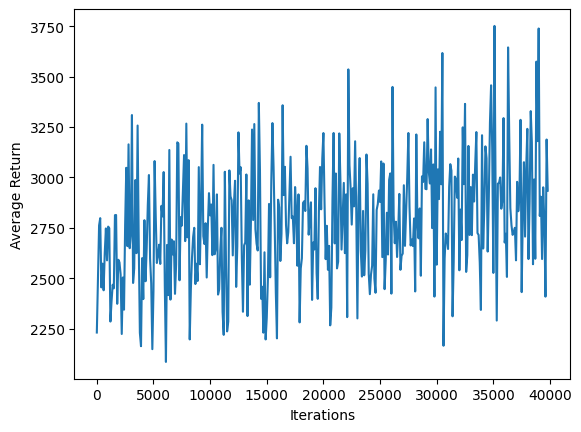

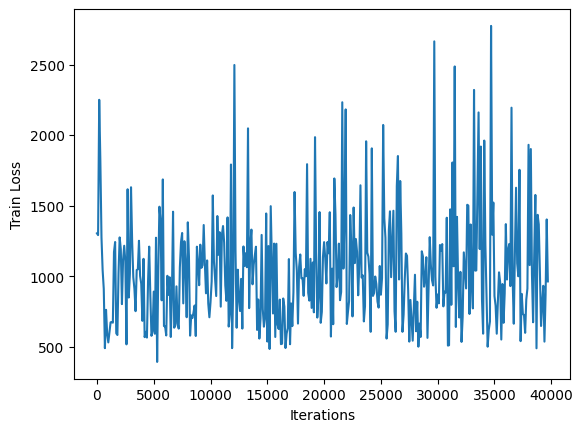

********************ITERATION NUMBER #39800
********************ITERATION NUMBER #39801
********************ITERATION NUMBER #39802
********************ITERATION NUMBER #39803
********************ITERATION NUMBER #39804
********************ITERATION NUMBER #39805
********************ITERATION NUMBER #39806
********************ITERATION NUMBER #39807
********************ITERATION NUMBER #39808
********************ITERATION NUMBER #39809
********************ITERATION NUMBER #39810
********************ITERATION NUMBER #39811
********************ITERATION NUMBER #39812
********************ITERATION NUMBER #39813
********************ITERATION NUMBER #39814
********************ITERATION NUMBER #39815
********************ITERATION NUMBER #39816
********************ITERATION NUMBER #39817
********************ITERATION NUMBER #39818
********************ITERATION NUMBER #39819
********************ITERATION NUMBER #39820
********************ITERATION NUMBER #39821
********************ITERATION NU

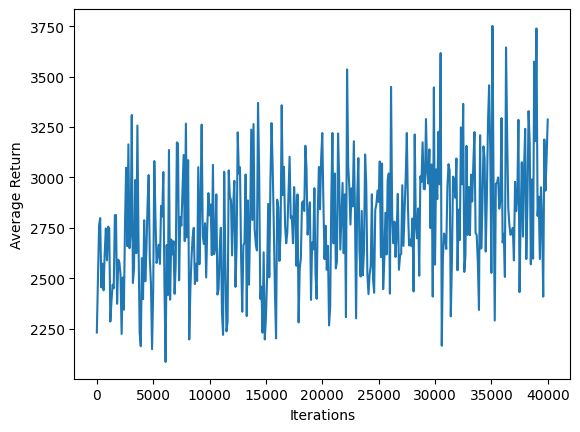

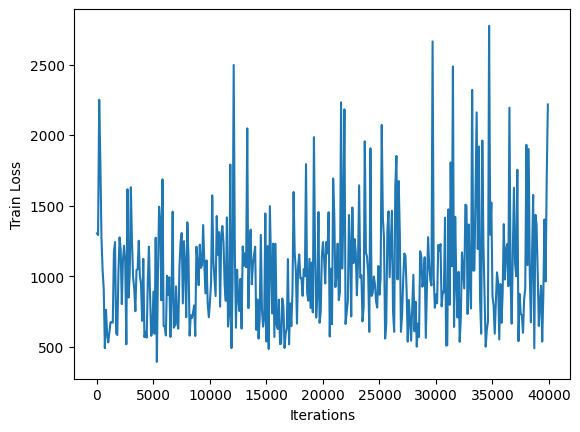

********************ITERATION NUMBER #40000
********************ITERATION NUMBER #40001
********************ITERATION NUMBER #40002
********************ITERATION NUMBER #40003
********************ITERATION NUMBER #40004
********************ITERATION NUMBER #40005
********************ITERATION NUMBER #40006
********************ITERATION NUMBER #40007
********************ITERATION NUMBER #40008
********************ITERATION NUMBER #40009
********************ITERATION NUMBER #40010
********************ITERATION NUMBER #40011
********************ITERATION NUMBER #40012
********************ITERATION NUMBER #40013
********************ITERATION NUMBER #40014
********************ITERATION NUMBER #40015
********************ITERATION NUMBER #40016
********************ITERATION NUMBER #40017
********************ITERATION NUMBER #40018
********************ITERATION NUMBER #40019
********************ITERATION NUMBER #40020
********************ITERATION NUMBER #40021
********************ITERATION NU

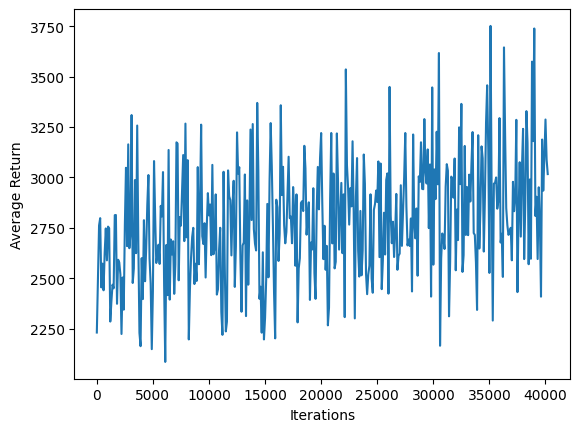

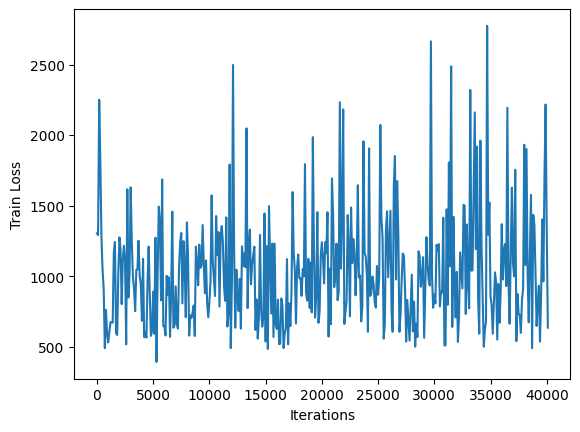

********************ITERATION NUMBER #40200
********************ITERATION NUMBER #40201
********************ITERATION NUMBER #40202
********************ITERATION NUMBER #40203
********************ITERATION NUMBER #40204
********************ITERATION NUMBER #40205
********************ITERATION NUMBER #40206
********************ITERATION NUMBER #40207
********************ITERATION NUMBER #40208
********************ITERATION NUMBER #40209
********************ITERATION NUMBER #40210
********************ITERATION NUMBER #40211
********************ITERATION NUMBER #40212
********************ITERATION NUMBER #40213
********************ITERATION NUMBER #40214
********************ITERATION NUMBER #40215
********************ITERATION NUMBER #40216
********************ITERATION NUMBER #40217
********************ITERATION NUMBER #40218
********************ITERATION NUMBER #40219
********************ITERATION NUMBER #40220
********************ITERATION NUMBER #40221
********************ITERATION NU

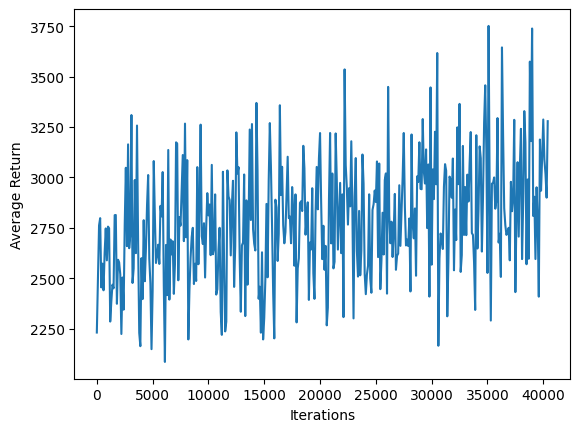

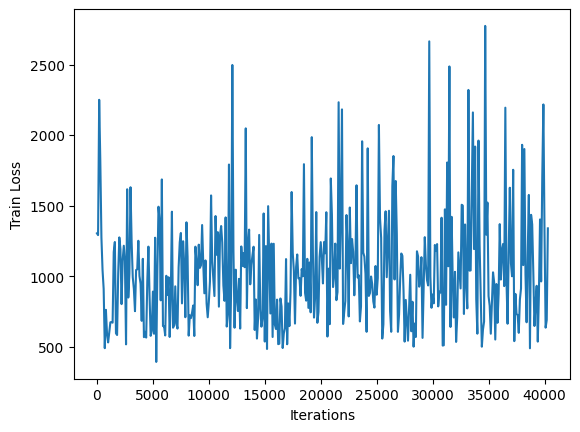

********************ITERATION NUMBER #40400
********************ITERATION NUMBER #40401
********************ITERATION NUMBER #40402
********************ITERATION NUMBER #40403
********************ITERATION NUMBER #40404
********************ITERATION NUMBER #40405
********************ITERATION NUMBER #40406
********************ITERATION NUMBER #40407
********************ITERATION NUMBER #40408
********************ITERATION NUMBER #40409
********************ITERATION NUMBER #40410
********************ITERATION NUMBER #40411
********************ITERATION NUMBER #40412
********************ITERATION NUMBER #40413
********************ITERATION NUMBER #40414
********************ITERATION NUMBER #40415
********************ITERATION NUMBER #40416
********************ITERATION NUMBER #40417
********************ITERATION NUMBER #40418
********************ITERATION NUMBER #40419
********************ITERATION NUMBER #40420
********************ITERATION NUMBER #40421
********************ITERATION NU

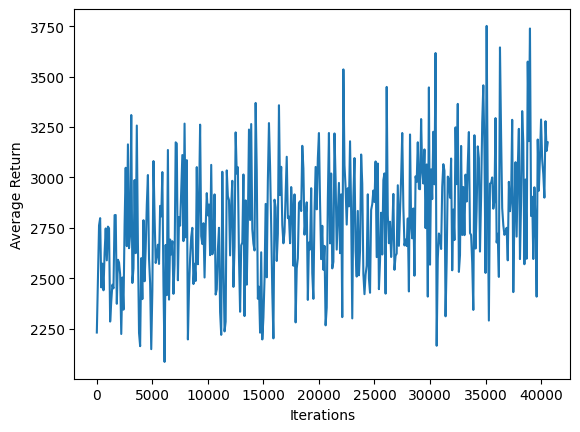

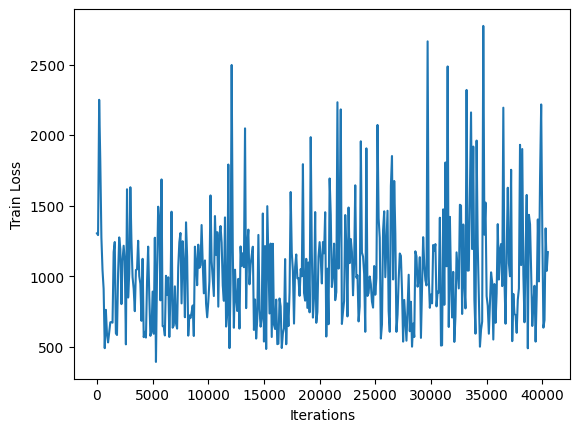

********************ITERATION NUMBER #40600
********************ITERATION NUMBER #40601
********************ITERATION NUMBER #40602
********************ITERATION NUMBER #40603
********************ITERATION NUMBER #40604
********************ITERATION NUMBER #40605
********************ITERATION NUMBER #40606
********************ITERATION NUMBER #40607
********************ITERATION NUMBER #40608
********************ITERATION NUMBER #40609
********************ITERATION NUMBER #40610
********************ITERATION NUMBER #40611
********************ITERATION NUMBER #40612
********************ITERATION NUMBER #40613
********************ITERATION NUMBER #40614
********************ITERATION NUMBER #40615
********************ITERATION NUMBER #40616
********************ITERATION NUMBER #40617
********************ITERATION NUMBER #40618
********************ITERATION NUMBER #40619
********************ITERATION NUMBER #40620
********************ITERATION NUMBER #40621
********************ITERATION NU

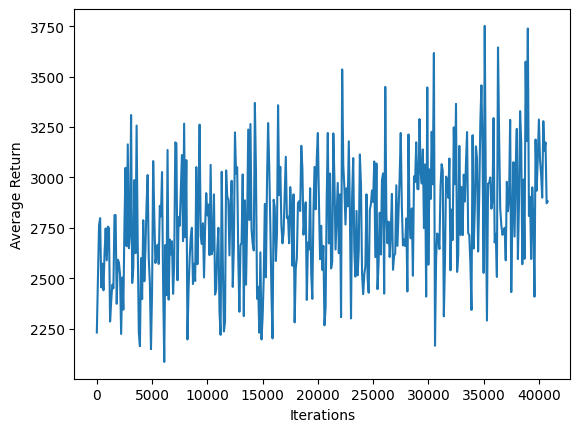

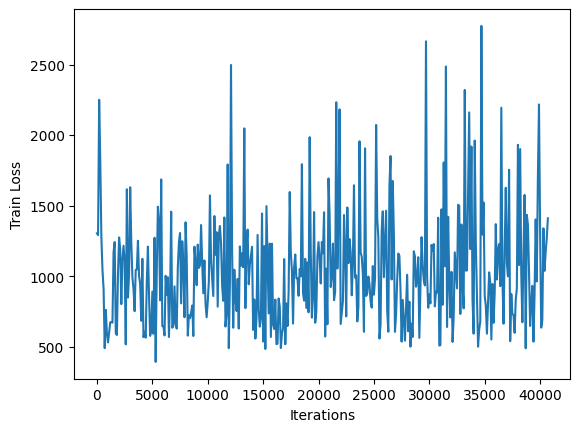

********************ITERATION NUMBER #40800
********************ITERATION NUMBER #40801
********************ITERATION NUMBER #40802
********************ITERATION NUMBER #40803
********************ITERATION NUMBER #40804
********************ITERATION NUMBER #40805
********************ITERATION NUMBER #40806
********************ITERATION NUMBER #40807
********************ITERATION NUMBER #40808
********************ITERATION NUMBER #40809
********************ITERATION NUMBER #40810
********************ITERATION NUMBER #40811
********************ITERATION NUMBER #40812
********************ITERATION NUMBER #40813
********************ITERATION NUMBER #40814
********************ITERATION NUMBER #40815
********************ITERATION NUMBER #40816
********************ITERATION NUMBER #40817
********************ITERATION NUMBER #40818
********************ITERATION NUMBER #40819
********************ITERATION NUMBER #40820
********************ITERATION NUMBER #40821
********************ITERATION NU

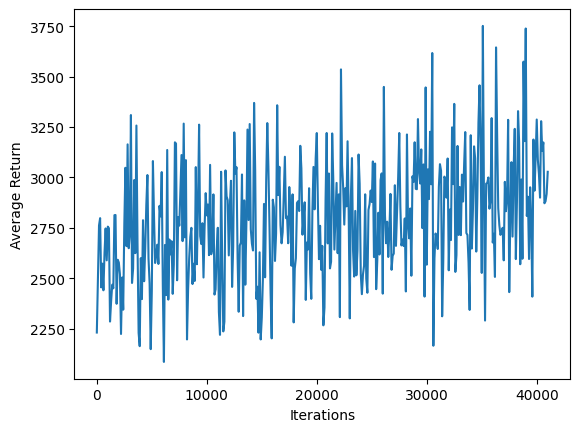

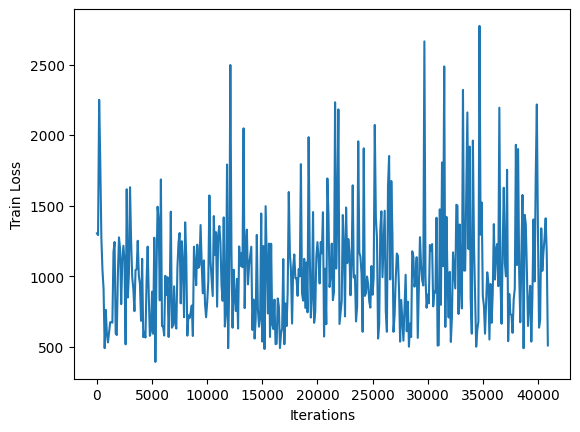

********************ITERATION NUMBER #41000
********************ITERATION NUMBER #41001
********************ITERATION NUMBER #41002
********************ITERATION NUMBER #41003
********************ITERATION NUMBER #41004
********************ITERATION NUMBER #41005
********************ITERATION NUMBER #41006
********************ITERATION NUMBER #41007
********************ITERATION NUMBER #41008
********************ITERATION NUMBER #41009
********************ITERATION NUMBER #41010
********************ITERATION NUMBER #41011
********************ITERATION NUMBER #41012
********************ITERATION NUMBER #41013
********************ITERATION NUMBER #41014
********************ITERATION NUMBER #41015
********************ITERATION NUMBER #41016
********************ITERATION NUMBER #41017
********************ITERATION NUMBER #41018
********************ITERATION NUMBER #41019
********************ITERATION NUMBER #41020
********************ITERATION NUMBER #41021
********************ITERATION NU

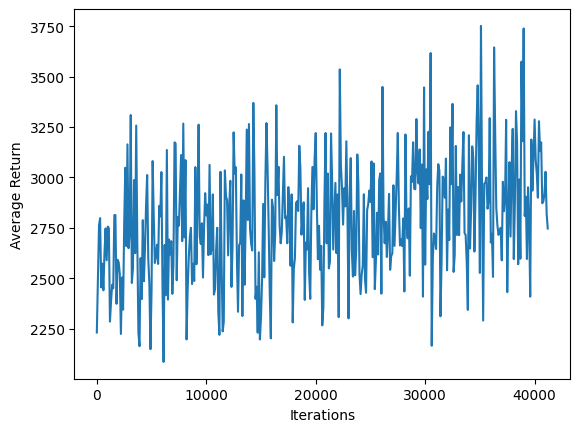

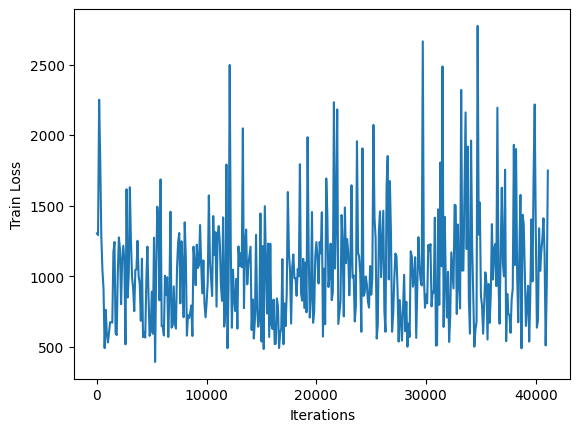

********************ITERATION NUMBER #41200
********************ITERATION NUMBER #41201
********************ITERATION NUMBER #41202
********************ITERATION NUMBER #41203
********************ITERATION NUMBER #41204
********************ITERATION NUMBER #41205
********************ITERATION NUMBER #41206
********************ITERATION NUMBER #41207
********************ITERATION NUMBER #41208
********************ITERATION NUMBER #41209
********************ITERATION NUMBER #41210
********************ITERATION NUMBER #41211
********************ITERATION NUMBER #41212
********************ITERATION NUMBER #41213
********************ITERATION NUMBER #41214
********************ITERATION NUMBER #41215
********************ITERATION NUMBER #41216
********************ITERATION NUMBER #41217
********************ITERATION NUMBER #41218
********************ITERATION NUMBER #41219
********************ITERATION NUMBER #41220
********************ITERATION NUMBER #41221
********************ITERATION NU

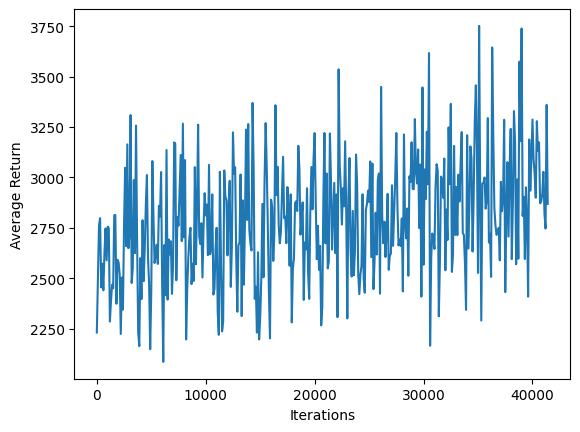

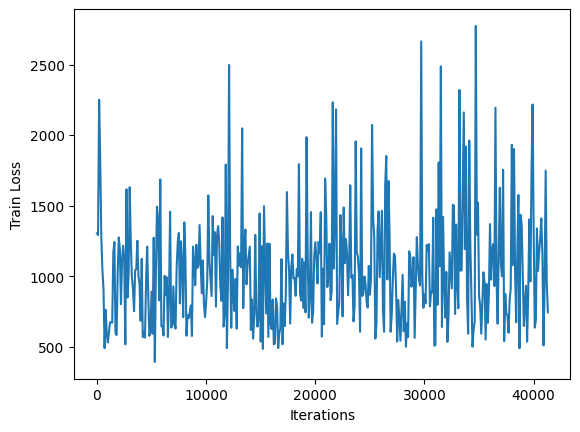

********************ITERATION NUMBER #41400
********************ITERATION NUMBER #41401
********************ITERATION NUMBER #41402
********************ITERATION NUMBER #41403
********************ITERATION NUMBER #41404
********************ITERATION NUMBER #41405
********************ITERATION NUMBER #41406
********************ITERATION NUMBER #41407
********************ITERATION NUMBER #41408
********************ITERATION NUMBER #41409
********************ITERATION NUMBER #41410
********************ITERATION NUMBER #41411
********************ITERATION NUMBER #41412
********************ITERATION NUMBER #41413
********************ITERATION NUMBER #41414
********************ITERATION NUMBER #41415
********************ITERATION NUMBER #41416
********************ITERATION NUMBER #41417
********************ITERATION NUMBER #41418
********************ITERATION NUMBER #41419
********************ITERATION NUMBER #41420
********************ITERATION NUMBER #41421
********************ITERATION NU

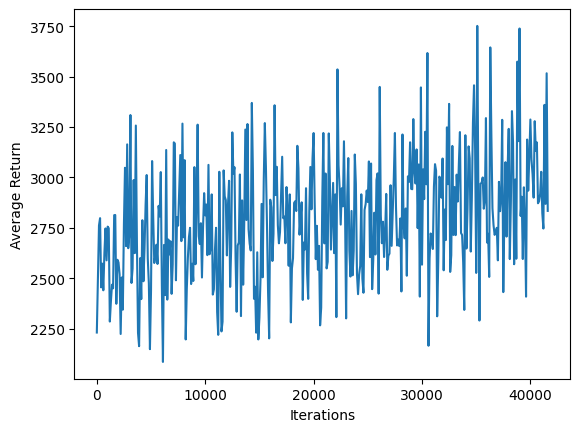

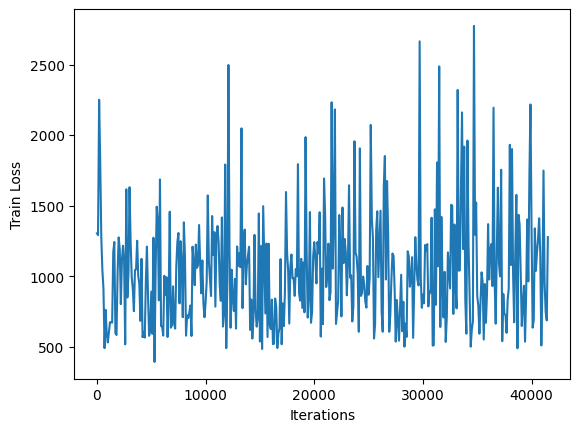

********************ITERATION NUMBER #41600
********************ITERATION NUMBER #41601
********************ITERATION NUMBER #41602
********************ITERATION NUMBER #41603
********************ITERATION NUMBER #41604
********************ITERATION NUMBER #41605
********************ITERATION NUMBER #41606
********************ITERATION NUMBER #41607
********************ITERATION NUMBER #41608
********************ITERATION NUMBER #41609
********************ITERATION NUMBER #41610
********************ITERATION NUMBER #41611
********************ITERATION NUMBER #41612
********************ITERATION NUMBER #41613
********************ITERATION NUMBER #41614
********************ITERATION NUMBER #41615
********************ITERATION NUMBER #41616
********************ITERATION NUMBER #41617
********************ITERATION NUMBER #41618
********************ITERATION NUMBER #41619
********************ITERATION NUMBER #41620
********************ITERATION NUMBER #41621
********************ITERATION NU

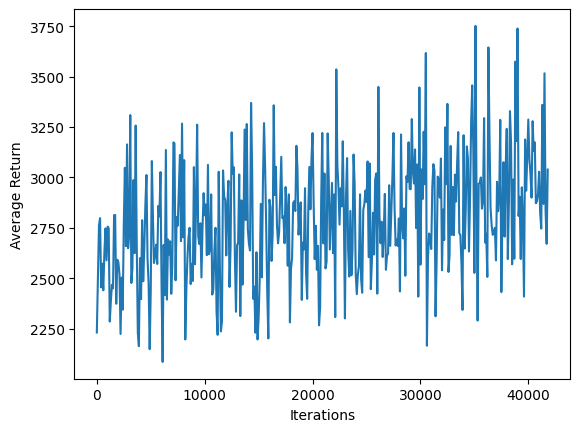

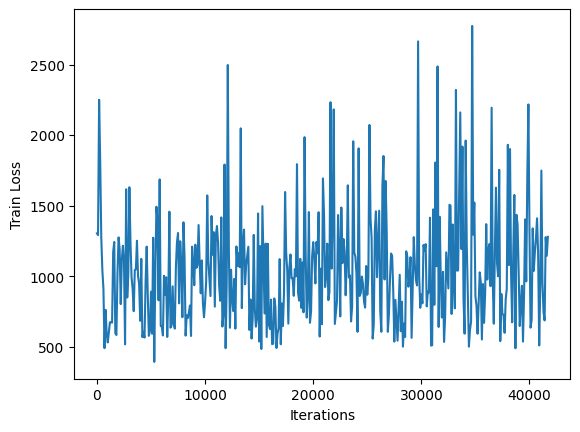

********************ITERATION NUMBER #41800
********************ITERATION NUMBER #41801
********************ITERATION NUMBER #41802
********************ITERATION NUMBER #41803
********************ITERATION NUMBER #41804
********************ITERATION NUMBER #41805
********************ITERATION NUMBER #41806
********************ITERATION NUMBER #41807
********************ITERATION NUMBER #41808
********************ITERATION NUMBER #41809
********************ITERATION NUMBER #41810
********************ITERATION NUMBER #41811
********************ITERATION NUMBER #41812
********************ITERATION NUMBER #41813
********************ITERATION NUMBER #41814
********************ITERATION NUMBER #41815
********************ITERATION NUMBER #41816
********************ITERATION NUMBER #41817
********************ITERATION NUMBER #41818
********************ITERATION NUMBER #41819
********************ITERATION NUMBER #41820
********************ITERATION NUMBER #41821
********************ITERATION NU

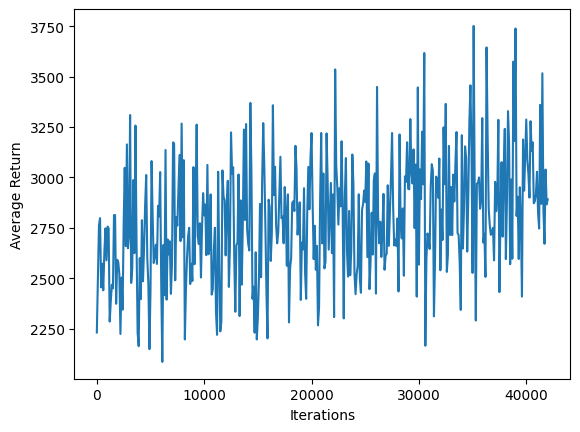

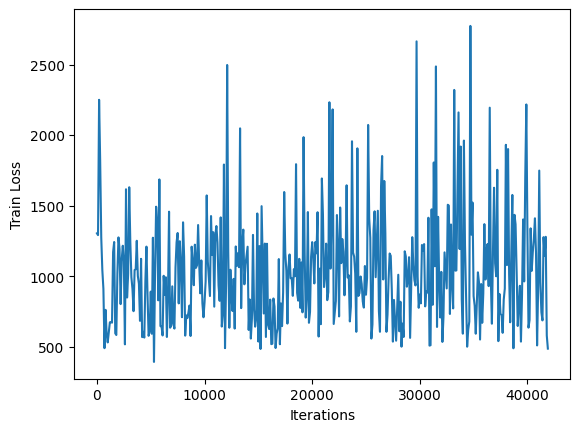

********************ITERATION NUMBER #42000
********************ITERATION NUMBER #42001
********************ITERATION NUMBER #42002
********************ITERATION NUMBER #42003
********************ITERATION NUMBER #42004
********************ITERATION NUMBER #42005
********************ITERATION NUMBER #42006
********************ITERATION NUMBER #42007
********************ITERATION NUMBER #42008
********************ITERATION NUMBER #42009
********************ITERATION NUMBER #42010
********************ITERATION NUMBER #42011
********************ITERATION NUMBER #42012
********************ITERATION NUMBER #42013
********************ITERATION NUMBER #42014
********************ITERATION NUMBER #42015
********************ITERATION NUMBER #42016
********************ITERATION NUMBER #42017
********************ITERATION NUMBER #42018
********************ITERATION NUMBER #42019
********************ITERATION NUMBER #42020
********************ITERATION NUMBER #42021
********************ITERATION NU

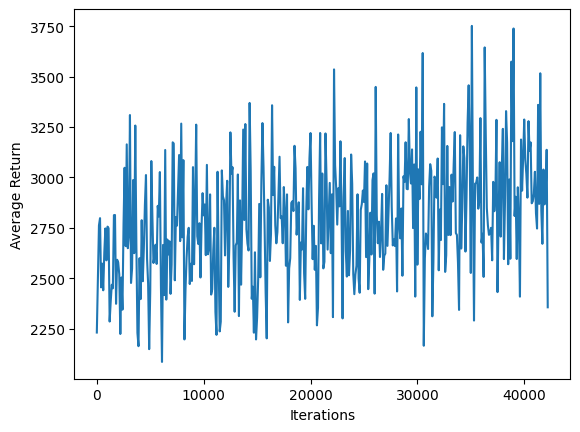

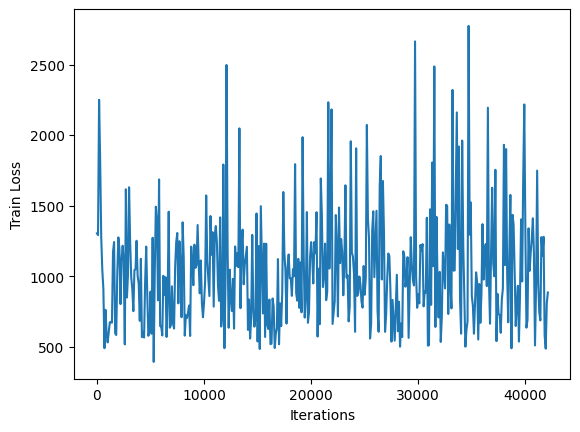

********************ITERATION NUMBER #42200
********************ITERATION NUMBER #42201
********************ITERATION NUMBER #42202
********************ITERATION NUMBER #42203
********************ITERATION NUMBER #42204
********************ITERATION NUMBER #42205
********************ITERATION NUMBER #42206
********************ITERATION NUMBER #42207
********************ITERATION NUMBER #42208
********************ITERATION NUMBER #42209
********************ITERATION NUMBER #42210
********************ITERATION NUMBER #42211
********************ITERATION NUMBER #42212
********************ITERATION NUMBER #42213
********************ITERATION NUMBER #42214
********************ITERATION NUMBER #42215
********************ITERATION NUMBER #42216
********************ITERATION NUMBER #42217
********************ITERATION NUMBER #42218
********************ITERATION NUMBER #42219
********************ITERATION NUMBER #42220
********************ITERATION NUMBER #42221
********************ITERATION NU

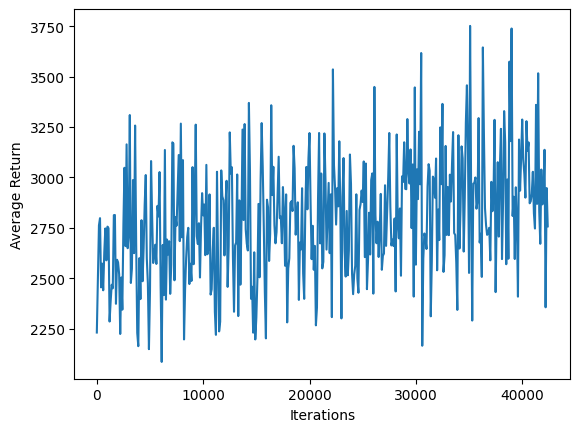

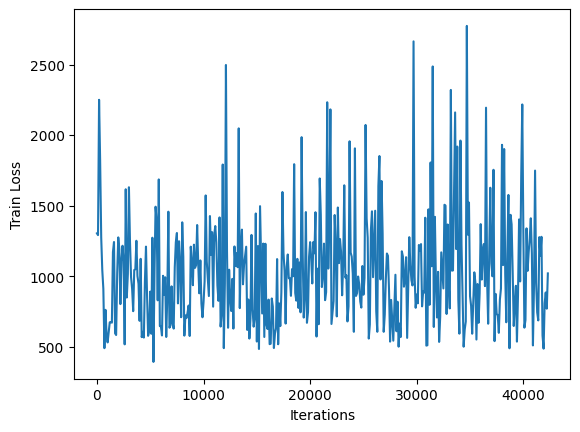

********************ITERATION NUMBER #42400
********************ITERATION NUMBER #42401
********************ITERATION NUMBER #42402
********************ITERATION NUMBER #42403
********************ITERATION NUMBER #42404
********************ITERATION NUMBER #42405
********************ITERATION NUMBER #42406
********************ITERATION NUMBER #42407
********************ITERATION NUMBER #42408
********************ITERATION NUMBER #42409
********************ITERATION NUMBER #42410
********************ITERATION NUMBER #42411
********************ITERATION NUMBER #42412
********************ITERATION NUMBER #42413
********************ITERATION NUMBER #42414
********************ITERATION NUMBER #42415
********************ITERATION NUMBER #42416
********************ITERATION NUMBER #42417
********************ITERATION NUMBER #42418
********************ITERATION NUMBER #42419
********************ITERATION NUMBER #42420
********************ITERATION NUMBER #42421
********************ITERATION NU

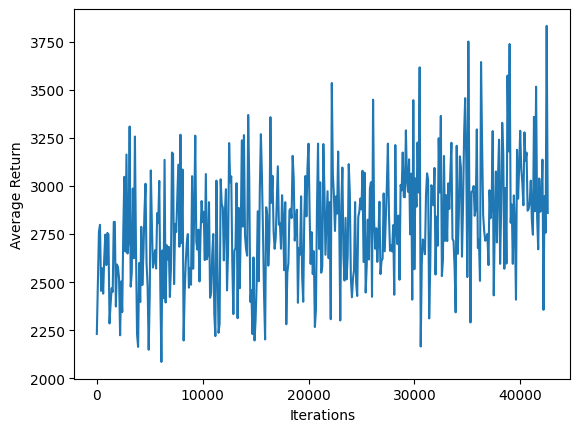

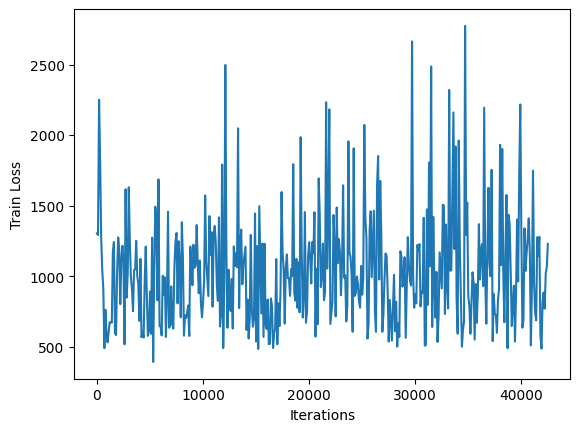

********************ITERATION NUMBER #42600
********************ITERATION NUMBER #42601
********************ITERATION NUMBER #42602
********************ITERATION NUMBER #42603
********************ITERATION NUMBER #42604
********************ITERATION NUMBER #42605
********************ITERATION NUMBER #42606
********************ITERATION NUMBER #42607
********************ITERATION NUMBER #42608
********************ITERATION NUMBER #42609
********************ITERATION NUMBER #42610
********************ITERATION NUMBER #42611
********************ITERATION NUMBER #42612
********************ITERATION NUMBER #42613
********************ITERATION NUMBER #42614
********************ITERATION NUMBER #42615
********************ITERATION NUMBER #42616
********************ITERATION NUMBER #42617
********************ITERATION NUMBER #42618
********************ITERATION NUMBER #42619
********************ITERATION NUMBER #42620
********************ITERATION NUMBER #42621
********************ITERATION NU

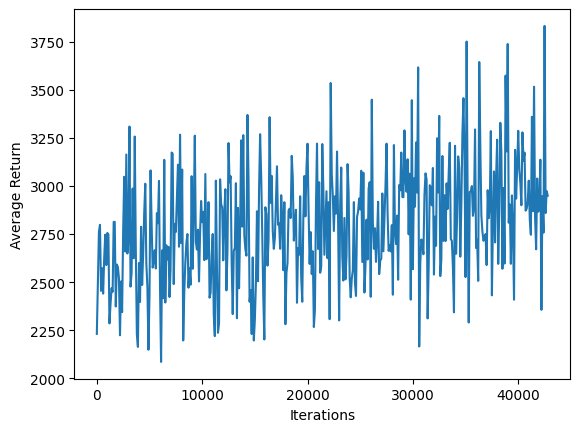

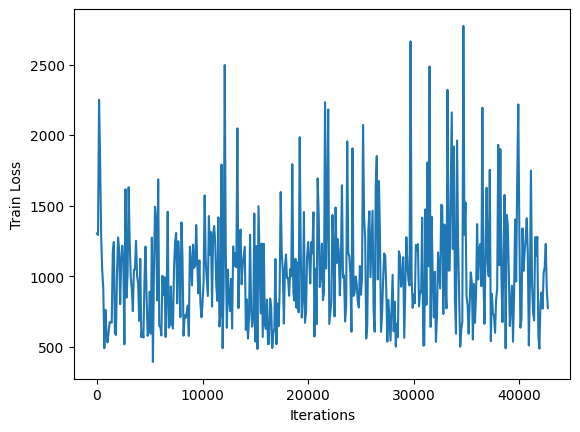

********************ITERATION NUMBER #42800
********************ITERATION NUMBER #42801
********************ITERATION NUMBER #42802
********************ITERATION NUMBER #42803
********************ITERATION NUMBER #42804
********************ITERATION NUMBER #42805
********************ITERATION NUMBER #42806
********************ITERATION NUMBER #42807
********************ITERATION NUMBER #42808
********************ITERATION NUMBER #42809
********************ITERATION NUMBER #42810
********************ITERATION NUMBER #42811
********************ITERATION NUMBER #42812
********************ITERATION NUMBER #42813
********************ITERATION NUMBER #42814
********************ITERATION NUMBER #42815
********************ITERATION NUMBER #42816
********************ITERATION NUMBER #42817
********************ITERATION NUMBER #42818
********************ITERATION NUMBER #42819
********************ITERATION NUMBER #42820
********************ITERATION NUMBER #42821
********************ITERATION NU

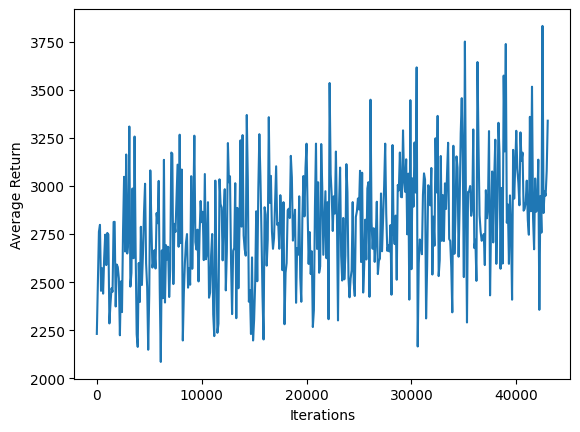

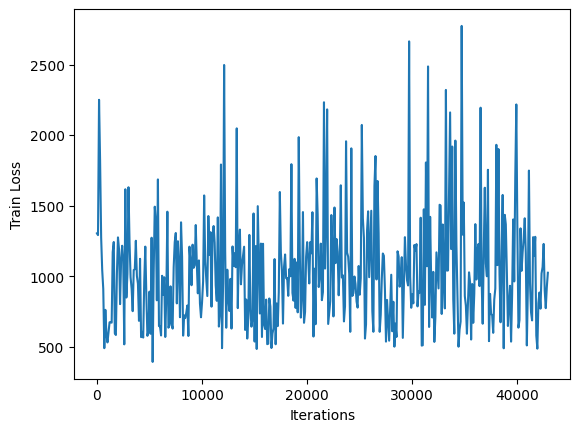

********************ITERATION NUMBER #43000
********************ITERATION NUMBER #43001
********************ITERATION NUMBER #43002
********************ITERATION NUMBER #43003
********************ITERATION NUMBER #43004
********************ITERATION NUMBER #43005
********************ITERATION NUMBER #43006
********************ITERATION NUMBER #43007
********************ITERATION NUMBER #43008
********************ITERATION NUMBER #43009
********************ITERATION NUMBER #43010
********************ITERATION NUMBER #43011
********************ITERATION NUMBER #43012
********************ITERATION NUMBER #43013
********************ITERATION NUMBER #43014
********************ITERATION NUMBER #43015
********************ITERATION NUMBER #43016
********************ITERATION NUMBER #43017
********************ITERATION NUMBER #43018
********************ITERATION NUMBER #43019
********************ITERATION NUMBER #43020
********************ITERATION NUMBER #43021
********************ITERATION NU

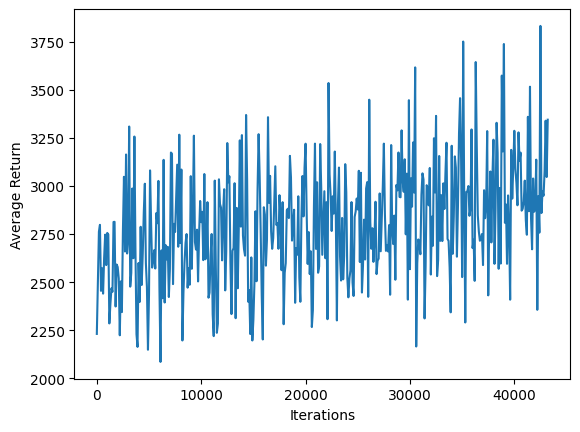

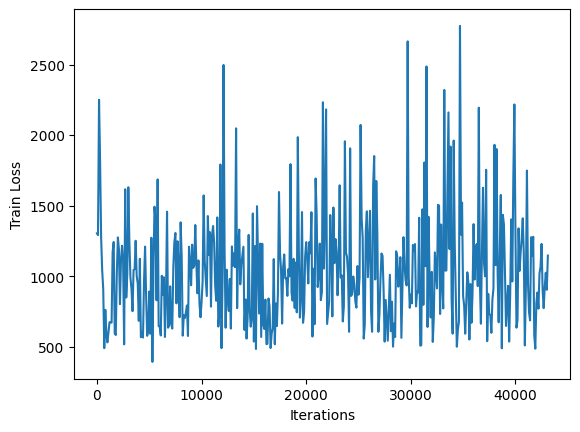

********************ITERATION NUMBER #43200
********************ITERATION NUMBER #43201
********************ITERATION NUMBER #43202
********************ITERATION NUMBER #43203
********************ITERATION NUMBER #43204
********************ITERATION NUMBER #43205
********************ITERATION NUMBER #43206
********************ITERATION NUMBER #43207
********************ITERATION NUMBER #43208
********************ITERATION NUMBER #43209
********************ITERATION NUMBER #43210
********************ITERATION NUMBER #43211
********************ITERATION NUMBER #43212
********************ITERATION NUMBER #43213
********************ITERATION NUMBER #43214
********************ITERATION NUMBER #43215
********************ITERATION NUMBER #43216
********************ITERATION NUMBER #43217
********************ITERATION NUMBER #43218
********************ITERATION NUMBER #43219
********************ITERATION NUMBER #43220
********************ITERATION NUMBER #43221
********************ITERATION NU

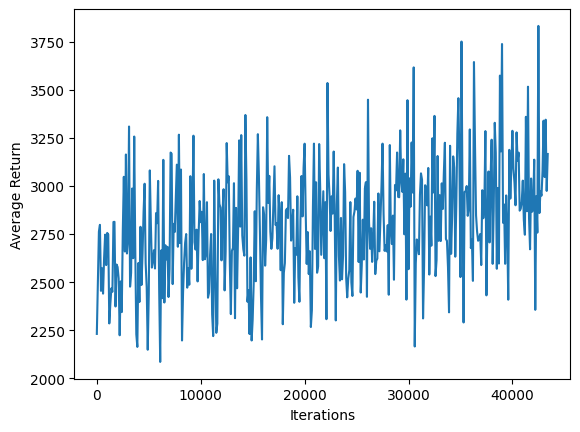

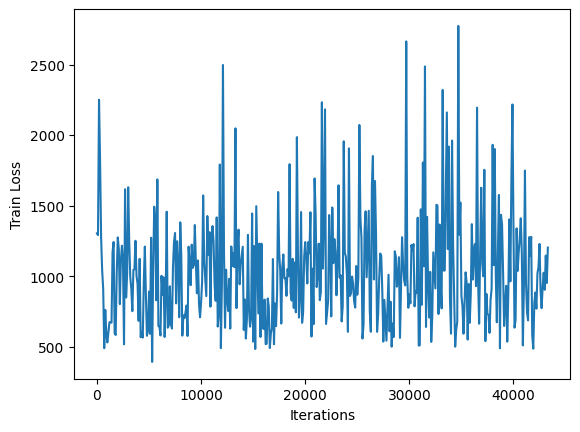

********************ITERATION NUMBER #43400
********************ITERATION NUMBER #43401
********************ITERATION NUMBER #43402
********************ITERATION NUMBER #43403
********************ITERATION NUMBER #43404
********************ITERATION NUMBER #43405
********************ITERATION NUMBER #43406
********************ITERATION NUMBER #43407
********************ITERATION NUMBER #43408
********************ITERATION NUMBER #43409
********************ITERATION NUMBER #43410
********************ITERATION NUMBER #43411
********************ITERATION NUMBER #43412
********************ITERATION NUMBER #43413
********************ITERATION NUMBER #43414
********************ITERATION NUMBER #43415
********************ITERATION NUMBER #43416
********************ITERATION NUMBER #43417
********************ITERATION NUMBER #43418
********************ITERATION NUMBER #43419
********************ITERATION NUMBER #43420
********************ITERATION NUMBER #43421
********************ITERATION NU

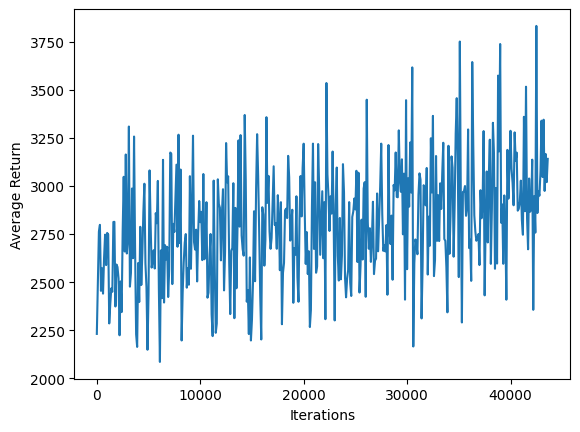

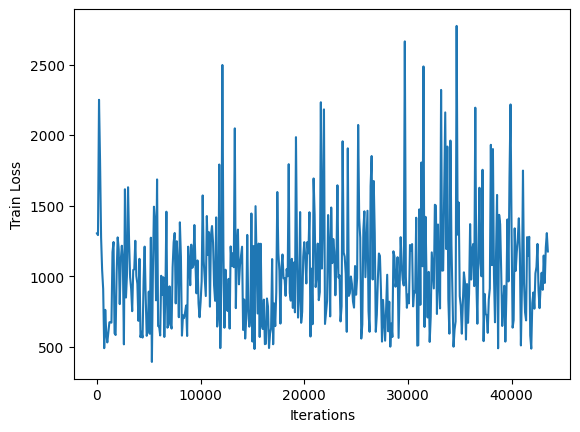

********************ITERATION NUMBER #43600
********************ITERATION NUMBER #43601
********************ITERATION NUMBER #43602
********************ITERATION NUMBER #43603
********************ITERATION NUMBER #43604
********************ITERATION NUMBER #43605
********************ITERATION NUMBER #43606
********************ITERATION NUMBER #43607
********************ITERATION NUMBER #43608
********************ITERATION NUMBER #43609
********************ITERATION NUMBER #43610
********************ITERATION NUMBER #43611
********************ITERATION NUMBER #43612
********************ITERATION NUMBER #43613
********************ITERATION NUMBER #43614
********************ITERATION NUMBER #43615
********************ITERATION NUMBER #43616
********************ITERATION NUMBER #43617
********************ITERATION NUMBER #43618
********************ITERATION NUMBER #43619
********************ITERATION NUMBER #43620
********************ITERATION NUMBER #43621
********************ITERATION NU

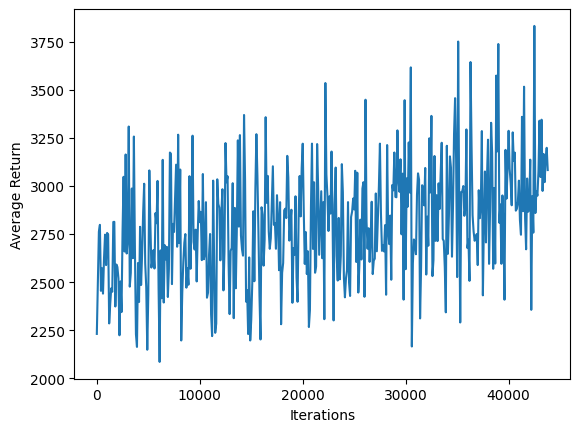

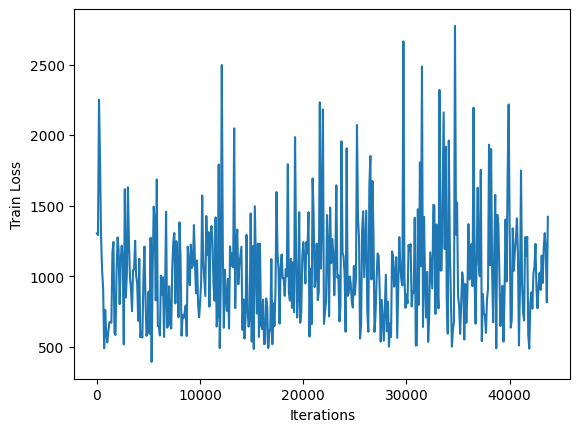

********************ITERATION NUMBER #43800
********************ITERATION NUMBER #43801
********************ITERATION NUMBER #43802
********************ITERATION NUMBER #43803
********************ITERATION NUMBER #43804
********************ITERATION NUMBER #43805
********************ITERATION NUMBER #43806
********************ITERATION NUMBER #43807
********************ITERATION NUMBER #43808
********************ITERATION NUMBER #43809
********************ITERATION NUMBER #43810
********************ITERATION NUMBER #43811
********************ITERATION NUMBER #43812
********************ITERATION NUMBER #43813
********************ITERATION NUMBER #43814
********************ITERATION NUMBER #43815
********************ITERATION NUMBER #43816
********************ITERATION NUMBER #43817
********************ITERATION NUMBER #43818
********************ITERATION NUMBER #43819
********************ITERATION NUMBER #43820
********************ITERATION NUMBER #43821
********************ITERATION NU

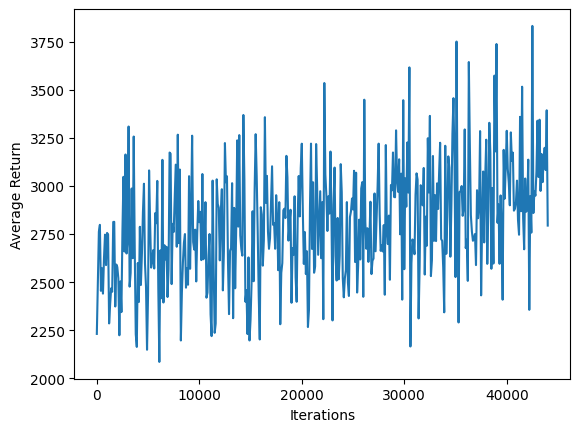

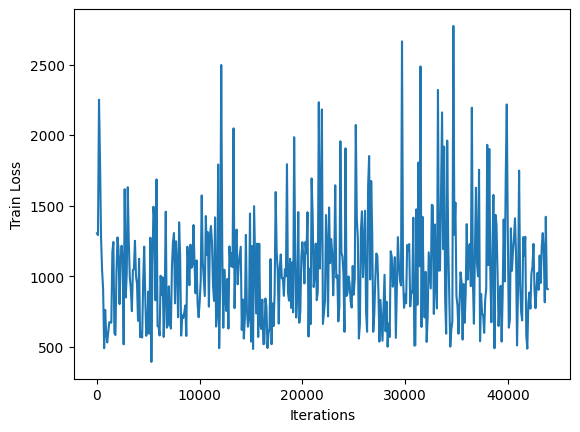

********************ITERATION NUMBER #44000
********************ITERATION NUMBER #44001
********************ITERATION NUMBER #44002
********************ITERATION NUMBER #44003
********************ITERATION NUMBER #44004
********************ITERATION NUMBER #44005
********************ITERATION NUMBER #44006
********************ITERATION NUMBER #44007
********************ITERATION NUMBER #44008
********************ITERATION NUMBER #44009
********************ITERATION NUMBER #44010
********************ITERATION NUMBER #44011
********************ITERATION NUMBER #44012
********************ITERATION NUMBER #44013
********************ITERATION NUMBER #44014
********************ITERATION NUMBER #44015
********************ITERATION NUMBER #44016
********************ITERATION NUMBER #44017
********************ITERATION NUMBER #44018
********************ITERATION NUMBER #44019
********************ITERATION NUMBER #44020
********************ITERATION NUMBER #44021
********************ITERATION NU

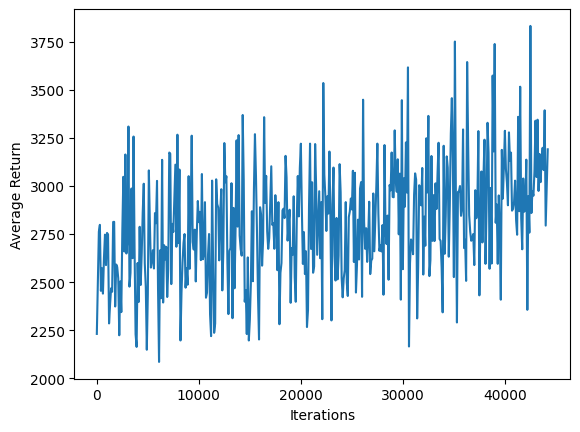

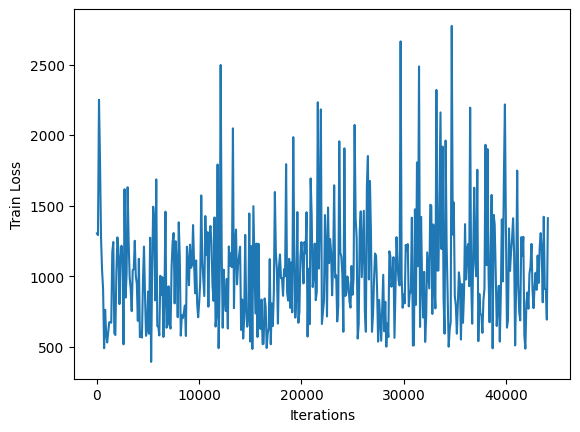

********************ITERATION NUMBER #44200
********************ITERATION NUMBER #44201
********************ITERATION NUMBER #44202
********************ITERATION NUMBER #44203
********************ITERATION NUMBER #44204
********************ITERATION NUMBER #44205
********************ITERATION NUMBER #44206
********************ITERATION NUMBER #44207
********************ITERATION NUMBER #44208
********************ITERATION NUMBER #44209
********************ITERATION NUMBER #44210
********************ITERATION NUMBER #44211
********************ITERATION NUMBER #44212
********************ITERATION NUMBER #44213
********************ITERATION NUMBER #44214
********************ITERATION NUMBER #44215
********************ITERATION NUMBER #44216
********************ITERATION NUMBER #44217
********************ITERATION NUMBER #44218
********************ITERATION NUMBER #44219
********************ITERATION NUMBER #44220
********************ITERATION NUMBER #44221
********************ITERATION NU

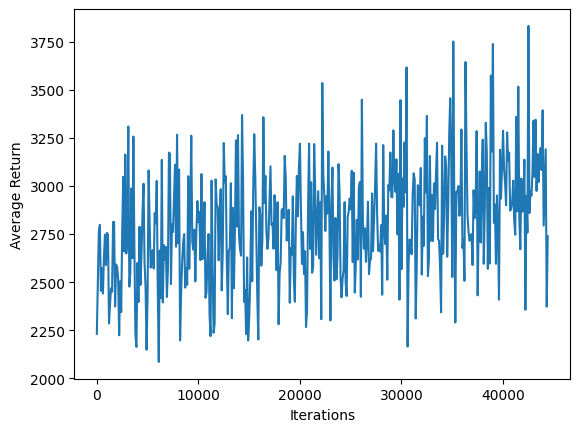

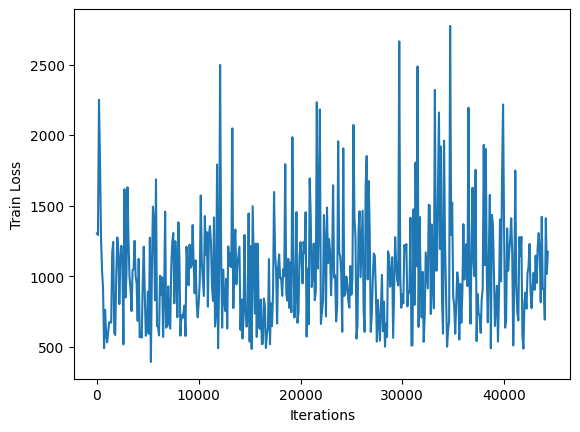

********************ITERATION NUMBER #44400
********************ITERATION NUMBER #44401
********************ITERATION NUMBER #44402
********************ITERATION NUMBER #44403
********************ITERATION NUMBER #44404
********************ITERATION NUMBER #44405
********************ITERATION NUMBER #44406
********************ITERATION NUMBER #44407
********************ITERATION NUMBER #44408
********************ITERATION NUMBER #44409
********************ITERATION NUMBER #44410
********************ITERATION NUMBER #44411
********************ITERATION NUMBER #44412
********************ITERATION NUMBER #44413
********************ITERATION NUMBER #44414
********************ITERATION NUMBER #44415
********************ITERATION NUMBER #44416
********************ITERATION NUMBER #44417
********************ITERATION NUMBER #44418
********************ITERATION NUMBER #44419
********************ITERATION NUMBER #44420
********************ITERATION NUMBER #44421
********************ITERATION NU

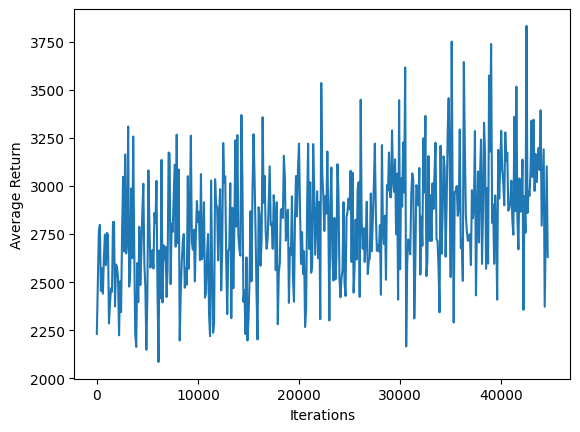

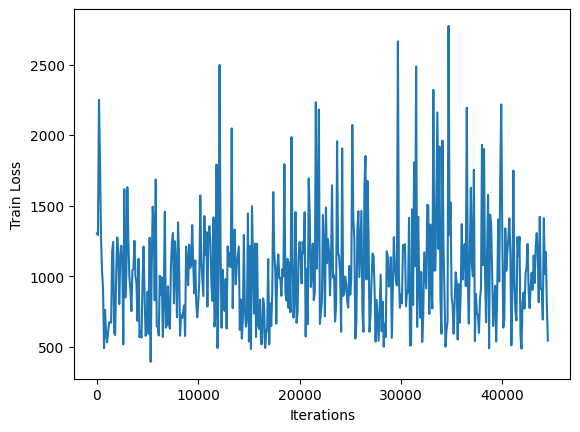

********************ITERATION NUMBER #44600
********************ITERATION NUMBER #44601
********************ITERATION NUMBER #44602
********************ITERATION NUMBER #44603
********************ITERATION NUMBER #44604
********************ITERATION NUMBER #44605
********************ITERATION NUMBER #44606
********************ITERATION NUMBER #44607
********************ITERATION NUMBER #44608
********************ITERATION NUMBER #44609
********************ITERATION NUMBER #44610
********************ITERATION NUMBER #44611
********************ITERATION NUMBER #44612
********************ITERATION NUMBER #44613
********************ITERATION NUMBER #44614
********************ITERATION NUMBER #44615
********************ITERATION NUMBER #44616
********************ITERATION NUMBER #44617
********************ITERATION NUMBER #44618
********************ITERATION NUMBER #44619
********************ITERATION NUMBER #44620
********************ITERATION NUMBER #44621
********************ITERATION NU

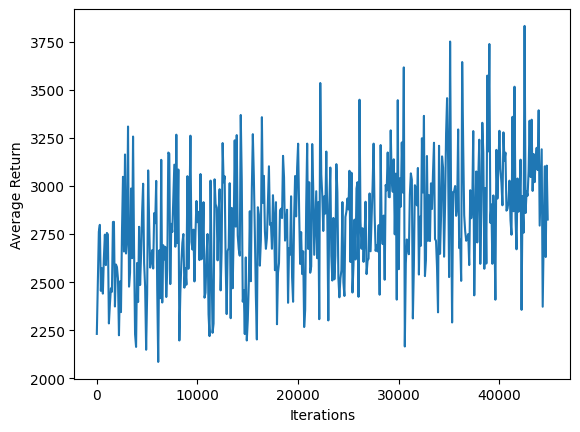

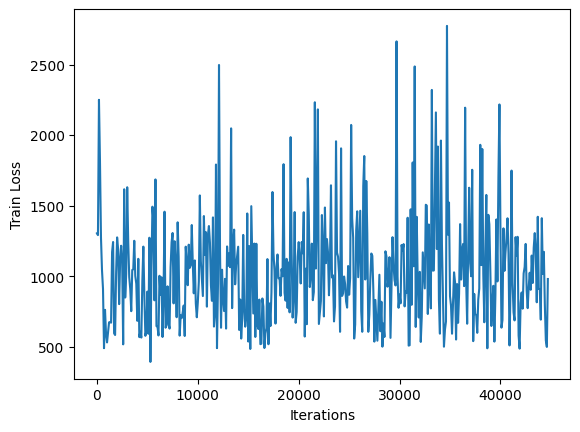

********************ITERATION NUMBER #44800
********************ITERATION NUMBER #44801
********************ITERATION NUMBER #44802
********************ITERATION NUMBER #44803
********************ITERATION NUMBER #44804
********************ITERATION NUMBER #44805
********************ITERATION NUMBER #44806
********************ITERATION NUMBER #44807
********************ITERATION NUMBER #44808
********************ITERATION NUMBER #44809
********************ITERATION NUMBER #44810
********************ITERATION NUMBER #44811
********************ITERATION NUMBER #44812
********************ITERATION NUMBER #44813
********************ITERATION NUMBER #44814
********************ITERATION NUMBER #44815
********************ITERATION NUMBER #44816
********************ITERATION NUMBER #44817
********************ITERATION NUMBER #44818
********************ITERATION NUMBER #44819
********************ITERATION NUMBER #44820
********************ITERATION NUMBER #44821
********************ITERATION NU

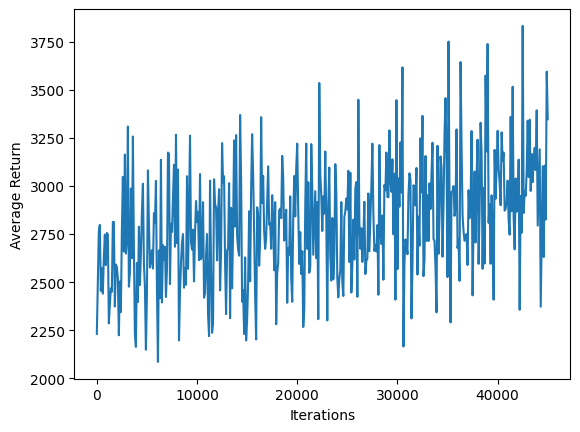

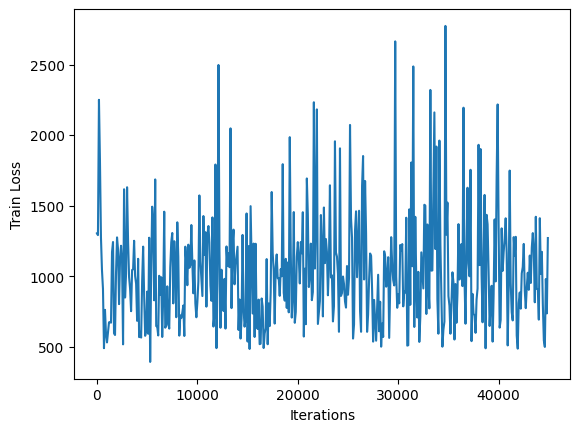

********************ITERATION NUMBER #45000
********************ITERATION NUMBER #45001
********************ITERATION NUMBER #45002
********************ITERATION NUMBER #45003
********************ITERATION NUMBER #45004
********************ITERATION NUMBER #45005
********************ITERATION NUMBER #45006
********************ITERATION NUMBER #45007
********************ITERATION NUMBER #45008
********************ITERATION NUMBER #45009
********************ITERATION NUMBER #45010
********************ITERATION NUMBER #45011
********************ITERATION NUMBER #45012
********************ITERATION NUMBER #45013
********************ITERATION NUMBER #45014
********************ITERATION NUMBER #45015
********************ITERATION NUMBER #45016
********************ITERATION NUMBER #45017
********************ITERATION NUMBER #45018
********************ITERATION NUMBER #45019
********************ITERATION NUMBER #45020
********************ITERATION NUMBER #45021
********************ITERATION NU

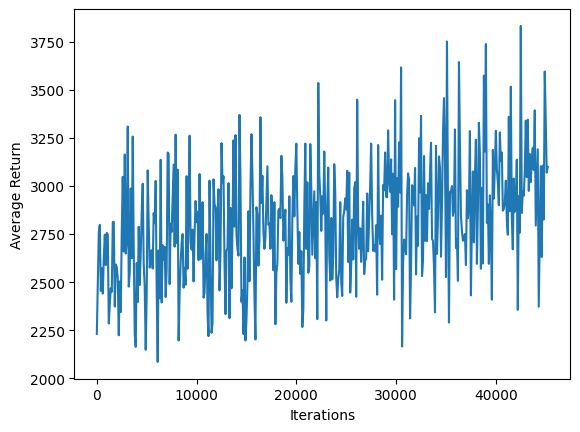

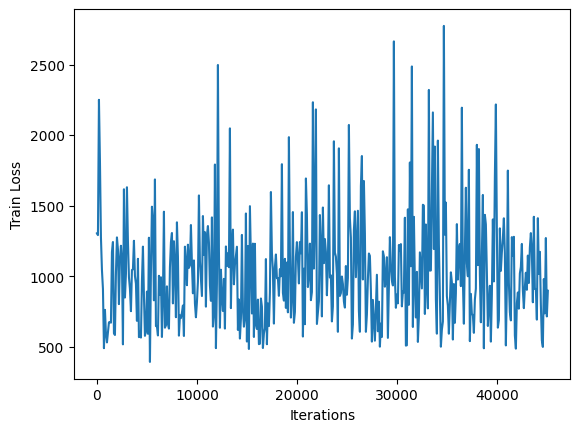

********************ITERATION NUMBER #45200
********************ITERATION NUMBER #45201
********************ITERATION NUMBER #45202
********************ITERATION NUMBER #45203
********************ITERATION NUMBER #45204
********************ITERATION NUMBER #45205
********************ITERATION NUMBER #45206
********************ITERATION NUMBER #45207
********************ITERATION NUMBER #45208
********************ITERATION NUMBER #45209
********************ITERATION NUMBER #45210
********************ITERATION NUMBER #45211
********************ITERATION NUMBER #45212
********************ITERATION NUMBER #45213
********************ITERATION NUMBER #45214
********************ITERATION NUMBER #45215
********************ITERATION NUMBER #45216
********************ITERATION NUMBER #45217
********************ITERATION NUMBER #45218
********************ITERATION NUMBER #45219
********************ITERATION NUMBER #45220
********************ITERATION NUMBER #45221
********************ITERATION NU

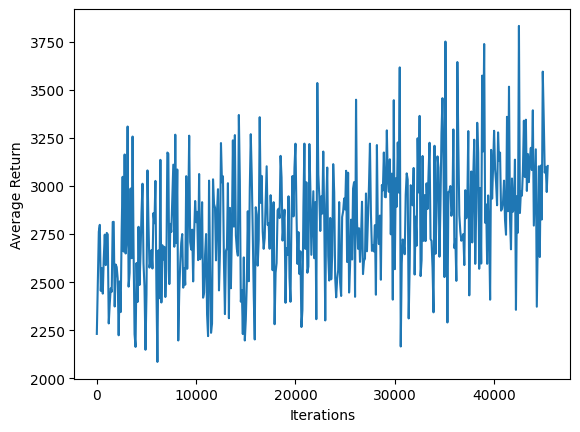

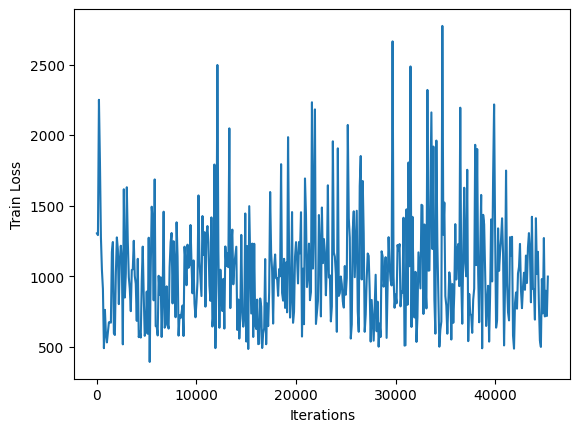

********************ITERATION NUMBER #45400
********************ITERATION NUMBER #45401
********************ITERATION NUMBER #45402
********************ITERATION NUMBER #45403
********************ITERATION NUMBER #45404
********************ITERATION NUMBER #45405
********************ITERATION NUMBER #45406
********************ITERATION NUMBER #45407
********************ITERATION NUMBER #45408
********************ITERATION NUMBER #45409
********************ITERATION NUMBER #45410
********************ITERATION NUMBER #45411
********************ITERATION NUMBER #45412
********************ITERATION NUMBER #45413
********************ITERATION NUMBER #45414
********************ITERATION NUMBER #45415
********************ITERATION NUMBER #45416
********************ITERATION NUMBER #45417
********************ITERATION NUMBER #45418
********************ITERATION NUMBER #45419
********************ITERATION NUMBER #45420
********************ITERATION NUMBER #45421
********************ITERATION NU

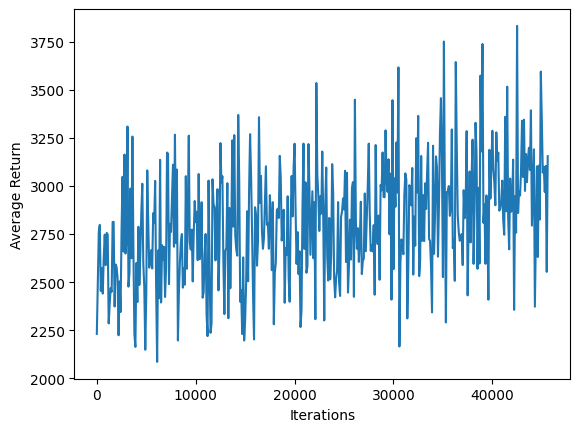

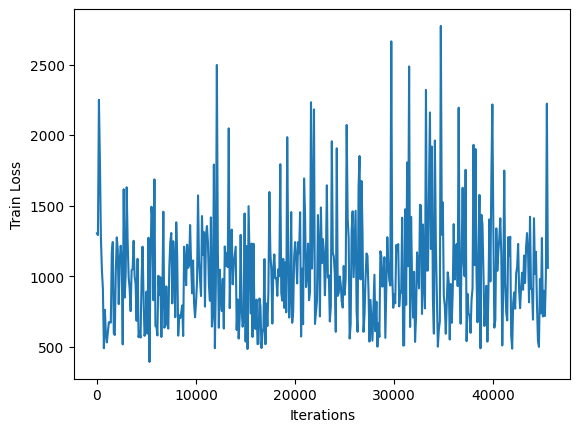

********************ITERATION NUMBER #45600
********************ITERATION NUMBER #45601
********************ITERATION NUMBER #45602
********************ITERATION NUMBER #45603
********************ITERATION NUMBER #45604
********************ITERATION NUMBER #45605
********************ITERATION NUMBER #45606
********************ITERATION NUMBER #45607
********************ITERATION NUMBER #45608
********************ITERATION NUMBER #45609
********************ITERATION NUMBER #45610
********************ITERATION NUMBER #45611
********************ITERATION NUMBER #45612
********************ITERATION NUMBER #45613
********************ITERATION NUMBER #45614
********************ITERATION NUMBER #45615
********************ITERATION NUMBER #45616
********************ITERATION NUMBER #45617
********************ITERATION NUMBER #45618
********************ITERATION NUMBER #45619
********************ITERATION NUMBER #45620
********************ITERATION NUMBER #45621
********************ITERATION NU

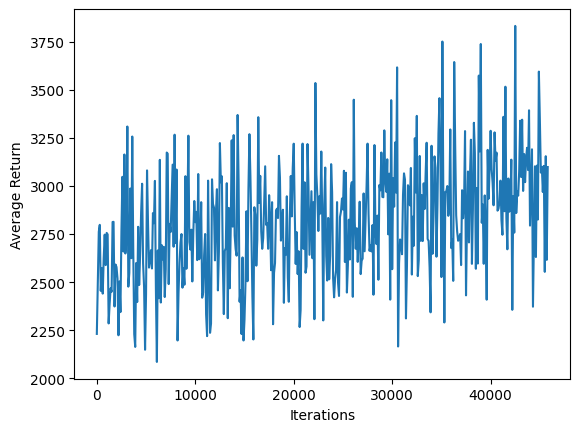

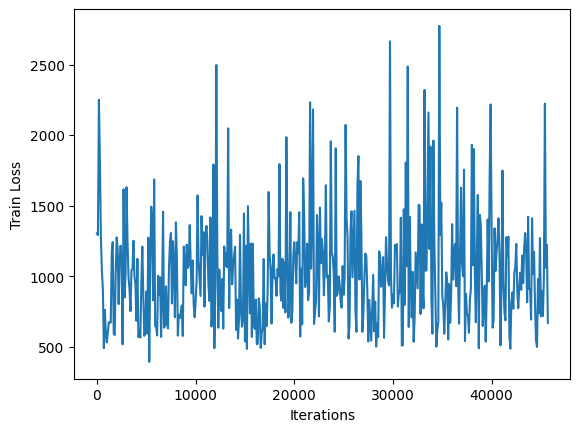

********************ITERATION NUMBER #45800
********************ITERATION NUMBER #45801
********************ITERATION NUMBER #45802
********************ITERATION NUMBER #45803
********************ITERATION NUMBER #45804
********************ITERATION NUMBER #45805
********************ITERATION NUMBER #45806
********************ITERATION NUMBER #45807
********************ITERATION NUMBER #45808
********************ITERATION NUMBER #45809
********************ITERATION NUMBER #45810
********************ITERATION NUMBER #45811
********************ITERATION NUMBER #45812
********************ITERATION NUMBER #45813
********************ITERATION NUMBER #45814
********************ITERATION NUMBER #45815
********************ITERATION NUMBER #45816
********************ITERATION NUMBER #45817
********************ITERATION NUMBER #45818
********************ITERATION NUMBER #45819
********************ITERATION NUMBER #45820
********************ITERATION NUMBER #45821
********************ITERATION NU

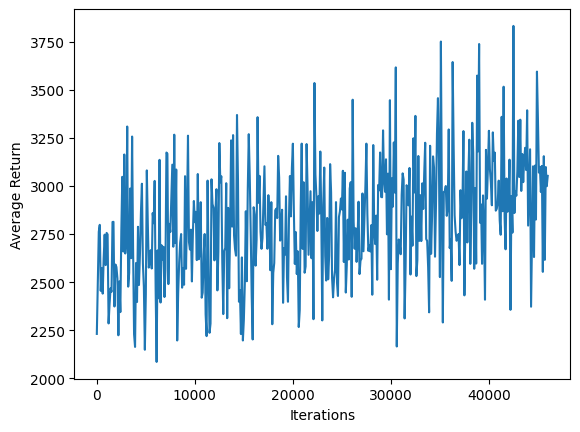

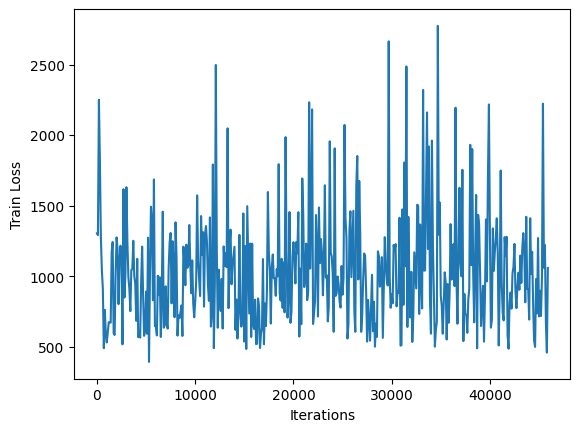

********************ITERATION NUMBER #46000
********************ITERATION NUMBER #46001
********************ITERATION NUMBER #46002
********************ITERATION NUMBER #46003
********************ITERATION NUMBER #46004
********************ITERATION NUMBER #46005
********************ITERATION NUMBER #46006
********************ITERATION NUMBER #46007
********************ITERATION NUMBER #46008
********************ITERATION NUMBER #46009
********************ITERATION NUMBER #46010
********************ITERATION NUMBER #46011
********************ITERATION NUMBER #46012
********************ITERATION NUMBER #46013
********************ITERATION NUMBER #46014
********************ITERATION NUMBER #46015
********************ITERATION NUMBER #46016
********************ITERATION NUMBER #46017
********************ITERATION NUMBER #46018
********************ITERATION NUMBER #46019
********************ITERATION NUMBER #46020
********************ITERATION NUMBER #46021
********************ITERATION NU

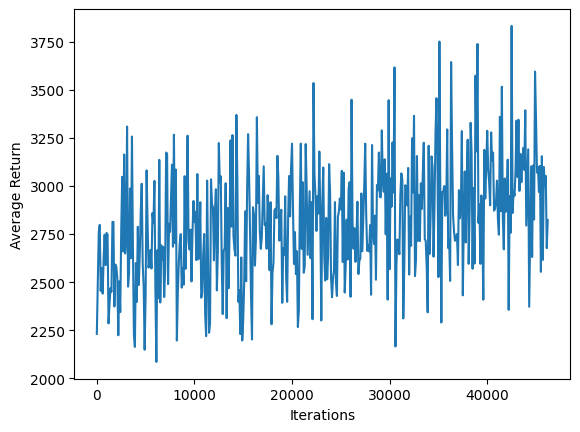

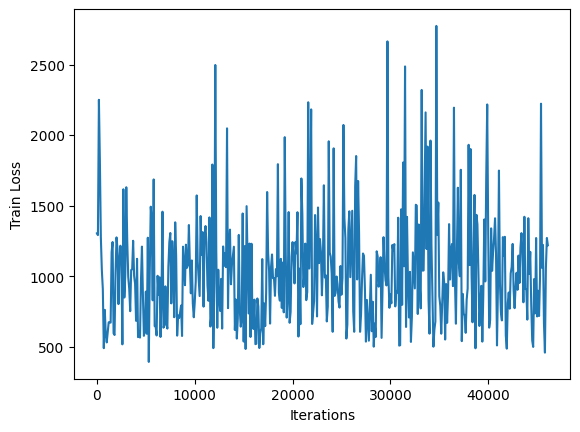

********************ITERATION NUMBER #46200
********************ITERATION NUMBER #46201
********************ITERATION NUMBER #46202
********************ITERATION NUMBER #46203
********************ITERATION NUMBER #46204
********************ITERATION NUMBER #46205
********************ITERATION NUMBER #46206
********************ITERATION NUMBER #46207
********************ITERATION NUMBER #46208
********************ITERATION NUMBER #46209
********************ITERATION NUMBER #46210
********************ITERATION NUMBER #46211
********************ITERATION NUMBER #46212
********************ITERATION NUMBER #46213
********************ITERATION NUMBER #46214
********************ITERATION NUMBER #46215
********************ITERATION NUMBER #46216
********************ITERATION NUMBER #46217
********************ITERATION NUMBER #46218
********************ITERATION NUMBER #46219
********************ITERATION NUMBER #46220
********************ITERATION NUMBER #46221
********************ITERATION NU

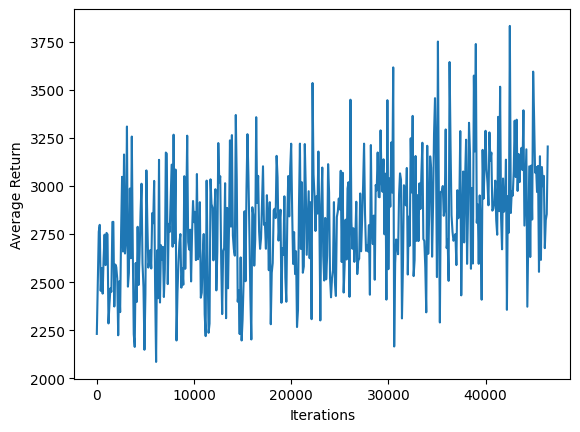

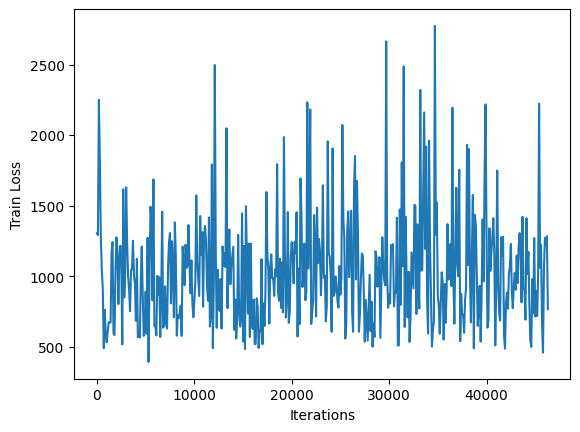

********************ITERATION NUMBER #46400
********************ITERATION NUMBER #46401
********************ITERATION NUMBER #46402
********************ITERATION NUMBER #46403
********************ITERATION NUMBER #46404
********************ITERATION NUMBER #46405
********************ITERATION NUMBER #46406
********************ITERATION NUMBER #46407
********************ITERATION NUMBER #46408
********************ITERATION NUMBER #46409
********************ITERATION NUMBER #46410
********************ITERATION NUMBER #46411
********************ITERATION NUMBER #46412
********************ITERATION NUMBER #46413
********************ITERATION NUMBER #46414
********************ITERATION NUMBER #46415
********************ITERATION NUMBER #46416
********************ITERATION NUMBER #46417
********************ITERATION NUMBER #46418
********************ITERATION NUMBER #46419
********************ITERATION NUMBER #46420
********************ITERATION NUMBER #46421
********************ITERATION NU

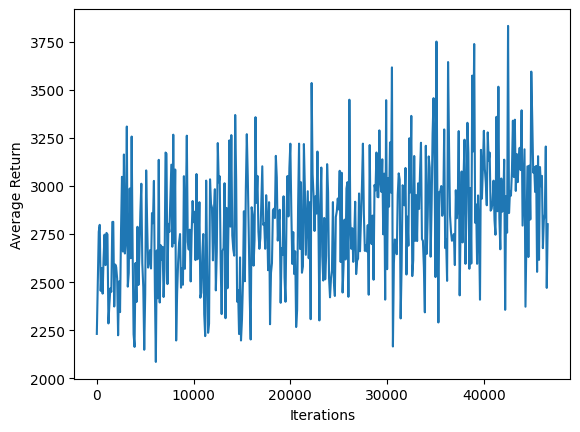

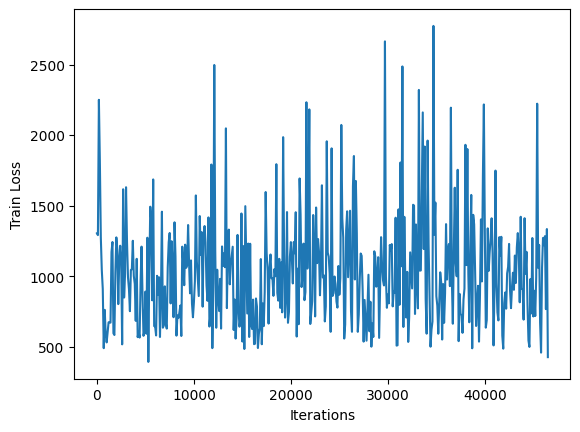

********************ITERATION NUMBER #46600
********************ITERATION NUMBER #46601
********************ITERATION NUMBER #46602
********************ITERATION NUMBER #46603
********************ITERATION NUMBER #46604
********************ITERATION NUMBER #46605
********************ITERATION NUMBER #46606
********************ITERATION NUMBER #46607
********************ITERATION NUMBER #46608
********************ITERATION NUMBER #46609
********************ITERATION NUMBER #46610
********************ITERATION NUMBER #46611
********************ITERATION NUMBER #46612
********************ITERATION NUMBER #46613
********************ITERATION NUMBER #46614
********************ITERATION NUMBER #46615
********************ITERATION NUMBER #46616
********************ITERATION NUMBER #46617
********************ITERATION NUMBER #46618
********************ITERATION NUMBER #46619
********************ITERATION NUMBER #46620
********************ITERATION NUMBER #46621
********************ITERATION NU

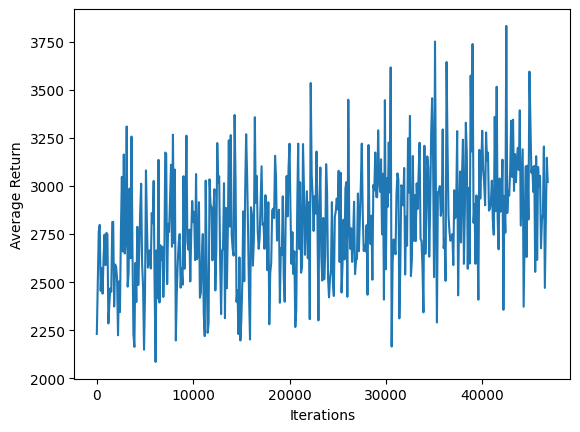

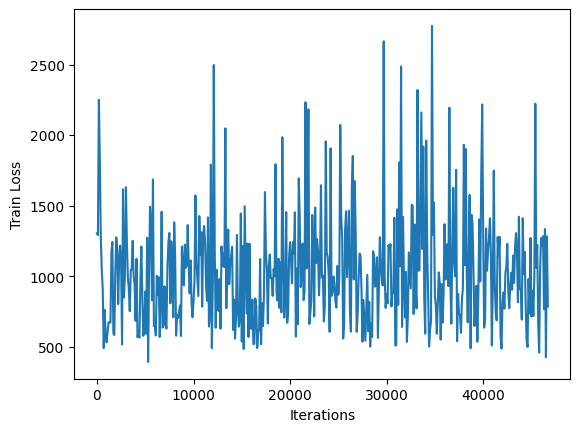

********************ITERATION NUMBER #46800
********************ITERATION NUMBER #46801
********************ITERATION NUMBER #46802
********************ITERATION NUMBER #46803
********************ITERATION NUMBER #46804
********************ITERATION NUMBER #46805
********************ITERATION NUMBER #46806
********************ITERATION NUMBER #46807
********************ITERATION NUMBER #46808
********************ITERATION NUMBER #46809
********************ITERATION NUMBER #46810
********************ITERATION NUMBER #46811
********************ITERATION NUMBER #46812
********************ITERATION NUMBER #46813
********************ITERATION NUMBER #46814
********************ITERATION NUMBER #46815
********************ITERATION NUMBER #46816
********************ITERATION NUMBER #46817
********************ITERATION NUMBER #46818
********************ITERATION NUMBER #46819
********************ITERATION NUMBER #46820
********************ITERATION NUMBER #46821
********************ITERATION NU

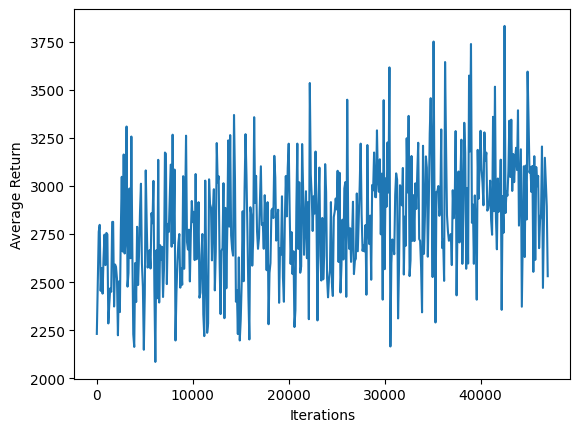

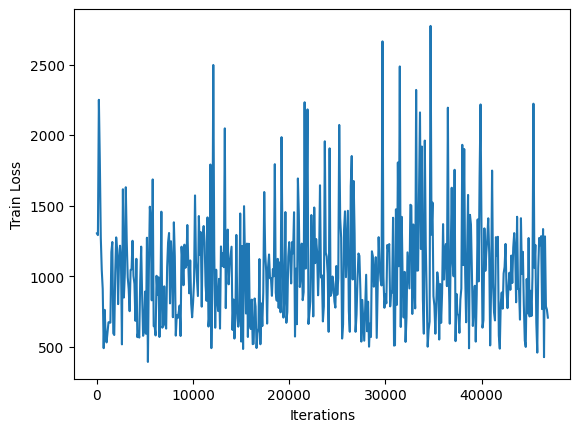

********************ITERATION NUMBER #47000
********************ITERATION NUMBER #47001
********************ITERATION NUMBER #47002
********************ITERATION NUMBER #47003
********************ITERATION NUMBER #47004
********************ITERATION NUMBER #47005
********************ITERATION NUMBER #47006
********************ITERATION NUMBER #47007
********************ITERATION NUMBER #47008
********************ITERATION NUMBER #47009
********************ITERATION NUMBER #47010
********************ITERATION NUMBER #47011
********************ITERATION NUMBER #47012
********************ITERATION NUMBER #47013
********************ITERATION NUMBER #47014
********************ITERATION NUMBER #47015
********************ITERATION NUMBER #47016
********************ITERATION NUMBER #47017
********************ITERATION NUMBER #47018
********************ITERATION NUMBER #47019
********************ITERATION NUMBER #47020
********************ITERATION NUMBER #47021
********************ITERATION NU

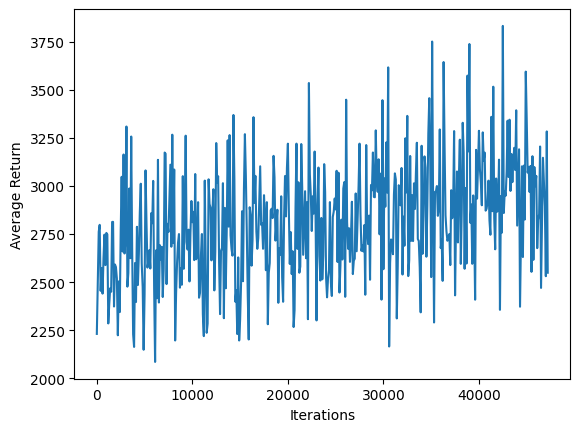

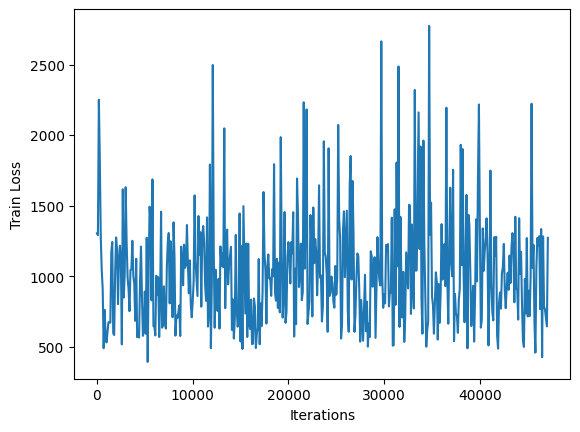

********************ITERATION NUMBER #47200
********************ITERATION NUMBER #47201
********************ITERATION NUMBER #47202
********************ITERATION NUMBER #47203
********************ITERATION NUMBER #47204
********************ITERATION NUMBER #47205
********************ITERATION NUMBER #47206
********************ITERATION NUMBER #47207
********************ITERATION NUMBER #47208
********************ITERATION NUMBER #47209
********************ITERATION NUMBER #47210
********************ITERATION NUMBER #47211
********************ITERATION NUMBER #47212
********************ITERATION NUMBER #47213
********************ITERATION NUMBER #47214
********************ITERATION NUMBER #47215
********************ITERATION NUMBER #47216
********************ITERATION NUMBER #47217
********************ITERATION NUMBER #47218
********************ITERATION NUMBER #47219
********************ITERATION NUMBER #47220
********************ITERATION NUMBER #47221
********************ITERATION NU

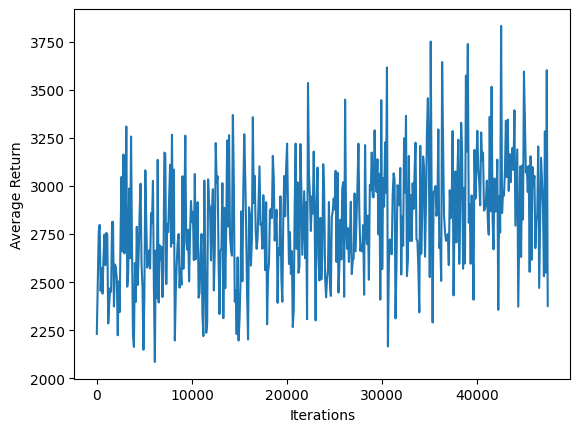

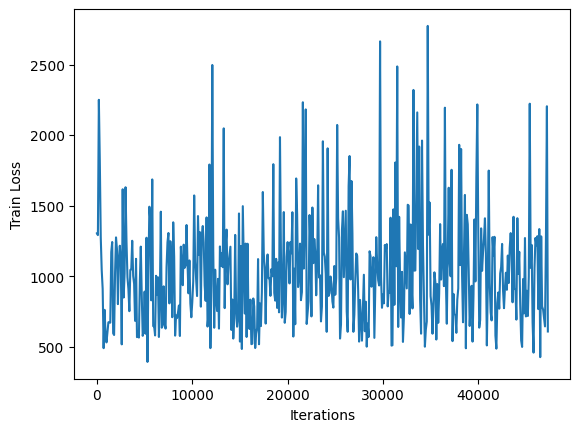

********************ITERATION NUMBER #47400
********************ITERATION NUMBER #47401
********************ITERATION NUMBER #47402
********************ITERATION NUMBER #47403
********************ITERATION NUMBER #47404
********************ITERATION NUMBER #47405
********************ITERATION NUMBER #47406
********************ITERATION NUMBER #47407
********************ITERATION NUMBER #47408
********************ITERATION NUMBER #47409
********************ITERATION NUMBER #47410
********************ITERATION NUMBER #47411
********************ITERATION NUMBER #47412
********************ITERATION NUMBER #47413
********************ITERATION NUMBER #47414
********************ITERATION NUMBER #47415
********************ITERATION NUMBER #47416
********************ITERATION NUMBER #47417
********************ITERATION NUMBER #47418
********************ITERATION NUMBER #47419
********************ITERATION NUMBER #47420
********************ITERATION NUMBER #47421
********************ITERATION NU

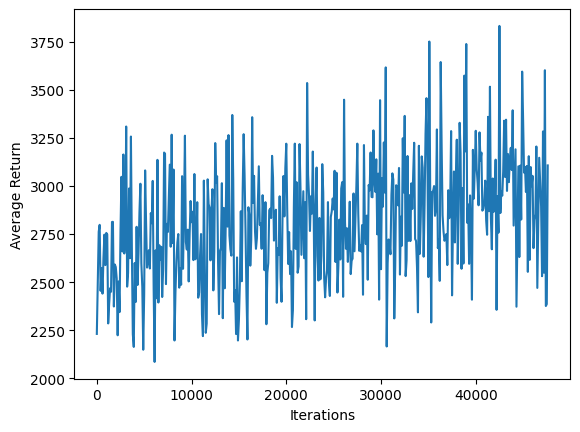

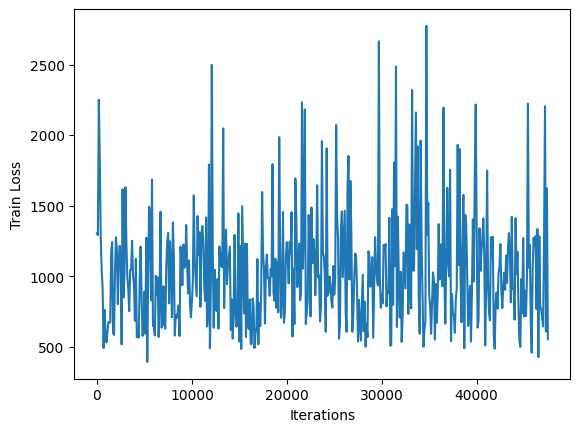

********************ITERATION NUMBER #47600
********************ITERATION NUMBER #47601
********************ITERATION NUMBER #47602
********************ITERATION NUMBER #47603
********************ITERATION NUMBER #47604
********************ITERATION NUMBER #47605
********************ITERATION NUMBER #47606
********************ITERATION NUMBER #47607
********************ITERATION NUMBER #47608
********************ITERATION NUMBER #47609
********************ITERATION NUMBER #47610
********************ITERATION NUMBER #47611
********************ITERATION NUMBER #47612
********************ITERATION NUMBER #47613
********************ITERATION NUMBER #47614
********************ITERATION NUMBER #47615
********************ITERATION NUMBER #47616
********************ITERATION NUMBER #47617
********************ITERATION NUMBER #47618
********************ITERATION NUMBER #47619
********************ITERATION NUMBER #47620
********************ITERATION NUMBER #47621
********************ITERATION NU

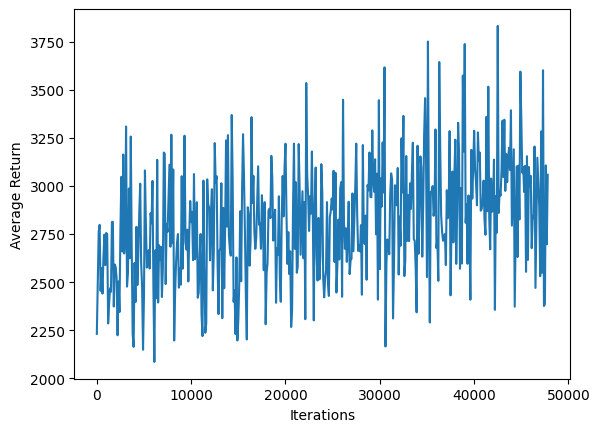

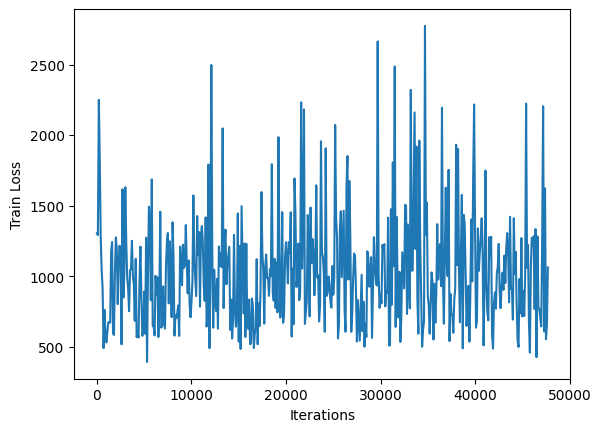

********************ITERATION NUMBER #47800
********************ITERATION NUMBER #47801
********************ITERATION NUMBER #47802
********************ITERATION NUMBER #47803
********************ITERATION NUMBER #47804
********************ITERATION NUMBER #47805
********************ITERATION NUMBER #47806
********************ITERATION NUMBER #47807
********************ITERATION NUMBER #47808
********************ITERATION NUMBER #47809
********************ITERATION NUMBER #47810
********************ITERATION NUMBER #47811
********************ITERATION NUMBER #47812
********************ITERATION NUMBER #47813
********************ITERATION NUMBER #47814
********************ITERATION NUMBER #47815
********************ITERATION NUMBER #47816
********************ITERATION NUMBER #47817
********************ITERATION NUMBER #47818
********************ITERATION NUMBER #47819
********************ITERATION NUMBER #47820
********************ITERATION NUMBER #47821
********************ITERATION NU

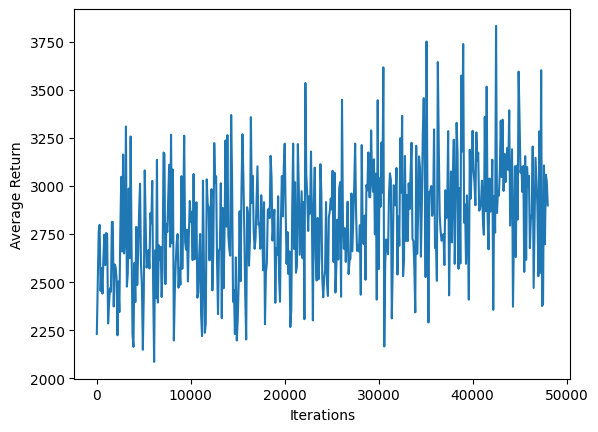

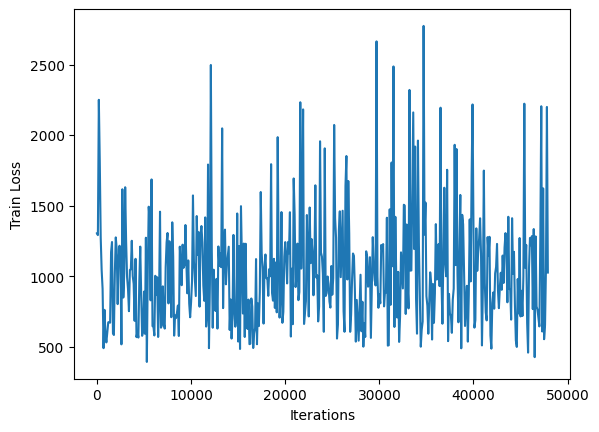

********************ITERATION NUMBER #48000
********************ITERATION NUMBER #48001
********************ITERATION NUMBER #48002
********************ITERATION NUMBER #48003
********************ITERATION NUMBER #48004
********************ITERATION NUMBER #48005
********************ITERATION NUMBER #48006
********************ITERATION NUMBER #48007
********************ITERATION NUMBER #48008
********************ITERATION NUMBER #48009
********************ITERATION NUMBER #48010
********************ITERATION NUMBER #48011
********************ITERATION NUMBER #48012
********************ITERATION NUMBER #48013
********************ITERATION NUMBER #48014
********************ITERATION NUMBER #48015
********************ITERATION NUMBER #48016
********************ITERATION NUMBER #48017
********************ITERATION NUMBER #48018
********************ITERATION NUMBER #48019
********************ITERATION NUMBER #48020
********************ITERATION NUMBER #48021
********************ITERATION NU

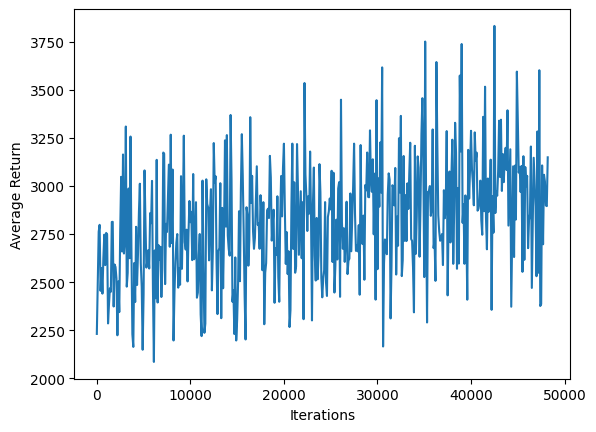

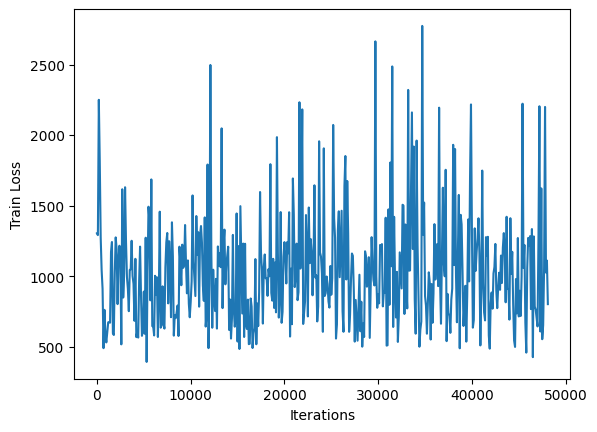

********************ITERATION NUMBER #48200
********************ITERATION NUMBER #48201
********************ITERATION NUMBER #48202
********************ITERATION NUMBER #48203
********************ITERATION NUMBER #48204
********************ITERATION NUMBER #48205
********************ITERATION NUMBER #48206
********************ITERATION NUMBER #48207
********************ITERATION NUMBER #48208
********************ITERATION NUMBER #48209
********************ITERATION NUMBER #48210
********************ITERATION NUMBER #48211
********************ITERATION NUMBER #48212
********************ITERATION NUMBER #48213
********************ITERATION NUMBER #48214
********************ITERATION NUMBER #48215
********************ITERATION NUMBER #48216
********************ITERATION NUMBER #48217
********************ITERATION NUMBER #48218
********************ITERATION NUMBER #48219
********************ITERATION NUMBER #48220
********************ITERATION NUMBER #48221
********************ITERATION NU

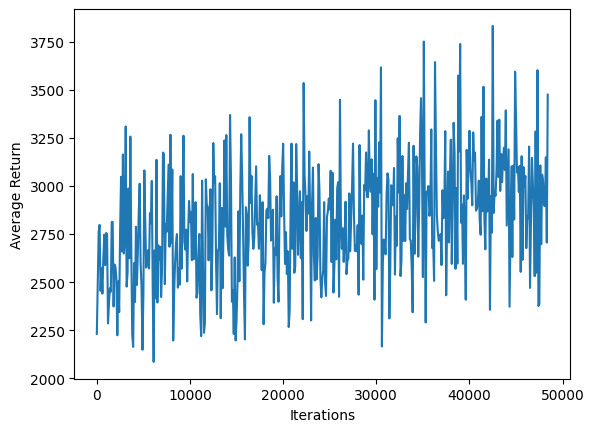

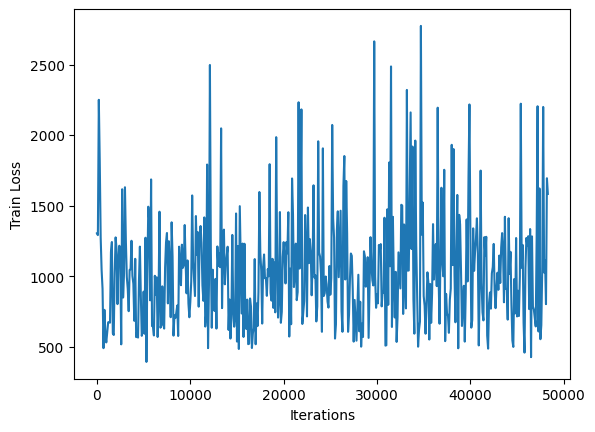

********************ITERATION NUMBER #48400
********************ITERATION NUMBER #48401
********************ITERATION NUMBER #48402
********************ITERATION NUMBER #48403
********************ITERATION NUMBER #48404
********************ITERATION NUMBER #48405
********************ITERATION NUMBER #48406
********************ITERATION NUMBER #48407
********************ITERATION NUMBER #48408
********************ITERATION NUMBER #48409
********************ITERATION NUMBER #48410
********************ITERATION NUMBER #48411
********************ITERATION NUMBER #48412
********************ITERATION NUMBER #48413
********************ITERATION NUMBER #48414
********************ITERATION NUMBER #48415
********************ITERATION NUMBER #48416
********************ITERATION NUMBER #48417
********************ITERATION NUMBER #48418
********************ITERATION NUMBER #48419
********************ITERATION NUMBER #48420
********************ITERATION NUMBER #48421
********************ITERATION NU

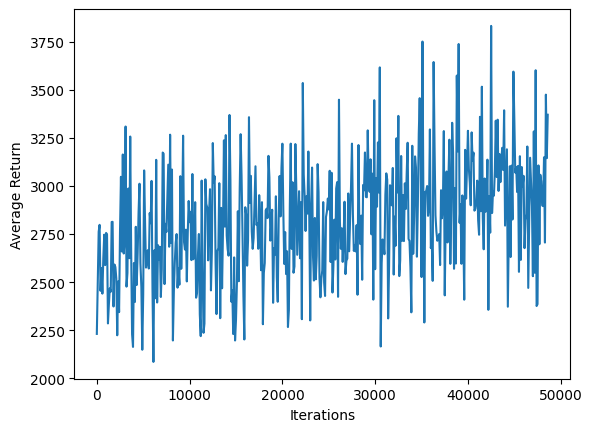

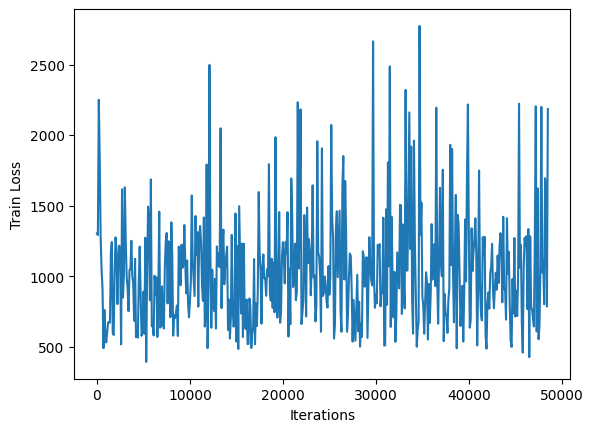

********************ITERATION NUMBER #48600
********************ITERATION NUMBER #48601
********************ITERATION NUMBER #48602
********************ITERATION NUMBER #48603
********************ITERATION NUMBER #48604
********************ITERATION NUMBER #48605
********************ITERATION NUMBER #48606
********************ITERATION NUMBER #48607
********************ITERATION NUMBER #48608
********************ITERATION NUMBER #48609
********************ITERATION NUMBER #48610
********************ITERATION NUMBER #48611
********************ITERATION NUMBER #48612
********************ITERATION NUMBER #48613
********************ITERATION NUMBER #48614
********************ITERATION NUMBER #48615
********************ITERATION NUMBER #48616
********************ITERATION NUMBER #48617
********************ITERATION NUMBER #48618
********************ITERATION NUMBER #48619
********************ITERATION NUMBER #48620
********************ITERATION NUMBER #48621
********************ITERATION NU

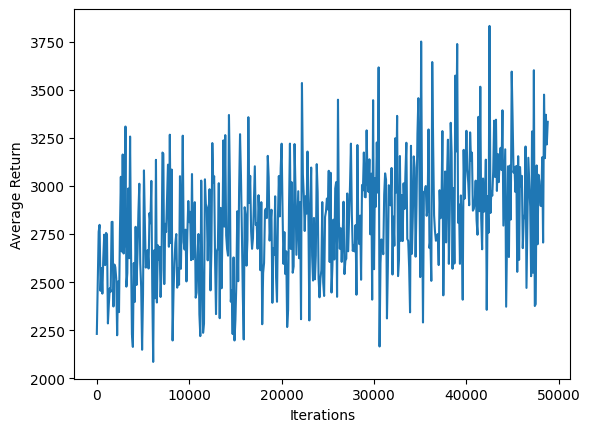

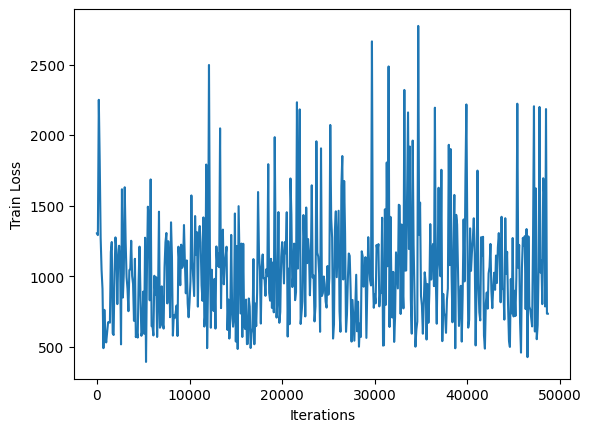

********************ITERATION NUMBER #48800
********************ITERATION NUMBER #48801
********************ITERATION NUMBER #48802
********************ITERATION NUMBER #48803
********************ITERATION NUMBER #48804
********************ITERATION NUMBER #48805
********************ITERATION NUMBER #48806
********************ITERATION NUMBER #48807
********************ITERATION NUMBER #48808
********************ITERATION NUMBER #48809
********************ITERATION NUMBER #48810
********************ITERATION NUMBER #48811
********************ITERATION NUMBER #48812
********************ITERATION NUMBER #48813
********************ITERATION NUMBER #48814
********************ITERATION NUMBER #48815
********************ITERATION NUMBER #48816
********************ITERATION NUMBER #48817
********************ITERATION NUMBER #48818
********************ITERATION NUMBER #48819
********************ITERATION NUMBER #48820
********************ITERATION NUMBER #48821
********************ITERATION NU

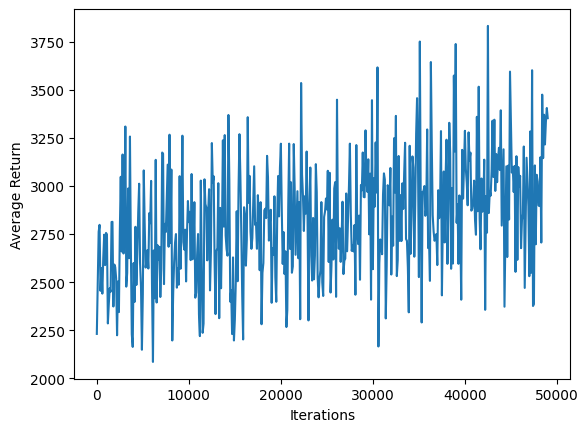

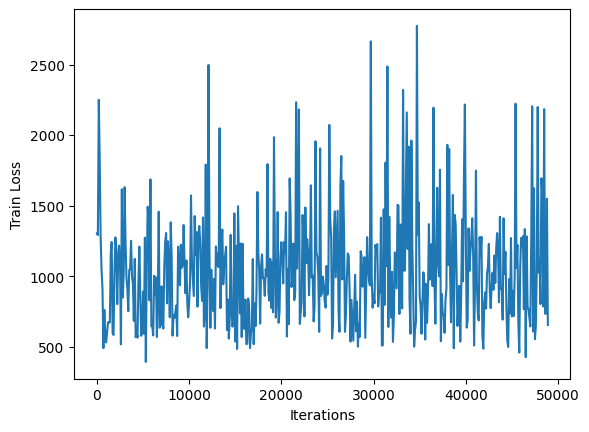

********************ITERATION NUMBER #49000
********************ITERATION NUMBER #49001
********************ITERATION NUMBER #49002
********************ITERATION NUMBER #49003
********************ITERATION NUMBER #49004
********************ITERATION NUMBER #49005
********************ITERATION NUMBER #49006
********************ITERATION NUMBER #49007
********************ITERATION NUMBER #49008
********************ITERATION NUMBER #49009
********************ITERATION NUMBER #49010
********************ITERATION NUMBER #49011
********************ITERATION NUMBER #49012
********************ITERATION NUMBER #49013
********************ITERATION NUMBER #49014
********************ITERATION NUMBER #49015
********************ITERATION NUMBER #49016
********************ITERATION NUMBER #49017
********************ITERATION NUMBER #49018
********************ITERATION NUMBER #49019
********************ITERATION NUMBER #49020
********************ITERATION NUMBER #49021
********************ITERATION NU

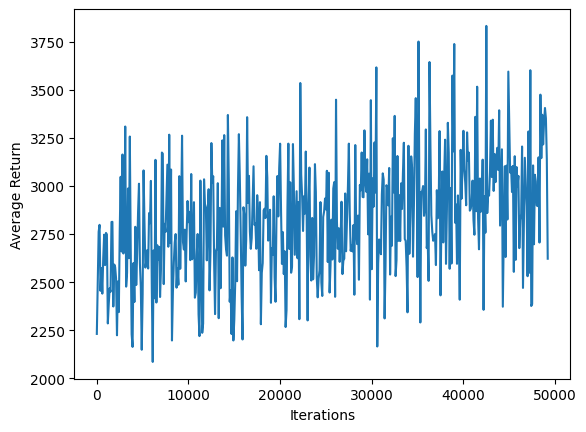

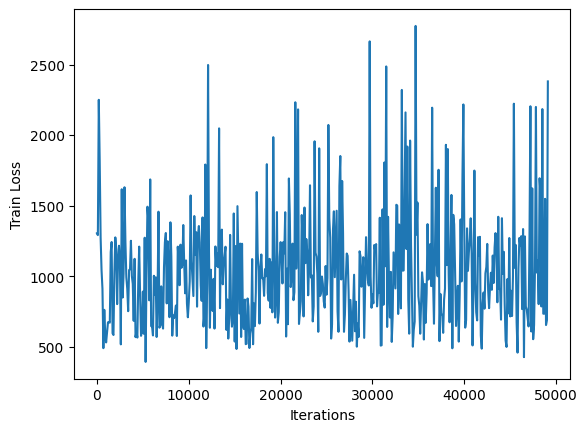

********************ITERATION NUMBER #49200
********************ITERATION NUMBER #49201
********************ITERATION NUMBER #49202
********************ITERATION NUMBER #49203
********************ITERATION NUMBER #49204
********************ITERATION NUMBER #49205
********************ITERATION NUMBER #49206
********************ITERATION NUMBER #49207
********************ITERATION NUMBER #49208
********************ITERATION NUMBER #49209
********************ITERATION NUMBER #49210
********************ITERATION NUMBER #49211
********************ITERATION NUMBER #49212
********************ITERATION NUMBER #49213
********************ITERATION NUMBER #49214
********************ITERATION NUMBER #49215
********************ITERATION NUMBER #49216
********************ITERATION NUMBER #49217
********************ITERATION NUMBER #49218
********************ITERATION NUMBER #49219
********************ITERATION NUMBER #49220
********************ITERATION NUMBER #49221
********************ITERATION NU

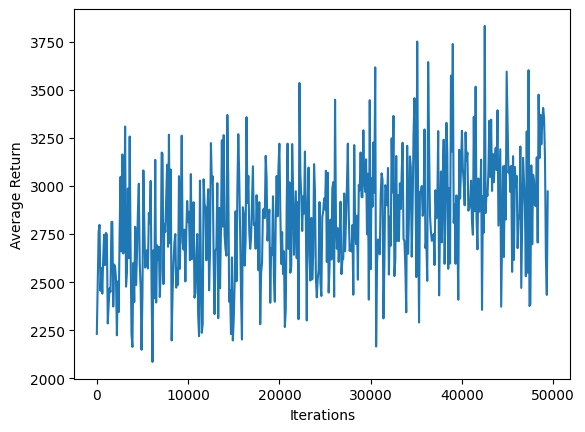

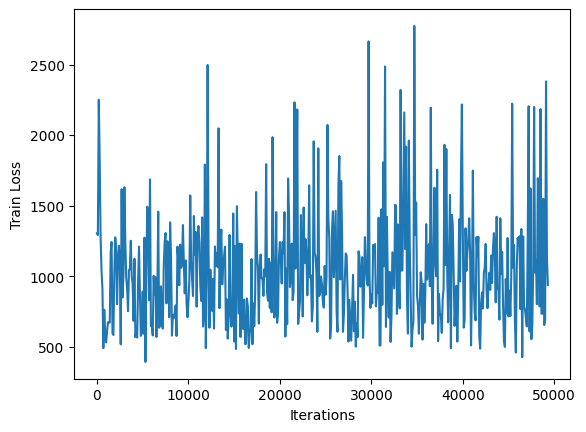

********************ITERATION NUMBER #49400
********************ITERATION NUMBER #49401
********************ITERATION NUMBER #49402
********************ITERATION NUMBER #49403
********************ITERATION NUMBER #49404
********************ITERATION NUMBER #49405
********************ITERATION NUMBER #49406
********************ITERATION NUMBER #49407
********************ITERATION NUMBER #49408
********************ITERATION NUMBER #49409
********************ITERATION NUMBER #49410
********************ITERATION NUMBER #49411
********************ITERATION NUMBER #49412
********************ITERATION NUMBER #49413
********************ITERATION NUMBER #49414
********************ITERATION NUMBER #49415
********************ITERATION NUMBER #49416
********************ITERATION NUMBER #49417
********************ITERATION NUMBER #49418
********************ITERATION NUMBER #49419
********************ITERATION NUMBER #49420
********************ITERATION NUMBER #49421
********************ITERATION NU

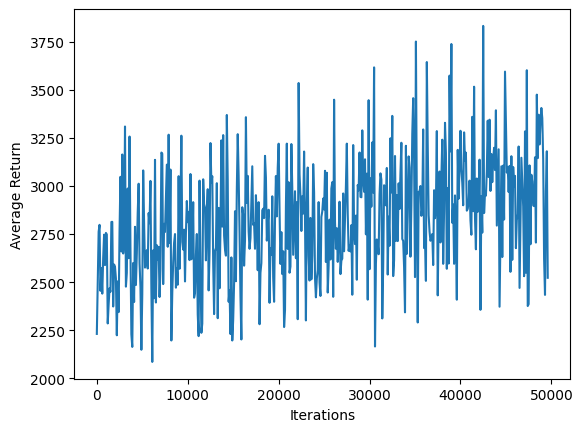

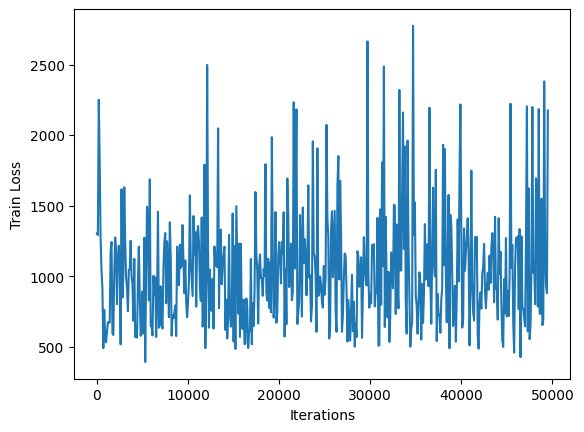

********************ITERATION NUMBER #49600
********************ITERATION NUMBER #49601
********************ITERATION NUMBER #49602
********************ITERATION NUMBER #49603
********************ITERATION NUMBER #49604
********************ITERATION NUMBER #49605
********************ITERATION NUMBER #49606
********************ITERATION NUMBER #49607
********************ITERATION NUMBER #49608
********************ITERATION NUMBER #49609
********************ITERATION NUMBER #49610
********************ITERATION NUMBER #49611
********************ITERATION NUMBER #49612
********************ITERATION NUMBER #49613
********************ITERATION NUMBER #49614
********************ITERATION NUMBER #49615
********************ITERATION NUMBER #49616
********************ITERATION NUMBER #49617
********************ITERATION NUMBER #49618
********************ITERATION NUMBER #49619
********************ITERATION NUMBER #49620
********************ITERATION NUMBER #49621
********************ITERATION NU

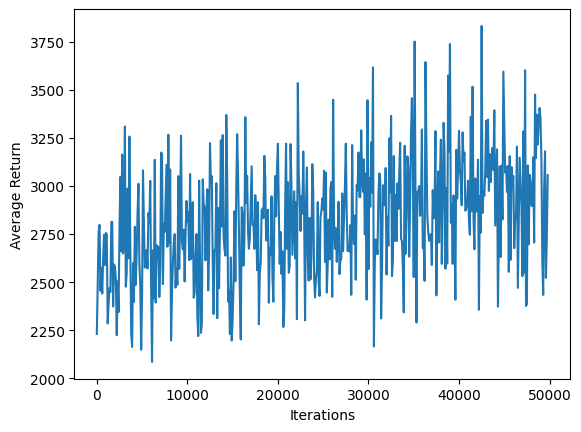

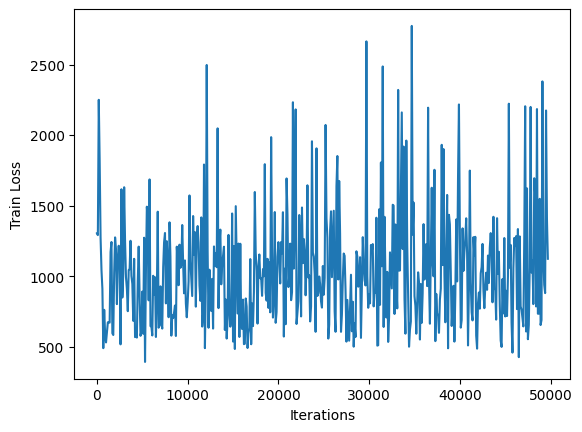

********************ITERATION NUMBER #49800
********************ITERATION NUMBER #49801
********************ITERATION NUMBER #49802
********************ITERATION NUMBER #49803
********************ITERATION NUMBER #49804
********************ITERATION NUMBER #49805
********************ITERATION NUMBER #49806
********************ITERATION NUMBER #49807
********************ITERATION NUMBER #49808
********************ITERATION NUMBER #49809
********************ITERATION NUMBER #49810
********************ITERATION NUMBER #49811
********************ITERATION NUMBER #49812
********************ITERATION NUMBER #49813
********************ITERATION NUMBER #49814
********************ITERATION NUMBER #49815
********************ITERATION NUMBER #49816
********************ITERATION NUMBER #49817
********************ITERATION NUMBER #49818
********************ITERATION NUMBER #49819
********************ITERATION NUMBER #49820
********************ITERATION NUMBER #49821
********************ITERATION NU

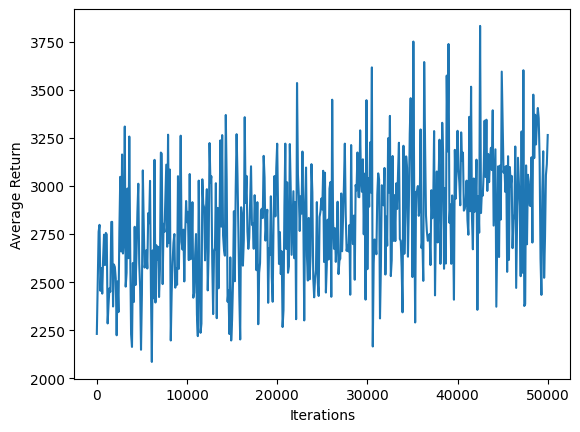

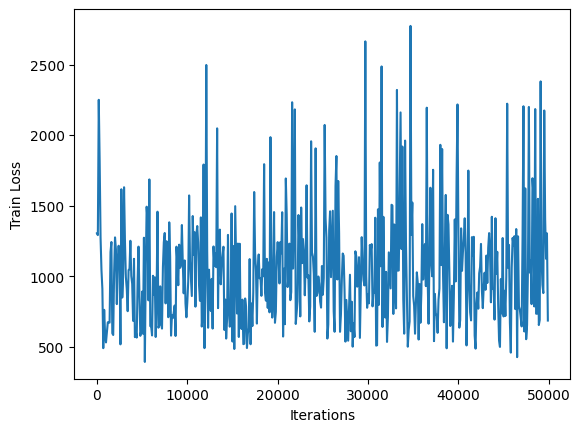

********************ITERATION NUMBER #50000
********************ITERATION NUMBER #50001
********************ITERATION NUMBER #50002
********************ITERATION NUMBER #50003
********************ITERATION NUMBER #50004
********************ITERATION NUMBER #50005
********************ITERATION NUMBER #50006
********************ITERATION NUMBER #50007
********************ITERATION NUMBER #50008
********************ITERATION NUMBER #50009
********************ITERATION NUMBER #50010
********************ITERATION NUMBER #50011
********************ITERATION NUMBER #50012
********************ITERATION NUMBER #50013
********************ITERATION NUMBER #50014
********************ITERATION NUMBER #50015
********************ITERATION NUMBER #50016
********************ITERATION NUMBER #50017
********************ITERATION NUMBER #50018
********************ITERATION NUMBER #50019
********************ITERATION NUMBER #50020
********************ITERATION NUMBER #50021
********************ITERATION NU

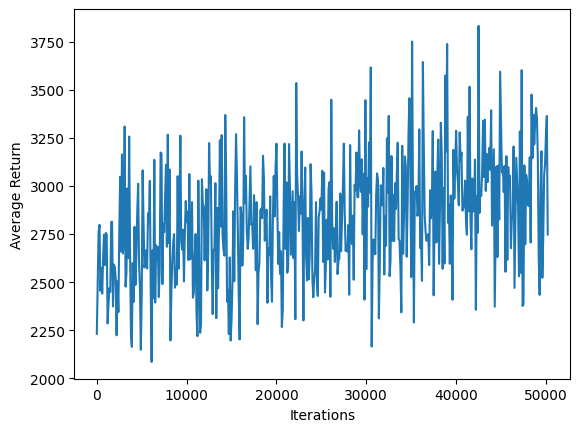

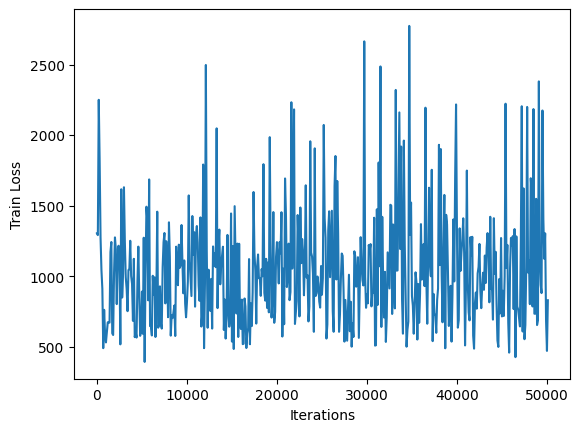

********************ITERATION NUMBER #50200
********************ITERATION NUMBER #50201
********************ITERATION NUMBER #50202
********************ITERATION NUMBER #50203
********************ITERATION NUMBER #50204
********************ITERATION NUMBER #50205
********************ITERATION NUMBER #50206
********************ITERATION NUMBER #50207
********************ITERATION NUMBER #50208
********************ITERATION NUMBER #50209
********************ITERATION NUMBER #50210
********************ITERATION NUMBER #50211
********************ITERATION NUMBER #50212
********************ITERATION NUMBER #50213
********************ITERATION NUMBER #50214
********************ITERATION NUMBER #50215
********************ITERATION NUMBER #50216
********************ITERATION NUMBER #50217
********************ITERATION NUMBER #50218
********************ITERATION NUMBER #50219
********************ITERATION NUMBER #50220
********************ITERATION NUMBER #50221
********************ITERATION NU

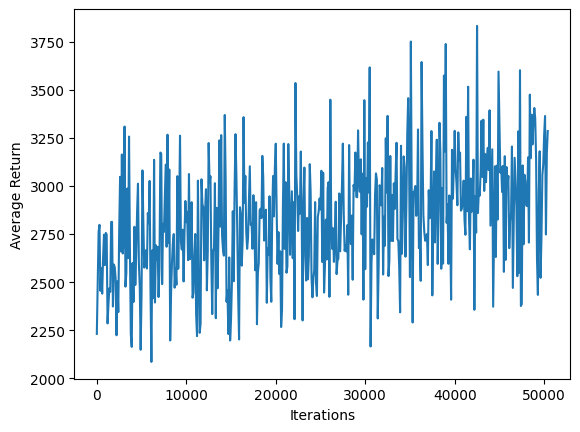

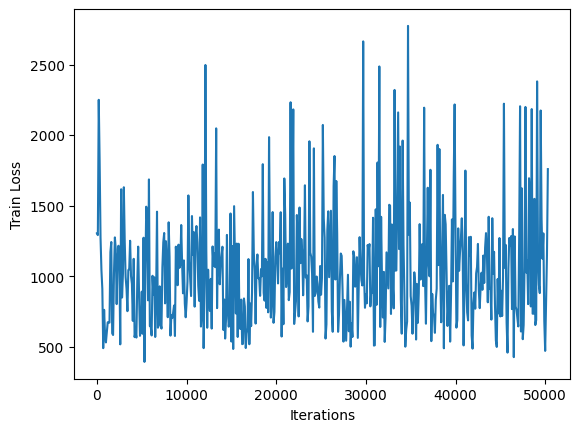

********************ITERATION NUMBER #50400
********************ITERATION NUMBER #50401
********************ITERATION NUMBER #50402
********************ITERATION NUMBER #50403
********************ITERATION NUMBER #50404
********************ITERATION NUMBER #50405
********************ITERATION NUMBER #50406
********************ITERATION NUMBER #50407
********************ITERATION NUMBER #50408
********************ITERATION NUMBER #50409
********************ITERATION NUMBER #50410
********************ITERATION NUMBER #50411
********************ITERATION NUMBER #50412
********************ITERATION NUMBER #50413
********************ITERATION NUMBER #50414
********************ITERATION NUMBER #50415
********************ITERATION NUMBER #50416
********************ITERATION NUMBER #50417
********************ITERATION NUMBER #50418
********************ITERATION NUMBER #50419
********************ITERATION NUMBER #50420
********************ITERATION NUMBER #50421
********************ITERATION NU

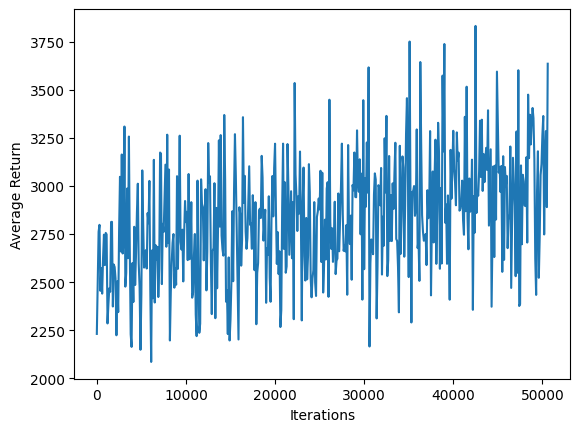

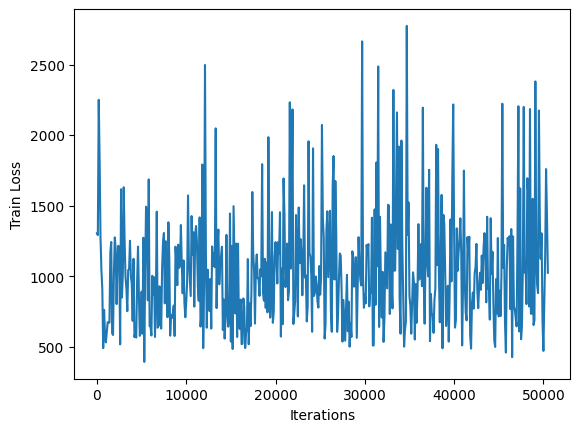

********************ITERATION NUMBER #50600
********************ITERATION NUMBER #50601
********************ITERATION NUMBER #50602
********************ITERATION NUMBER #50603
********************ITERATION NUMBER #50604
********************ITERATION NUMBER #50605
********************ITERATION NUMBER #50606
********************ITERATION NUMBER #50607
********************ITERATION NUMBER #50608
********************ITERATION NUMBER #50609
********************ITERATION NUMBER #50610
********************ITERATION NUMBER #50611
********************ITERATION NUMBER #50612
********************ITERATION NUMBER #50613
********************ITERATION NUMBER #50614
********************ITERATION NUMBER #50615
********************ITERATION NUMBER #50616
********************ITERATION NUMBER #50617
********************ITERATION NUMBER #50618
********************ITERATION NUMBER #50619
********************ITERATION NUMBER #50620
********************ITERATION NUMBER #50621
********************ITERATION NU

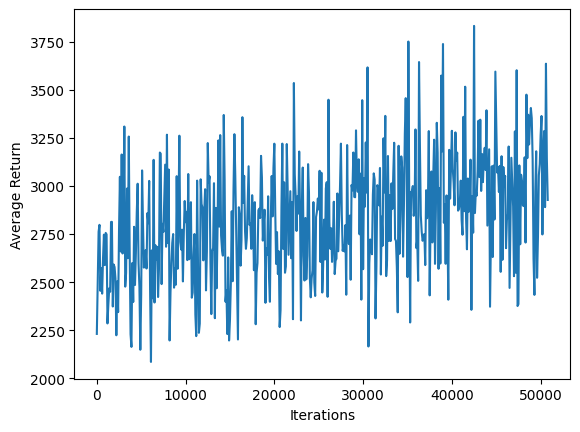

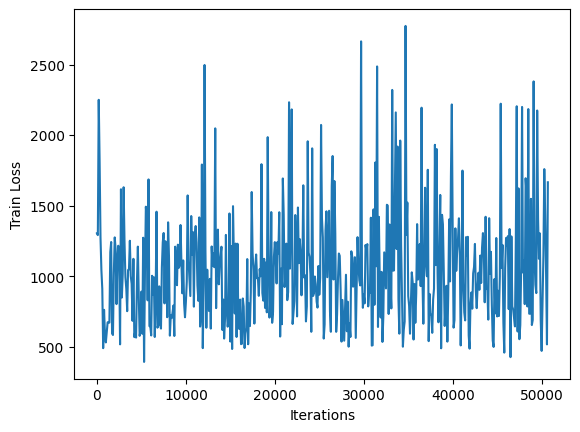

********************ITERATION NUMBER #50800
********************ITERATION NUMBER #50801
********************ITERATION NUMBER #50802
********************ITERATION NUMBER #50803
********************ITERATION NUMBER #50804
********************ITERATION NUMBER #50805
********************ITERATION NUMBER #50806
********************ITERATION NUMBER #50807
********************ITERATION NUMBER #50808
********************ITERATION NUMBER #50809
********************ITERATION NUMBER #50810
********************ITERATION NUMBER #50811
********************ITERATION NUMBER #50812
********************ITERATION NUMBER #50813
********************ITERATION NUMBER #50814
********************ITERATION NUMBER #50815
********************ITERATION NUMBER #50816
********************ITERATION NUMBER #50817
********************ITERATION NUMBER #50818
********************ITERATION NUMBER #50819
********************ITERATION NUMBER #50820
********************ITERATION NUMBER #50821
********************ITERATION NU

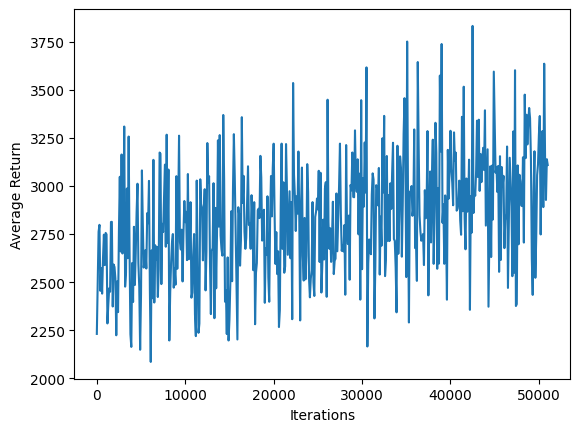

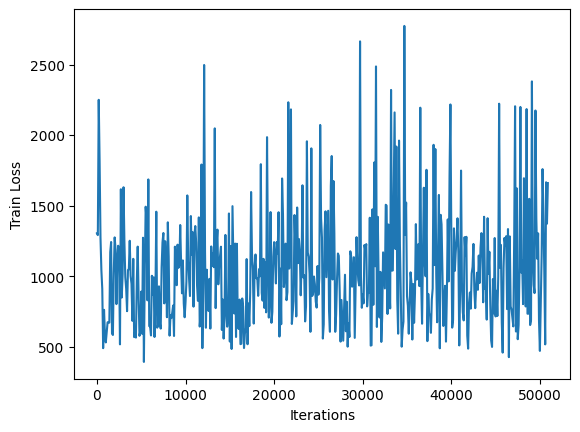

********************ITERATION NUMBER #51000
********************ITERATION NUMBER #51001
********************ITERATION NUMBER #51002
********************ITERATION NUMBER #51003
********************ITERATION NUMBER #51004
********************ITERATION NUMBER #51005
********************ITERATION NUMBER #51006
********************ITERATION NUMBER #51007
********************ITERATION NUMBER #51008
********************ITERATION NUMBER #51009
********************ITERATION NUMBER #51010
********************ITERATION NUMBER #51011
********************ITERATION NUMBER #51012
********************ITERATION NUMBER #51013
********************ITERATION NUMBER #51014
********************ITERATION NUMBER #51015
********************ITERATION NUMBER #51016
********************ITERATION NUMBER #51017
********************ITERATION NUMBER #51018
********************ITERATION NUMBER #51019
********************ITERATION NUMBER #51020
********************ITERATION NUMBER #51021
********************ITERATION NU

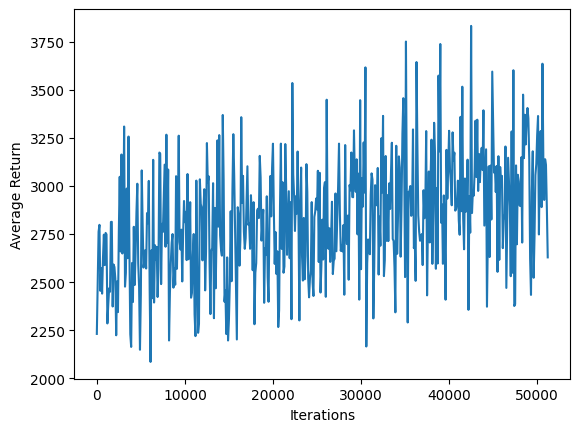

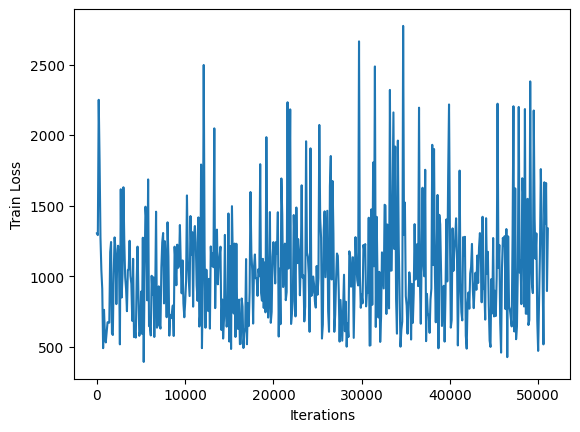

********************ITERATION NUMBER #51200
********************ITERATION NUMBER #51201
********************ITERATION NUMBER #51202
********************ITERATION NUMBER #51203
********************ITERATION NUMBER #51204
********************ITERATION NUMBER #51205
********************ITERATION NUMBER #51206
********************ITERATION NUMBER #51207
********************ITERATION NUMBER #51208
********************ITERATION NUMBER #51209
********************ITERATION NUMBER #51210
********************ITERATION NUMBER #51211
********************ITERATION NUMBER #51212
********************ITERATION NUMBER #51213
********************ITERATION NUMBER #51214
********************ITERATION NUMBER #51215
********************ITERATION NUMBER #51216
********************ITERATION NUMBER #51217
********************ITERATION NUMBER #51218
********************ITERATION NUMBER #51219
********************ITERATION NUMBER #51220
********************ITERATION NUMBER #51221
********************ITERATION NU

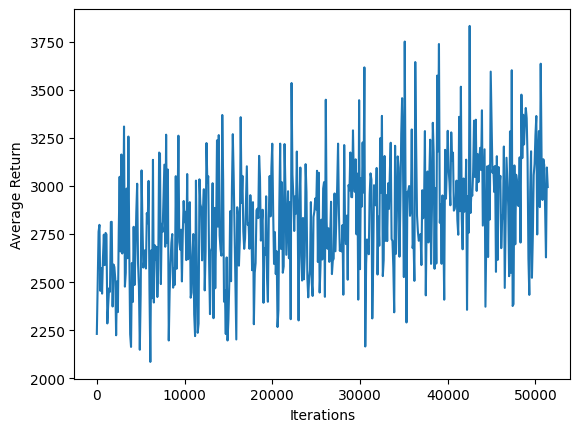

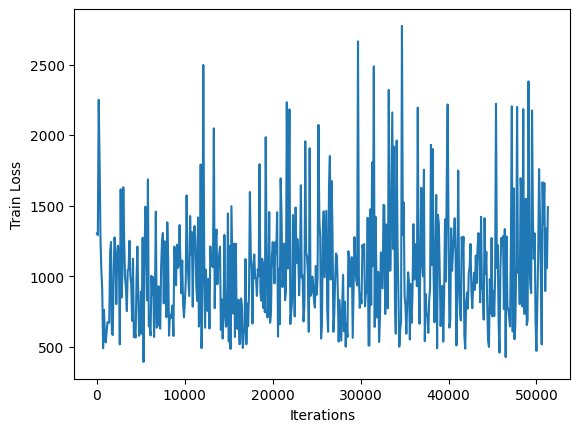

********************ITERATION NUMBER #51400
********************ITERATION NUMBER #51401
********************ITERATION NUMBER #51402
********************ITERATION NUMBER #51403
********************ITERATION NUMBER #51404
********************ITERATION NUMBER #51405
********************ITERATION NUMBER #51406
********************ITERATION NUMBER #51407
********************ITERATION NUMBER #51408
********************ITERATION NUMBER #51409
********************ITERATION NUMBER #51410
********************ITERATION NUMBER #51411
********************ITERATION NUMBER #51412
********************ITERATION NUMBER #51413
********************ITERATION NUMBER #51414
********************ITERATION NUMBER #51415
********************ITERATION NUMBER #51416
********************ITERATION NUMBER #51417
********************ITERATION NUMBER #51418
********************ITERATION NUMBER #51419
********************ITERATION NUMBER #51420
********************ITERATION NUMBER #51421
********************ITERATION NU

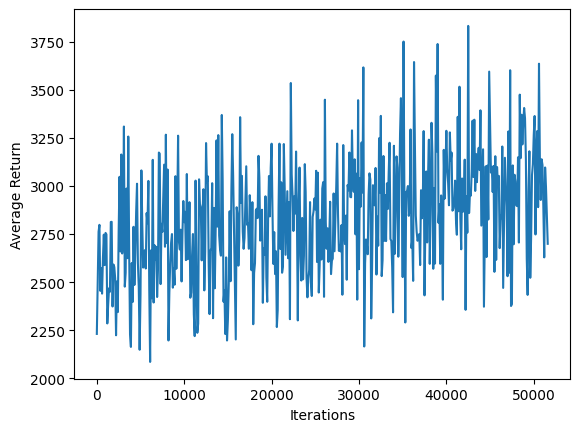

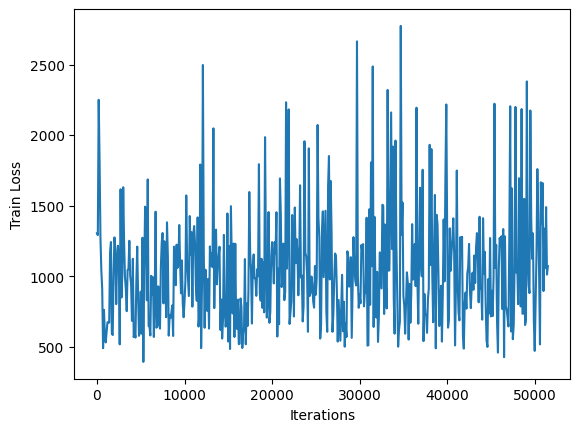

********************ITERATION NUMBER #51600
********************ITERATION NUMBER #51601
********************ITERATION NUMBER #51602
********************ITERATION NUMBER #51603
********************ITERATION NUMBER #51604
********************ITERATION NUMBER #51605
********************ITERATION NUMBER #51606
********************ITERATION NUMBER #51607
********************ITERATION NUMBER #51608
********************ITERATION NUMBER #51609
********************ITERATION NUMBER #51610
********************ITERATION NUMBER #51611
********************ITERATION NUMBER #51612
********************ITERATION NUMBER #51613
********************ITERATION NUMBER #51614
********************ITERATION NUMBER #51615
********************ITERATION NUMBER #51616
********************ITERATION NUMBER #51617
********************ITERATION NUMBER #51618
********************ITERATION NUMBER #51619
********************ITERATION NUMBER #51620
********************ITERATION NUMBER #51621
********************ITERATION NU

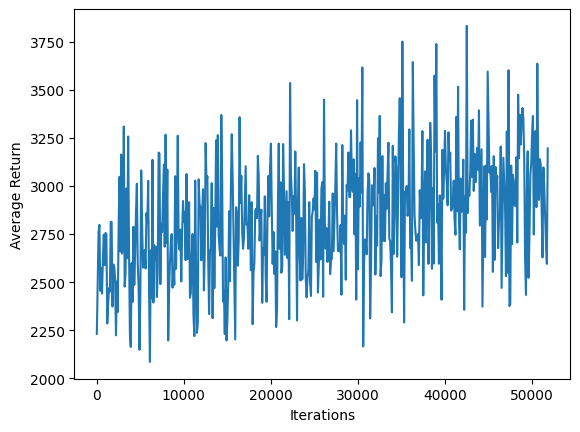

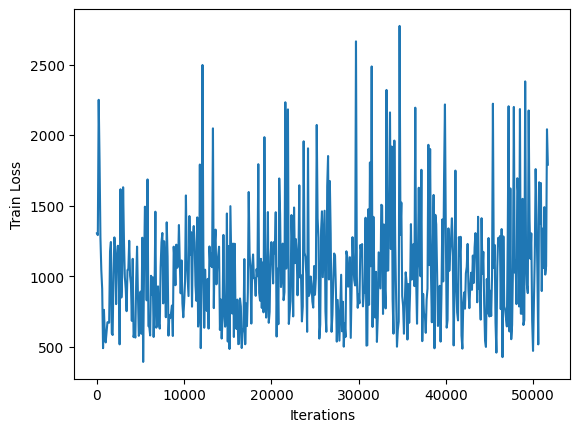

********************ITERATION NUMBER #51800
********************ITERATION NUMBER #51801
********************ITERATION NUMBER #51802
********************ITERATION NUMBER #51803
********************ITERATION NUMBER #51804
********************ITERATION NUMBER #51805
********************ITERATION NUMBER #51806
********************ITERATION NUMBER #51807
********************ITERATION NUMBER #51808
********************ITERATION NUMBER #51809
********************ITERATION NUMBER #51810
********************ITERATION NUMBER #51811
********************ITERATION NUMBER #51812
********************ITERATION NUMBER #51813
********************ITERATION NUMBER #51814
********************ITERATION NUMBER #51815
********************ITERATION NUMBER #51816
********************ITERATION NUMBER #51817
********************ITERATION NUMBER #51818
********************ITERATION NUMBER #51819
********************ITERATION NUMBER #51820
********************ITERATION NUMBER #51821
********************ITERATION NU

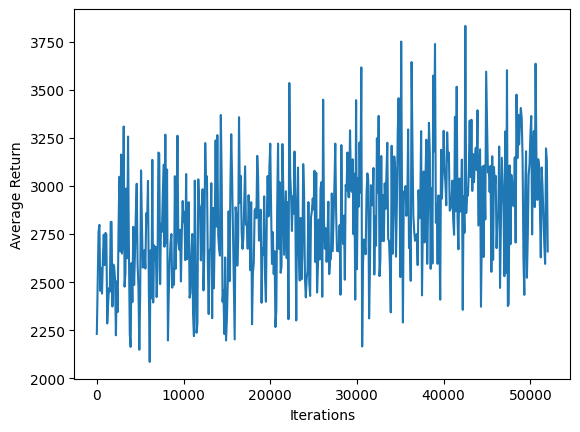

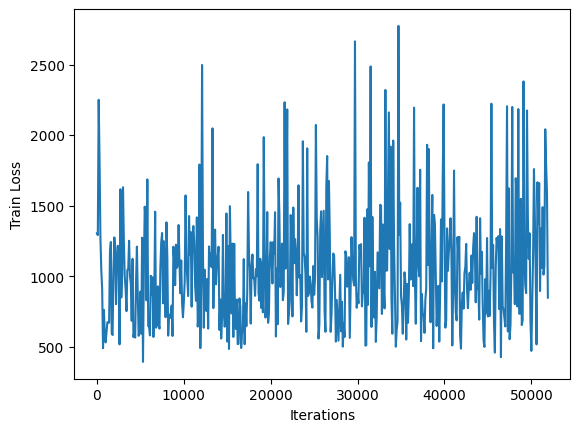

In [ ]:
for iter in range(num_iterations):

  print(f"********************ITERATION NUMBER #{iter}")

  # Collect a few steps and save to the replay buffer.
  time_step, _ = collect_driver.run(time_step)

  # Sample a batch of data from the buffer and update the agent's network.
  experience, unused_info = next(iterator)
  train_loss = agent.train(experience).loss

  tr_loss.append(train_loss)

  step = agent.train_step_counter.numpy()

  if step % log_interval == 0:
    print('step = {0}: loss = {1}'.format(step, train_loss))

  if step % eval_interval == 0:
    avg_return = compute_avg_return(tf_naive_rubik_cube_test_env, agent.policy, num_eval_episodes)
    print('step = {0}: Average Return = {1}'.format(step, avg_return))
    returns.append(avg_return)

  if step % 200 == 0:
    iterations = range(0, step + 1, eval_interval)
    plt.plot(iterations, returns)
    plt.ylabel('Average Return')
    plt.xlabel('Iterations')
    plt.show()

    iterations_loss = range(0, step,eval_interval)
    tr_loss_jump = tr_loss[::eval_interval]
    plt.plot(iterations_loss, tr_loss_jump)
    plt.ylabel('Train Loss')
    plt.xlabel('Iterations')
    plt.show()

## Plots

Text(0.5, 0, 'Iterations')

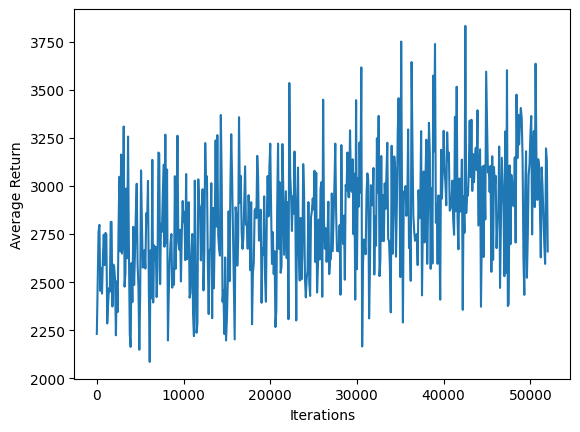

In [ ]:
iterations = range(0, num_iterations + 1, eval_interval)
plt.plot(iterations, returns)
plt.ylabel('Average Return')
plt.xlabel('Iterations')

In [ ]:
def embed_mp4(filename, width=640, height=480):
    """Embeds an mp4 file in the notebook."""
    video = open(filename, 'rb').read()
    b64 = base64.b64encode(video).decode('utf-8')
    tag = f'''
    <video width="{width}" height="{height}" controls>
        <source src="data:video/mp4;base64,{b64}" type="video/mp4">
        Your browser does not support the video tag.
    </video>'''
    return IPython.display.HTML(tag)

In [ ]:
def create_policy_eval_video(policy, filename, num_episodes=10, fps=30, width=640, height=480):
    filename = filename + ".mp4"
    with imageio.get_writer(filename, fps=fps) as video:
        for _ in range(num_episodes):
            time_step = tf_naive_rubik_cube_test_env.reset()

            image=PIL.Image.fromarray(naive_rubik_cube_test_env_py.render()).resize((width,height),PIL.Image.BOX)

            np_image=np.array(image)

            video.append_data(np_image)

            while not time_step.is_last():
                action_step = policy.action(time_step)
                time_step = tf_naive_rubik_cube_test_env.step(action_step.action)

                image=PIL.Image.fromarray(naive_rubik_cube_test_env_py.render()).resize((width,height),PIL.Image.BOX)

                np_image=np.array(image)

                video.append_data(np_image)

    return embed_mp4(filename, width=width, height=height)

In [ ]:
create_policy_eval_video(agent.policy, "trained-agent")

rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
rgb_array
